## Importing all necessary libraries

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

## Importing data

In [2]:
csr = pd.read_csv(r'C:\Users\nehak\Desktop\SimpliLearn Certificates\Assignment\Customer service requests analysis\Project_Two_Dataset\311_Service_Requests_from_2010_to_Present.csv')

C:\Users\nehak\AppData\Local\Temp\ipykernel_22620\3890930292.py:1: DtypeWarning: Columns (48,49) have mixed types. Specify dtype option on import or set low_memory=False.
  csr = pd.read_csv(r'C:\Users\nehak\Desktop\SimpliLearn Certificates\Assignment\Customer service requests analysis\Project_Two_Dataset\311_Service_Requests_from_2010_to_Present.csv')


## 1. Understand the dataset:

In [3]:
csr.head(10)

,Unique Key,Created Date,Closed Date,Agency,Agency Name,Complaint Type,Descriptor,Location Type,Incident Zip,Incident Address,...,Bridge Highway Name,Bridge Highway Direction,Road Ramp,Bridge Highway Segment,Garage Lot Name,Ferry Direction,Ferry Terminal Name,Latitude,Longitude,Location
0,32310363,12/31/2015 11:59:45 PM,01/01/2016 12:55:15 AM,NYPD,New York City Police Department,Noise - Street/Sidewalk,Loud Music/Party,Street/Sidewalk,10034.0,71 VERMILYEA AVENUE,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,40.865682,-73.923501,"(40.86568153633767, -73.92350095571744)"
1,32309934,12/31/2015 11:59:44 PM,01/01/2016 01:26:57 AM,NYPD,New York City Police Department,Blocked Driveway,No Access,Street/Sidewalk,11105.0,27-07 23 AVENUE,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,40.775945,-73.915094,"(40.775945312321085, -73.91509393898605)"
2,32309159,12/31/2015 11:59:29 PM,01/01/2016 04:51:03 AM,NYPD,New York City Police Department,Blocked Driveway,No Access,Street/Sidewalk,10458.0,2897 VALENTINE AVENUE,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,40.870325,-73.888525,"(40.870324522111424, -73.88852464418646)"
3,32305098,12/31/2015 11:57:46 PM,01/01/2016 07:43:13 AM,NYPD,New York City Police Department,Illegal Parking,Commercial Overnight Parking,Street/Sidewalk,10461.0,2940 BAISLEY AVENUE,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,40.835994,-73.828379,"(40.83599404683083, -73.82837939584206)"
4,32306529,12/31/2015 11:56:58 PM,01/01/2016 03:24:42 AM,NYPD,New York City Police Department,Illegal Parking,Blocked Sidewalk,Street/Sidewalk,11373.0,87-14 57 ROAD,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,40.733060,-73.874170,"(40.733059618956815, -73.87416975810375)"
5,32306554,12/31/2015 11:56:30 PM,01/01/2016 01:50:11 AM,NYPD,New York City Police Department,Illegal Parking,Posted Parking Sign Violation,Street/Sidewalk,11215.0,260 21 STREET,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,40.660823,-73.992568,"(40.66082272389114, -73.99256786342693)"
6,32306559,12/31/2015 11:55:32 PM,01/01/2016 01:53:54 AM,NYPD,New York City Police Department,Illegal Parking,Blocked Hydrant,Street/Sidewalk,10032.0,524 WEST 169 STREET,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,40.840848,-73.937375,"(40.840847591440415, -73.9373750864581)"
7,32307009,12/31/2015 11:54:05 PM,01/01/2016 01:42:54 AM,NYPD,New York City Police Department,Blocked Driveway,No Access,Street/Sidewalk,10457.0,501 EAST 171 STREET,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,40.837503,-73.902905,"(40.83750262540012, -73.90290517326568)"
8,32308581,12/31/2015 11:53:58 PM,01/01/2016 08:27:32 AM,NYPD,New York City Police Department,Illegal Parking,Posted Parking Sign Violation,Street/Sidewalk,11415.0,83-44 LEFFERTS BOULEVARD,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,40.704977,-73.832605,"(40.704977164399935, -73.8326047502584)"
9,32308391,12/31/2015 11:53:58 PM,01/01/2016 01:17:40 AM,NYPD,New York City Police Department,Blocked Driveway,No Access,Street/Sidewalk,11219.0,1408 66 STREET,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,40.623793,-73.999539,"(40.623793065806524, -73.99953890121567)"


In [4]:
csr.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 364558 entries, 0 to 364557
Data columns (total 53 columns):
 #   Column                          Non-Null Count   Dtype  
---  ------                          --------------   -----  
 0   Unique Key                      364558 non-null  int64  
 1   Created Date                    364558 non-null  object 
 2   Closed Date                     362177 non-null  object 
 3   Agency                          364558 non-null  object 
 4   Agency Name                     364558 non-null  object 
 5   Complaint Type                  364558 non-null  object 
 6   Descriptor                      358057 non-null  object 
 7   Location Type                   364425 non-null  object 
 8   Incident Zip                    361560 non-null  float64
 9   Incident Address                312859 non-null  object 
 10  Street Name                     312859 non-null  object 
 11  Cross Street 1                  307370 non-null  object 
 12  Cross Street 2  

## Identify the shape of the dataset

In [5]:
csr.shape

(364558, 53)

## Identify variables with null values

In [6]:
missing_values = csr.isnull().sum().sort_values(ascending=False)
total = csr.isnull().count().sort_values(ascending=False)

missing_percent = (missing_values/total)*100
missing_data = pd.concat([missing_values,missing_percent],axis=1,keys=['missing_values','missing_percent'])
missing_data.head(53)

,missing_values,missing_percent
School or Citywide Complaint,364558,100.000000
Vehicle Type,364558,100.000000
Taxi Company Borough,364558,100.000000
Taxi Pick Up Location,364558,100.000000
Garage Lot Name,364558,100.000000
Ferry Direction,364557,99.999726
Ferry Terminal Name,364556,99.999451
Road Ramp,364296,99.928132
Bridge Highway Segment,364296,99.928132
Bridge Highway Name,364261,99.918531


In [7]:
csr = csr.drop(['School or Citywide Complaint','Vehicle Type','Taxi Company Borough','Taxi Pick Up Location','Garage Lot Name',
         'Ferry Direction','Ferry Terminal Name','Road Ramp','Bridge Highway Segment','Bridge Highway Name',
         'Bridge Highway Direction','Landmark','Intersection Street 2','Intersection Street 1'],axis=1)

In [8]:
csr.shape

(364558, 39)

## 2. Perform basic data exploratory analysis:

In [9]:
csr.describe(include='all')

,Unique Key,Created Date,Closed Date,Agency,Agency Name,Complaint Type,Descriptor,Location Type,Incident Zip,Incident Address,...,School Code,School Phone Number,School Address,School City,School State,School Zip,School Not Found,Latitude,Longitude,Location
count,3.645580e+05,364558,362177,364558,364558,364558,358057,364425,361560.000000,312859,...,364557,364558,364558,364558,364558,364557,364558,360528.000000,360528.000000,360528
unique,NaN,362018,339837,1,3,24,45,18,NaN,126372,...,1,2,2,2,2,1,1,NaN,NaN,146751
top,NaN,02/11/2015 10:56:36 PM,09/10/2015 07:12:49 AM,NYPD,New York City Police Department,Blocked Driveway,No Access,Street/Sidewalk,NaN,1207 BEACH AVENUE,...,Unspecified,Unspecified,Unspecified,Unspecified,Unspecified,Unspecified,N,NaN,NaN,"(40.83036235589997, -73.86602154214397)"
freq,NaN,3,3,364558,364548,100881,75888,301372,NaN,1014,...,364557,364557,364557,364557,364557,364557,364558,NaN,NaN,1012
mean,3.106595e+07,NaN,NaN,NaN,NaN,NaN,NaN,NaN,10858.496659,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,40.724980,-73.924946,NaN
std,7.331531e+05,NaN,NaN,NaN,NaN,NaN,NaN,NaN,578.263114,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.081907,0.079213,NaN
min,2.960737e+07,NaN,NaN,NaN,NaN,NaN,NaN,NaN,83.000000,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,40.499040,-74.254937,NaN
25%,3.049938e+07,NaN,NaN,NaN,NaN,NaN,NaN,NaN,10314.000000,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,40.668742,-73.972253,NaN
50%,3.108795e+07,NaN,NaN,NaN,NaN,NaN,NaN,NaN,11209.000000,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,40.718406,-73.930643,NaN
75%,3.167433e+07,NaN,NaN,NaN,NaN,NaN,NaN,NaN,11238.000000,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,40.778166,-73.874098,NaN


## Utilize missing value treatment

In [10]:
df = pd.DataFrame(csr)

In [11]:
numeric_data = df.select_dtypes(include='number')
categorical_data = df.select_dtypes(exclude='number')

print('Numerical variables: ',numeric_data.shape[1],'Categorical variables: ',categorical_data.shape[1])

Numerical variables:  6 Categorical variables:  33


In [12]:
df = df.apply(lambda x: x.fillna(x.value_counts().index[0]))

In [13]:
df.isna().sum().sort_values(ascending=False).head(39)

Unique Key                        0
School Code                       0
X Coordinate (State Plane)        0
Y Coordinate (State Plane)        0
Park Facility Name                0
Park Borough                      0
School Name                       0
School Number                     0
School Region                     0
School Phone Number               0
Community Board                   0
School Address                    0
School City                       0
School State                      0
School Zip                        0
School Not Found                  0
Latitude                          0
Longitude                         0
Borough                           0
Resolution Action Updated Date    0
Created Date                      0
Incident Address                  0
Closed Date                       0
Agency                            0
Agency Name                       0
Complaint Type                    0
Descriptor                        0
Location Type               

## Analyze the date column and remove the entries if it has an incorrect timeline

In [14]:
df['Resolution Action Updated Date'].dtype

dtype('O')

In [15]:
#df(['Created Date']<['Closed Date'])

## Draw a frequency plot for city-wise complaints

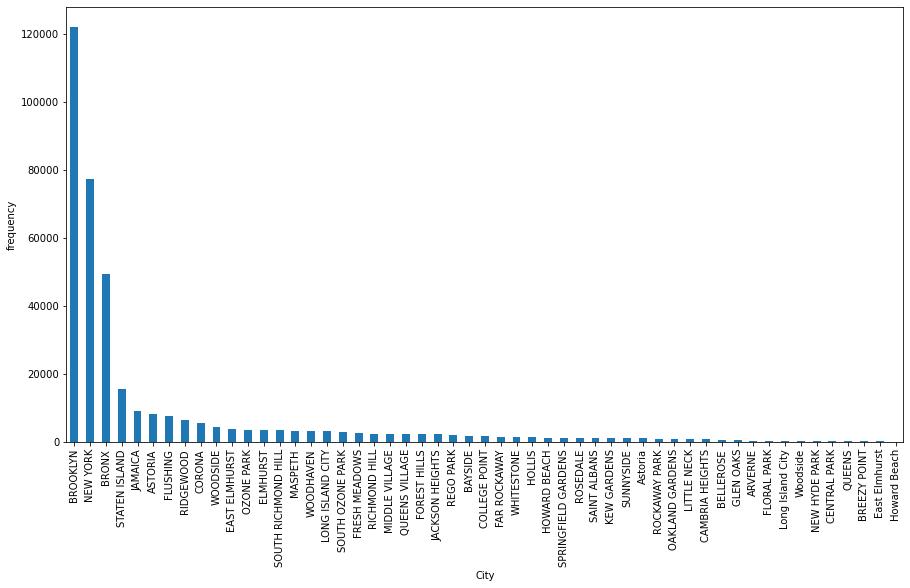

In [16]:
f,ax = plt.subplots(figsize=(15,8))
df['City'].value_counts().plot(ax=ax,kind='bar',xlabel='City',ylabel='frequency')
plt.show()

## Draw scatter and hexbin plots for complaint concentration across Brooklyn

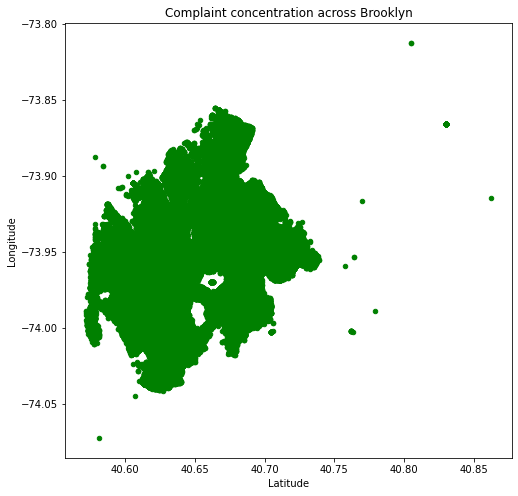

In [17]:
df_Brooklyn_complaint = df[df['City']=='BROOKLYN']
df_Brooklyn_complaint.plot(kind='scatter',x='Latitude',y='Longitude',color='Green',figsize=(8,8),title='Complaint concentration across Brooklyn')
plt.show()

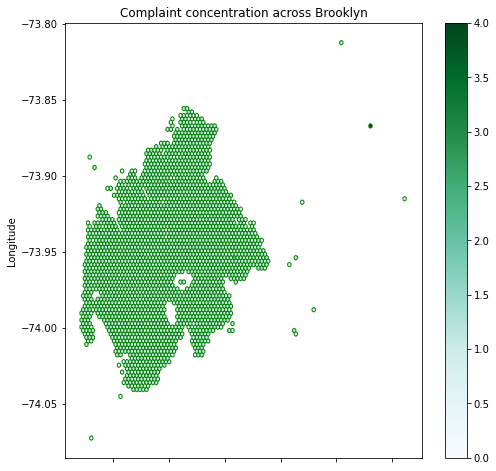

In [18]:
df_Brooklyn_complaint.plot(kind='hexbin',x='Latitude',y='Longitude',bins=5,mincnt=1,color='Green',figsize=(8,8),title='Complaint concentration across Brooklyn')
plt.show()

## 3. Find major types of complaints:

## Plot a bar graph of count vs. complaint types

In [19]:
bar_chart = df['Complaint Type'].value_counts().sort_values(ascending=False).head(10)

In [20]:
bar_chart.values

array([100881,  92679,  51692,  44109,  21661,  19352,  10541,   5198,
         4879,   4192], dtype=int64)

In [21]:
bar_chart.index

Index(['Blocked Driveway', 'Illegal Parking', 'Noise - Street/Sidewalk',
       'Noise - Commercial', 'Derelict Vehicle', 'Noise - Vehicle',
       'Animal Abuse', 'Traffic', 'Homeless Encampment', 'Vending'],
      dtype='object')

<AxesSubplot:>

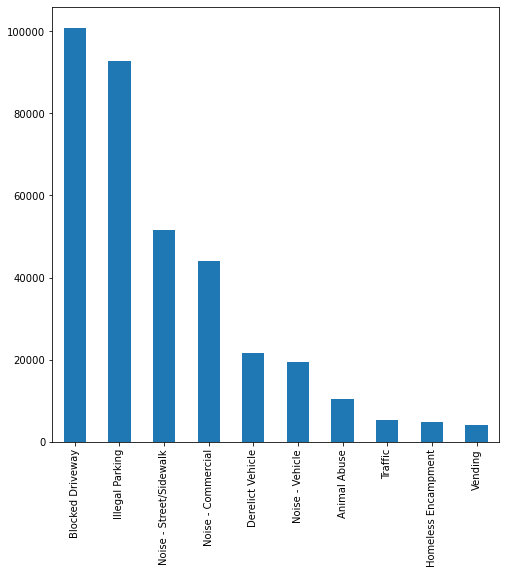

In [22]:
bar_chart.plot(kind='bar',figsize=(8,8),x=bar_chart.index,y=bar_chart.values)

## Find the top 10 types of complaints

In [23]:
df['Complaint Type'].value_counts().sort_values(ascending=False).head(10)

Blocked Driveway           100881
Illegal Parking             92679
Noise - Street/Sidewalk     51692
Noise - Commercial          44109
Derelict Vehicle            21661
Noise - Vehicle             19352
Animal Abuse                10541
Traffic                      5198
Homeless Encampment          4879
Vending                      4192
Name: Complaint Type, dtype: int64

## Display the types of complaints in each city in a separate dataset

In [24]:
df.groupby(['City','Complaint Type']).size().head(40)

City     Complaint Type           
ARVERNE  Animal Abuse                   46
         Blocked Driveway               50
         Derelict Vehicle               32
         Disorderly Youth                2
         Drinking                        1
         Graffiti                        1
         Homeless Encampment             4
         Illegal Parking                62
         Noise - Commercial              2
         Noise - House of Worship       14
         Noise - Park                    2
         Noise - Street/Sidewalk        29
         Noise - Vehicle                10
         Panhandling                     1
         Traffic                         1
         Urinating in Public             1
         Vending                         1
ASTORIA  Animal Abuse                  170
         Bike/Roller/Skate Chronic      16
         Blocked Driveway             3436
         Derelict Vehicle              426
         Disorderly Youth                5
         Drinking  

## 4. Visualize the major types of complaints in each city

In [25]:
y_axis = df['Complaint Type'].unique()

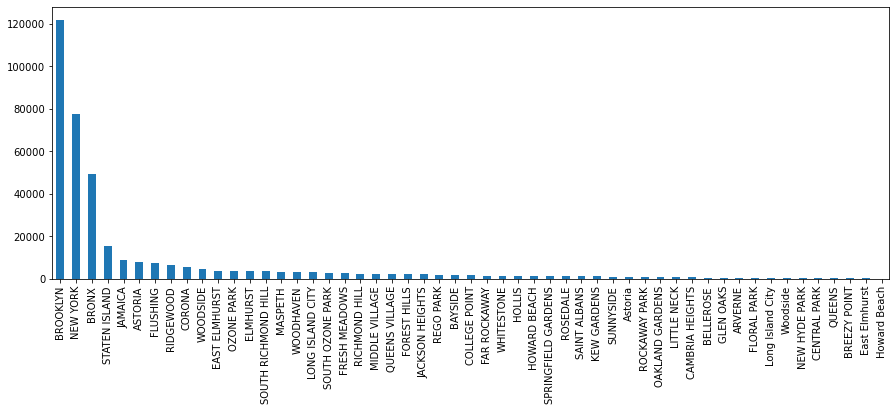

In [26]:
df['City'].value_counts().plot(kind='bar',x='City',y=y_axis,figsize=(15,5))
plt.show()

## 5. Check if the average response time across various types of complaints

In [27]:
from datetime import datetime

In [28]:
#df['Created Date'].values[0]

In [29]:
#datetime_str = df['Created Date'].values[0]

In [30]:
#datetime_object = datetime.strptime(datetime_str,'%m/%d/%Y %H:%M:%S %p')

In [31]:
#print(type(datetime_object))

In [32]:
#print(datetime_object)

In [33]:
i = 0
while i < df.shape[0]: 
    datetime_object_Created = datetime.strptime(df['Created Date'].values[i],'%m/%d/%Y %H:%M:%S %p')
    print(datetime_object_Created)
    i = i +1

2015-12-31 11:59:45
2015-12-31 11:59:44
2015-12-31 11:59:29
2015-12-31 11:57:46
2015-12-31 11:56:58
2015-12-31 11:56:30
2015-12-31 11:55:32
2015-12-31 11:54:05
2015-12-31 11:53:58
2015-12-31 11:53:58
2015-12-31 11:52:58
2015-12-31 11:50:57
2015-12-31 11:48:03
2015-12-31 11:47:58
2015-12-31 11:47:37
2015-12-31 11:47:30
2015-12-31 11:47:02
2015-12-31 11:44:52
2015-12-31 11:40:59
2015-12-31 11:40:55
2015-12-31 11:40:43
2015-12-31 11:38:51
2015-12-31 11:34:18
2015-12-31 11:32:46
2015-12-31 11:31:40
2015-12-31 11:30:28
2015-12-31 11:26:41
2015-12-31 11:26:35
2015-12-31 11:25:56
2015-12-31 11:25:01
2015-12-31 11:22:51
2015-12-31 11:21:24
2015-12-31 11:19:22
2015-12-31 11:18:10
2015-12-31 11:16:06
2015-12-31 11:15:27
2015-12-31 11:13:47
2015-12-31 11:12:45
2015-12-31 11:11:33
2015-12-31 11:11:24
2015-12-31 11:11:18
2015-12-31 11:10:03
2015-12-31 11:09:55
2015-12-31 11:09:25
2015-12-31 11:09:16
2015-12-31 11:08:41
2015-12-31 11:08:26
2015-12-31 11:07:32
2015-12-31 11:07:20
2015-12-31 11:06:58


2015-12-29 11:42:52
2015-12-29 11:42:02
2015-12-29 11:40:35
2015-12-29 11:38:25
2015-12-29 11:38:05
2015-12-29 11:35:18
2015-12-29 11:33:49
2015-12-29 11:33:39
2015-12-29 11:33:20
2015-12-29 11:32:44
2015-12-29 11:31:16
2015-12-29 11:30:40
2015-12-29 11:29:37
2015-12-29 11:28:41
2015-12-29 11:27:57
2015-12-29 11:27:24
2015-12-29 11:26:41
2015-12-29 11:24:37
2015-12-29 11:24:04
2015-12-29 11:22:22
2015-12-29 11:22:11
2015-12-29 11:21:08
2015-12-29 11:21:06
2015-12-29 11:20:31
2015-12-29 11:18:46
2015-12-29 11:18:12
2015-12-29 11:18:03
2015-12-29 11:16:10
2015-12-29 11:14:44
2015-12-29 11:14:32
2015-12-29 11:14:25
2015-12-29 11:14:05
2015-12-29 11:13:31
2015-12-29 11:12:55
2015-12-29 11:12:39
2015-12-29 11:11:48
2015-12-29 11:09:59
2015-12-29 11:08:21
2015-12-29 11:07:15
2015-12-29 11:06:02
2015-12-29 11:05:54
2015-12-29 11:05:35
2015-12-29 11:03:31
2015-12-29 11:01:45
2015-12-29 10:56:49
2015-12-29 10:55:17
2015-12-29 10:53:46
2015-12-29 10:52:58
2015-12-29 10:51:30
2015-12-29 10:51:20


2015-12-27 11:22:40
2015-12-27 11:22:36
2015-12-27 11:20:54
2015-12-27 11:20:07
2015-12-27 11:19:14
2015-12-27 11:18:53
2015-12-27 11:18:47
2015-12-27 11:17:33
2015-12-27 11:16:39
2015-12-27 11:12:07
2015-12-27 11:09:03
2015-12-27 11:06:11
2015-12-27 11:05:28
2015-12-27 11:04:06
2015-12-27 11:02:26
2015-12-27 11:02:14
2015-12-27 11:01:46
2015-12-27 10:59:25
2015-12-27 10:58:14
2015-12-27 10:57:38
2015-12-27 10:56:52
2015-12-27 10:55:44
2015-12-27 10:55:38
2015-12-27 10:54:59
2015-12-27 10:54:21
2015-12-27 10:50:50
2015-12-27 10:49:22
2015-12-27 10:48:40
2015-12-27 10:48:36
2015-12-27 10:47:59
2015-12-27 10:47:56
2015-12-27 10:43:45
2015-12-27 10:42:59
2015-12-27 10:42:15
2015-12-27 10:42:00
2015-12-27 10:41:54
2015-12-27 10:38:34
2015-12-27 10:38:22
2015-12-27 10:37:26
2015-12-27 10:37:19
2015-12-27 10:36:16
2015-12-27 10:35:41
2015-12-27 10:30:59
2015-12-27 10:28:35
2015-12-27 10:28:07
2015-12-27 10:26:56
2015-12-27 10:25:35
2015-12-27 10:22:33
2015-12-27 10:21:27
2015-12-27 10:21:06


2015-12-25 11:38:01
2015-12-25 11:37:29
2015-12-25 11:35:23
2015-12-25 11:35:20
2015-12-25 11:33:48
2015-12-25 11:32:46
2015-12-25 11:32:18
2015-12-25 11:29:10
2015-12-25 11:28:48
2015-12-25 11:26:20
2015-12-25 11:26:11
2015-12-25 11:23:25
2015-12-25 11:23:21
2015-12-25 11:22:41
2015-12-25 11:19:30
2015-12-25 11:18:15
2015-12-25 11:17:57
2015-12-25 11:16:22
2015-12-25 11:16:04
2015-12-25 11:15:52
2015-12-25 11:15:28
2015-12-25 11:14:52
2015-12-25 11:14:50
2015-12-25 11:14:09
2015-12-25 11:13:20
2015-12-25 11:12:16
2015-12-25 11:11:16
2015-12-25 11:09:00
2015-12-25 11:08:29
2015-12-25 11:07:45
2015-12-25 11:07:23
2015-12-25 11:05:57
2015-12-25 11:04:31
2015-12-25 11:01:46
2015-12-25 11:00:46
2015-12-25 10:58:58
2015-12-25 10:58:07
2015-12-25 10:57:34
2015-12-25 10:57:27
2015-12-25 10:56:34
2015-12-25 10:56:00
2015-12-25 10:54:31
2015-12-25 10:50:10
2015-12-25 10:46:56
2015-12-25 10:43:28
2015-12-25 10:41:36
2015-12-25 10:40:52
2015-12-25 10:39:24
2015-12-25 10:38:43
2015-12-25 10:38:43


2015-12-24 06:38:21
2015-12-24 06:33:16
2015-12-24 06:32:54
2015-12-24 06:32:13
2015-12-24 06:29:46
2015-12-24 06:14:32
2015-12-24 06:11:30
2015-12-24 06:08:45
2015-12-24 06:07:11
2015-12-24 05:58:13
2015-12-24 05:53:50
2015-12-24 05:45:38
2015-12-24 05:32:13
2015-12-24 05:29:32
2015-12-24 05:27:54
2015-12-24 05:25:04
2015-12-24 05:23:35
2015-12-24 05:17:04
2015-12-24 05:13:28
2015-12-24 05:12:24
2015-12-24 05:05:00
2015-12-24 05:02:39
2015-12-24 04:59:15
2015-12-24 04:56:47
2015-12-24 04:47:48
2015-12-24 04:47:40
2015-12-24 04:36:05
2015-12-24 04:31:15
2015-12-24 04:23:08
2015-12-24 04:16:20
2015-12-24 04:15:09
2015-12-24 04:08:39
2015-12-24 03:57:48
2015-12-24 03:40:22
2015-12-24 03:38:56
2015-12-24 03:37:56
2015-12-24 03:28:49
2015-12-24 03:28:46
2015-12-24 03:17:50
2015-12-24 03:16:22
2015-12-24 03:13:25
2015-12-24 03:01:48
2015-12-24 03:01:38
2015-12-24 03:00:56
2015-12-24 03:00:28
2015-12-24 03:00:27
2015-12-24 02:54:22
2015-12-24 02:47:37
2015-12-24 02:43:47
2015-12-24 02:43:10


2015-12-22 08:58:51
2015-12-22 08:57:38
2015-12-22 08:57:17
2015-12-22 08:56:38
2015-12-22 08:56:16
2015-12-22 08:54:59
2015-12-22 08:54:33
2015-12-22 08:53:56
2015-12-22 08:52:46
2015-12-22 08:51:34
2015-12-22 08:50:41
2015-12-22 08:49:38
2015-12-22 08:45:51
2015-12-22 08:45:48
2015-12-22 08:43:37
2015-12-22 08:40:13
2015-12-22 08:36:59
2015-12-22 08:36:18
2015-12-22 08:35:36
2015-12-22 08:34:43
2015-12-22 08:33:47
2015-12-22 08:33:24
2015-12-22 08:32:59
2015-12-22 08:32:33
2015-12-22 08:32:16
2015-12-22 08:29:35
2015-12-22 08:28:17
2015-12-22 08:27:40
2015-12-22 08:25:53
2015-12-22 08:23:27
2015-12-22 08:23:00
2015-12-22 08:19:07
2015-12-22 08:17:12
2015-12-22 08:16:21
2015-12-22 08:16:04
2015-12-22 08:15:41
2015-12-22 08:12:20
2015-12-22 08:11:19
2015-12-22 08:11:11
2015-12-22 08:10:16
2015-12-22 08:09:06
2015-12-22 08:08:41
2015-12-22 08:04:55
2015-12-22 08:03:35
2015-12-22 08:03:31
2015-12-22 08:02:33
2015-12-22 08:01:53
2015-12-22 08:01:41
2015-12-22 08:00:47
2015-12-22 07:59:36


2015-12-20 02:27:02
2015-12-20 02:26:08
2015-12-20 02:26:04
2015-12-20 02:25:22
2015-12-20 02:24:14
2015-12-20 02:23:13
2015-12-20 02:22:51
2015-12-20 02:22:00
2015-12-20 02:21:10
2015-12-20 02:20:06
2015-12-20 02:18:28
2015-12-20 02:16:59
2015-12-20 02:15:29
2015-12-20 02:14:41
2015-12-20 02:13:30
2015-12-20 02:12:20
2015-12-20 02:10:50
2015-12-20 02:10:47
2015-12-20 02:10:15
2015-12-20 02:09:28
2015-12-20 02:07:46
2015-12-20 02:07:05
2015-12-20 02:03:54
2015-12-20 02:03:43
2015-12-20 02:03:22
2015-12-20 02:01:19
2015-12-20 01:59:34
2015-12-20 01:58:54
2015-12-20 01:58:24
2015-12-20 01:58:04
2015-12-20 01:52:31
2015-12-20 01:49:31
2015-12-20 01:48:35
2015-12-20 01:47:53
2015-12-20 01:47:10
2015-12-20 01:46:02
2015-12-20 01:42:30
2015-12-20 01:39:50
2015-12-20 01:39:12
2015-12-20 01:35:38
2015-12-20 01:33:31
2015-12-20 01:33:15
2015-12-20 01:33:12
2015-12-20 01:31:55
2015-12-20 01:31:49
2015-12-20 01:28:40
2015-12-20 01:27:53
2015-12-20 01:26:09
2015-12-20 01:23:10
2015-12-20 01:21:50


2015-12-19 03:37:29
2015-12-19 03:33:49
2015-12-19 03:25:55
2015-12-19 03:20:06
2015-12-19 03:14:05
2015-12-19 03:11:30
2015-12-19 03:10:12
2015-12-19 02:53:10
2015-12-19 02:51:37
2015-12-19 02:50:18
2015-12-19 02:49:12
2015-12-19 02:48:04
2015-12-19 02:47:23
2015-12-19 02:43:42
2015-12-19 02:41:13
2015-12-19 02:41:12
2015-12-19 02:39:16
2015-12-19 02:38:10
2015-12-19 02:36:07
2015-12-19 02:35:56
2015-12-19 02:34:40
2015-12-19 02:33:43
2015-12-19 02:33:20
2015-12-19 02:33:13
2015-12-19 02:32:30
2015-12-19 02:32:19
2015-12-19 02:31:44
2015-12-19 02:31:26
2015-12-19 02:31:07
2015-12-19 02:29:05
2015-12-19 02:28:16
2015-12-19 02:27:51
2015-12-19 02:27:50
2015-12-19 02:26:26
2015-12-19 02:25:47
2015-12-19 02:25:13
2015-12-19 02:25:06
2015-12-19 02:24:46
2015-12-19 02:22:10
2015-12-19 02:16:41
2015-12-19 02:13:55
2015-12-19 02:11:12
2015-12-19 02:10:55
2015-12-19 02:08:07
2015-12-19 02:05:45
2015-12-19 02:05:20
2015-12-19 02:02:00
2015-12-19 01:58:54
2015-12-19 01:58:24
2015-12-19 01:58:10


2015-12-17 10:37:49
2015-12-17 10:36:53
2015-12-17 10:34:48
2015-12-17 10:31:05
2015-12-17 10:29:20
2015-12-17 10:28:16
2015-12-17 10:28:03
2015-12-17 10:27:14
2015-12-17 10:26:09
2015-12-17 10:23:30
2015-12-17 10:23:16
2015-12-17 10:23:03
2015-12-17 10:22:49
2015-12-17 10:21:33
2015-12-17 10:20:45
2015-12-17 10:20:35
2015-12-17 10:20:27
2015-12-17 10:18:33
2015-12-17 10:16:46
2015-12-17 10:13:13
2015-12-17 10:13:05
2015-12-17 10:10:57
2015-12-17 10:10:42
2015-12-17 10:10:24
2015-12-17 10:06:02
2015-12-17 10:05:23
2015-12-17 10:03:40
2015-12-17 10:03:01
2015-12-17 10:02:10
2015-12-17 10:01:05
2015-12-17 10:00:52
2015-12-17 10:00:50
2015-12-17 10:00:46
2015-12-17 10:00:15
2015-12-17 09:59:18
2015-12-17 09:56:49
2015-12-17 09:56:05
2015-12-17 09:55:37
2015-12-17 09:55:16
2015-12-17 09:53:49
2015-12-17 09:52:09
2015-12-17 09:51:22
2015-12-17 09:50:26
2015-12-17 09:48:37
2015-12-17 09:47:24
2015-12-17 09:44:43
2015-12-17 09:44:34
2015-12-17 09:43:02
2015-12-17 09:42:52
2015-12-17 09:42:14


2015-12-15 06:30:32
2015-12-15 06:29:49
2015-12-15 06:28:38
2015-12-15 06:26:42
2015-12-15 06:25:56
2015-12-15 06:25:26
2015-12-15 06:24:40
2015-12-15 06:24:39
2015-12-15 06:23:40
2015-12-15 06:22:46
2015-12-15 06:19:26
2015-12-15 06:18:41
2015-12-15 06:16:15
2015-12-15 06:16:14
2015-12-15 06:14:48
2015-12-15 06:14:35
2015-12-15 06:12:24
2015-12-15 06:11:58
2015-12-15 06:11:12
2015-12-15 06:11:06
2015-12-15 06:10:25
2015-12-15 06:08:28
2015-12-15 06:07:39
2015-12-15 06:06:35
2015-12-15 05:59:30
2015-12-15 05:58:53
2015-12-15 05:58:47
2015-12-15 05:56:10
2015-12-15 05:54:21
2015-12-15 05:50:24
2015-12-15 05:48:45
2015-12-15 05:48:32
2015-12-15 05:46:19
2015-12-15 05:45:08
2015-12-15 05:42:41
2015-12-15 05:42:07
2015-12-15 05:41:47
2015-12-15 05:40:43
2015-12-15 05:40:03
2015-12-15 05:38:23
2015-12-15 05:35:03
2015-12-15 05:34:35
2015-12-15 05:31:31
2015-12-15 05:29:53
2015-12-15 05:27:31
2015-12-15 05:27:00
2015-12-15 05:25:58
2015-12-15 05:24:34
2015-12-15 05:24:28
2015-12-15 05:21:53


2015-12-13 09:22:07
2015-12-13 09:21:36
2015-12-13 09:19:47
2015-12-13 09:17:29
2015-12-13 09:17:25
2015-12-13 09:16:20
2015-12-13 09:12:49
2015-12-13 09:11:31
2015-12-13 09:10:50
2015-12-13 09:10:46
2015-12-13 09:10:41
2015-12-13 09:09:51
2015-12-13 09:08:32
2015-12-13 09:08:06
2015-12-13 09:07:59
2015-12-13 09:07:50
2015-12-13 09:07:37
2015-12-13 09:07:22
2015-12-13 09:07:17
2015-12-13 09:06:23
2015-12-13 09:04:48
2015-12-13 09:01:41
2015-12-13 09:01:29
2015-12-13 09:00:41
2015-12-13 09:00:19
2015-12-13 08:56:55
2015-12-13 08:54:55
2015-12-13 08:51:13
2015-12-13 08:51:01
2015-12-13 08:47:38
2015-12-13 08:47:27
2015-12-13 08:45:08
2015-12-13 08:41:58
2015-12-13 08:41:17
2015-12-13 08:41:10
2015-12-13 08:41:01
2015-12-13 08:40:10
2015-12-13 08:39:29
2015-12-13 08:39:06
2015-12-13 08:37:21
2015-12-13 08:36:59
2015-12-13 08:36:16
2015-12-13 08:35:56
2015-12-13 08:35:26
2015-12-13 08:34:48
2015-12-13 08:32:18
2015-12-13 08:31:06
2015-12-13 08:30:51
2015-12-13 08:30:15
2015-12-13 08:29:52


2015-12-12 02:20:18
2015-12-12 02:18:21
2015-12-12 02:16:59
2015-12-12 02:15:53
2015-12-12 02:14:18
2015-12-12 02:13:56
2015-12-12 02:12:28
2015-12-12 02:12:28
2015-12-12 02:11:58
2015-12-12 02:09:30
2015-12-12 02:09:12
2015-12-12 02:08:38
2015-12-12 02:07:39
2015-12-12 02:05:24
2015-12-12 02:04:56
2015-12-12 02:03:06
2015-12-12 02:02:36
2015-12-12 02:00:51
2015-12-12 02:00:34
2015-12-12 02:00:13
2015-12-12 01:58:39
2015-12-12 01:57:50
2015-12-12 01:57:07
2015-12-12 01:55:57
2015-12-12 01:55:50
2015-12-12 01:55:24
2015-12-12 01:55:23
2015-12-12 01:54:31
2015-12-12 01:54:30
2015-12-12 01:54:25
2015-12-12 01:53:35
2015-12-12 01:53:31
2015-12-12 01:49:53
2015-12-12 01:48:45
2015-12-12 01:48:12
2015-12-12 01:48:09
2015-12-12 01:47:29
2015-12-12 01:46:58
2015-12-12 01:45:14
2015-12-12 01:43:32
2015-12-12 01:43:01
2015-12-12 01:41:45
2015-12-12 01:39:33
2015-12-12 01:37:38
2015-12-12 01:36:52
2015-12-12 01:36:15
2015-12-12 01:36:04
2015-12-12 01:35:59
2015-12-12 01:34:57
2015-12-12 01:34:30


2015-12-11 09:02:34
2015-12-11 09:00:38
2015-12-11 08:59:22
2015-12-11 08:58:10
2015-12-11 08:55:13
2015-12-11 08:53:54
2015-12-11 08:52:56
2015-12-11 08:52:49
2015-12-11 08:52:45
2015-12-11 08:50:52
2015-12-11 08:50:26
2015-12-11 08:48:56
2015-12-11 08:48:34
2015-12-11 08:45:38
2015-12-11 08:45:26
2015-12-11 08:45:21
2015-12-11 08:43:42
2015-12-11 08:42:22
2015-12-11 08:42:14
2015-12-11 08:41:27
2015-12-11 08:36:52
2015-12-11 08:36:21
2015-12-11 08:36:17
2015-12-11 08:35:35
2015-12-11 08:35:01
2015-12-11 08:34:09
2015-12-11 08:33:11
2015-12-11 08:32:46
2015-12-11 08:30:25
2015-12-11 08:29:45
2015-12-11 08:29:28
2015-12-11 08:29:08
2015-12-11 08:29:08
2015-12-11 08:28:11
2015-12-11 08:25:07
2015-12-11 08:24:54
2015-12-11 08:22:16
2015-12-11 08:21:55
2015-12-11 08:21:22
2015-12-11 08:21:12
2015-12-11 08:21:04
2015-12-11 08:20:16
2015-12-11 08:20:12
2015-12-11 08:19:31
2015-12-11 08:19:17
2015-12-11 08:18:13
2015-12-11 08:17:56
2015-12-11 08:17:44
2015-12-11 08:16:39
2015-12-11 08:16:12


2015-12-09 09:45:27
2015-12-09 09:44:50
2015-12-09 09:44:45
2015-12-09 09:42:37
2015-12-09 09:41:57
2015-12-09 09:41:56
2015-12-09 09:39:33
2015-12-09 09:38:18
2015-12-09 09:37:50
2015-12-09 09:37:45
2015-12-09 09:37:21
2015-12-09 09:36:13
2015-12-09 09:34:47
2015-12-09 09:34:18
2015-12-09 09:33:48
2015-12-09 09:33:40
2015-12-09 09:31:36
2015-12-09 09:31:11
2015-12-09 09:30:17
2015-12-09 09:30:00
2015-12-09 09:29:39
2015-12-09 09:29:26
2015-12-09 09:28:25
2015-12-09 09:27:07
2015-12-09 09:26:22
2015-12-09 09:25:18
2015-12-09 09:24:34
2015-12-09 09:23:24
2015-12-09 09:23:21
2015-12-09 09:23:12
2015-12-09 09:22:16
2015-12-09 09:21:35
2015-12-09 09:20:52
2015-12-09 09:17:13
2015-12-09 09:16:32
2015-12-09 09:15:23
2015-12-09 09:12:29
2015-12-09 09:12:14
2015-12-09 09:08:38
2015-12-09 09:08:35
2015-12-09 09:07:33
2015-12-09 09:04:29
2015-12-09 09:04:09
2015-12-09 09:03:59
2015-12-09 09:03:52
2015-12-09 09:03:17
2015-12-09 09:02:59
2015-12-09 09:02:40
2015-12-09 09:01:35
2015-12-09 09:00:55


2015-12-07 09:46:59
2015-12-07 09:43:43
2015-12-07 09:43:02
2015-12-07 09:40:22
2015-12-07 09:39:27
2015-12-07 09:37:53
2015-12-07 09:36:49
2015-12-07 09:36:41
2015-12-07 09:34:09
2015-12-07 09:34:08
2015-12-07 09:34:05
2015-12-07 09:33:10
2015-12-07 09:32:17
2015-12-07 09:30:43
2015-12-07 09:30:36
2015-12-07 09:27:27
2015-12-07 09:27:26
2015-12-07 09:27:15
2015-12-07 09:25:30
2015-12-07 09:24:06
2015-12-07 09:20:57
2015-12-07 09:19:59
2015-12-07 09:17:15
2015-12-07 09:16:11
2015-12-07 09:16:03
2015-12-07 09:15:29
2015-12-07 09:14:51
2015-12-07 09:14:09
2015-12-07 09:13:35
2015-12-07 09:11:26
2015-12-07 09:10:51
2015-12-07 09:10:48
2015-12-07 09:10:32
2015-12-07 09:10:03
2015-12-07 09:08:21
2015-12-07 09:07:20
2015-12-07 09:06:57
2015-12-07 09:05:55
2015-12-07 09:05:52
2015-12-07 09:05:24
2015-12-07 09:04:20
2015-12-07 09:03:40
2015-12-07 09:03:07
2015-12-07 09:01:49
2015-12-07 09:01:43
2015-12-07 09:01:34
2015-12-07 09:01:08
2015-12-07 08:59:59
2015-12-07 08:58:20
2015-12-07 08:57:39


2015-12-06 03:02:18
2015-12-06 02:59:14
2015-12-06 02:58:38
2015-12-06 02:56:21
2015-12-06 02:54:38
2015-12-06 02:48:50
2015-12-06 02:46:35
2015-12-06 02:46:04
2015-12-06 02:45:04
2015-12-06 02:44:45
2015-12-06 02:43:29
2015-12-06 02:37:50
2015-12-06 02:37:14
2015-12-06 02:36:16
2015-12-06 02:33:35
2015-12-06 02:29:43
2015-12-06 02:28:35
2015-12-06 02:27:13
2015-12-06 02:26:52
2015-12-06 02:25:00
2015-12-06 02:23:34
2015-12-06 02:19:13
2015-12-06 02:19:05
2015-12-06 02:18:47
2015-12-06 02:18:34
2015-12-06 02:18:27
2015-12-06 02:16:15
2015-12-06 02:15:25
2015-12-06 02:14:41
2015-12-06 02:13:59
2015-12-06 02:13:57
2015-12-06 02:13:55
2015-12-06 02:13:46
2015-12-06 02:13:15
2015-12-06 02:12:26
2015-12-06 02:12:14
2015-12-06 02:12:12
2015-12-06 02:11:30
2015-12-06 02:11:20
2015-12-06 02:11:10
2015-12-06 02:11:09
2015-12-06 02:07:32
2015-12-06 02:06:31
2015-12-06 02:04:36
2015-12-06 02:04:24
2015-12-06 02:04:14
2015-12-06 02:01:38
2015-12-06 02:00:14
2015-12-06 01:57:04
2015-12-06 01:53:36


2015-12-04 11:09:21
2015-12-04 11:07:38
2015-12-04 11:05:36
2015-12-04 11:05:32
2015-12-04 11:04:11
2015-12-04 11:03:15
2015-12-04 11:03:07
2015-12-04 11:02:14
2015-12-04 11:01:17
2015-12-04 11:01:17
2015-12-04 11:01:07
2015-12-04 11:01:04
2015-12-04 11:00:41
2015-12-04 10:59:34
2015-12-04 10:58:20
2015-12-04 10:57:01
2015-12-04 10:56:25
2015-12-04 10:54:23
2015-12-04 10:53:44
2015-12-04 10:52:13
2015-12-04 10:51:01
2015-12-04 10:50:05
2015-12-04 10:49:18
2015-12-04 10:49:18
2015-12-04 10:49:17
2015-12-04 10:48:55
2015-12-04 10:47:42
2015-12-04 10:47:06
2015-12-04 10:46:46
2015-12-04 10:45:50
2015-12-04 10:45:32
2015-12-04 10:45:04
2015-12-04 10:44:24
2015-12-04 10:44:22
2015-12-04 10:42:26
2015-12-04 10:41:53
2015-12-04 10:39:22
2015-12-04 10:38:51
2015-12-04 10:38:26
2015-12-04 10:38:25
2015-12-04 10:37:17
2015-12-04 10:37:00
2015-12-04 10:36:27
2015-12-04 10:36:16
2015-12-04 10:36:14
2015-12-04 10:34:58
2015-12-04 10:34:57
2015-12-04 10:33:02
2015-12-04 10:32:55
2015-12-04 10:32:30


2015-12-03 10:32:27
2015-12-03 10:29:44
2015-12-03 10:28:42
2015-12-03 10:28:32
2015-12-03 10:28:13
2015-12-03 10:28:00
2015-12-03 10:27:28
2015-12-03 10:25:16
2015-12-03 10:25:03
2015-12-03 10:24:44
2015-12-03 10:23:50
2015-12-03 10:23:35
2015-12-03 10:22:58
2015-12-03 10:20:42
2015-12-03 10:19:53
2015-12-03 10:19:01
2015-12-03 10:18:37
2015-12-03 10:17:49
2015-12-03 10:17:19
2015-12-03 10:15:48
2015-12-03 10:15:42
2015-12-03 10:14:51
2015-12-03 10:14:50
2015-12-03 10:12:18
2015-12-03 10:11:16
2015-12-03 10:08:22
2015-12-03 10:07:18
2015-12-03 10:03:04
2015-12-03 10:00:33
2015-12-03 09:59:31
2015-12-03 09:55:09
2015-12-03 09:55:04
2015-12-03 09:54:32
2015-12-03 09:54:10
2015-12-03 09:51:13
2015-12-03 09:51:11
2015-12-03 09:49:27
2015-12-03 09:48:56
2015-12-03 09:48:34
2015-12-03 09:47:28
2015-12-03 09:46:46
2015-12-03 09:46:34
2015-12-03 09:46:27
2015-12-03 09:46:25
2015-12-03 09:45:47
2015-12-03 09:45:23
2015-12-03 09:41:56
2015-12-03 09:39:10
2015-12-03 09:36:39
2015-12-03 09:35:58


2015-12-01 10:31:18
2015-12-01 10:28:37
2015-12-01 10:27:57
2015-12-01 10:27:03
2015-12-01 10:25:38
2015-12-01 10:25:02
2015-12-01 10:23:47
2015-12-01 10:23:19
2015-12-01 10:22:36
2015-12-01 10:19:09
2015-12-01 10:17:37
2015-12-01 10:16:30
2015-12-01 10:15:56
2015-12-01 10:15:10
2015-12-01 10:13:47
2015-12-01 10:13:29
2015-12-01 10:12:35
2015-12-01 10:11:26
2015-12-01 10:09:43
2015-12-01 10:09:12
2015-12-01 10:07:20
2015-12-01 10:06:33
2015-12-01 10:04:06
2015-12-01 10:01:13
2015-12-01 09:58:34
2015-12-01 09:58:19
2015-12-01 09:56:17
2015-12-01 09:55:46
2015-12-01 09:55:36
2015-12-01 09:55:14
2015-12-01 09:54:37
2015-12-01 09:54:33
2015-12-01 09:52:51
2015-12-01 09:52:16
2015-12-01 09:52:05
2015-12-01 09:51:42
2015-12-01 09:51:07
2015-12-01 09:50:42
2015-12-01 09:50:19
2015-12-01 09:49:46
2015-12-01 09:48:06
2015-12-01 09:46:06
2015-12-01 09:43:51
2015-12-01 09:42:26
2015-12-01 09:42:12
2015-12-01 09:41:00
2015-12-01 09:40:50
2015-12-01 09:40:48
2015-12-01 09:40:44
2015-12-01 09:38:39


2015-11-29 04:52:16
2015-11-29 04:51:11
2015-11-29 04:48:23
2015-11-29 04:45:27
2015-11-29 04:45:19
2015-11-29 04:43:43
2015-11-29 04:41:52
2015-11-29 04:40:05
2015-11-29 04:39:00
2015-11-29 04:38:38
2015-11-29 04:38:37
2015-11-29 04:37:22
2015-11-29 04:36:39
2015-11-29 04:36:23
2015-11-29 04:36:15
2015-11-29 04:34:59
2015-11-29 04:33:46
2015-11-29 04:33:44
2015-11-29 04:32:38
2015-11-29 04:31:42
2015-11-29 04:31:06
2015-11-29 04:30:35
2015-11-29 04:28:02
2015-11-29 04:27:22
2015-11-29 04:23:03
2015-11-29 04:21:16
2015-11-29 04:21:14
2015-11-29 04:20:37
2015-11-29 04:20:10
2015-11-29 04:17:37
2015-11-29 04:17:24
2015-11-29 04:14:10
2015-11-29 04:11:32
2015-11-29 04:10:20
2015-11-29 04:04:41
2015-11-29 04:04:08
2015-11-29 04:02:39
2015-11-29 04:02:04
2015-11-29 04:00:40
2015-11-29 03:59:49
2015-11-29 03:59:06
2015-11-29 03:59:03
2015-11-29 03:59:02
2015-11-29 03:57:29
2015-11-29 03:56:40
2015-11-29 03:54:56
2015-11-29 03:52:04
2015-11-29 03:51:55
2015-11-29 03:51:42
2015-11-29 03:51:07


2015-11-27 01:44:47
2015-11-27 01:44:39
2015-11-27 01:42:25
2015-11-27 01:37:31
2015-11-27 01:35:27
2015-11-27 01:35:15
2015-11-27 01:35:13
2015-11-27 01:34:14
2015-11-27 01:33:49
2015-11-27 01:30:46
2015-11-27 01:29:05
2015-11-27 01:28:59
2015-11-27 01:26:40
2015-11-27 01:24:57
2015-11-27 01:23:40
2015-11-27 01:23:13
2015-11-27 01:23:05
2015-11-27 01:22:36
2015-11-27 01:20:32
2015-11-27 01:18:54
2015-11-27 01:15:30
2015-11-27 01:13:21
2015-11-27 01:12:07
2015-11-27 01:10:58
2015-11-27 01:09:23
2015-11-27 01:08:51
2015-11-27 01:06:42
2015-11-27 01:05:56
2015-11-27 01:05:51
2015-11-27 01:01:19
2015-11-27 01:00:57
2015-11-27 12:59:38
2015-11-27 12:57:56
2015-11-27 12:57:08
2015-11-27 12:56:40
2015-11-27 12:56:38
2015-11-27 12:56:18
2015-11-27 12:55:55
2015-11-27 12:47:10
2015-11-27 12:47:02
2015-11-27 12:44:21
2015-11-27 12:44:12
2015-11-27 12:42:04
2015-11-27 12:41:22
2015-11-27 12:38:57
2015-11-27 12:38:39
2015-11-27 12:38:01
2015-11-27 12:26:36
2015-11-27 12:26:25
2015-11-27 12:25:42


2015-11-25 06:11:32
2015-11-25 06:11:11
2015-11-25 06:09:16
2015-11-25 06:08:34
2015-11-25 06:07:45
2015-11-25 06:05:32
2015-11-25 06:02:45
2015-11-25 06:02:22
2015-11-25 06:00:47
2015-11-25 06:00:37
2015-11-25 05:59:30
2015-11-25 05:58:46
2015-11-25 05:57:15
2015-11-25 05:57:00
2015-11-25 05:54:45
2015-11-25 05:51:52
2015-11-25 05:50:05
2015-11-25 05:49:14
2015-11-25 05:46:33
2015-11-25 05:45:31
2015-11-25 05:45:03
2015-11-25 05:44:39
2015-11-25 05:42:48
2015-11-25 05:42:01
2015-11-25 05:42:00
2015-11-25 05:34:42
2015-11-25 05:34:37
2015-11-25 05:34:09
2015-11-25 05:33:58
2015-11-25 05:29:25
2015-11-25 05:28:35
2015-11-25 05:21:31
2015-11-25 05:19:22
2015-11-25 05:17:14
2015-11-25 05:13:36
2015-11-25 05:12:03
2015-11-25 05:11:49
2015-11-25 05:11:33
2015-11-25 05:11:14
2015-11-25 05:10:21
2015-11-25 05:07:31
2015-11-25 05:06:02
2015-11-25 05:05:43
2015-11-25 05:03:56
2015-11-25 05:01:49
2015-11-25 04:55:44
2015-11-25 04:55:20
2015-11-25 04:54:08
2015-11-25 04:52:26
2015-11-25 04:52:06


2015-11-23 04:55:53
2015-11-23 04:55:21
2015-11-23 04:53:58
2015-11-23 04:53:00
2015-11-23 04:49:46
2015-11-23 04:44:49
2015-11-23 04:44:21
2015-11-23 04:43:42
2015-11-23 04:41:54
2015-11-23 04:40:26
2015-11-23 04:40:05
2015-11-23 04:38:11
2015-11-23 04:36:23
2015-11-23 04:31:22
2015-11-23 04:25:11
2015-11-23 04:23:04
2015-11-23 04:22:59
2015-11-23 04:18:02
2015-11-23 04:13:56
2015-11-23 04:11:36
2015-11-23 04:09:13
2015-11-23 04:05:54
2015-11-23 04:05:33
2015-11-23 04:02:50
2015-11-23 04:02:19
2015-11-23 04:02:13
2015-11-23 03:56:28
2015-11-23 03:54:59
2015-11-23 03:52:19
2015-11-23 03:52:17
2015-11-23 03:50:07
2015-11-23 03:47:20
2015-11-23 03:45:50
2015-11-23 03:45:33
2015-11-23 03:45:25
2015-11-23 03:43:28
2015-11-23 03:43:20
2015-11-23 03:42:52
2015-11-23 03:39:39
2015-11-23 03:33:10
2015-11-23 03:32:49
2015-11-23 03:32:29
2015-11-23 03:31:30
2015-11-23 03:29:59
2015-11-23 03:29:25
2015-11-23 03:28:33
2015-11-23 03:28:06
2015-11-23 03:27:19
2015-11-23 03:27:00
2015-11-23 03:25:46


2015-11-21 09:56:19
2015-11-21 09:56:13
2015-11-21 09:55:42
2015-11-21 09:53:41
2015-11-21 09:53:33
2015-11-21 09:53:30
2015-11-21 09:52:52
2015-11-21 09:52:47
2015-11-21 09:50:49
2015-11-21 09:48:53
2015-11-21 09:48:14
2015-11-21 09:47:48
2015-11-21 09:47:05
2015-11-21 09:46:33
2015-11-21 09:46:16
2015-11-21 09:46:09
2015-11-21 09:45:10
2015-11-21 09:44:34
2015-11-21 09:44:12
2015-11-21 09:43:45
2015-11-21 09:41:15
2015-11-21 09:41:10
2015-11-21 09:40:48
2015-11-21 09:38:49
2015-11-21 09:38:06
2015-11-21 09:38:03
2015-11-21 09:36:31
2015-11-21 09:33:47
2015-11-21 09:32:37
2015-11-21 09:32:00
2015-11-21 09:30:08
2015-11-21 09:29:33
2015-11-21 09:28:50
2015-11-21 09:28:28
2015-11-21 09:26:18
2015-11-21 09:24:59
2015-11-21 09:24:44
2015-11-21 09:24:04
2015-11-21 09:22:38
2015-11-21 09:19:17
2015-11-21 09:17:57
2015-11-21 09:14:49
2015-11-21 09:14:39
2015-11-21 09:14:27
2015-11-21 09:13:58
2015-11-21 09:13:02
2015-11-21 09:12:40
2015-11-21 09:12:31
2015-11-21 09:12:26
2015-11-21 09:11:54


2015-11-20 01:41:05
2015-11-20 01:35:40
2015-11-20 01:35:12
2015-11-20 01:30:49
2015-11-20 01:27:43
2015-11-20 01:23:01
2015-11-20 01:22:53
2015-11-20 01:21:59
2015-11-20 01:21:33
2015-11-20 01:21:13
2015-11-20 01:20:09
2015-11-20 01:18:56
2015-11-20 01:17:51
2015-11-20 01:15:56
2015-11-20 01:14:52
2015-11-20 01:14:00
2015-11-20 01:13:31
2015-11-20 01:12:29
2015-11-20 01:12:04
2015-11-20 01:12:03
2015-11-20 01:10:40
2015-11-20 01:07:49
2015-11-20 01:06:55
2015-11-20 01:04:38
2015-11-20 01:03:40
2015-11-20 01:03:24
2015-11-20 01:02:26
2015-11-20 01:01:57
2015-11-20 01:00:20
2015-11-20 01:00:11
2015-11-20 12:59:46
2015-11-20 12:59:18
2015-11-20 12:58:48
2015-11-20 12:57:54
2015-11-20 12:57:09
2015-11-20 12:56:38
2015-11-20 12:56:12
2015-11-20 12:55:54
2015-11-20 12:55:41
2015-11-20 12:55:24
2015-11-20 12:55:17
2015-11-20 12:53:57
2015-11-20 12:53:56
2015-11-20 12:53:33
2015-11-20 12:52:55
2015-11-20 12:51:59
2015-11-20 12:51:17
2015-11-20 12:50:47
2015-11-20 12:50:43
2015-11-20 12:50:07


2015-11-19 08:24:45
2015-11-19 08:18:25
2015-11-19 08:17:55
2015-11-19 08:12:12
2015-11-19 08:12:12
2015-11-19 08:08:43
2015-11-19 08:06:46
2015-11-19 08:03:21
2015-11-19 08:02:29
2015-11-19 08:01:25
2015-11-19 08:00:54
2015-11-19 07:59:58
2015-11-19 07:59:36
2015-11-19 07:59:23
2015-11-19 07:59:09
2015-11-19 07:58:34
2015-11-19 07:58:22
2015-11-19 07:57:20
2015-11-19 07:57:09
2015-11-19 07:56:34
2015-11-19 07:55:53
2015-11-19 07:53:52
2015-11-19 07:53:10
2015-11-19 07:50:54
2015-11-19 07:50:31
2015-11-19 07:50:07
2015-11-19 07:49:51
2015-11-19 07:46:54
2015-11-19 07:46:17
2015-11-19 07:42:52
2015-11-19 07:39:39
2015-11-19 07:39:17
2015-11-19 07:38:32
2015-11-19 07:38:30
2015-11-19 07:38:09
2015-11-19 07:34:40
2015-11-19 07:34:04
2015-11-19 07:32:59
2015-11-19 07:25:42
2015-11-19 07:25:25
2015-11-19 07:25:07
2015-11-19 07:24:42
2015-11-19 07:24:25
2015-11-19 07:21:09
2015-11-19 07:20:30
2015-11-19 07:19:35
2015-11-19 07:19:15
2015-11-19 07:17:40
2015-11-19 07:16:01
2015-11-19 07:14:00


2015-11-17 11:31:19
2015-11-17 11:31:18
2015-11-17 11:31:03
2015-11-17 11:30:27
2015-11-17 11:29:49
2015-11-17 11:28:38
2015-11-17 11:28:09
2015-11-17 11:26:17
2015-11-17 11:25:36
2015-11-17 11:25:27
2015-11-17 11:23:58
2015-11-17 11:23:31
2015-11-17 11:23:19
2015-11-17 11:22:15
2015-11-17 11:22:01
2015-11-17 11:19:28
2015-11-17 11:18:51
2015-11-17 11:18:37
2015-11-17 11:18:17
2015-11-17 11:18:15
2015-11-17 11:15:57
2015-11-17 11:14:49
2015-11-17 11:13:45
2015-11-17 11:11:52
2015-11-17 11:10:20
2015-11-17 11:09:37
2015-11-17 11:08:59
2015-11-17 11:08:36
2015-11-17 11:08:06
2015-11-17 11:07:51
2015-11-17 11:05:16
2015-11-17 11:02:13
2015-11-17 10:58:38
2015-11-17 10:54:53
2015-11-17 10:52:30
2015-11-17 10:51:32
2015-11-17 10:50:37
2015-11-17 10:49:33
2015-11-17 10:49:08
2015-11-17 10:49:06
2015-11-17 10:48:24
2015-11-17 10:48:15
2015-11-17 10:48:02
2015-11-17 10:47:00
2015-11-17 10:45:55
2015-11-17 10:45:46
2015-11-17 10:44:52
2015-11-17 10:43:58
2015-11-17 10:43:31
2015-11-17 10:41:56


2015-11-15 03:17:24
2015-11-15 03:16:45
2015-11-15 03:11:05
2015-11-15 03:10:40
2015-11-15 03:10:03
2015-11-15 03:09:54
2015-11-15 03:09:27
2015-11-15 03:08:59
2015-11-15 03:07:40
2015-11-15 03:07:18
2015-11-15 03:07:03
2015-11-15 03:07:01
2015-11-15 03:07:00
2015-11-15 03:06:03
2015-11-15 03:02:48
2015-11-15 03:00:02
2015-11-15 02:58:46
2015-11-15 02:54:29
2015-11-15 02:51:23
2015-11-15 02:49:44
2015-11-15 02:49:03
2015-11-15 02:48:41
2015-11-15 02:47:21
2015-11-15 02:42:55
2015-11-15 02:42:53
2015-11-15 02:42:23
2015-11-15 02:40:07
2015-11-15 02:40:03
2015-11-15 02:40:03
2015-11-15 02:35:16
2015-11-15 02:34:43
2015-11-15 02:34:14
2015-11-15 02:27:05
2015-11-15 02:26:44
2015-11-15 02:26:13
2015-11-15 02:23:35
2015-11-15 02:21:32
2015-11-15 02:20:56
2015-11-15 02:19:40
2015-11-15 02:16:17
2015-11-15 02:16:05
2015-11-15 02:14:19
2015-11-15 02:12:54
2015-11-15 02:11:27
2015-11-15 02:10:40
2015-11-15 02:10:24
2015-11-15 02:06:50
2015-11-15 02:05:09
2015-11-15 02:04:08
2015-11-15 02:03:39


2015-11-14 02:52:07
2015-11-14 02:51:31
2015-11-14 02:44:43
2015-11-14 02:43:08
2015-11-14 02:41:42
2015-11-14 02:41:19
2015-11-14 02:40:37
2015-11-14 02:40:26
2015-11-14 02:36:42
2015-11-14 02:36:29
2015-11-14 02:36:09
2015-11-14 02:35:13
2015-11-14 02:34:30
2015-11-14 02:33:49
2015-11-14 02:31:41
2015-11-14 02:31:37
2015-11-14 02:31:13
2015-11-14 02:31:10
2015-11-14 02:30:40
2015-11-14 02:30:26
2015-11-14 02:28:59
2015-11-14 02:26:08
2015-11-14 02:25:30
2015-11-14 02:21:20
2015-11-14 02:20:50
2015-11-14 02:20:38
2015-11-14 02:19:31
2015-11-14 02:17:59
2015-11-14 02:15:32
2015-11-14 02:13:57
2015-11-14 02:13:09
2015-11-14 02:12:21
2015-11-14 02:11:26
2015-11-14 02:09:19
2015-11-14 02:08:15
2015-11-14 02:05:47
2015-11-14 02:05:10
2015-11-14 02:04:21
2015-11-14 02:03:11
2015-11-14 02:02:50
2015-11-14 02:01:50
2015-11-14 02:01:04
2015-11-14 01:59:57
2015-11-14 01:59:52
2015-11-14 01:59:25
2015-11-14 01:57:39
2015-11-14 01:57:11
2015-11-14 01:57:03
2015-11-14 01:56:16
2015-11-14 01:56:14


2015-11-12 05:18:21
2015-11-12 05:14:37
2015-11-12 05:14:06
2015-11-12 05:12:40
2015-11-12 05:11:20
2015-11-12 05:06:35
2015-11-12 05:06:16
2015-11-12 05:05:29
2015-11-12 05:04:43
2015-11-12 05:03:06
2015-11-12 05:03:03
2015-11-12 05:00:08
2015-11-12 05:00:07
2015-11-12 04:58:04
2015-11-12 04:57:04
2015-11-12 04:56:45
2015-11-12 04:56:19
2015-11-12 04:53:59
2015-11-12 04:53:34
2015-11-12 04:51:53
2015-11-12 04:49:13
2015-11-12 04:48:41
2015-11-12 04:47:57
2015-11-12 04:46:03
2015-11-12 04:45:56
2015-11-12 04:45:11
2015-11-12 04:43:40
2015-11-12 04:42:30
2015-11-12 04:41:30
2015-11-12 04:41:10
2015-11-12 04:37:27
2015-11-12 04:36:12
2015-11-12 04:35:44
2015-11-12 04:33:35
2015-11-12 04:33:28
2015-11-12 04:32:28
2015-11-12 04:32:27
2015-11-12 04:31:53
2015-11-12 04:31:52
2015-11-12 04:30:50
2015-11-12 04:26:46
2015-11-12 04:26:33
2015-11-12 04:25:53
2015-11-12 04:24:22
2015-11-12 04:24:08
2015-11-12 04:23:51
2015-11-12 04:23:13
2015-11-12 04:22:15
2015-11-12 04:21:07
2015-11-12 04:19:28


2015-11-11 12:25:59
2015-11-11 12:18:58
2015-11-11 12:15:39
2015-11-11 12:14:20
2015-11-11 12:11:50
2015-11-11 12:09:20
2015-11-11 12:07:01
2015-11-11 12:06:34
2015-11-11 12:05:48
2015-11-11 12:04:30
2015-11-11 12:03:22
2015-11-11 12:01:48
2015-11-11 12:00:22
2015-11-10 11:59:18
2015-11-10 11:59:11
2015-11-10 11:56:32
2015-11-10 11:56:01
2015-11-10 11:50:46
2015-11-10 11:48:55
2015-11-10 11:48:16
2015-11-10 11:46:15
2015-11-10 11:45:45
2015-11-10 11:45:37
2015-11-10 11:43:57
2015-11-10 11:41:34
2015-11-10 11:40:57
2015-11-10 11:40:17
2015-11-10 11:40:00
2015-11-10 11:37:01
2015-11-10 11:36:44
2015-11-10 11:33:55
2015-11-10 11:33:10
2015-11-10 11:29:50
2015-11-10 11:29:43
2015-11-10 11:29:20
2015-11-10 11:29:20
2015-11-10 11:28:19
2015-11-10 11:26:48
2015-11-10 11:26:29
2015-11-10 11:25:49
2015-11-10 11:23:39
2015-11-10 11:23:20
2015-11-10 11:22:40
2015-11-10 11:18:08
2015-11-10 11:17:33
2015-11-10 11:17:19
2015-11-10 11:17:13
2015-11-10 11:16:42
2015-11-10 11:16:39
2015-11-10 11:10:33


2015-11-09 09:38:15
2015-11-09 09:37:56
2015-11-09 09:36:40
2015-11-09 09:35:38
2015-11-09 09:34:20
2015-11-09 09:33:48
2015-11-09 09:33:10
2015-11-09 09:31:36
2015-11-09 09:31:07
2015-11-09 09:30:55
2015-11-09 09:30:14
2015-11-09 09:29:52
2015-11-09 09:29:11
2015-11-09 09:28:43
2015-11-09 09:28:37
2015-11-09 09:28:28
2015-11-09 09:27:55
2015-11-09 09:26:44
2015-11-09 09:26:31
2015-11-09 09:26:05
2015-11-09 09:25:18
2015-11-09 09:25:12
2015-11-09 09:24:47
2015-11-09 09:24:33
2015-11-09 09:23:12
2015-11-09 09:22:48
2015-11-09 09:22:27
2015-11-09 09:21:25
2015-11-09 09:21:19
2015-11-09 09:19:34
2015-11-09 09:17:44
2015-11-09 09:16:22
2015-11-09 09:16:20
2015-11-09 09:16:09
2015-11-09 09:16:05
2015-11-09 09:14:46
2015-11-09 09:14:04
2015-11-09 09:12:45
2015-11-09 09:12:44
2015-11-09 09:12:12
2015-11-09 09:10:32
2015-11-09 09:08:48
2015-11-09 09:08:09
2015-11-09 09:02:49
2015-11-09 09:02:48
2015-11-09 09:02:26
2015-11-09 08:55:28
2015-11-09 08:53:54
2015-11-09 08:52:45
2015-11-09 08:50:46


2015-11-07 11:54:23
2015-11-07 11:53:55
2015-11-07 11:52:30
2015-11-07 11:51:54
2015-11-07 11:51:26
2015-11-07 11:49:31
2015-11-07 11:47:36
2015-11-07 11:46:17
2015-11-07 11:46:06
2015-11-07 11:45:54
2015-11-07 11:45:26
2015-11-07 11:45:25
2015-11-07 11:45:15
2015-11-07 11:45:04
2015-11-07 11:44:20
2015-11-07 11:43:28
2015-11-07 11:42:58
2015-11-07 11:42:34
2015-11-07 11:42:12
2015-11-07 11:42:12
2015-11-07 11:41:28
2015-11-07 11:40:30
2015-11-07 11:39:50
2015-11-07 11:39:31
2015-11-07 11:38:41
2015-11-07 11:38:14
2015-11-07 11:37:30
2015-11-07 11:36:53
2015-11-07 11:36:34
2015-11-07 11:36:18
2015-11-07 11:36:04
2015-11-07 11:36:01
2015-11-07 11:35:49
2015-11-07 11:35:36
2015-11-07 11:35:16
2015-11-07 11:35:06
2015-11-07 11:34:26
2015-11-07 11:33:19
2015-11-07 11:32:30
2015-11-07 11:32:04
2015-11-07 11:31:37
2015-11-07 11:31:12
2015-11-07 11:30:49
2015-11-07 11:30:00
2015-11-07 11:29:52
2015-11-07 11:28:30
2015-11-07 11:27:42
2015-11-07 11:27:28
2015-11-07 11:27:25
2015-11-07 11:24:59


2015-11-06 03:16:25
2015-11-06 03:16:16
2015-11-06 03:15:00
2015-11-06 03:13:12
2015-11-06 03:13:10
2015-11-06 03:12:51
2015-11-06 03:12:48
2015-11-06 03:07:51
2015-11-06 03:07:48
2015-11-06 03:07:32
2015-11-06 03:06:52
2015-11-06 03:06:31
2015-11-06 03:02:22
2015-11-06 03:01:59
2015-11-06 03:01:38
2015-11-06 02:58:35
2015-11-06 02:54:27
2015-11-06 02:54:27
2015-11-06 02:53:50
2015-11-06 02:53:46
2015-11-06 02:53:22
2015-11-06 02:52:59
2015-11-06 02:52:57
2015-11-06 02:52:03
2015-11-06 02:51:44
2015-11-06 02:51:22
2015-11-06 02:51:05
2015-11-06 02:50:48
2015-11-06 02:50:20
2015-11-06 02:50:18
2015-11-06 02:49:25
2015-11-06 02:49:17
2015-11-06 02:45:59
2015-11-06 02:45:22
2015-11-06 02:41:15
2015-11-06 02:40:13
2015-11-06 02:39:20
2015-11-06 02:38:40
2015-11-06 02:36:27
2015-11-06 02:30:54
2015-11-06 02:30:45
2015-11-06 02:30:13
2015-11-06 02:29:21
2015-11-06 02:28:52
2015-11-06 02:28:39
2015-11-06 02:28:37
2015-11-06 02:27:52
2015-11-06 02:25:56
2015-11-06 02:24:54
2015-11-06 02:24:37


2015-11-05 09:12:52
2015-11-05 09:12:48
2015-11-05 09:09:49
2015-11-05 09:09:32
2015-11-05 09:09:17
2015-11-05 09:07:36
2015-11-05 09:06:44
2015-11-05 09:06:09
2015-11-05 09:04:53
2015-11-05 09:04:00
2015-11-05 09:03:04
2015-11-05 09:03:00
2015-11-05 09:01:54
2015-11-05 08:59:49
2015-11-05 08:58:40
2015-11-05 08:56:48
2015-11-05 08:55:32
2015-11-05 08:55:14
2015-11-05 08:54:34
2015-11-05 08:53:57
2015-11-05 08:53:32
2015-11-05 08:52:58
2015-11-05 08:52:40
2015-11-05 08:51:13
2015-11-05 08:49:05
2015-11-05 08:48:51
2015-11-05 08:48:00
2015-11-05 08:46:24
2015-11-05 08:45:59
2015-11-05 08:43:13
2015-11-05 08:43:00
2015-11-05 08:41:57
2015-11-05 08:41:47
2015-11-05 08:41:31
2015-11-05 08:40:31
2015-11-05 08:39:53
2015-11-05 08:39:37
2015-11-05 08:39:24
2015-11-05 08:39:15
2015-11-05 08:39:05
2015-11-05 08:38:45
2015-11-05 08:37:41
2015-11-05 08:37:14
2015-11-05 08:32:51
2015-11-05 08:32:15
2015-11-05 08:31:57
2015-11-05 08:31:22
2015-11-05 08:31:21
2015-11-05 08:31:18
2015-11-05 08:30:24


2015-11-03 11:25:34
2015-11-03 11:24:08
2015-11-03 11:23:02
2015-11-03 11:22:01
2015-11-03 11:20:38
2015-11-03 11:20:27
2015-11-03 11:20:21
2015-11-03 11:19:29
2015-11-03 11:17:59
2015-11-03 11:16:59
2015-11-03 11:16:58
2015-11-03 11:12:39
2015-11-03 11:12:27
2015-11-03 11:12:20
2015-11-03 11:11:32
2015-11-03 11:09:47
2015-11-03 11:08:59
2015-11-03 11:08:51
2015-11-03 11:08:18
2015-11-03 11:08:15
2015-11-03 11:04:37
2015-11-03 11:04:23
2015-11-03 11:03:39
2015-11-03 11:01:28
2015-11-03 10:58:24
2015-11-03 10:57:45
2015-11-03 10:56:40
2015-11-03 10:55:49
2015-11-03 10:53:54
2015-11-03 10:53:06
2015-11-03 10:53:04
2015-11-03 10:52:09
2015-11-03 10:52:07
2015-11-03 10:50:38
2015-11-03 10:48:36
2015-11-03 10:47:17
2015-11-03 10:44:28
2015-11-03 10:43:47
2015-11-03 10:42:13
2015-11-03 10:42:13
2015-11-03 10:41:26
2015-11-03 10:41:00
2015-11-03 10:39:45
2015-11-03 10:38:44
2015-11-03 10:38:23
2015-11-03 10:37:26
2015-11-03 10:35:55
2015-11-03 10:33:33
2015-11-03 10:32:33
2015-11-03 10:32:21


2015-11-01 03:36:26
2015-11-01 03:35:48
2015-11-01 03:35:11
2015-11-01 03:33:35
2015-11-01 03:30:08
2015-11-01 03:25:40
2015-11-01 03:23:08
2015-11-01 03:21:30
2015-11-01 03:15:52
2015-11-01 03:15:41
2015-11-01 03:14:53
2015-11-01 03:14:14
2015-11-01 03:13:36
2015-11-01 03:12:31
2015-11-01 03:09:38
2015-11-01 03:08:54
2015-11-01 03:08:16
2015-11-01 03:07:04
2015-11-01 03:05:20
2015-11-01 03:03:56
2015-11-01 03:02:20
2015-11-01 03:01:50
2015-11-01 03:00:44
2015-11-01 02:59:56
2015-11-01 02:58:34
2015-11-01 02:58:21
2015-11-01 02:56:40
2015-11-01 02:56:17
2015-11-01 02:56:06
2015-11-01 02:55:48
2015-11-01 02:54:15
2015-11-01 02:53:05
2015-11-01 02:49:47
2015-11-01 02:48:28
2015-11-01 02:46:56
2015-11-01 02:44:41
2015-11-01 02:44:35
2015-11-01 02:42:51
2015-11-01 02:41:43
2015-11-01 02:41:38
2015-11-01 02:41:06
2015-11-01 02:40:32
2015-11-01 02:37:25
2015-11-01 02:36:51
2015-11-01 02:36:19
2015-11-01 02:34:28
2015-11-01 02:31:14
2015-11-01 02:31:11
2015-11-01 02:30:24
2015-11-01 02:29:34


2015-10-31 03:37:19
2015-10-31 03:33:35
2015-10-31 03:30:20
2015-10-31 03:29:16
2015-10-31 03:28:52
2015-10-31 03:20:35
2015-10-31 03:16:35
2015-10-31 03:16:22
2015-10-31 03:14:58
2015-10-31 03:14:29
2015-10-31 03:12:17
2015-10-31 03:11:06
2015-10-31 03:08:12
2015-10-31 03:03:36
2015-10-31 03:02:25
2015-10-31 03:01:13
2015-10-31 03:00:56
2015-10-31 03:00:14
2015-10-31 02:59:26
2015-10-31 02:55:20
2015-10-31 02:55:07
2015-10-31 02:52:51
2015-10-31 02:49:52
2015-10-31 02:49:31
2015-10-31 02:47:49
2015-10-31 02:47:35
2015-10-31 02:42:23
2015-10-31 02:42:15
2015-10-31 02:40:47
2015-10-31 02:40:26
2015-10-31 02:38:47
2015-10-31 02:36:02
2015-10-31 02:30:59
2015-10-31 02:29:41
2015-10-31 02:27:24
2015-10-31 02:26:19
2015-10-31 02:25:54
2015-10-31 02:24:34
2015-10-31 02:24:12
2015-10-31 02:22:44
2015-10-31 02:21:24
2015-10-31 02:20:21
2015-10-31 02:19:53
2015-10-31 02:17:18
2015-10-31 02:16:57
2015-10-31 02:16:10
2015-10-31 02:16:05
2015-10-31 02:14:29
2015-10-31 02:13:06
2015-10-31 02:12:30


2015-10-29 06:43:11
2015-10-29 06:41:09
2015-10-29 06:41:01
2015-10-29 06:40:46
2015-10-29 06:39:08
2015-10-29 06:35:44
2015-10-29 06:34:12
2015-10-29 06:33:01
2015-10-29 06:31:38
2015-10-29 06:29:22
2015-10-29 06:27:42
2015-10-29 06:27:04
2015-10-29 06:26:36
2015-10-29 06:24:43
2015-10-29 06:20:25
2015-10-29 06:18:01
2015-10-29 06:16:48
2015-10-29 06:16:36
2015-10-29 06:16:17
2015-10-29 06:16:15
2015-10-29 06:13:36
2015-10-29 06:12:54
2015-10-29 06:09:53
2015-10-29 06:09:32
2015-10-29 06:08:51
2015-10-29 06:04:06
2015-10-29 06:03:42
2015-10-29 06:02:17
2015-10-29 06:00:30
2015-10-29 05:58:44
2015-10-29 05:54:10
2015-10-29 05:48:00
2015-10-29 05:47:40
2015-10-29 05:46:20
2015-10-29 05:42:42
2015-10-29 05:42:18
2015-10-29 05:42:15
2015-10-29 05:42:08
2015-10-29 05:41:56
2015-10-29 05:39:46
2015-10-29 05:39:21
2015-10-29 05:38:59
2015-10-29 05:37:06
2015-10-29 05:36:46
2015-10-29 05:36:38
2015-10-29 05:34:42
2015-10-29 05:33:16
2015-10-29 05:32:51
2015-10-29 05:32:47
2015-10-29 05:31:33


2015-10-27 10:12:48
2015-10-27 10:12:06
2015-10-27 10:11:53
2015-10-27 10:10:52
2015-10-27 10:10:47
2015-10-27 10:10:31
2015-10-27 10:10:02
2015-10-27 10:09:59
2015-10-27 10:09:19
2015-10-27 10:08:47
2015-10-27 10:08:04
2015-10-27 10:07:27
2015-10-27 10:06:47
2015-10-27 10:03:49
2015-10-27 10:01:42
2015-10-27 10:01:28
2015-10-27 09:58:19
2015-10-27 09:58:17
2015-10-27 09:56:30
2015-10-27 09:54:04
2015-10-27 09:53:49
2015-10-27 09:53:40
2015-10-27 09:53:37
2015-10-27 09:51:58
2015-10-27 09:51:39
2015-10-27 09:49:46
2015-10-27 09:49:41
2015-10-27 09:48:47
2015-10-27 09:40:25
2015-10-27 09:40:15
2015-10-27 09:37:56
2015-10-27 09:35:15
2015-10-27 09:35:04
2015-10-27 09:33:34
2015-10-27 09:31:27
2015-10-27 09:29:38
2015-10-27 09:29:19
2015-10-27 09:27:37
2015-10-27 09:26:46
2015-10-27 09:25:56
2015-10-27 09:25:11
2015-10-27 09:23:13
2015-10-27 09:22:53
2015-10-27 09:22:43
2015-10-27 09:22:23
2015-10-27 09:22:14
2015-10-27 09:21:34
2015-10-27 09:21:06
2015-10-27 09:20:57
2015-10-27 09:19:50


2015-10-26 03:44:39
2015-10-26 03:33:50
2015-10-26 03:26:50
2015-10-26 03:16:03
2015-10-26 03:13:35
2015-10-26 03:08:43
2015-10-26 03:06:35
2015-10-26 03:05:29
2015-10-26 02:58:19
2015-10-26 02:52:49
2015-10-26 02:44:28
2015-10-26 02:40:23
2015-10-26 02:39:48
2015-10-26 02:39:23
2015-10-26 02:38:44
2015-10-26 02:28:04
2015-10-26 02:25:51
2015-10-26 02:20:06
2015-10-26 02:08:30
2015-10-26 02:06:21
2015-10-26 01:59:28
2015-10-26 01:51:59
2015-10-26 01:48:36
2015-10-26 01:43:48
2015-10-26 01:31:45
2015-10-26 01:29:38
2015-10-26 01:25:58
2015-10-26 01:25:49
2015-10-26 01:24:32
2015-10-26 01:20:54
2015-10-26 01:19:48
2015-10-26 01:17:12
2015-10-26 01:17:01
2015-10-26 01:16:46
2015-10-26 01:12:13
2015-10-26 01:10:41
2015-10-26 01:02:41
2015-10-26 01:01:09
2015-10-26 12:54:23
2015-10-26 12:50:41
2015-10-26 12:48:52
2015-10-26 12:48:29
2015-10-26 12:47:55
2015-10-26 12:47:47
2015-10-26 12:47:42
2015-10-26 12:47:35
2015-10-26 12:47:32
2015-10-26 12:45:59
2015-10-26 12:45:51
2015-10-26 12:43:27


2015-10-24 07:21:03
2015-10-24 07:20:15
2015-10-24 07:18:48
2015-10-24 07:17:50
2015-10-24 07:17:17
2015-10-24 07:17:11
2015-10-24 07:17:03
2015-10-24 07:13:00
2015-10-24 07:13:00
2015-10-24 07:12:56
2015-10-24 07:12:12
2015-10-24 07:11:59
2015-10-24 07:11:36
2015-10-24 07:10:10
2015-10-24 07:09:50
2015-10-24 07:08:49
2015-10-24 07:08:08
2015-10-24 07:06:37
2015-10-24 07:04:27
2015-10-24 07:03:26
2015-10-24 07:02:15
2015-10-24 06:59:55
2015-10-24 06:57:52
2015-10-24 06:57:44
2015-10-24 06:57:32
2015-10-24 06:57:18
2015-10-24 06:55:08
2015-10-24 06:54:45
2015-10-24 06:53:51
2015-10-24 06:49:45
2015-10-24 06:49:00
2015-10-24 06:48:17
2015-10-24 06:47:04
2015-10-24 06:44:14
2015-10-24 06:43:45
2015-10-24 06:41:25
2015-10-24 06:40:53
2015-10-24 06:39:18
2015-10-24 06:37:59
2015-10-24 06:36:22
2015-10-24 06:35:28
2015-10-24 06:33:24
2015-10-24 06:32:53
2015-10-24 06:29:39
2015-10-24 06:28:29
2015-10-24 06:27:26
2015-10-24 06:26:59
2015-10-24 06:24:42
2015-10-24 06:24:06
2015-10-24 06:23:05


2015-10-23 07:16:52
2015-10-23 07:15:49
2015-10-23 07:14:58
2015-10-23 07:14:50
2015-10-23 07:14:21
2015-10-23 07:11:40
2015-10-23 07:09:39
2015-10-23 07:08:44
2015-10-23 07:03:22
2015-10-23 07:03:04
2015-10-23 07:02:20
2015-10-23 07:01:46
2015-10-23 06:51:29
2015-10-23 06:51:16
2015-10-23 06:49:08
2015-10-23 06:46:09
2015-10-23 06:45:23
2015-10-23 06:44:21
2015-10-23 06:42:50
2015-10-23 06:42:32
2015-10-23 06:35:48
2015-10-23 06:31:46
2015-10-23 06:27:34
2015-10-23 06:26:46
2015-10-23 06:14:11
2015-10-23 06:13:10
2015-10-23 06:04:29
2015-10-23 06:02:53
2015-10-23 05:57:25
2015-10-23 05:55:29
2015-10-23 05:52:51
2015-10-23 05:52:07
2015-10-23 05:50:57
2015-10-23 05:38:56
2015-10-23 05:36:45
2015-10-23 05:33:34
2015-10-23 05:26:26
2015-10-23 05:20:37
2015-10-23 05:18:55
2015-10-23 05:18:02
2015-10-23 05:17:15
2015-10-23 05:13:53
2015-10-23 04:55:15
2015-10-23 04:54:03
2015-10-23 04:44:53
2015-10-23 04:39:32
2015-10-23 04:30:19
2015-10-23 04:26:38
2015-10-23 04:21:19
2015-10-23 04:20:21


2015-10-21 07:37:38
2015-10-21 07:37:24
2015-10-21 07:35:03
2015-10-21 07:34:19
2015-10-21 07:34:18
2015-10-21 07:34:00
2015-10-21 07:33:45
2015-10-21 07:33:35
2015-10-21 07:33:11
2015-10-21 07:32:16
2015-10-21 07:31:42
2015-10-21 07:31:35
2015-10-21 07:31:08
2015-10-21 07:30:54
2015-10-21 07:30:22
2015-10-21 07:30:18
2015-10-21 07:27:36
2015-10-21 07:27:04
2015-10-21 07:26:29
2015-10-21 07:26:15
2015-10-21 07:25:31
2015-10-21 07:24:43
2015-10-21 07:24:05
2015-10-21 07:23:13
2015-10-21 07:19:14
2015-10-21 07:17:58
2015-10-21 07:16:38
2015-10-21 07:16:08
2015-10-21 07:15:57
2015-10-21 07:13:49
2015-10-21 07:12:18
2015-10-21 07:11:44
2015-10-21 07:10:03
2015-10-21 07:07:59
2015-10-21 07:07:36
2015-10-21 07:07:21
2015-10-21 07:07:17
2015-10-21 07:05:55
2015-10-21 07:05:32
2015-10-21 07:01:14
2015-10-21 06:59:43
2015-10-21 06:59:12
2015-10-21 06:58:25
2015-10-21 06:58:15
2015-10-21 06:57:25
2015-10-21 06:57:22
2015-10-21 06:56:03
2015-10-21 06:53:58
2015-10-21 06:53:24
2015-10-21 06:52:36


2015-10-20 08:45:25
2015-10-20 08:44:30
2015-10-20 08:44:17
2015-10-20 08:42:37
2015-10-20 08:42:03
2015-10-20 08:41:26
2015-10-20 08:38:22
2015-10-20 08:37:02
2015-10-20 08:36:38
2015-10-20 08:36:20
2015-10-20 08:36:00
2015-10-20 08:34:00
2015-10-20 08:33:59
2015-10-20 08:33:56
2015-10-20 08:32:21
2015-10-20 08:31:00
2015-10-20 08:29:21
2015-10-20 08:27:51
2015-10-20 08:27:50
2015-10-20 08:27:15
2015-10-20 08:26:38
2015-10-20 08:26:36
2015-10-20 08:24:50
2015-10-20 08:24:37
2015-10-20 08:24:34
2015-10-20 08:24:33
2015-10-20 08:24:18
2015-10-20 08:23:50
2015-10-20 08:23:46
2015-10-20 08:23:46
2015-10-20 08:23:44
2015-10-20 08:22:03
2015-10-20 08:21:50
2015-10-20 08:20:00
2015-10-20 08:18:20
2015-10-20 08:18:00
2015-10-20 08:17:45
2015-10-20 08:17:33
2015-10-20 08:17:05
2015-10-20 08:17:00
2015-10-20 08:16:24
2015-10-20 08:15:47
2015-10-20 08:15:35
2015-10-20 08:12:52
2015-10-20 08:12:11
2015-10-20 08:09:50
2015-10-20 08:09:10
2015-10-20 08:07:02
2015-10-20 08:06:59
2015-10-20 08:06:57


2015-10-18 08:45:19
2015-10-18 08:41:55
2015-10-18 08:41:43
2015-10-18 08:41:32
2015-10-18 08:38:31
2015-10-18 08:37:33
2015-10-18 08:36:36
2015-10-18 08:34:41
2015-10-18 08:33:49
2015-10-18 08:32:47
2015-10-18 08:28:42
2015-10-18 08:27:11
2015-10-18 08:23:54
2015-10-18 08:23:16
2015-10-18 08:22:09
2015-10-18 08:15:45
2015-10-18 08:15:32
2015-10-18 08:13:01
2015-10-18 08:09:35
2015-10-18 08:09:15
2015-10-18 08:07:26
2015-10-18 08:05:41
2015-10-18 08:05:10
2015-10-18 07:55:30
2015-10-18 07:52:01
2015-10-18 07:51:28
2015-10-18 07:51:17
2015-10-18 07:49:08
2015-10-18 07:48:45
2015-10-18 07:47:02
2015-10-18 07:44:50
2015-10-18 07:44:44
2015-10-18 07:44:08
2015-10-18 07:43:31
2015-10-18 07:41:51
2015-10-18 07:40:21
2015-10-18 07:39:50
2015-10-18 07:38:22
2015-10-18 07:38:02
2015-10-18 07:38:00
2015-10-18 07:36:39
2015-10-18 07:36:34
2015-10-18 07:35:32
2015-10-18 07:35:11
2015-10-18 07:32:10
2015-10-18 07:27:46
2015-10-18 07:27:29
2015-10-18 07:22:41
2015-10-18 07:21:30
2015-10-18 07:20:15


2015-10-16 09:11:45
2015-10-16 09:11:33
2015-10-16 09:11:03
2015-10-16 09:10:02
2015-10-16 09:09:49
2015-10-16 09:09:36
2015-10-16 09:09:32
2015-10-16 09:09:09
2015-10-16 09:07:15
2015-10-16 09:07:14
2015-10-16 09:06:45
2015-10-16 09:05:28
2015-10-16 09:04:30
2015-10-16 09:04:23
2015-10-16 09:03:18
2015-10-16 09:03:15
2015-10-16 09:02:09
2015-10-16 09:01:42
2015-10-16 08:58:41
2015-10-16 08:58:11
2015-10-16 08:56:45
2015-10-16 08:56:34
2015-10-16 08:55:55
2015-10-16 08:55:10
2015-10-16 08:53:32
2015-10-16 08:52:47
2015-10-16 08:51:47
2015-10-16 08:51:28
2015-10-16 08:51:22
2015-10-16 08:51:22
2015-10-16 08:51:18
2015-10-16 08:51:13
2015-10-16 08:50:05
2015-10-16 08:49:19
2015-10-16 08:47:38
2015-10-16 08:47:36
2015-10-16 08:46:47
2015-10-16 08:46:27
2015-10-16 08:46:23
2015-10-16 08:44:23
2015-10-16 08:44:05
2015-10-16 08:43:18
2015-10-16 08:42:46
2015-10-16 08:40:46
2015-10-16 08:39:31
2015-10-16 08:38:40
2015-10-16 08:38:36
2015-10-16 08:36:27
2015-10-16 08:34:58
2015-10-16 08:34:18


2015-10-15 11:07:35
2015-10-15 11:07:08
2015-10-15 11:06:34
2015-10-15 11:02:48
2015-10-15 11:02:48
2015-10-15 10:58:50
2015-10-15 10:57:28
2015-10-15 10:54:51
2015-10-15 10:54:26
2015-10-15 10:53:55
2015-10-15 10:53:43
2015-10-15 10:53:40
2015-10-15 10:53:23
2015-10-15 10:53:08
2015-10-15 10:52:33
2015-10-15 10:52:25
2015-10-15 10:52:11
2015-10-15 10:51:39
2015-10-15 10:50:53
2015-10-15 10:49:39
2015-10-15 10:49:36
2015-10-15 10:44:58
2015-10-15 10:44:55
2015-10-15 10:41:51
2015-10-15 10:40:52
2015-10-15 10:39:32
2015-10-15 10:36:50
2015-10-15 10:34:49
2015-10-15 10:34:25
2015-10-15 10:34:25
2015-10-15 10:33:34
2015-10-15 10:31:45
2015-10-15 10:27:41
2015-10-15 10:27:26
2015-10-15 10:27:14
2015-10-15 10:24:30
2015-10-15 10:24:20
2015-10-15 10:22:31
2015-10-15 10:22:04
2015-10-15 10:21:58
2015-10-15 10:19:02
2015-10-15 10:18:45
2015-10-15 10:16:07
2015-10-15 10:15:19
2015-10-15 10:15:10
2015-10-15 10:14:32
2015-10-15 10:13:59
2015-10-15 10:13:57
2015-10-15 10:13:35
2015-10-15 10:12:40


2015-10-13 08:54:12
2015-10-13 08:53:34
2015-10-13 08:53:29
2015-10-13 08:52:58
2015-10-13 08:51:19
2015-10-13 08:50:58
2015-10-13 08:50:41
2015-10-13 08:50:07
2015-10-13 08:48:49
2015-10-13 08:48:38
2015-10-13 08:48:10
2015-10-13 08:46:33
2015-10-13 08:46:05
2015-10-13 08:45:39
2015-10-13 08:43:58
2015-10-13 08:43:00
2015-10-13 08:40:39
2015-10-13 08:39:44
2015-10-13 08:39:18
2015-10-13 08:38:31
2015-10-13 08:37:54
2015-10-13 08:37:26
2015-10-13 08:37:09
2015-10-13 08:35:59
2015-10-13 08:35:34
2015-10-13 08:34:33
2015-10-13 08:34:32
2015-10-13 08:34:29
2015-10-13 08:34:13
2015-10-13 08:30:06
2015-10-13 08:29:11
2015-10-13 08:28:25
2015-10-13 08:27:46
2015-10-13 08:26:29
2015-10-13 08:26:17
2015-10-13 08:25:00
2015-10-13 08:22:21
2015-10-13 08:22:19
2015-10-13 08:20:20
2015-10-13 08:19:06
2015-10-13 08:17:23
2015-10-13 08:16:48
2015-10-13 08:16:39
2015-10-13 08:16:11
2015-10-13 08:15:38
2015-10-13 08:14:09
2015-10-13 08:13:08
2015-10-13 08:13:04
2015-10-13 08:12:44
2015-10-13 08:12:37


2015-10-12 08:37:08
2015-10-12 08:35:11
2015-10-12 08:32:39
2015-10-12 08:31:31
2015-10-12 08:27:12
2015-10-12 08:25:39
2015-10-12 08:22:28
2015-10-12 08:22:05
2015-10-12 08:19:56
2015-10-12 08:17:13
2015-10-12 08:09:59
2015-10-12 08:09:02
2015-10-12 08:03:24
2015-10-12 08:02:51
2015-10-12 08:01:37
2015-10-12 08:00:23
2015-10-12 07:59:26
2015-10-12 07:58:49
2015-10-12 07:57:46
2015-10-12 07:57:20
2015-10-12 07:54:15
2015-10-12 07:50:39
2015-10-12 07:48:29
2015-10-12 07:47:45
2015-10-12 07:47:05
2015-10-12 07:46:47
2015-10-12 07:46:15
2015-10-12 07:41:25
2015-10-12 07:29:38
2015-10-12 07:29:38
2015-10-12 07:26:19
2015-10-12 07:20:08
2015-10-12 07:16:56
2015-10-12 07:15:38
2015-10-12 07:15:16
2015-10-12 07:15:12
2015-10-12 07:14:50
2015-10-12 07:14:12
2015-10-12 07:13:31
2015-10-12 07:13:29
2015-10-12 07:11:41
2015-10-12 07:10:24
2015-10-12 07:07:55
2015-10-12 07:03:34
2015-10-12 07:03:24
2015-10-12 07:02:32
2015-10-12 07:00:01
2015-10-12 06:58:10
2015-10-12 06:55:40
2015-10-12 06:49:52


2015-10-10 05:56:18
2015-10-10 05:55:50
2015-10-10 05:55:50
2015-10-10 05:52:37
2015-10-10 05:48:56
2015-10-10 05:48:43
2015-10-10 05:47:59
2015-10-10 05:47:56
2015-10-10 05:45:34
2015-10-10 05:44:12
2015-10-10 05:44:04
2015-10-10 05:41:43
2015-10-10 05:36:01
2015-10-10 05:33:09
2015-10-10 05:32:07
2015-10-10 05:29:47
2015-10-10 05:29:41
2015-10-10 05:28:21
2015-10-10 05:27:34
2015-10-10 05:27:31
2015-10-10 05:26:00
2015-10-10 05:20:50
2015-10-10 05:20:35
2015-10-10 05:18:48
2015-10-10 05:15:36
2015-10-10 05:15:35
2015-10-10 05:15:03
2015-10-10 05:14:06
2015-10-10 05:11:10
2015-10-10 05:10:56
2015-10-10 05:10:24
2015-10-10 05:09:46
2015-10-10 05:08:14
2015-10-10 05:07:18
2015-10-10 05:07:03
2015-10-10 05:05:19
2015-10-10 05:05:15
2015-10-10 05:05:15
2015-10-10 05:04:36
2015-10-10 05:04:16
2015-10-10 05:02:20
2015-10-10 05:01:36
2015-10-10 05:01:04
2015-10-10 05:01:00
2015-10-10 04:58:39
2015-10-10 04:56:09
2015-10-10 04:55:54
2015-10-10 04:55:17
2015-10-10 04:54:00
2015-10-10 04:53:49


2015-10-09 06:58:22
2015-10-09 06:56:18
2015-10-09 06:53:51
2015-10-09 06:51:29
2015-10-09 06:48:21
2015-10-09 06:42:38
2015-10-09 06:42:32
2015-10-09 06:41:23
2015-10-09 06:41:21
2015-10-09 06:40:13
2015-10-09 06:39:41
2015-10-09 06:39:36
2015-10-09 06:37:04
2015-10-09 06:36:50
2015-10-09 06:27:46
2015-10-09 06:26:48
2015-10-09 06:25:26
2015-10-09 06:19:21
2015-10-09 06:18:50
2015-10-09 06:08:22
2015-10-09 06:07:12
2015-10-09 06:01:30
2015-10-09 05:55:51
2015-10-09 05:54:41
2015-10-09 05:51:10
2015-10-09 05:50:21
2015-10-09 05:49:07
2015-10-09 05:37:20
2015-10-09 05:33:11
2015-10-09 05:31:49
2015-10-09 05:22:40
2015-10-09 05:12:38
2015-10-09 05:06:33
2015-10-09 05:00:18
2015-10-09 04:54:34
2015-10-09 04:52:49
2015-10-09 04:39:39
2015-10-09 04:36:37
2015-10-09 04:36:06
2015-10-09 04:31:55
2015-10-09 04:25:57
2015-10-09 04:23:49
2015-10-09 04:19:03
2015-10-09 04:16:37
2015-10-09 04:01:52
2015-10-09 04:01:29
2015-10-09 03:59:08
2015-10-09 03:58:34
2015-10-09 03:54:50
2015-10-09 03:51:26


2015-10-07 10:29:53
2015-10-07 10:29:52
2015-10-07 10:27:28
2015-10-07 10:27:18
2015-10-07 10:27:11
2015-10-07 10:25:18
2015-10-07 10:24:36
2015-10-07 10:23:11
2015-10-07 10:22:43
2015-10-07 10:22:38
2015-10-07 10:21:55
2015-10-07 10:21:52
2015-10-07 10:18:14
2015-10-07 10:16:33
2015-10-07 10:16:01
2015-10-07 10:15:32
2015-10-07 10:15:00
2015-10-07 10:14:57
2015-10-07 10:14:43
2015-10-07 10:13:22
2015-10-07 10:13:10
2015-10-07 10:13:03
2015-10-07 10:12:52
2015-10-07 10:11:09
2015-10-07 10:10:59
2015-10-07 10:10:40
2015-10-07 10:10:03
2015-10-07 10:09:37
2015-10-07 10:09:24
2015-10-07 10:09:17
2015-10-07 10:08:45
2015-10-07 10:08:05
2015-10-07 10:07:26
2015-10-07 10:07:14
2015-10-07 10:06:37
2015-10-07 10:06:32
2015-10-07 10:05:11
2015-10-07 10:05:09
2015-10-07 10:04:10
2015-10-07 10:03:56
2015-10-07 10:03:15
2015-10-07 10:01:42
2015-10-07 10:01:38
2015-10-07 10:01:14
2015-10-07 10:01:10
2015-10-07 10:00:52
2015-10-07 10:00:35
2015-10-07 10:00:05
2015-10-07 09:59:15
2015-10-07 09:57:50


2015-10-05 09:49:57
2015-10-05 09:48:15
2015-10-05 09:46:55
2015-10-05 09:46:48
2015-10-05 09:46:29
2015-10-05 09:46:28
2015-10-05 09:46:08
2015-10-05 09:45:19
2015-10-05 09:45:13
2015-10-05 09:45:04
2015-10-05 09:44:47
2015-10-05 09:44:33
2015-10-05 09:44:32
2015-10-05 09:42:57
2015-10-05 09:42:28
2015-10-05 09:41:23
2015-10-05 09:40:09
2015-10-05 09:39:49
2015-10-05 09:38:33
2015-10-05 09:38:28
2015-10-05 09:38:16
2015-10-05 09:37:26
2015-10-05 09:36:18
2015-10-05 09:34:46
2015-10-05 09:33:43
2015-10-05 09:33:27
2015-10-05 09:32:06
2015-10-05 09:26:55
2015-10-05 09:25:09
2015-10-05 09:24:57
2015-10-05 09:24:29
2015-10-05 09:24:14
2015-10-05 09:23:19
2015-10-05 09:23:11
2015-10-05 09:21:53
2015-10-05 09:21:19
2015-10-05 09:21:05
2015-10-05 09:20:44
2015-10-05 09:20:42
2015-10-05 09:19:14
2015-10-05 09:18:54
2015-10-05 09:17:49
2015-10-05 09:16:43
2015-10-05 09:15:30
2015-10-05 09:14:59
2015-10-05 09:14:52
2015-10-05 09:13:54
2015-10-05 09:13:04
2015-10-05 09:13:01
2015-10-05 09:12:10


2015-10-04 02:22:48
2015-10-04 02:21:41
2015-10-04 02:21:27
2015-10-04 02:19:24
2015-10-04 02:18:52
2015-10-04 02:18:48
2015-10-04 02:15:52
2015-10-04 02:15:19
2015-10-04 02:14:23
2015-10-04 02:11:37
2015-10-04 02:11:17
2015-10-04 02:10:43
2015-10-04 02:10:06
2015-10-04 02:06:51
2015-10-04 02:06:08
2015-10-04 02:05:47
2015-10-04 02:03:01
2015-10-04 02:02:48
2015-10-04 02:02:34
2015-10-04 02:02:34
2015-10-04 01:58:12
2015-10-04 01:54:46
2015-10-04 01:54:40
2015-10-04 01:54:06
2015-10-04 01:53:44
2015-10-04 01:52:29
2015-10-04 01:50:44
2015-10-04 01:50:30
2015-10-04 01:49:20
2015-10-04 01:48:46
2015-10-04 01:48:06
2015-10-04 01:45:33
2015-10-04 01:45:17
2015-10-04 01:45:10
2015-10-04 01:45:04
2015-10-04 01:44:55
2015-10-04 01:43:10
2015-10-04 01:41:35
2015-10-04 01:40:52
2015-10-04 01:38:34
2015-10-04 01:38:30
2015-10-04 01:37:34
2015-10-04 01:36:29
2015-10-04 01:35:51
2015-10-04 01:33:24
2015-10-04 01:31:51
2015-10-04 01:31:13
2015-10-04 01:30:08
2015-10-04 01:29:20
2015-10-04 01:28:58


2015-10-02 08:45:48
2015-10-02 08:43:41
2015-10-02 08:42:41
2015-10-02 08:40:17
2015-10-02 08:40:07
2015-10-02 08:40:01
2015-10-02 08:39:21
2015-10-02 08:39:08
2015-10-02 08:37:09
2015-10-02 08:36:59
2015-10-02 08:36:25
2015-10-02 08:35:57
2015-10-02 08:35:02
2015-10-02 08:34:53
2015-10-02 08:32:36
2015-10-02 08:32:33
2015-10-02 08:32:15
2015-10-02 08:31:27
2015-10-02 08:31:15
2015-10-02 08:29:06
2015-10-02 08:28:52
2015-10-02 08:28:18
2015-10-02 08:27:44
2015-10-02 08:25:13
2015-10-02 08:24:59
2015-10-02 08:24:39
2015-10-02 08:24:25
2015-10-02 08:23:57
2015-10-02 08:23:38
2015-10-02 08:22:45
2015-10-02 08:22:33
2015-10-02 08:21:18
2015-10-02 08:21:07
2015-10-02 08:20:59
2015-10-02 08:16:44
2015-10-02 08:16:29
2015-10-02 08:14:57
2015-10-02 08:13:45
2015-10-02 08:13:42
2015-10-02 08:12:16
2015-10-02 08:12:06
2015-10-02 08:10:04
2015-10-02 08:09:36
2015-10-02 08:06:28
2015-10-02 08:02:43
2015-10-02 08:02:15
2015-10-02 07:56:07
2015-10-02 07:54:46
2015-10-02 07:54:44
2015-10-02 07:53:09


2015-09-30 09:54:14
2015-09-30 09:54:10
2015-09-30 09:53:06
2015-09-30 09:52:50
2015-09-30 09:51:37
2015-09-30 09:51:22
2015-09-30 09:48:17
2015-09-30 09:47:15
2015-09-30 09:43:46
2015-09-30 09:42:48
2015-09-30 09:41:48
2015-09-30 09:40:03
2015-09-30 09:39:54
2015-09-30 09:37:57
2015-09-30 09:37:43
2015-09-30 09:36:09
2015-09-30 09:35:42
2015-09-30 09:35:31
2015-09-30 09:35:21
2015-09-30 09:34:35
2015-09-30 09:32:38
2015-09-30 09:31:44
2015-09-30 09:30:43
2015-09-30 09:29:51
2015-09-30 09:29:01
2015-09-30 09:28:41
2015-09-30 09:28:07
2015-09-30 09:27:27
2015-09-30 09:27:02
2015-09-30 09:26:12
2015-09-30 09:25:51
2015-09-30 09:25:11
2015-09-30 09:24:51
2015-09-30 09:24:25
2015-09-30 09:24:03
2015-09-30 09:23:55
2015-09-30 09:23:41
2015-09-30 09:23:02
2015-09-30 09:22:09
2015-09-30 09:21:34
2015-09-30 09:21:03
2015-09-30 09:19:44
2015-09-30 09:18:31
2015-09-30 09:18:06
2015-09-30 09:17:58
2015-09-30 09:17:26
2015-09-30 09:16:40
2015-09-30 09:14:46
2015-09-30 09:11:16
2015-09-30 09:09:16


2015-09-28 09:43:39
2015-09-28 09:42:54
2015-09-28 09:42:08
2015-09-28 09:41:10
2015-09-28 09:40:59
2015-09-28 09:40:47
2015-09-28 09:40:35
2015-09-28 09:39:46
2015-09-28 09:37:09
2015-09-28 09:35:53
2015-09-28 09:34:15
2015-09-28 09:34:01
2015-09-28 09:33:05
2015-09-28 09:32:04
2015-09-28 09:31:42
2015-09-28 09:31:05
2015-09-28 09:30:21
2015-09-28 09:29:03
2015-09-28 09:28:44
2015-09-28 09:28:28
2015-09-28 09:27:20
2015-09-28 09:24:11
2015-09-28 09:24:02
2015-09-28 09:23:24
2015-09-28 09:23:22
2015-09-28 09:22:34
2015-09-28 09:22:00
2015-09-28 09:21:59
2015-09-28 09:21:44
2015-09-28 09:20:41
2015-09-28 09:20:23
2015-09-28 09:19:17
2015-09-28 09:18:06
2015-09-28 09:17:15
2015-09-28 09:14:21
2015-09-28 09:12:36
2015-09-28 09:12:31
2015-09-28 09:12:22
2015-09-28 09:11:56
2015-09-28 09:11:19
2015-09-28 09:09:04
2015-09-28 09:07:03
2015-09-28 09:06:44
2015-09-28 09:06:37
2015-09-28 09:06:26
2015-09-28 09:06:24
2015-09-28 09:05:44
2015-09-28 09:05:14
2015-09-28 09:04:20
2015-09-28 09:03:36


2015-09-27 10:18:32
2015-09-27 10:17:13
2015-09-27 10:16:48
2015-09-27 10:14:47
2015-09-27 10:14:14
2015-09-27 10:13:40
2015-09-27 10:12:51
2015-09-27 10:10:33
2015-09-27 10:10:21
2015-09-27 10:07:27
2015-09-27 10:07:11
2015-09-27 10:06:56
2015-09-27 10:06:42
2015-09-27 10:06:42
2015-09-27 10:04:01
2015-09-27 10:02:16
2015-09-27 10:00:33
2015-09-27 10:00:27
2015-09-27 09:58:36
2015-09-27 09:57:55
2015-09-27 09:57:30
2015-09-27 09:54:42
2015-09-27 09:54:33
2015-09-27 09:51:24
2015-09-27 09:51:06
2015-09-27 09:49:41
2015-09-27 09:48:20
2015-09-27 09:47:40
2015-09-27 09:47:22
2015-09-27 09:41:46
2015-09-27 09:38:50
2015-09-27 09:37:09
2015-09-27 09:33:32
2015-09-27 09:27:30
2015-09-27 09:26:58
2015-09-27 09:26:15
2015-09-27 09:22:58
2015-09-27 09:22:02
2015-09-27 09:21:46
2015-09-27 09:21:35
2015-09-27 09:20:02
2015-09-27 09:16:07
2015-09-27 09:12:47
2015-09-27 09:12:36
2015-09-27 09:09:37
2015-09-27 09:09:05
2015-09-27 09:03:27
2015-09-27 09:02:34
2015-09-27 09:00:59
2015-09-27 08:57:42


2015-09-26 04:28:21
2015-09-26 04:23:50
2015-09-26 04:21:20
2015-09-26 04:18:08
2015-09-26 04:17:35
2015-09-26 04:17:30
2015-09-26 04:16:47
2015-09-26 04:11:58
2015-09-26 04:10:32
2015-09-26 04:09:58
2015-09-26 04:09:08
2015-09-26 04:09:07
2015-09-26 04:08:37
2015-09-26 04:05:39
2015-09-26 04:05:28
2015-09-26 04:05:21
2015-09-26 04:05:01
2015-09-26 04:02:46
2015-09-26 04:02:30
2015-09-26 03:56:51
2015-09-26 03:55:24
2015-09-26 03:52:41
2015-09-26 03:52:38
2015-09-26 03:52:37
2015-09-26 03:48:50
2015-09-26 03:48:43
2015-09-26 03:48:01
2015-09-26 03:45:53
2015-09-26 03:44:39
2015-09-26 03:44:33
2015-09-26 03:43:52
2015-09-26 03:43:42
2015-09-26 03:40:34
2015-09-26 03:40:26
2015-09-26 03:39:22
2015-09-26 03:32:55
2015-09-26 03:29:55
2015-09-26 03:27:35
2015-09-26 03:27:14
2015-09-26 03:26:05
2015-09-26 03:25:54
2015-09-26 03:24:34
2015-09-26 03:24:20
2015-09-26 03:24:05
2015-09-26 03:21:39
2015-09-26 03:20:03
2015-09-26 03:19:46
2015-09-26 03:18:40
2015-09-26 03:16:55
2015-09-26 03:16:18


2015-09-24 11:58:36
2015-09-24 11:58:29
2015-09-24 11:57:51
2015-09-24 11:57:47
2015-09-24 11:55:43
2015-09-24 11:55:32
2015-09-24 11:53:49
2015-09-24 11:53:24
2015-09-24 11:52:45
2015-09-24 11:52:34
2015-09-24 11:52:10
2015-09-24 11:51:51
2015-09-24 11:51:14
2015-09-24 11:49:28
2015-09-24 11:49:13
2015-09-24 11:48:11
2015-09-24 11:45:10
2015-09-24 11:44:12
2015-09-24 11:43:22
2015-09-24 11:41:30
2015-09-24 11:41:14
2015-09-24 11:41:09
2015-09-24 11:40:57
2015-09-24 11:40:19
2015-09-24 11:40:18
2015-09-24 11:39:12
2015-09-24 11:38:04
2015-09-24 11:37:46
2015-09-24 11:37:37
2015-09-24 11:35:57
2015-09-24 11:35:13
2015-09-24 11:35:01
2015-09-24 11:34:40
2015-09-24 11:34:17
2015-09-24 11:33:27
2015-09-24 11:33:24
2015-09-24 11:33:15
2015-09-24 11:29:51
2015-09-24 11:29:36
2015-09-24 11:28:45
2015-09-24 11:27:46
2015-09-24 11:26:55
2015-09-24 11:24:30
2015-09-24 11:24:12
2015-09-24 11:24:11
2015-09-24 11:23:34
2015-09-24 11:22:10
2015-09-24 11:22:06
2015-09-24 11:21:56
2015-09-24 11:21:12


2015-09-23 09:31:52
2015-09-23 09:30:31
2015-09-23 09:29:52
2015-09-23 09:29:37
2015-09-23 09:27:50
2015-09-23 09:27:07
2015-09-23 09:25:33
2015-09-23 09:25:27
2015-09-23 09:25:16
2015-09-23 09:24:43
2015-09-23 09:23:44
2015-09-23 09:23:37
2015-09-23 09:23:02
2015-09-23 09:21:43
2015-09-23 09:21:21
2015-09-23 09:20:17
2015-09-23 09:19:22
2015-09-23 09:17:12
2015-09-23 09:16:54
2015-09-23 09:16:06
2015-09-23 09:15:42
2015-09-23 09:15:02
2015-09-23 09:14:40
2015-09-23 09:14:06
2015-09-23 09:13:43
2015-09-23 09:11:48
2015-09-23 09:10:25
2015-09-23 09:10:03
2015-09-23 09:09:55
2015-09-23 09:08:28
2015-09-23 09:07:41
2015-09-23 09:07:38
2015-09-23 09:07:18
2015-09-23 09:06:44
2015-09-23 09:06:32
2015-09-23 09:06:00
2015-09-23 09:04:51
2015-09-23 09:04:46
2015-09-23 09:03:41
2015-09-23 09:03:17
2015-09-23 08:59:10
2015-09-23 08:58:15
2015-09-23 08:58:03
2015-09-23 08:56:34
2015-09-23 08:55:27
2015-09-23 08:54:47
2015-09-23 08:54:34
2015-09-23 08:54:23
2015-09-23 08:52:06
2015-09-23 08:51:54


2015-09-22 08:05:56
2015-09-22 08:05:10
2015-09-22 08:04:23
2015-09-22 08:04:19
2015-09-22 08:04:11
2015-09-22 08:03:20
2015-09-22 08:02:58
2015-09-22 08:01:39
2015-09-22 08:01:35
2015-09-22 07:59:46
2015-09-22 07:59:41
2015-09-22 07:59:17
2015-09-22 07:58:13
2015-09-22 07:57:39
2015-09-22 07:55:03
2015-09-22 07:54:12
2015-09-22 07:53:30
2015-09-22 07:51:07
2015-09-22 07:51:03
2015-09-22 07:49:32
2015-09-22 07:49:15
2015-09-22 07:49:06
2015-09-22 07:48:19
2015-09-22 07:47:24
2015-09-22 07:39:41
2015-09-22 07:38:47
2015-09-22 07:36:14
2015-09-22 07:35:53
2015-09-22 07:33:04
2015-09-22 07:32:44
2015-09-22 07:29:39
2015-09-22 07:29:38
2015-09-22 07:19:32
2015-09-22 07:16:28
2015-09-22 07:13:22
2015-09-22 07:08:17
2015-09-22 07:05:51
2015-09-22 07:01:03
2015-09-22 07:00:51
2015-09-22 07:00:04
2015-09-22 06:59:44
2015-09-22 06:58:47
2015-09-22 06:57:41
2015-09-22 06:56:58
2015-09-22 06:56:22
2015-09-22 06:54:27
2015-09-22 06:54:26
2015-09-22 06:50:14
2015-09-22 06:50:01
2015-09-22 06:46:37


2015-09-20 07:30:05
2015-09-20 07:29:41
2015-09-20 07:29:35
2015-09-20 07:28:19
2015-09-20 07:25:49
2015-09-20 07:25:48
2015-09-20 07:25:32
2015-09-20 07:25:20
2015-09-20 07:24:58
2015-09-20 07:23:12
2015-09-20 07:21:41
2015-09-20 07:19:53
2015-09-20 07:16:55
2015-09-20 07:15:24
2015-09-20 07:15:24
2015-09-20 07:14:39
2015-09-20 07:12:23
2015-09-20 07:11:28
2015-09-20 07:11:13
2015-09-20 07:10:55
2015-09-20 07:09:39
2015-09-20 07:08:26
2015-09-20 07:06:36
2015-09-20 07:06:13
2015-09-20 07:05:46
2015-09-20 07:05:27
2015-09-20 07:05:15
2015-09-20 07:02:43
2015-09-20 07:02:30
2015-09-20 07:02:06
2015-09-20 07:01:03
2015-09-20 07:00:50
2015-09-20 06:58:56
2015-09-20 06:56:50
2015-09-20 06:55:29
2015-09-20 06:55:25
2015-09-20 06:54:29
2015-09-20 06:53:06
2015-09-20 06:52:37
2015-09-20 06:51:47
2015-09-20 06:51:02
2015-09-20 06:48:40
2015-09-20 06:48:10
2015-09-20 06:47:50
2015-09-20 06:44:38
2015-09-20 06:42:45
2015-09-20 06:40:55
2015-09-20 06:40:16
2015-09-20 06:40:10
2015-09-20 06:38:59


2015-09-19 04:46:14
2015-09-19 04:45:18
2015-09-19 04:44:18
2015-09-19 04:44:06
2015-09-19 04:43:38
2015-09-19 04:43:27
2015-09-19 04:41:07
2015-09-19 04:40:43
2015-09-19 04:40:27
2015-09-19 04:39:53
2015-09-19 04:37:50
2015-09-19 04:36:20
2015-09-19 04:34:02
2015-09-19 04:32:48
2015-09-19 04:31:41
2015-09-19 04:31:38
2015-09-19 04:30:44
2015-09-19 04:30:22
2015-09-19 04:27:30
2015-09-19 04:23:01
2015-09-19 04:22:54
2015-09-19 04:21:36
2015-09-19 04:21:09
2015-09-19 04:19:41
2015-09-19 04:18:53
2015-09-19 04:17:47
2015-09-19 04:16:42
2015-09-19 04:14:44
2015-09-19 04:13:18
2015-09-19 04:12:17
2015-09-19 04:11:28
2015-09-19 04:11:00
2015-09-19 04:10:24
2015-09-19 04:10:16
2015-09-19 04:10:00
2015-09-19 04:09:48
2015-09-19 04:09:12
2015-09-19 04:07:26
2015-09-19 04:05:23
2015-09-19 04:04:23
2015-09-19 04:04:02
2015-09-19 04:02:35
2015-09-19 04:02:22
2015-09-19 04:01:55
2015-09-19 03:59:04
2015-09-19 03:56:20
2015-09-19 03:53:58
2015-09-19 03:53:01
2015-09-19 03:51:22
2015-09-19 03:50:24


2015-09-18 01:34:12
2015-09-18 01:33:50
2015-09-18 01:32:19
2015-09-18 01:32:08
2015-09-18 01:31:56
2015-09-18 01:29:38
2015-09-18 01:28:16
2015-09-18 01:27:21
2015-09-18 01:25:50
2015-09-18 01:25:46
2015-09-18 01:25:35
2015-09-18 01:24:52
2015-09-18 01:24:46
2015-09-18 01:24:41
2015-09-18 01:23:42
2015-09-18 01:22:13
2015-09-18 01:15:47
2015-09-18 01:14:31
2015-09-18 01:14:31
2015-09-18 01:13:34
2015-09-18 01:11:06
2015-09-18 01:10:33
2015-09-18 01:09:19
2015-09-18 01:08:33
2015-09-18 01:06:12
2015-09-18 01:04:38
2015-09-18 01:03:45
2015-09-18 01:01:53
2015-09-18 01:01:07
2015-09-18 01:00:26
2015-09-18 12:58:58
2015-09-18 12:57:22
2015-09-18 12:57:11
2015-09-18 12:57:06
2015-09-18 12:55:15
2015-09-18 12:54:53
2015-09-18 12:54:15
2015-09-18 12:54:09
2015-09-18 12:52:47
2015-09-18 12:52:14
2015-09-18 12:52:00
2015-09-18 12:49:07
2015-09-18 12:47:42
2015-09-18 12:47:32
2015-09-18 12:47:15
2015-09-18 12:47:01
2015-09-18 12:46:12
2015-09-18 12:44:43
2015-09-18 12:44:13
2015-09-18 12:43:28


2015-09-16 10:22:13
2015-09-16 10:22:09
2015-09-16 10:21:40
2015-09-16 10:20:24
2015-09-16 10:20:18
2015-09-16 10:17:23
2015-09-16 10:16:19
2015-09-16 10:15:44
2015-09-16 10:15:08
2015-09-16 10:14:39
2015-09-16 10:14:09
2015-09-16 10:13:13
2015-09-16 10:11:35
2015-09-16 10:10:39
2015-09-16 10:10:30
2015-09-16 10:09:10
2015-09-16 10:08:21
2015-09-16 10:05:26
2015-09-16 10:03:51
2015-09-16 10:02:39
2015-09-16 10:01:13
2015-09-16 10:01:03
2015-09-16 09:59:57
2015-09-16 09:58:45
2015-09-16 09:58:43
2015-09-16 09:58:37
2015-09-16 09:58:31
2015-09-16 09:57:55
2015-09-16 09:57:14
2015-09-16 09:55:52
2015-09-16 09:55:12
2015-09-16 09:54:21
2015-09-16 09:54:02
2015-09-16 09:53:48
2015-09-16 09:53:07
2015-09-16 09:52:58
2015-09-16 09:52:33
2015-09-16 09:52:24
2015-09-16 09:52:18
2015-09-16 09:52:11
2015-09-16 09:51:59
2015-09-16 09:51:28
2015-09-16 09:51:26
2015-09-16 09:51:16
2015-09-16 09:50:06
2015-09-16 09:49:37
2015-09-16 09:49:18
2015-09-16 09:48:10
2015-09-16 09:48:03
2015-09-16 09:48:02


2015-09-15 04:29:12
2015-09-15 04:28:59
2015-09-15 04:27:08
2015-09-15 04:27:03
2015-09-15 04:26:50
2015-09-15 04:24:27
2015-09-15 04:23:24
2015-09-15 04:22:25
2015-09-15 04:21:38
2015-09-15 04:19:57
2015-09-15 04:18:19
2015-09-15 04:16:20
2015-09-15 04:15:19
2015-09-15 04:15:14
2015-09-15 04:12:33
2015-09-15 04:12:24
2015-09-15 04:10:23
2015-09-15 04:08:36
2015-09-15 04:04:38
2015-09-15 04:03:40
2015-09-15 04:01:57
2015-09-15 04:01:42
2015-09-15 03:59:00
2015-09-15 03:56:13
2015-09-15 03:55:42
2015-09-15 03:51:03
2015-09-15 03:49:20
2015-09-15 03:41:27
2015-09-15 03:38:49
2015-09-15 03:37:55
2015-09-15 03:36:02
2015-09-15 03:34:50
2015-09-15 03:34:45
2015-09-15 03:34:33
2015-09-15 03:32:27
2015-09-15 03:32:09
2015-09-15 03:31:11
2015-09-15 03:30:44
2015-09-15 03:27:09
2015-09-15 03:24:51
2015-09-15 03:23:47
2015-09-15 03:21:33
2015-09-15 03:21:10
2015-09-15 03:20:33
2015-09-15 03:20:06
2015-09-15 03:19:50
2015-09-15 03:17:13
2015-09-15 03:16:28
2015-09-15 03:16:10
2015-09-15 03:14:00


2015-09-13 09:09:41
2015-09-13 09:09:07
2015-09-13 09:08:51
2015-09-13 09:08:48
2015-09-13 09:08:45
2015-09-13 09:08:39
2015-09-13 09:08:23
2015-09-13 09:07:14
2015-09-13 09:06:39
2015-09-13 09:06:29
2015-09-13 09:06:21
2015-09-13 09:05:55
2015-09-13 09:05:43
2015-09-13 09:05:32
2015-09-13 09:04:42
2015-09-13 09:04:42
2015-09-13 09:04:00
2015-09-13 09:03:22
2015-09-13 09:03:06
2015-09-13 09:02:56
2015-09-13 09:02:22
2015-09-13 09:00:53
2015-09-13 08:59:56
2015-09-13 08:59:46
2015-09-13 08:59:16
2015-09-13 08:56:43
2015-09-13 08:56:37
2015-09-13 08:56:03
2015-09-13 08:55:12
2015-09-13 08:54:21
2015-09-13 08:53:52
2015-09-13 08:53:01
2015-09-13 08:52:16
2015-09-13 08:51:43
2015-09-13 08:51:29
2015-09-13 08:50:57
2015-09-13 08:49:29
2015-09-13 08:48:36
2015-09-13 08:48:20
2015-09-13 08:48:00
2015-09-13 08:47:58
2015-09-13 08:47:16
2015-09-13 08:46:13
2015-09-13 08:45:53
2015-09-13 08:44:52
2015-09-13 08:44:20
2015-09-13 08:42:55
2015-09-13 08:42:36
2015-09-13 08:41:44
2015-09-13 08:40:49


2015-09-12 03:22:42
2015-09-12 03:21:58
2015-09-12 03:19:04
2015-09-12 03:18:15
2015-09-12 03:17:16
2015-09-12 03:15:36
2015-09-12 03:15:33
2015-09-12 03:12:51
2015-09-12 03:10:54
2015-09-12 03:10:40
2015-09-12 03:10:40
2015-09-12 03:09:49
2015-09-12 03:08:31
2015-09-12 03:06:17
2015-09-12 03:05:48
2015-09-12 03:04:00
2015-09-12 02:59:31
2015-09-12 02:59:03
2015-09-12 02:58:33
2015-09-12 02:57:31
2015-09-12 02:57:10
2015-09-12 02:54:06
2015-09-12 02:53:20
2015-09-12 02:52:34
2015-09-12 02:52:20
2015-09-12 02:49:13
2015-09-12 02:48:05
2015-09-12 02:47:09
2015-09-12 02:46:55
2015-09-12 02:46:12
2015-09-12 02:44:25
2015-09-12 02:42:32
2015-09-12 02:42:13
2015-09-12 02:42:01
2015-09-12 02:37:26
2015-09-12 02:33:52
2015-09-12 02:33:37
2015-09-12 02:32:01
2015-09-12 02:31:34
2015-09-12 02:31:03
2015-09-12 02:27:57
2015-09-12 02:24:37
2015-09-12 02:24:09
2015-09-12 02:21:32
2015-09-12 02:18:49
2015-09-12 02:17:48
2015-09-12 02:17:38
2015-09-12 02:17:13
2015-09-12 02:15:34
2015-09-12 02:14:53


2015-09-11 07:10:00
2015-09-11 07:09:47
2015-09-11 07:09:44
2015-09-11 07:09:16
2015-09-11 07:09:13
2015-09-11 07:07:03
2015-09-11 07:06:20
2015-09-11 07:03:57
2015-09-11 07:02:50
2015-09-11 07:02:43
2015-09-11 07:02:13
2015-09-11 07:01:18
2015-09-11 07:01:04
2015-09-11 07:00:00
2015-09-11 06:58:33
2015-09-11 06:58:18
2015-09-11 06:57:24
2015-09-11 06:54:54
2015-09-11 06:53:46
2015-09-11 06:51:41
2015-09-11 06:47:10
2015-09-11 06:46:07
2015-09-11 06:46:00
2015-09-11 06:45:52
2015-09-11 06:45:42
2015-09-11 06:40:46
2015-09-11 06:40:37
2015-09-11 06:35:11
2015-09-11 06:33:05
2015-09-11 06:32:52
2015-09-11 06:32:21
2015-09-11 06:30:37
2015-09-11 06:29:17
2015-09-11 06:27:37
2015-09-11 06:26:20
2015-09-11 06:20:04
2015-09-11 06:18:44
2015-09-11 06:13:33
2015-09-11 06:06:07
2015-09-11 06:05:55
2015-09-11 06:03:03
2015-09-11 06:01:32
2015-09-11 06:00:46
2015-09-11 05:59:54
2015-09-11 05:59:40
2015-09-11 05:47:50
2015-09-11 05:47:28
2015-09-11 05:45:02
2015-09-11 05:44:47
2015-09-11 05:35:51


2015-09-09 11:41:47
2015-09-09 11:41:37
2015-09-09 11:40:29
2015-09-09 11:40:07
2015-09-09 11:39:26
2015-09-09 11:38:09
2015-09-09 11:37:08
2015-09-09 11:36:49
2015-09-09 11:35:34
2015-09-09 11:33:38
2015-09-09 11:32:18
2015-09-09 11:31:14
2015-09-09 11:30:32
2015-09-09 11:27:38
2015-09-09 11:21:52
2015-09-09 11:21:48
2015-09-09 11:18:33
2015-09-09 11:18:29
2015-09-09 11:16:41
2015-09-09 11:15:24
2015-09-09 11:13:34
2015-09-09 11:13:29
2015-09-09 11:12:51
2015-09-09 11:10:54
2015-09-09 11:10:06
2015-09-09 11:08:21
2015-09-09 11:03:58
2015-09-09 11:03:53
2015-09-09 11:03:50
2015-09-09 11:02:28
2015-09-09 11:02:22
2015-09-09 10:59:30
2015-09-09 10:58:53
2015-09-09 10:58:40
2015-09-09 10:57:49
2015-09-09 10:57:37
2015-09-09 10:56:06
2015-09-09 10:55:16
2015-09-09 10:54:52
2015-09-09 10:52:33
2015-09-09 10:52:31
2015-09-09 10:52:22
2015-09-09 10:51:40
2015-09-09 10:48:04
2015-09-09 10:47:27
2015-09-09 10:47:24
2015-09-09 10:47:20
2015-09-09 10:45:55
2015-09-09 10:44:40
2015-09-09 10:43:08


2015-09-07 10:59:15
2015-09-07 10:59:14
2015-09-07 10:58:32
2015-09-07 10:57:17
2015-09-07 10:54:52
2015-09-07 10:54:25
2015-09-07 10:53:51
2015-09-07 10:53:40
2015-09-07 10:53:37
2015-09-07 10:53:19
2015-09-07 10:52:32
2015-09-07 10:52:17
2015-09-07 10:52:00
2015-09-07 10:51:46
2015-09-07 10:51:45
2015-09-07 10:51:33
2015-09-07 10:51:11
2015-09-07 10:50:41
2015-09-07 10:50:28
2015-09-07 10:50:22
2015-09-07 10:49:11
2015-09-07 10:48:19
2015-09-07 10:48:12
2015-09-07 10:47:56
2015-09-07 10:47:38
2015-09-07 10:47:19
2015-09-07 10:47:14
2015-09-07 10:46:39
2015-09-07 10:46:21
2015-09-07 10:46:08
2015-09-07 10:46:07
2015-09-07 10:45:09
2015-09-07 10:44:34
2015-09-07 10:44:21
2015-09-07 10:44:07
2015-09-07 10:43:57
2015-09-07 10:43:29
2015-09-07 10:43:18
2015-09-07 10:42:13
2015-09-07 10:41:31
2015-09-07 10:41:13
2015-09-07 10:40:56
2015-09-07 10:40:34
2015-09-07 10:40:23
2015-09-07 10:40:16
2015-09-07 10:39:21
2015-09-07 10:39:14
2015-09-07 10:38:27
2015-09-07 10:37:20
2015-09-07 10:36:04


2015-09-06 10:06:07
2015-09-06 10:06:05
2015-09-06 10:05:25
2015-09-06 10:05:22
2015-09-06 10:04:54
2015-09-06 10:04:36
2015-09-06 10:04:34
2015-09-06 10:04:24
2015-09-06 10:04:01
2015-09-06 10:03:51
2015-09-06 10:03:17
2015-09-06 10:03:04
2015-09-06 10:02:37
2015-09-06 10:02:34
2015-09-06 10:02:20
2015-09-06 10:02:06
2015-09-06 10:01:49
2015-09-06 10:01:39
2015-09-06 10:01:29
2015-09-06 10:01:28
2015-09-06 10:01:23
2015-09-06 10:01:22
2015-09-06 10:00:53
2015-09-06 10:00:31
2015-09-06 10:00:11
2015-09-06 09:59:16
2015-09-06 09:58:35
2015-09-06 09:58:28
2015-09-06 09:58:14
2015-09-06 09:57:42
2015-09-06 09:56:48
2015-09-06 09:56:38
2015-09-06 09:55:30
2015-09-06 09:55:13
2015-09-06 09:53:18
2015-09-06 09:53:09
2015-09-06 09:52:56
2015-09-06 09:52:49
2015-09-06 09:52:37
2015-09-06 09:52:34
2015-09-06 09:52:20
2015-09-06 09:52:05
2015-09-06 09:50:58
2015-09-06 09:50:56
2015-09-06 09:49:47
2015-09-06 09:49:35
2015-09-06 09:49:32
2015-09-06 09:49:21
2015-09-06 09:49:13
2015-09-06 09:48:11


2015-09-05 06:56:22
2015-09-05 06:55:20
2015-09-05 06:54:56
2015-09-05 06:54:14
2015-09-05 06:54:12
2015-09-05 06:52:25
2015-09-05 06:52:01
2015-09-05 06:48:53
2015-09-05 06:47:30
2015-09-05 06:46:58
2015-09-05 06:46:16
2015-09-05 06:42:45
2015-09-05 06:42:30
2015-09-05 06:36:21
2015-09-05 06:36:10
2015-09-05 06:35:37
2015-09-05 06:35:34
2015-09-05 06:35:23
2015-09-05 06:33:33
2015-09-05 06:31:10
2015-09-05 06:30:29
2015-09-05 06:28:30
2015-09-05 06:28:29
2015-09-05 06:27:31
2015-09-05 06:27:27
2015-09-05 06:26:21
2015-09-05 06:25:44
2015-09-05 06:24:03
2015-09-05 06:23:40
2015-09-05 06:21:30
2015-09-05 06:21:22
2015-09-05 06:20:32
2015-09-05 06:20:18
2015-09-05 06:18:22
2015-09-05 06:16:50
2015-09-05 06:16:23
2015-09-05 06:14:21
2015-09-05 06:13:19
2015-09-05 06:09:27
2015-09-05 06:08:10
2015-09-05 06:08:02
2015-09-05 06:07:36
2015-09-05 06:05:09
2015-09-05 06:03:17
2015-09-05 05:59:35
2015-09-05 05:59:23
2015-09-05 05:59:06
2015-09-05 05:55:13
2015-09-05 05:53:55
2015-09-05 05:53:34


2015-09-04 12:01:12
2015-09-04 12:01:05
2015-09-04 12:01:01
2015-09-04 12:00:49
2015-09-04 11:57:18
2015-09-04 11:57:06
2015-09-04 11:55:18
2015-09-04 11:53:59
2015-09-04 11:53:52
2015-09-04 11:53:37
2015-09-04 11:53:06
2015-09-04 11:50:51
2015-09-04 11:46:43
2015-09-04 11:46:11
2015-09-04 11:46:07
2015-09-04 11:40:49
2015-09-04 11:39:56
2015-09-04 11:38:44
2015-09-04 11:38:17
2015-09-04 11:37:37
2015-09-04 11:35:28
2015-09-04 11:33:17
2015-09-04 11:31:56
2015-09-04 11:31:12
2015-09-04 11:30:56
2015-09-04 11:30:22
2015-09-04 11:28:14
2015-09-04 11:27:22
2015-09-04 11:26:37
2015-09-04 11:26:21
2015-09-04 11:19:39
2015-09-04 11:16:58
2015-09-04 11:16:28
2015-09-04 11:16:04
2015-09-04 11:15:51
2015-09-04 11:13:44
2015-09-04 11:10:44
2015-09-04 11:08:22
2015-09-04 11:07:15
2015-09-04 11:07:12
2015-09-04 11:06:31
2015-09-04 11:04:07
2015-09-04 11:03:56
2015-09-04 11:03:03
2015-09-04 11:02:05
2015-09-04 11:00:45
2015-09-04 10:59:43
2015-09-04 10:58:04
2015-09-04 10:55:15
2015-09-04 10:53:29


2015-09-02 06:00:19
2015-09-02 05:58:39
2015-09-02 05:58:02
2015-09-02 05:57:43
2015-09-02 05:56:13
2015-09-02 05:55:59
2015-09-02 05:53:29
2015-09-02 05:52:45
2015-09-02 05:49:47
2015-09-02 05:48:00
2015-09-02 05:47:31
2015-09-02 05:45:41
2015-09-02 05:42:13
2015-09-02 05:40:24
2015-09-02 05:30:25
2015-09-02 05:30:23
2015-09-02 05:29:11
2015-09-02 05:28:22
2015-09-02 05:28:00
2015-09-02 05:27:49
2015-09-02 05:26:15
2015-09-02 05:25:13
2015-09-02 05:25:06
2015-09-02 05:24:58
2015-09-02 05:24:42
2015-09-02 05:23:34
2015-09-02 05:23:09
2015-09-02 05:20:43
2015-09-02 05:19:10
2015-09-02 05:18:45
2015-09-02 05:17:46
2015-09-02 05:14:54
2015-09-02 05:14:06
2015-09-02 05:13:40
2015-09-02 05:12:23
2015-09-02 05:12:10
2015-09-02 05:11:30
2015-09-02 05:08:26
2015-09-02 05:06:54
2015-09-02 05:06:13
2015-09-02 05:03:37
2015-09-02 05:03:35
2015-09-02 04:57:44
2015-09-02 04:57:06
2015-09-02 04:55:48
2015-09-02 04:55:47
2015-09-02 04:52:26
2015-09-02 04:50:50
2015-09-02 04:48:16
2015-09-02 04:45:51


2015-09-01 01:08:12
2015-09-01 01:07:08
2015-09-01 01:03:51
2015-09-01 01:02:21
2015-09-01 01:00:28
2015-09-01 12:55:15
2015-09-01 12:52:57
2015-09-01 12:47:33
2015-09-01 12:46:32
2015-09-01 12:44:16
2015-09-01 12:43:04
2015-09-01 12:41:09
2015-09-01 12:41:04
2015-09-01 12:39:40
2015-09-01 12:38:00
2015-09-01 12:37:24
2015-09-01 12:35:17
2015-09-01 12:35:11
2015-09-01 12:34:22
2015-09-01 12:33:36
2015-09-01 12:31:35
2015-09-01 12:30:28
2015-09-01 12:29:10
2015-09-01 12:26:56
2015-09-01 12:26:47
2015-09-01 12:26:01
2015-09-01 12:25:31
2015-09-01 12:25:24
2015-09-01 12:24:37
2015-09-01 12:21:39
2015-09-01 12:19:33
2015-09-01 12:18:47
2015-09-01 12:16:01
2015-09-01 12:14:05
2015-09-01 12:11:33
2015-09-01 12:09:32
2015-09-01 12:05:57
2015-09-01 12:05:34
2015-09-01 12:04:48
2015-09-01 12:04:44
2015-09-01 12:04:16
2015-09-01 12:03:48
2015-09-01 12:03:18
2015-09-01 12:02:07
2015-09-01 12:01:35
2015-09-01 12:01:30
2015-09-01 12:01:17
2015-09-01 12:00:59
2015-09-01 12:00:36
2015-08-31 11:59:51


2015-08-30 10:51:10
2015-08-30 10:51:05
2015-08-30 10:49:27
2015-08-30 10:48:42
2015-08-30 10:46:27
2015-08-30 10:46:19
2015-08-30 10:43:51
2015-08-30 10:43:29
2015-08-30 10:37:49
2015-08-30 10:36:25
2015-08-30 10:36:08
2015-08-30 10:35:20
2015-08-30 10:35:02
2015-08-30 10:31:51
2015-08-30 10:30:04
2015-08-30 10:29:34
2015-08-30 10:29:19
2015-08-30 10:28:35
2015-08-30 10:27:55
2015-08-30 10:27:13
2015-08-30 10:23:40
2015-08-30 10:22:42
2015-08-30 10:19:04
2015-08-30 10:15:46
2015-08-30 10:14:46
2015-08-30 10:14:03
2015-08-30 10:13:46
2015-08-30 10:13:43
2015-08-30 10:13:40
2015-08-30 10:13:40
2015-08-30 10:12:53
2015-08-30 10:09:25
2015-08-30 10:08:33
2015-08-30 10:06:11
2015-08-30 10:04:49
2015-08-30 10:04:05
2015-08-30 10:02:32
2015-08-30 10:02:21
2015-08-30 10:00:40
2015-08-30 09:58:01
2015-08-30 09:55:14
2015-08-30 09:53:52
2015-08-30 09:51:32
2015-08-30 09:51:18
2015-08-30 09:50:04
2015-08-30 09:49:30
2015-08-30 09:49:16
2015-08-30 09:46:27
2015-08-30 09:46:16
2015-08-30 09:45:10


2015-08-29 12:25:27
2015-08-29 12:23:36
2015-08-29 12:22:44
2015-08-29 12:21:18
2015-08-29 12:21:13
2015-08-29 12:19:12
2015-08-29 12:18:42
2015-08-29 12:18:14
2015-08-29 12:16:10
2015-08-29 12:15:32
2015-08-29 12:13:58
2015-08-29 12:12:34
2015-08-29 12:10:55
2015-08-29 12:10:50
2015-08-29 12:10:48
2015-08-29 12:09:13
2015-08-29 12:09:06
2015-08-29 12:06:21
2015-08-29 12:05:32
2015-08-29 12:03:57
2015-08-29 12:03:29
2015-08-29 12:03:12
2015-08-29 12:01:28
2015-08-29 11:59:49
2015-08-29 11:59:08
2015-08-29 11:57:02
2015-08-29 11:55:49
2015-08-29 11:55:28
2015-08-29 11:53:58
2015-08-29 11:53:04
2015-08-29 11:52:32
2015-08-29 11:51:33
2015-08-29 11:50:37
2015-08-29 11:50:17
2015-08-29 11:49:42
2015-08-29 11:47:53
2015-08-29 11:47:33
2015-08-29 11:46:49
2015-08-29 11:46:48
2015-08-29 11:44:48
2015-08-29 11:44:01
2015-08-29 11:43:23
2015-08-29 11:41:23
2015-08-29 11:40:34
2015-08-29 11:39:58
2015-08-29 11:39:18
2015-08-29 11:36:23
2015-08-29 11:36:10
2015-08-29 11:35:58
2015-08-29 11:34:39


2015-08-28 12:46:34
2015-08-28 12:46:18
2015-08-28 12:45:43
2015-08-28 12:44:29
2015-08-28 12:42:56
2015-08-28 12:41:49
2015-08-28 12:40:27
2015-08-28 12:40:23
2015-08-28 12:36:34
2015-08-28 12:34:24
2015-08-28 12:33:54
2015-08-28 12:33:53
2015-08-28 12:32:10
2015-08-28 12:31:37
2015-08-28 12:30:43
2015-08-28 12:27:48
2015-08-28 12:27:45
2015-08-28 12:27:31
2015-08-28 12:27:23
2015-08-28 12:26:50
2015-08-28 12:26:46
2015-08-28 12:25:29
2015-08-28 12:23:31
2015-08-28 12:23:02
2015-08-28 12:21:25
2015-08-28 12:19:40
2015-08-28 12:19:23
2015-08-28 12:18:19
2015-08-28 12:17:56
2015-08-28 12:15:42
2015-08-28 12:15:23
2015-08-28 12:13:34
2015-08-28 12:12:55
2015-08-28 12:12:54
2015-08-28 12:12:41
2015-08-28 12:12:01
2015-08-28 12:08:58
2015-08-28 12:08:55
2015-08-28 12:05:26
2015-08-28 12:03:56
2015-08-28 12:03:45
2015-08-28 12:02:26
2015-08-28 12:01:03
2015-08-28 12:00:07
2015-08-27 11:57:38
2015-08-27 11:57:00
2015-08-27 11:56:27
2015-08-27 11:55:31
2015-08-27 11:55:23
2015-08-27 11:54:37


2015-08-26 03:09:15
2015-08-26 03:08:40
2015-08-26 03:08:32
2015-08-26 03:06:29
2015-08-26 03:01:50
2015-08-26 03:00:15
2015-08-26 02:58:03
2015-08-26 02:54:51
2015-08-26 02:54:33
2015-08-26 02:52:08
2015-08-26 02:51:33
2015-08-26 02:49:45
2015-08-26 02:48:58
2015-08-26 02:45:25
2015-08-26 02:44:41
2015-08-26 02:40:15
2015-08-26 02:35:06
2015-08-26 02:34:35
2015-08-26 02:33:04
2015-08-26 02:31:25
2015-08-26 02:29:25
2015-08-26 02:27:39
2015-08-26 02:24:40
2015-08-26 02:23:31
2015-08-26 02:17:48
2015-08-26 02:17:31
2015-08-26 02:17:28
2015-08-26 02:14:34
2015-08-26 02:08:07
2015-08-26 02:07:02
2015-08-26 02:06:46
2015-08-26 02:05:50
2015-08-26 02:02:26
2015-08-26 02:02:08
2015-08-26 01:59:55
2015-08-26 01:59:09
2015-08-26 01:55:33
2015-08-26 01:50:22
2015-08-26 01:50:11
2015-08-26 01:49:57
2015-08-26 01:46:04
2015-08-26 01:43:42
2015-08-26 01:41:54
2015-08-26 01:41:08
2015-08-26 01:40:37
2015-08-26 01:40:18
2015-08-26 01:39:59
2015-08-26 01:39:27
2015-08-26 01:39:05
2015-08-26 01:35:47


2015-08-25 09:06:36
2015-08-25 09:04:59
2015-08-25 09:03:06
2015-08-25 09:02:00
2015-08-25 09:01:29
2015-08-25 09:01:06
2015-08-25 08:56:36
2015-08-25 08:51:58
2015-08-25 08:51:52
2015-08-25 08:50:58
2015-08-25 08:50:55
2015-08-25 08:50:38
2015-08-25 08:50:02
2015-08-25 08:49:13
2015-08-25 08:45:27
2015-08-25 08:43:45
2015-08-25 08:43:37
2015-08-25 08:40:09
2015-08-25 08:39:21
2015-08-25 08:38:26
2015-08-25 08:36:41
2015-08-25 08:34:55
2015-08-25 08:34:15
2015-08-25 08:33:18
2015-08-25 08:32:37
2015-08-25 08:31:19
2015-08-25 08:31:16
2015-08-25 08:30:44
2015-08-25 08:30:26
2015-08-25 08:27:23
2015-08-25 08:26:22
2015-08-25 08:25:59
2015-08-25 08:25:57
2015-08-25 08:23:19
2015-08-25 08:22:25
2015-08-25 08:21:07
2015-08-25 08:18:13
2015-08-25 08:17:58
2015-08-25 08:17:53
2015-08-25 08:17:38
2015-08-25 08:17:03
2015-08-25 08:15:58
2015-08-25 08:14:52
2015-08-25 08:14:50
2015-08-25 08:13:55
2015-08-25 08:13:45
2015-08-25 08:13:43
2015-08-25 08:13:11
2015-08-25 08:12:58
2015-08-25 08:10:56


2015-08-23 07:26:20
2015-08-23 07:22:54
2015-08-23 07:22:49
2015-08-23 07:22:48
2015-08-23 07:22:05
2015-08-23 07:19:14
2015-08-23 07:19:10
2015-08-23 07:19:00
2015-08-23 07:18:31
2015-08-23 07:16:40
2015-08-23 07:14:49
2015-08-23 07:13:24
2015-08-23 07:13:06
2015-08-23 07:12:59
2015-08-23 07:10:59
2015-08-23 07:10:41
2015-08-23 07:10:09
2015-08-23 07:09:54
2015-08-23 07:09:00
2015-08-23 07:06:34
2015-08-23 07:06:18
2015-08-23 07:05:31
2015-08-23 07:05:11
2015-08-23 07:04:52
2015-08-23 07:02:59
2015-08-23 07:02:56
2015-08-23 07:02:12
2015-08-23 07:00:00
2015-08-23 06:59:27
2015-08-23 06:58:51
2015-08-23 06:57:20
2015-08-23 06:56:32
2015-08-23 06:56:06
2015-08-23 06:55:35
2015-08-23 06:55:13
2015-08-23 06:55:08
2015-08-23 06:53:15
2015-08-23 06:52:17
2015-08-23 06:52:17
2015-08-23 06:52:01
2015-08-23 06:51:48
2015-08-23 06:51:44
2015-08-23 06:51:30
2015-08-23 06:51:02
2015-08-23 06:50:39
2015-08-23 06:50:35
2015-08-23 06:49:57
2015-08-23 06:49:02
2015-08-23 06:47:40
2015-08-23 06:47:12


2015-08-22 08:29:14
2015-08-22 08:28:54
2015-08-22 08:26:28
2015-08-22 08:26:13
2015-08-22 08:26:06
2015-08-22 08:26:00
2015-08-22 08:24:41
2015-08-22 08:24:40
2015-08-22 08:24:26
2015-08-22 08:24:17
2015-08-22 08:23:57
2015-08-22 08:23:16
2015-08-22 08:22:44
2015-08-22 08:21:33
2015-08-22 08:19:59
2015-08-22 08:19:55
2015-08-22 08:19:48
2015-08-22 08:19:17
2015-08-22 08:18:30
2015-08-22 08:15:26
2015-08-22 08:15:00
2015-08-22 08:13:25
2015-08-22 08:12:53
2015-08-22 08:11:59
2015-08-22 08:11:47
2015-08-22 08:09:56
2015-08-22 08:09:53
2015-08-22 08:09:19
2015-08-22 08:09:14
2015-08-22 08:09:12
2015-08-22 08:08:40
2015-08-22 08:07:59
2015-08-22 08:06:58
2015-08-22 08:06:52
2015-08-22 08:06:03
2015-08-22 08:05:04
2015-08-22 08:04:15
2015-08-22 08:03:55
2015-08-22 08:03:13
2015-08-22 08:02:55
2015-08-22 08:02:08
2015-08-22 07:59:46
2015-08-22 07:58:57
2015-08-22 07:57:05
2015-08-22 07:56:02
2015-08-22 07:55:51
2015-08-22 07:54:39
2015-08-22 07:53:52
2015-08-22 07:53:41
2015-08-22 07:53:30


2015-08-21 12:24:08
2015-08-21 12:20:33
2015-08-21 12:20:17
2015-08-21 12:19:40
2015-08-21 12:19:10
2015-08-21 12:18:30
2015-08-21 12:16:57
2015-08-21 12:15:38
2015-08-21 12:15:37
2015-08-21 12:14:52
2015-08-21 12:11:43
2015-08-21 12:09:59
2015-08-21 12:08:43
2015-08-21 12:08:39
2015-08-21 12:07:24
2015-08-21 12:06:04
2015-08-21 12:05:34
2015-08-21 12:04:58
2015-08-21 12:03:46
2015-08-21 12:00:19
2015-08-21 12:00:00
2015-08-21 11:58:47
2015-08-21 11:58:43
2015-08-21 11:56:19
2015-08-21 11:55:18
2015-08-21 11:53:54
2015-08-21 11:52:50
2015-08-21 11:52:38
2015-08-21 11:51:27
2015-08-21 11:46:51
2015-08-21 11:45:57
2015-08-21 11:42:40
2015-08-21 11:41:09
2015-08-21 11:39:53
2015-08-21 11:39:21
2015-08-21 11:39:04
2015-08-21 11:38:33
2015-08-21 11:37:59
2015-08-21 11:35:41
2015-08-21 11:35:28
2015-08-21 11:35:15
2015-08-21 11:34:55
2015-08-21 11:34:35
2015-08-21 11:30:55
2015-08-21 11:30:46
2015-08-21 11:30:00
2015-08-21 11:28:23
2015-08-21 11:26:53
2015-08-21 11:26:41
2015-08-21 11:26:11


2015-08-19 05:57:21
2015-08-19 05:55:30
2015-08-19 05:55:22
2015-08-19 05:53:48
2015-08-19 05:53:39
2015-08-19 05:52:39
2015-08-19 05:51:51
2015-08-19 05:48:44
2015-08-19 05:48:04
2015-08-19 05:47:37
2015-08-19 05:47:27
2015-08-19 05:46:49
2015-08-19 05:42:06
2015-08-19 05:42:06
2015-08-19 05:40:19
2015-08-19 05:39:32
2015-08-19 05:37:25
2015-08-19 05:36:10
2015-08-19 05:33:24
2015-08-19 05:30:24
2015-08-19 05:29:51
2015-08-19 05:29:09
2015-08-19 05:28:56
2015-08-19 05:23:34
2015-08-19 05:23:21
2015-08-19 05:21:51
2015-08-19 05:21:45
2015-08-19 05:20:49
2015-08-19 05:20:47
2015-08-19 05:18:42
2015-08-19 05:17:16
2015-08-19 05:13:45
2015-08-19 05:12:42
2015-08-19 05:10:32
2015-08-19 05:07:09
2015-08-19 05:07:05
2015-08-19 05:06:19
2015-08-19 05:04:10
2015-08-19 04:59:34
2015-08-19 04:54:52
2015-08-19 04:52:23
2015-08-19 04:52:07
2015-08-19 04:51:47
2015-08-19 04:48:49
2015-08-19 04:44:11
2015-08-19 04:40:18
2015-08-19 04:37:32
2015-08-19 04:36:24
2015-08-19 04:32:22
2015-08-19 04:31:55


2015-08-18 12:32:53
2015-08-18 12:28:58
2015-08-18 12:27:04
2015-08-18 12:26:05
2015-08-18 12:22:32
2015-08-18 12:18:54
2015-08-18 12:13:37
2015-08-18 12:08:54
2015-08-18 12:08:05
2015-08-18 12:06:45
2015-08-18 12:05:58
2015-08-18 12:03:28
2015-08-18 12:02:52
2015-08-18 12:02:23
2015-08-18 12:01:53
2015-08-17 11:59:42
2015-08-17 11:55:03
2015-08-17 11:54:30
2015-08-17 11:53:53
2015-08-17 11:53:45
2015-08-17 11:53:16
2015-08-17 11:53:09
2015-08-17 11:50:30
2015-08-17 11:50:29
2015-08-17 11:49:12
2015-08-17 11:45:21
2015-08-17 11:44:34
2015-08-17 11:43:14
2015-08-17 11:43:06
2015-08-17 11:42:55
2015-08-17 11:42:52
2015-08-17 11:40:52
2015-08-17 11:40:46
2015-08-17 11:40:43
2015-08-17 11:40:09
2015-08-17 11:38:56
2015-08-17 11:38:42
2015-08-17 11:38:03
2015-08-17 11:37:56
2015-08-17 11:35:52
2015-08-17 11:35:28
2015-08-17 11:34:45
2015-08-17 11:34:37
2015-08-17 11:31:12
2015-08-17 11:30:43
2015-08-17 11:30:24
2015-08-17 11:30:06
2015-08-17 11:29:33
2015-08-17 11:29:06
2015-08-17 11:28:50


2015-08-16 04:18:41
2015-08-16 04:18:17
2015-08-16 04:17:51
2015-08-16 04:17:49
2015-08-16 04:16:10
2015-08-16 04:14:20
2015-08-16 04:06:32
2015-08-16 04:01:07
2015-08-16 03:59:54
2015-08-16 03:59:47
2015-08-16 03:58:50
2015-08-16 03:58:17
2015-08-16 03:57:35
2015-08-16 03:56:57
2015-08-16 03:56:36
2015-08-16 03:55:07
2015-08-16 03:54:32
2015-08-16 03:49:08
2015-08-16 03:47:57
2015-08-16 03:45:07
2015-08-16 03:43:33
2015-08-16 03:43:17
2015-08-16 03:38:14
2015-08-16 03:37:37
2015-08-16 03:37:02
2015-08-16 03:35:07
2015-08-16 03:34:01
2015-08-16 03:32:43
2015-08-16 03:31:48
2015-08-16 03:29:22
2015-08-16 03:29:09
2015-08-16 03:28:43
2015-08-16 03:27:58
2015-08-16 03:24:09
2015-08-16 03:24:06
2015-08-16 03:22:49
2015-08-16 03:20:55
2015-08-16 03:19:30
2015-08-16 03:12:39
2015-08-16 03:07:42
2015-08-16 03:07:27
2015-08-16 03:07:14
2015-08-16 03:07:06
2015-08-16 03:06:31
2015-08-16 03:04:12
2015-08-16 03:03:01
2015-08-16 03:02:43
2015-08-16 02:59:40
2015-08-16 02:59:33
2015-08-16 02:55:42


2015-08-15 01:27:31
2015-08-15 01:26:17
2015-08-15 01:23:17
2015-08-15 01:23:09
2015-08-15 01:22:52
2015-08-15 01:22:41
2015-08-15 01:22:41
2015-08-15 01:22:13
2015-08-15 01:21:59
2015-08-15 01:20:18
2015-08-15 01:20:14
2015-08-15 01:20:06
2015-08-15 01:20:05
2015-08-15 01:19:53
2015-08-15 01:19:17
2015-08-15 01:18:58
2015-08-15 01:18:56
2015-08-15 01:17:45
2015-08-15 01:17:26
2015-08-15 01:17:01
2015-08-15 01:16:51
2015-08-15 01:16:17
2015-08-15 01:14:44
2015-08-15 01:13:26
2015-08-15 01:12:49
2015-08-15 01:12:41
2015-08-15 01:09:36
2015-08-15 01:08:43
2015-08-15 01:08:39
2015-08-15 01:08:09
2015-08-15 01:07:44
2015-08-15 01:07:08
2015-08-15 01:06:25
2015-08-15 01:06:24
2015-08-15 01:05:44
2015-08-15 01:05:06
2015-08-15 01:04:37
2015-08-15 01:04:19
2015-08-15 01:03:56
2015-08-15 01:02:15
2015-08-15 01:01:58
2015-08-15 01:01:45
2015-08-15 01:01:04
2015-08-15 01:00:51
2015-08-15 01:00:06
2015-08-15 12:59:29
2015-08-15 12:59:03
2015-08-15 12:59:02
2015-08-15 12:57:57
2015-08-15 12:57:55


2015-08-13 11:24:28
2015-08-13 11:24:04
2015-08-13 11:23:42
2015-08-13 11:23:14
2015-08-13 11:23:03
2015-08-13 11:22:34
2015-08-13 11:21:54
2015-08-13 11:21:49
2015-08-13 11:21:48
2015-08-13 11:21:39
2015-08-13 11:20:40
2015-08-13 11:20:28
2015-08-13 11:19:26
2015-08-13 11:18:57
2015-08-13 11:17:28
2015-08-13 11:17:25
2015-08-13 11:16:31
2015-08-13 11:16:30
2015-08-13 11:13:37
2015-08-13 11:13:10
2015-08-13 11:12:48
2015-08-13 11:12:01
2015-08-13 11:10:40
2015-08-13 11:09:41
2015-08-13 11:09:18
2015-08-13 11:08:36
2015-08-13 11:08:27
2015-08-13 11:08:08
2015-08-13 11:07:37
2015-08-13 11:06:51
2015-08-13 11:06:11
2015-08-13 11:05:40
2015-08-13 11:05:32
2015-08-13 11:05:18
2015-08-13 11:04:50
2015-08-13 11:04:20
2015-08-13 11:03:29
2015-08-13 11:03:28
2015-08-13 11:03:04
2015-08-13 11:01:38
2015-08-13 11:00:43
2015-08-13 11:00:35
2015-08-13 11:00:20
2015-08-13 10:59:16
2015-08-13 10:58:41
2015-08-13 10:57:45
2015-08-13 10:57:41
2015-08-13 10:57:36
2015-08-13 10:57:33
2015-08-13 10:57:25


2015-08-12 09:05:42
2015-08-12 09:05:15
2015-08-12 09:04:36
2015-08-12 09:01:56
2015-08-12 09:01:14
2015-08-12 08:59:03
2015-08-12 08:56:36
2015-08-12 08:55:51
2015-08-12 08:51:32
2015-08-12 08:47:27
2015-08-12 08:47:15
2015-08-12 08:45:21
2015-08-12 08:43:34
2015-08-12 08:42:53
2015-08-12 08:37:38
2015-08-12 08:35:36
2015-08-12 08:35:04
2015-08-12 08:34:55
2015-08-12 08:33:49
2015-08-12 08:31:47
2015-08-12 08:31:29
2015-08-12 08:29:48
2015-08-12 08:28:31
2015-08-12 08:25:22
2015-08-12 08:24:19
2015-08-12 08:22:24
2015-08-12 08:19:00
2015-08-12 08:18:58
2015-08-12 08:15:46
2015-08-12 08:12:57
2015-08-12 08:12:55
2015-08-12 08:12:55
2015-08-12 08:11:46
2015-08-12 08:10:36
2015-08-12 08:09:51
2015-08-12 08:08:45
2015-08-12 08:07:29
2015-08-12 08:06:34
2015-08-12 08:06:15
2015-08-12 08:02:42
2015-08-12 08:01:26
2015-08-12 07:59:58
2015-08-12 07:59:51
2015-08-12 07:57:54
2015-08-12 07:56:07
2015-08-12 07:55:46
2015-08-12 07:52:21
2015-08-12 07:51:48
2015-08-12 07:51:35
2015-08-12 07:50:57


2015-08-10 08:25:35
2015-08-10 08:23:02
2015-08-10 08:21:51
2015-08-10 08:21:41
2015-08-10 08:21:06
2015-08-10 08:20:54
2015-08-10 08:20:19
2015-08-10 08:18:49
2015-08-10 08:18:38
2015-08-10 08:17:33
2015-08-10 08:17:02
2015-08-10 08:15:42
2015-08-10 08:15:05
2015-08-10 08:15:04
2015-08-10 08:14:53
2015-08-10 08:14:48
2015-08-10 08:14:47
2015-08-10 08:14:43
2015-08-10 08:14:13
2015-08-10 08:14:04
2015-08-10 08:14:00
2015-08-10 08:13:45
2015-08-10 08:13:43
2015-08-10 08:11:10
2015-08-10 08:10:48
2015-08-10 08:06:44
2015-08-10 08:06:18
2015-08-10 08:03:52
2015-08-10 08:03:23
2015-08-10 08:02:38
2015-08-10 08:02:37
2015-08-10 08:02:29
2015-08-10 08:02:27
2015-08-10 08:02:06
2015-08-10 08:01:46
2015-08-10 08:01:20
2015-08-10 08:01:15
2015-08-10 08:00:54
2015-08-10 07:59:29
2015-08-10 07:59:00
2015-08-10 07:58:47
2015-08-10 07:58:33
2015-08-10 07:58:14
2015-08-10 07:57:48
2015-08-10 07:57:24
2015-08-10 07:57:00
2015-08-10 07:56:44
2015-08-10 07:56:07
2015-08-10 07:53:47
2015-08-10 07:53:19


2015-08-09 01:01:38
2015-08-09 01:01:11
2015-08-09 01:01:03
2015-08-09 01:00:51
2015-08-09 12:57:34
2015-08-09 12:57:25
2015-08-09 12:56:40
2015-08-09 12:55:36
2015-08-09 12:54:02
2015-08-09 12:49:19
2015-08-09 12:47:23
2015-08-09 12:46:34
2015-08-09 12:44:12
2015-08-09 12:41:06
2015-08-09 12:40:15
2015-08-09 12:39:06
2015-08-09 12:36:16
2015-08-09 12:33:07
2015-08-09 12:32:45
2015-08-09 12:30:35
2015-08-09 12:29:08
2015-08-09 12:29:00
2015-08-09 12:23:50
2015-08-09 12:23:22
2015-08-09 12:20:26
2015-08-09 12:19:56
2015-08-09 12:19:20
2015-08-09 12:18:42
2015-08-09 12:16:39
2015-08-09 12:15:46
2015-08-09 12:13:54
2015-08-09 12:13:34
2015-08-09 12:11:32
2015-08-09 12:11:04
2015-08-09 12:10:43
2015-08-09 12:09:54
2015-08-09 12:09:05
2015-08-09 12:06:50
2015-08-09 12:01:07
2015-08-09 11:59:57
2015-08-09 11:58:53
2015-08-09 11:57:19
2015-08-09 11:55:07
2015-08-09 11:54:47
2015-08-09 11:53:33
2015-08-09 11:52:38
2015-08-09 11:52:35
2015-08-09 11:52:16
2015-08-09 11:52:12
2015-08-09 11:50:13


2015-08-08 09:57:04
2015-08-08 09:57:02
2015-08-08 09:56:52
2015-08-08 09:56:30
2015-08-08 09:56:17
2015-08-08 09:53:17
2015-08-08 09:52:49
2015-08-08 09:52:01
2015-08-08 09:48:11
2015-08-08 09:44:55
2015-08-08 09:44:24
2015-08-08 09:41:10
2015-08-08 09:41:08
2015-08-08 09:40:58
2015-08-08 09:40:40
2015-08-08 09:38:30
2015-08-08 09:35:24
2015-08-08 09:34:23
2015-08-08 09:33:33
2015-08-08 09:33:11
2015-08-08 09:29:46
2015-08-08 09:29:21
2015-08-08 09:26:03
2015-08-08 09:24:57
2015-08-08 09:24:43
2015-08-08 09:24:08
2015-08-08 09:22:31
2015-08-08 09:22:24
2015-08-08 09:22:01
2015-08-08 09:20:31
2015-08-08 09:20:28
2015-08-08 09:20:14
2015-08-08 09:19:08
2015-08-08 09:18:31
2015-08-08 09:15:59
2015-08-08 09:15:33
2015-08-08 09:15:29
2015-08-08 09:13:39
2015-08-08 09:11:00
2015-08-08 09:09:09
2015-08-08 09:08:34
2015-08-08 09:08:33
2015-08-08 09:07:36
2015-08-08 09:06:51
2015-08-08 09:06:37
2015-08-08 09:03:12
2015-08-08 09:00:57
2015-08-08 08:58:59
2015-08-08 08:58:14
2015-08-08 08:58:12


2015-08-07 11:25:00
2015-08-07 11:23:03
2015-08-07 11:22:10
2015-08-07 11:21:42
2015-08-07 11:21:35
2015-08-07 11:20:41
2015-08-07 11:17:49
2015-08-07 11:17:12
2015-08-07 11:15:57
2015-08-07 11:15:55
2015-08-07 11:13:33
2015-08-07 11:13:08
2015-08-07 11:13:02
2015-08-07 11:12:25
2015-08-07 11:11:18
2015-08-07 11:10:34
2015-08-07 11:09:14
2015-08-07 11:09:10
2015-08-07 11:09:07
2015-08-07 11:08:01
2015-08-07 11:07:49
2015-08-07 11:04:54
2015-08-07 11:02:57
2015-08-07 11:02:42
2015-08-07 11:02:20
2015-08-07 11:01:59
2015-08-07 10:58:47
2015-08-07 10:58:10
2015-08-07 10:56:55
2015-08-07 10:56:42
2015-08-07 10:56:15
2015-08-07 10:54:35
2015-08-07 10:52:41
2015-08-07 10:51:40
2015-08-07 10:51:22
2015-08-07 10:49:29
2015-08-07 10:49:15
2015-08-07 10:47:58
2015-08-07 10:47:35
2015-08-07 10:47:04
2015-08-07 10:43:26
2015-08-07 10:42:18
2015-08-07 10:41:30
2015-08-07 10:40:11
2015-08-07 10:39:34
2015-08-07 10:36:45
2015-08-07 10:33:56
2015-08-07 10:32:27
2015-08-07 10:32:12
2015-08-07 10:31:51


2015-08-05 07:53:33
2015-08-05 07:53:13
2015-08-05 07:52:32
2015-08-05 07:51:13
2015-08-05 07:50:52
2015-08-05 07:48:13
2015-08-05 07:45:17
2015-08-05 07:45:17
2015-08-05 07:41:32
2015-08-05 07:41:12
2015-08-05 07:39:54
2015-08-05 07:39:04
2015-08-05 07:37:18
2015-08-05 07:37:08
2015-08-05 07:36:42
2015-08-05 07:33:46
2015-08-05 07:33:28
2015-08-05 07:31:37
2015-08-05 07:29:27
2015-08-05 07:28:31
2015-08-05 07:28:17
2015-08-05 07:27:55
2015-08-05 07:25:10
2015-08-05 07:25:04
2015-08-05 07:24:21
2015-08-05 07:23:00
2015-08-05 07:22:45
2015-08-05 07:22:14
2015-08-05 07:21:45
2015-08-05 07:20:54
2015-08-05 07:20:18
2015-08-05 07:17:28
2015-08-05 07:17:24
2015-08-05 07:16:38
2015-08-05 07:15:24
2015-08-05 07:15:17
2015-08-05 07:12:05
2015-08-05 07:11:01
2015-08-05 07:10:42
2015-08-05 07:09:21
2015-08-05 07:06:32
2015-08-05 07:05:02
2015-08-05 07:04:14
2015-08-05 07:03:41
2015-08-05 07:01:58
2015-08-05 07:01:01
2015-08-05 06:58:26
2015-08-05 06:57:27
2015-08-05 06:56:57
2015-08-05 06:55:28


2015-08-04 11:36:07
2015-08-04 11:35:39
2015-08-04 11:35:06
2015-08-04 11:34:20
2015-08-04 11:34:02
2015-08-04 11:33:27
2015-08-04 11:32:27
2015-08-04 11:31:19
2015-08-04 11:31:00
2015-08-04 11:29:47
2015-08-04 11:29:43
2015-08-04 11:29:41
2015-08-04 11:29:00
2015-08-04 11:26:53
2015-08-04 11:25:17
2015-08-04 11:24:46
2015-08-04 11:24:15
2015-08-04 11:23:06
2015-08-04 11:22:22
2015-08-04 11:22:09
2015-08-04 11:21:20
2015-08-04 11:19:57
2015-08-04 11:17:19
2015-08-04 11:16:13
2015-08-04 11:12:10
2015-08-04 11:11:10
2015-08-04 11:10:08
2015-08-04 11:07:01
2015-08-04 11:03:10
2015-08-04 11:01:55
2015-08-04 11:01:13
2015-08-04 11:00:43
2015-08-04 10:57:59
2015-08-04 10:57:13
2015-08-04 10:57:03
2015-08-04 10:57:02
2015-08-04 10:56:47
2015-08-04 10:54:57
2015-08-04 10:53:59
2015-08-04 10:51:59
2015-08-04 10:51:49
2015-08-04 10:51:41
2015-08-04 10:50:50
2015-08-04 10:47:40
2015-08-04 10:47:16
2015-08-04 10:46:42
2015-08-04 10:44:49
2015-08-04 10:44:40
2015-08-04 10:42:13
2015-08-04 10:41:51


2015-08-03 12:39:43
2015-08-03 12:37:30
2015-08-03 12:36:04
2015-08-03 12:35:00
2015-08-03 12:34:13
2015-08-03 12:33:35
2015-08-03 12:32:00
2015-08-03 12:30:42
2015-08-03 12:30:11
2015-08-03 12:29:56
2015-08-03 12:29:21
2015-08-03 12:29:13
2015-08-03 12:28:53
2015-08-03 12:26:29
2015-08-03 12:25:48
2015-08-03 12:24:55
2015-08-03 12:24:00
2015-08-03 12:23:35
2015-08-03 12:22:43
2015-08-03 12:22:29
2015-08-03 12:21:35
2015-08-03 12:21:30
2015-08-03 12:21:17
2015-08-03 12:20:45
2015-08-03 12:20:45
2015-08-03 12:19:52
2015-08-03 12:18:29
2015-08-03 12:18:23
2015-08-03 12:16:16
2015-08-03 12:12:55
2015-08-03 12:09:12
2015-08-03 12:08:52
2015-08-03 12:08:40
2015-08-03 12:08:18
2015-08-03 12:07:43
2015-08-03 12:07:30
2015-08-03 12:03:47
2015-08-03 12:03:30
2015-08-03 12:02:40
2015-08-03 12:00:42
2015-08-02 11:57:30
2015-08-02 11:57:25
2015-08-02 11:56:49
2015-08-02 11:56:30
2015-08-02 11:56:17
2015-08-02 11:52:44
2015-08-02 11:52:12
2015-08-02 11:47:01
2015-08-02 11:45:56
2015-08-02 11:44:28


2015-08-01 01:53:05
2015-08-01 01:51:03
2015-08-01 01:47:37
2015-08-01 01:47:26
2015-08-01 01:44:45
2015-08-01 01:44:20
2015-08-01 01:44:18
2015-08-01 01:42:25
2015-08-01 01:42:05
2015-08-01 01:39:56
2015-08-01 01:39:45
2015-08-01 01:38:53
2015-08-01 01:37:59
2015-08-01 01:36:40
2015-08-01 01:36:02
2015-08-01 01:35:19
2015-08-01 01:35:07
2015-08-01 01:33:25
2015-08-01 01:33:16
2015-08-01 01:32:20
2015-08-01 01:31:40
2015-08-01 01:31:26
2015-08-01 01:29:29
2015-08-01 01:29:25
2015-08-01 01:29:00
2015-08-01 01:27:26
2015-08-01 01:27:07
2015-08-01 01:26:30
2015-08-01 01:26:12
2015-08-01 01:25:06
2015-08-01 01:24:10
2015-08-01 01:20:47
2015-08-01 01:17:27
2015-08-01 01:15:13
2015-08-01 01:14:25
2015-08-01 01:13:52
2015-08-01 01:13:52
2015-08-01 01:09:34
2015-08-01 01:07:54
2015-08-01 01:07:35
2015-08-01 01:04:09
2015-08-01 01:02:54
2015-08-01 01:01:29
2015-08-01 01:00:42
2015-08-01 12:59:53
2015-08-01 12:59:29
2015-08-01 12:59:16
2015-08-01 12:58:54
2015-08-01 12:58:43
2015-08-01 12:58:12


2015-07-30 07:24:14
2015-07-30 07:23:34
2015-07-30 07:23:29
2015-07-30 07:22:52
2015-07-30 07:22:02
2015-07-30 07:11:49
2015-07-30 07:10:08
2015-07-30 07:07:37
2015-07-30 07:06:36
2015-07-30 07:06:01
2015-07-30 07:02:19
2015-07-30 07:02:10
2015-07-30 06:59:19
2015-07-30 06:58:37
2015-07-30 06:58:07
2015-07-30 06:56:46
2015-07-30 06:52:33
2015-07-30 06:50:44
2015-07-30 06:50:16
2015-07-30 06:49:36
2015-07-30 06:49:32
2015-07-30 06:48:48
2015-07-30 06:42:47
2015-07-30 06:42:21
2015-07-30 06:40:39
2015-07-30 06:34:39
2015-07-30 06:32:10
2015-07-30 06:30:04
2015-07-30 06:29:51
2015-07-30 06:28:16
2015-07-30 06:28:01
2015-07-30 06:26:47
2015-07-30 06:25:03
2015-07-30 06:24:50
2015-07-30 06:24:00
2015-07-30 06:23:14
2015-07-30 06:19:54
2015-07-30 06:19:36
2015-07-30 06:19:22
2015-07-30 06:17:16
2015-07-30 06:16:54
2015-07-30 06:16:52
2015-07-30 06:15:15
2015-07-30 06:13:38
2015-07-30 06:13:33
2015-07-30 06:07:23
2015-07-30 06:07:07
2015-07-30 06:06:54
2015-07-30 06:06:13
2015-07-30 06:04:48


2015-07-29 01:37:15
2015-07-29 01:32:11
2015-07-29 01:31:08
2015-07-29 01:30:09
2015-07-29 01:27:26
2015-07-29 01:23:08
2015-07-29 01:18:39
2015-07-29 01:14:02
2015-07-29 01:12:53
2015-07-29 01:12:31
2015-07-29 01:10:59
2015-07-29 01:10:59
2015-07-29 01:08:33
2015-07-29 01:07:27
2015-07-29 01:04:34
2015-07-29 01:00:13
2015-07-29 12:59:01
2015-07-29 12:56:32
2015-07-29 12:54:52
2015-07-29 12:52:39
2015-07-29 12:52:11
2015-07-29 12:49:47
2015-07-29 12:47:59
2015-07-29 12:45:42
2015-07-29 12:45:21
2015-07-29 12:43:33
2015-07-29 12:42:04
2015-07-29 12:41:36
2015-07-29 12:41:20
2015-07-29 12:40:11
2015-07-29 12:39:33
2015-07-29 12:39:29
2015-07-29 12:37:40
2015-07-29 12:36:40
2015-07-29 12:32:18
2015-07-29 12:32:14
2015-07-29 12:28:33
2015-07-29 12:28:21
2015-07-29 12:26:39
2015-07-29 12:24:09
2015-07-29 12:23:23
2015-07-29 12:23:01
2015-07-29 12:21:01
2015-07-29 12:19:32
2015-07-29 12:17:29
2015-07-29 12:17:09
2015-07-29 12:17:01
2015-07-29 12:16:18
2015-07-29 12:13:35
2015-07-29 12:13:31


2015-07-27 06:26:25
2015-07-27 06:24:39
2015-07-27 06:24:39
2015-07-27 06:23:28
2015-07-27 06:22:12
2015-07-27 06:22:06
2015-07-27 06:21:15
2015-07-27 06:21:13
2015-07-27 06:21:00
2015-07-27 06:18:23
2015-07-27 06:17:34
2015-07-27 06:15:22
2015-07-27 06:13:28
2015-07-27 06:13:06
2015-07-27 06:12:05
2015-07-27 06:10:57
2015-07-27 06:10:25
2015-07-27 06:09:24
2015-07-27 06:09:12
2015-07-27 06:08:44
2015-07-27 06:08:17
2015-07-27 06:05:38
2015-07-27 06:04:47
2015-07-27 06:04:47
2015-07-27 06:03:24
2015-07-27 06:02:20
2015-07-27 05:57:30
2015-07-27 05:55:35
2015-07-27 05:55:19
2015-07-27 05:55:16
2015-07-27 05:53:14
2015-07-27 05:53:08
2015-07-27 05:52:33
2015-07-27 05:51:27
2015-07-27 05:50:57
2015-07-27 05:50:57
2015-07-27 05:50:18
2015-07-27 05:48:58
2015-07-27 05:48:54
2015-07-27 05:47:46
2015-07-27 05:47:42
2015-07-27 05:47:40
2015-07-27 05:46:34
2015-07-27 05:45:35
2015-07-27 05:45:27
2015-07-27 05:45:11
2015-07-27 05:45:08
2015-07-27 05:45:04
2015-07-27 05:44:39
2015-07-27 05:42:18


2015-07-26 02:09:22
2015-07-26 02:07:07
2015-07-26 02:05:50
2015-07-26 02:01:38
2015-07-26 02:01:28
2015-07-26 02:00:03
2015-07-26 01:59:14
2015-07-26 01:58:51
2015-07-26 01:57:52
2015-07-26 01:57:01
2015-07-26 01:56:24
2015-07-26 01:55:40
2015-07-26 01:54:04
2015-07-26 01:53:06
2015-07-26 01:52:05
2015-07-26 01:50:34
2015-07-26 01:49:49
2015-07-26 01:46:37
2015-07-26 01:46:26
2015-07-26 01:45:32
2015-07-26 01:44:14
2015-07-26 01:42:41
2015-07-26 01:42:15
2015-07-26 01:41:54
2015-07-26 01:41:42
2015-07-26 01:37:38
2015-07-26 01:37:14
2015-07-26 01:36:55
2015-07-26 01:36:07
2015-07-26 01:33:57
2015-07-26 01:33:39
2015-07-26 01:33:31
2015-07-26 01:31:32
2015-07-26 01:30:26
2015-07-26 01:30:04
2015-07-26 01:28:01
2015-07-26 01:27:15
2015-07-26 01:26:23
2015-07-26 01:25:59
2015-07-26 01:24:16
2015-07-26 01:23:13
2015-07-26 01:22:41
2015-07-26 01:22:27
2015-07-26 01:22:09
2015-07-26 01:21:39
2015-07-26 01:20:00
2015-07-26 01:19:55
2015-07-26 01:18:05
2015-07-26 01:18:03
2015-07-26 01:17:44


2015-07-25 12:20:43
2015-07-25 12:20:31
2015-07-25 12:20:28
2015-07-25 12:19:53
2015-07-25 12:19:50
2015-07-25 12:19:29
2015-07-25 12:19:25
2015-07-25 12:19:22
2015-07-25 12:18:31
2015-07-25 12:18:22
2015-07-25 12:18:10
2015-07-25 12:18:02
2015-07-25 12:17:56
2015-07-25 12:17:46
2015-07-25 12:15:19
2015-07-25 12:15:06
2015-07-25 12:14:54
2015-07-25 12:14:27
2015-07-25 12:14:09
2015-07-25 12:13:46
2015-07-25 12:11:58
2015-07-25 12:11:53
2015-07-25 12:11:06
2015-07-25 12:10:50
2015-07-25 12:10:33
2015-07-25 12:09:45
2015-07-25 12:09:43
2015-07-25 12:08:57
2015-07-25 12:08:49
2015-07-25 12:08:45
2015-07-25 12:08:25
2015-07-25 12:07:37
2015-07-25 12:07:27
2015-07-25 12:07:04
2015-07-25 12:06:43
2015-07-25 12:06:36
2015-07-25 12:05:21
2015-07-25 12:05:13
2015-07-25 12:03:44
2015-07-25 12:03:17
2015-07-25 12:02:36
2015-07-25 12:02:06
2015-07-25 12:01:51
2015-07-25 12:01:15
2015-07-25 12:01:01
2015-07-25 12:00:19
2015-07-25 12:00:07
2015-07-24 11:59:56
2015-07-24 11:59:15
2015-07-24 11:58:38


2015-07-23 07:15:52
2015-07-23 07:15:38
2015-07-23 07:15:34
2015-07-23 07:14:51
2015-07-23 07:13:36
2015-07-23 07:11:00
2015-07-23 07:07:44
2015-07-23 07:06:18
2015-07-23 07:05:20
2015-07-23 07:03:35
2015-07-23 07:02:13
2015-07-23 07:01:55
2015-07-23 07:00:43
2015-07-23 06:59:47
2015-07-23 06:59:37
2015-07-23 06:59:34
2015-07-23 06:59:15
2015-07-23 06:58:07
2015-07-23 06:56:47
2015-07-23 06:56:11
2015-07-23 06:55:24
2015-07-23 06:55:23
2015-07-23 06:54:42
2015-07-23 06:54:14
2015-07-23 06:53:45
2015-07-23 06:53:19
2015-07-23 06:52:32
2015-07-23 06:51:52
2015-07-23 06:51:17
2015-07-23 06:48:47
2015-07-23 06:46:25
2015-07-23 06:44:36
2015-07-23 06:44:26
2015-07-23 06:44:08
2015-07-23 06:42:23
2015-07-23 06:41:58
2015-07-23 06:41:49
2015-07-23 06:37:02
2015-07-23 06:35:54
2015-07-23 06:35:24
2015-07-23 06:34:04
2015-07-23 06:33:26
2015-07-23 06:32:27
2015-07-23 06:32:10
2015-07-23 06:30:33
2015-07-23 06:28:56
2015-07-23 06:27:34
2015-07-23 06:27:28
2015-07-23 06:26:35
2015-07-23 06:24:52


2015-07-22 09:50:16
2015-07-22 09:50:07
2015-07-22 09:50:00
2015-07-22 09:48:59
2015-07-22 09:48:55
2015-07-22 09:48:48
2015-07-22 09:47:27
2015-07-22 09:46:48
2015-07-22 09:43:42
2015-07-22 09:43:30
2015-07-22 09:43:19
2015-07-22 09:42:55
2015-07-22 09:41:22
2015-07-22 09:41:16
2015-07-22 09:39:46
2015-07-22 09:39:24
2015-07-22 09:38:13
2015-07-22 09:38:01
2015-07-22 09:36:03
2015-07-22 09:32:23
2015-07-22 09:31:26
2015-07-22 09:29:23
2015-07-22 09:27:39
2015-07-22 09:25:15
2015-07-22 09:24:59
2015-07-22 09:24:19
2015-07-22 09:24:16
2015-07-22 09:21:10
2015-07-22 09:19:23
2015-07-22 09:18:34
2015-07-22 09:17:15
2015-07-22 09:13:29
2015-07-22 09:12:26
2015-07-22 09:11:09
2015-07-22 09:10:13
2015-07-22 09:08:53
2015-07-22 09:08:01
2015-07-22 09:06:40
2015-07-22 09:05:11
2015-07-22 09:04:01
2015-07-22 09:02:41
2015-07-22 09:02:30
2015-07-22 09:00:05
2015-07-22 08:59:21
2015-07-22 08:59:16
2015-07-22 08:56:32
2015-07-22 08:54:04
2015-07-22 08:53:44
2015-07-22 08:53:20
2015-07-22 08:52:11


2015-07-20 04:08:52
2015-07-20 04:07:07
2015-07-20 04:06:55
2015-07-20 04:04:00
2015-07-20 04:00:44
2015-07-20 03:59:09
2015-07-20 03:57:42
2015-07-20 03:57:16
2015-07-20 03:52:44
2015-07-20 03:52:40
2015-07-20 03:52:13
2015-07-20 03:51:57
2015-07-20 03:50:37
2015-07-20 03:39:43
2015-07-20 03:35:55
2015-07-20 03:35:10
2015-07-20 03:34:49
2015-07-20 03:34:06
2015-07-20 03:32:05
2015-07-20 03:31:25
2015-07-20 03:30:43
2015-07-20 03:29:56
2015-07-20 03:29:10
2015-07-20 03:25:37
2015-07-20 03:23:58
2015-07-20 03:20:01
2015-07-20 03:19:31
2015-07-20 03:18:39
2015-07-20 03:18:04
2015-07-20 03:14:37
2015-07-20 03:12:17
2015-07-20 03:11:14
2015-07-20 03:10:52
2015-07-20 03:08:47
2015-07-20 03:08:20
2015-07-20 03:06:42
2015-07-20 03:06:31
2015-07-20 03:04:19
2015-07-20 03:02:00
2015-07-20 03:00:55
2015-07-20 03:00:54
2015-07-20 02:58:44
2015-07-20 02:58:36
2015-07-20 02:57:24
2015-07-20 02:57:17
2015-07-20 02:56:27
2015-07-20 02:56:04
2015-07-20 02:55:26
2015-07-20 02:53:09
2015-07-20 02:51:17


2015-07-19 05:36:51
2015-07-19 05:36:42
2015-07-19 05:35:06
2015-07-19 05:32:54
2015-07-19 05:32:45
2015-07-19 05:28:40
2015-07-19 05:24:03
2015-07-19 05:21:56
2015-07-19 05:20:56
2015-07-19 05:17:44
2015-07-19 05:16:48
2015-07-19 04:59:46
2015-07-19 04:59:41
2015-07-19 04:55:28
2015-07-19 04:52:31
2015-07-19 04:51:20
2015-07-19 04:51:05
2015-07-19 04:49:37
2015-07-19 04:48:21
2015-07-19 04:48:13
2015-07-19 04:46:25
2015-07-19 04:42:44
2015-07-19 04:42:31
2015-07-19 04:42:14
2015-07-19 04:41:47
2015-07-19 04:38:29
2015-07-19 04:34:10
2015-07-19 04:30:34
2015-07-19 04:28:27
2015-07-19 04:28:02
2015-07-19 04:26:33
2015-07-19 04:26:20
2015-07-19 04:25:36
2015-07-19 04:24:46
2015-07-19 04:24:36
2015-07-19 04:22:43
2015-07-19 04:20:53
2015-07-19 04:17:44
2015-07-19 04:17:10
2015-07-19 04:09:46
2015-07-19 04:07:33
2015-07-19 04:00:46
2015-07-19 03:56:15
2015-07-19 03:52:36
2015-07-19 03:44:05
2015-07-19 03:43:48
2015-07-19 03:42:14
2015-07-19 03:40:31
2015-07-19 03:38:06
2015-07-19 03:37:35


2015-07-17 10:28:49
2015-07-17 10:27:56
2015-07-17 10:26:48
2015-07-17 10:26:28
2015-07-17 10:26:22
2015-07-17 10:25:24
2015-07-17 10:24:58
2015-07-17 10:21:03
2015-07-17 10:20:43
2015-07-17 10:16:50
2015-07-17 10:16:44
2015-07-17 10:16:42
2015-07-17 10:16:40
2015-07-17 10:15:54
2015-07-17 10:15:41
2015-07-17 10:15:38
2015-07-17 10:15:09
2015-07-17 10:14:55
2015-07-17 10:14:32
2015-07-17 10:13:10
2015-07-17 10:13:00
2015-07-17 10:12:22
2015-07-17 10:12:12
2015-07-17 10:11:10
2015-07-17 10:10:57
2015-07-17 10:10:48
2015-07-17 10:10:00
2015-07-17 10:09:47
2015-07-17 10:08:44
2015-07-17 10:08:43
2015-07-17 10:07:58
2015-07-17 10:03:47
2015-07-17 10:03:44
2015-07-17 10:03:36
2015-07-17 09:59:40
2015-07-17 09:58:49
2015-07-17 09:57:24
2015-07-17 09:56:25
2015-07-17 09:55:49
2015-07-17 09:54:50
2015-07-17 09:54:13
2015-07-17 09:53:52
2015-07-17 09:53:03
2015-07-17 09:53:02
2015-07-17 09:52:05
2015-07-17 09:50:33
2015-07-17 09:50:20
2015-07-17 09:50:02
2015-07-17 09:49:48
2015-07-17 09:49:46


2015-07-16 06:43:00
2015-07-16 06:40:24
2015-07-16 06:39:27
2015-07-16 06:39:09
2015-07-16 06:38:41
2015-07-16 06:37:41
2015-07-16 06:35:01
2015-07-16 06:34:25
2015-07-16 06:32:47
2015-07-16 06:32:10
2015-07-16 06:31:34
2015-07-16 06:30:34
2015-07-16 06:30:15
2015-07-16 06:30:02
2015-07-16 06:29:44
2015-07-16 06:28:38
2015-07-16 06:28:06
2015-07-16 06:27:37
2015-07-16 06:27:25
2015-07-16 06:27:16
2015-07-16 06:25:23
2015-07-16 06:25:01
2015-07-16 06:24:05
2015-07-16 06:23:00
2015-07-16 06:21:11
2015-07-16 06:21:09
2015-07-16 06:21:03
2015-07-16 06:19:13
2015-07-16 06:17:32
2015-07-16 06:17:29
2015-07-16 06:16:30
2015-07-16 06:16:08
2015-07-16 06:15:03
2015-07-16 06:10:24
2015-07-16 06:08:25
2015-07-16 06:07:04
2015-07-16 06:05:00
2015-07-16 06:04:11
2015-07-16 06:00:53
2015-07-16 05:59:49
2015-07-16 05:59:01
2015-07-16 05:56:17
2015-07-16 05:53:54
2015-07-16 05:53:34
2015-07-16 05:52:34
2015-07-16 05:51:43
2015-07-16 05:51:02
2015-07-16 05:49:00
2015-07-16 05:48:51
2015-07-16 05:48:14


2015-07-15 01:47:29
2015-07-15 01:42:54
2015-07-15 01:40:49
2015-07-15 01:40:02
2015-07-15 01:37:50
2015-07-15 01:37:39
2015-07-15 01:37:21
2015-07-15 01:33:34
2015-07-15 01:30:45
2015-07-15 01:25:18
2015-07-15 01:24:26
2015-07-15 01:21:32
2015-07-15 01:15:18
2015-07-15 01:15:05
2015-07-15 01:13:23
2015-07-15 01:11:52
2015-07-15 01:11:18
2015-07-15 01:11:02
2015-07-15 01:09:42
2015-07-15 01:07:46
2015-07-15 01:07:43
2015-07-15 01:05:01
2015-07-15 01:03:17
2015-07-15 01:02:01
2015-07-15 12:58:47
2015-07-15 12:58:07
2015-07-15 12:52:00
2015-07-15 12:51:43
2015-07-15 12:49:33
2015-07-15 12:48:48
2015-07-15 12:47:46
2015-07-15 12:47:27
2015-07-15 12:46:24
2015-07-15 12:39:05
2015-07-15 12:38:09
2015-07-15 12:38:03
2015-07-15 12:37:27
2015-07-15 12:36:21
2015-07-15 12:35:25
2015-07-15 12:35:21
2015-07-15 12:34:47
2015-07-15 12:33:27
2015-07-15 12:31:59
2015-07-15 12:26:31
2015-07-15 12:25:41
2015-07-15 12:25:02
2015-07-15 12:23:02
2015-07-15 12:22:56
2015-07-15 12:20:24
2015-07-15 12:17:54


2015-07-13 11:54:02
2015-07-13 11:53:28
2015-07-13 11:53:04
2015-07-13 11:50:37
2015-07-13 11:49:28
2015-07-13 11:49:20
2015-07-13 11:47:46
2015-07-13 11:47:27
2015-07-13 11:47:25
2015-07-13 11:45:58
2015-07-13 11:44:15
2015-07-13 11:43:15
2015-07-13 11:43:02
2015-07-13 11:42:13
2015-07-13 11:41:45
2015-07-13 11:41:34
2015-07-13 11:40:25
2015-07-13 11:37:59
2015-07-13 11:37:06
2015-07-13 11:36:45
2015-07-13 11:36:25
2015-07-13 11:36:08
2015-07-13 11:32:25
2015-07-13 11:31:22
2015-07-13 11:31:18
2015-07-13 11:29:55
2015-07-13 11:28:05
2015-07-13 11:27:04
2015-07-13 11:25:17
2015-07-13 11:25:16
2015-07-13 11:23:13
2015-07-13 11:21:51
2015-07-13 11:18:35
2015-07-13 11:18:06
2015-07-13 11:16:44
2015-07-13 11:11:39
2015-07-13 11:10:48
2015-07-13 11:10:43
2015-07-13 11:09:11
2015-07-13 11:08:37
2015-07-13 11:06:58
2015-07-13 11:06:31
2015-07-13 11:05:00
2015-07-13 11:01:22
2015-07-13 11:00:18
2015-07-13 10:59:47
2015-07-13 10:59:47
2015-07-13 10:59:42
2015-07-13 10:58:04
2015-07-13 10:57:49


2015-07-12 03:02:08
2015-07-12 03:00:48
2015-07-12 03:00:15
2015-07-12 02:58:30
2015-07-12 02:58:08
2015-07-12 02:56:53
2015-07-12 02:56:37
2015-07-12 02:54:12
2015-07-12 02:53:50
2015-07-12 02:53:30
2015-07-12 02:52:57
2015-07-12 02:52:42
2015-07-12 02:51:57
2015-07-12 02:51:02
2015-07-12 02:50:38
2015-07-12 02:50:25
2015-07-12 02:50:06
2015-07-12 02:48:42
2015-07-12 02:48:33
2015-07-12 02:48:13
2015-07-12 02:47:50
2015-07-12 02:46:27
2015-07-12 02:46:14
2015-07-12 02:45:03
2015-07-12 02:44:25
2015-07-12 02:41:33
2015-07-12 02:40:41
2015-07-12 02:39:45
2015-07-12 02:38:38
2015-07-12 02:38:17
2015-07-12 02:37:41
2015-07-12 02:34:08
2015-07-12 02:34:04
2015-07-12 02:33:35
2015-07-12 02:31:20
2015-07-12 02:30:48
2015-07-12 02:30:44
2015-07-12 02:27:30
2015-07-12 02:26:42
2015-07-12 02:26:28
2015-07-12 02:26:03
2015-07-12 02:24:07
2015-07-12 02:23:48
2015-07-12 02:23:37
2015-07-12 02:23:04
2015-07-12 02:22:48
2015-07-12 02:22:10
2015-07-12 02:21:14
2015-07-12 02:21:00
2015-07-12 02:18:36


2015-07-11 01:58:25
2015-07-11 01:57:36
2015-07-11 01:56:38
2015-07-11 01:55:50
2015-07-11 01:55:36
2015-07-11 01:53:39
2015-07-11 01:53:38
2015-07-11 01:52:21
2015-07-11 01:50:42
2015-07-11 01:50:30
2015-07-11 01:50:05
2015-07-11 01:49:17
2015-07-11 01:49:12
2015-07-11 01:49:11
2015-07-11 01:49:09
2015-07-11 01:47:32
2015-07-11 01:47:05
2015-07-11 01:44:48
2015-07-11 01:44:08
2015-07-11 01:43:55
2015-07-11 01:40:56
2015-07-11 01:40:11
2015-07-11 01:40:03
2015-07-11 01:39:47
2015-07-11 01:39:19
2015-07-11 01:39:05
2015-07-11 01:36:32
2015-07-11 01:36:29
2015-07-11 01:36:25
2015-07-11 01:36:01
2015-07-11 01:35:36
2015-07-11 01:35:32
2015-07-11 01:33:53
2015-07-11 01:33:41
2015-07-11 01:31:57
2015-07-11 01:30:53
2015-07-11 01:26:53
2015-07-11 01:25:25
2015-07-11 01:25:21
2015-07-11 01:25:09
2015-07-11 01:24:16
2015-07-11 01:23:43
2015-07-11 01:21:40
2015-07-11 01:20:54
2015-07-11 01:18:46
2015-07-11 01:18:02
2015-07-11 01:16:16
2015-07-11 01:15:43
2015-07-11 01:13:37
2015-07-11 01:13:03


2015-07-09 10:05:04
2015-07-09 10:04:57
2015-07-09 10:02:37
2015-07-09 10:01:43
2015-07-09 10:01:37
2015-07-09 09:59:55
2015-07-09 09:59:42
2015-07-09 09:59:02
2015-07-09 09:58:34
2015-07-09 09:58:04
2015-07-09 09:57:18
2015-07-09 09:56:23
2015-07-09 09:55:58
2015-07-09 09:55:45
2015-07-09 09:55:44
2015-07-09 09:55:32
2015-07-09 09:55:15
2015-07-09 09:54:00
2015-07-09 09:53:59
2015-07-09 09:53:02
2015-07-09 09:51:41
2015-07-09 09:50:59
2015-07-09 09:50:40
2015-07-09 09:49:36
2015-07-09 09:48:22
2015-07-09 09:46:45
2015-07-09 09:45:51
2015-07-09 09:44:07
2015-07-09 09:42:53
2015-07-09 09:42:19
2015-07-09 09:41:59
2015-07-09 09:41:43
2015-07-09 09:41:10
2015-07-09 09:40:05
2015-07-09 09:39:56
2015-07-09 09:38:46
2015-07-09 09:38:44
2015-07-09 09:38:08
2015-07-09 09:37:35
2015-07-09 09:37:25
2015-07-09 09:36:48
2015-07-09 09:36:37
2015-07-09 09:35:58
2015-07-09 09:34:34
2015-07-09 09:34:12
2015-07-09 09:33:32
2015-07-09 09:32:46
2015-07-09 09:32:24
2015-07-09 09:31:43
2015-07-09 09:29:44


2015-07-08 04:19:11
2015-07-08 04:19:10
2015-07-08 04:18:13
2015-07-08 04:15:35
2015-07-08 04:10:32
2015-07-08 04:10:21
2015-07-08 04:08:57
2015-07-08 04:07:36
2015-07-08 04:05:37
2015-07-08 04:01:10
2015-07-08 03:59:52
2015-07-08 03:57:23
2015-07-08 03:56:18
2015-07-08 03:56:08
2015-07-08 03:55:36
2015-07-08 03:54:34
2015-07-08 03:52:29
2015-07-08 03:52:18
2015-07-08 03:52:06
2015-07-08 03:51:48
2015-07-08 03:50:33
2015-07-08 03:50:02
2015-07-08 03:49:17
2015-07-08 03:45:04
2015-07-08 03:44:40
2015-07-08 03:44:32
2015-07-08 03:40:42
2015-07-08 03:39:51
2015-07-08 03:39:45
2015-07-08 03:38:16
2015-07-08 03:35:16
2015-07-08 03:32:54
2015-07-08 03:32:41
2015-07-08 03:31:48
2015-07-08 03:26:02
2015-07-08 03:25:59
2015-07-08 03:25:41
2015-07-08 03:24:52
2015-07-08 03:21:52
2015-07-08 03:21:22
2015-07-08 03:20:50
2015-07-08 03:20:12
2015-07-08 03:19:48
2015-07-08 03:19:28
2015-07-08 03:19:18
2015-07-08 03:17:06
2015-07-08 03:14:06
2015-07-08 03:10:39
2015-07-08 03:09:09
2015-07-08 03:08:16


2015-07-06 10:35:51
2015-07-06 10:34:18
2015-07-06 10:33:35
2015-07-06 10:33:03
2015-07-06 10:32:32
2015-07-06 10:31:25
2015-07-06 10:31:03
2015-07-06 10:30:27
2015-07-06 10:29:42
2015-07-06 10:29:21
2015-07-06 10:27:41
2015-07-06 10:26:43
2015-07-06 10:24:56
2015-07-06 10:24:19
2015-07-06 10:24:18
2015-07-06 10:22:00
2015-07-06 10:21:11
2015-07-06 10:20:07
2015-07-06 10:20:01
2015-07-06 10:19:07
2015-07-06 10:18:21
2015-07-06 10:18:19
2015-07-06 10:17:11
2015-07-06 10:16:09
2015-07-06 10:15:23
2015-07-06 10:14:45
2015-07-06 10:13:15
2015-07-06 10:12:46
2015-07-06 10:09:24
2015-07-06 10:09:12
2015-07-06 10:08:50
2015-07-06 10:07:43
2015-07-06 10:06:24
2015-07-06 10:05:42
2015-07-06 10:03:31
2015-07-06 10:03:08
2015-07-06 10:01:37
2015-07-06 10:01:12
2015-07-06 10:00:48
2015-07-06 09:58:54
2015-07-06 09:58:00
2015-07-06 09:56:30
2015-07-06 09:56:16
2015-07-06 09:55:34
2015-07-06 09:54:57
2015-07-06 09:54:48
2015-07-06 09:54:18
2015-07-06 09:53:52
2015-07-06 09:51:48
2015-07-06 09:51:47


2015-07-05 02:54:58
2015-07-05 02:53:43
2015-07-05 02:49:58
2015-07-05 02:49:53
2015-07-05 02:49:52
2015-07-05 02:49:46
2015-07-05 02:49:04
2015-07-05 02:47:51
2015-07-05 02:47:08
2015-07-05 02:46:02
2015-07-05 02:45:59
2015-07-05 02:44:29
2015-07-05 02:44:24
2015-07-05 02:42:21
2015-07-05 02:41:46
2015-07-05 02:41:37
2015-07-05 02:41:11
2015-07-05 02:39:09
2015-07-05 02:38:46
2015-07-05 02:37:56
2015-07-05 02:37:36
2015-07-05 02:37:23
2015-07-05 02:34:22
2015-07-05 02:33:42
2015-07-05 02:31:55
2015-07-05 02:31:54
2015-07-05 02:31:32
2015-07-05 02:30:54
2015-07-05 02:27:19
2015-07-05 02:27:15
2015-07-05 02:26:46
2015-07-05 02:26:21
2015-07-05 02:25:46
2015-07-05 02:25:26
2015-07-05 02:24:03
2015-07-05 02:22:49
2015-07-05 02:22:05
2015-07-05 02:20:59
2015-07-05 02:18:56
2015-07-05 02:18:23
2015-07-05 02:18:05
2015-07-05 02:17:24
2015-07-05 02:16:28
2015-07-05 02:15:50
2015-07-05 02:15:40
2015-07-05 02:13:07
2015-07-05 02:12:35
2015-07-05 02:08:12
2015-07-05 02:07:51
2015-07-05 02:07:47


2015-07-03 11:09:51
2015-07-03 11:09:33
2015-07-03 11:09:16
2015-07-03 11:08:58
2015-07-03 11:08:47
2015-07-03 11:08:44
2015-07-03 11:08:41
2015-07-03 11:07:54
2015-07-03 11:07:52
2015-07-03 11:07:42
2015-07-03 11:07:41
2015-07-03 11:07:24
2015-07-03 11:07:21
2015-07-03 11:06:53
2015-07-03 11:06:10
2015-07-03 11:05:34
2015-07-03 11:05:33
2015-07-03 11:05:13
2015-07-03 11:04:52
2015-07-03 11:04:41
2015-07-03 11:04:24
2015-07-03 11:03:54
2015-07-03 11:03:45
2015-07-03 11:03:28
2015-07-03 11:03:21
2015-07-03 11:02:29
2015-07-03 11:02:19
2015-07-03 11:02:16
2015-07-03 11:02:07
2015-07-03 11:00:54
2015-07-03 11:00:34
2015-07-03 11:00:16
2015-07-03 10:59:57
2015-07-03 10:58:35
2015-07-03 10:58:12
2015-07-03 10:57:47
2015-07-03 10:57:21
2015-07-03 10:57:10
2015-07-03 10:56:59
2015-07-03 10:56:59
2015-07-03 10:56:51
2015-07-03 10:55:15
2015-07-03 10:55:08
2015-07-03 10:54:40
2015-07-03 10:54:06
2015-07-03 10:52:33
2015-07-03 10:52:25
2015-07-03 10:52:24
2015-07-03 10:51:31
2015-07-03 10:50:58


2015-07-02 02:03:51
2015-07-02 02:02:54
2015-07-02 02:00:22
2015-07-02 01:59:33
2015-07-02 01:59:18
2015-07-02 01:56:07
2015-07-02 01:55:04
2015-07-02 01:50:23
2015-07-02 01:50:01
2015-07-02 01:49:44
2015-07-02 01:48:17
2015-07-02 01:37:52
2015-07-02 01:35:28
2015-07-02 01:35:23
2015-07-02 01:34:08
2015-07-02 01:30:17
2015-07-02 01:29:31
2015-07-02 01:29:26
2015-07-02 01:29:06
2015-07-02 01:27:46
2015-07-02 01:27:10
2015-07-02 01:23:41
2015-07-02 01:22:27
2015-07-02 01:21:25
2015-07-02 01:19:43
2015-07-02 01:16:27
2015-07-02 01:16:16
2015-07-02 01:15:58
2015-07-02 01:14:42
2015-07-02 01:12:55
2015-07-02 01:12:45
2015-07-02 01:12:38
2015-07-02 01:09:15
2015-07-02 01:07:53
2015-07-02 01:06:58
2015-07-02 01:04:11
2015-07-02 01:01:07
2015-07-02 01:00:35
2015-07-02 12:57:36
2015-07-02 12:55:10
2015-07-02 12:53:59
2015-07-02 12:53:55
2015-07-02 12:52:45
2015-07-02 12:51:54
2015-07-02 12:50:43
2015-07-02 12:45:57
2015-07-02 12:43:46
2015-07-02 12:43:27
2015-07-02 12:42:33
2015-07-02 12:40:36


2015-06-30 11:20:18
2015-06-30 11:20:09
2015-06-30 11:19:51
2015-06-30 11:18:53
2015-06-30 11:17:19
2015-06-30 11:17:04
2015-06-30 11:16:30
2015-06-30 11:16:01
2015-06-30 11:15:11
2015-06-30 11:14:56
2015-06-30 11:12:10
2015-06-30 11:12:04
2015-06-30 11:11:16
2015-06-30 11:10:53
2015-06-30 11:10:39
2015-06-30 11:10:03
2015-06-30 11:09:37
2015-06-30 11:09:13
2015-06-30 11:08:30
2015-06-30 11:08:29
2015-06-30 11:08:08
2015-06-30 11:07:53
2015-06-30 11:07:45
2015-06-30 11:07:23
2015-06-30 11:07:22
2015-06-30 11:06:50
2015-06-30 11:06:35
2015-06-30 11:04:45
2015-06-30 11:03:44
2015-06-30 11:02:31
2015-06-30 11:02:13
2015-06-30 11:02:07
2015-06-30 11:01:10
2015-06-30 11:00:49
2015-06-30 11:00:47
2015-06-30 11:00:36
2015-06-30 11:00:11
2015-06-30 10:58:34
2015-06-30 10:57:20
2015-06-30 10:56:57
2015-06-30 10:56:54
2015-06-30 10:56:10
2015-06-30 10:55:13
2015-06-30 10:54:11
2015-06-30 10:53:29
2015-06-30 10:53:17
2015-06-30 10:52:42
2015-06-30 10:52:13
2015-06-30 10:49:43
2015-06-30 10:49:12


2015-06-29 02:52:07
2015-06-29 02:51:34
2015-06-29 02:49:54
2015-06-29 02:48:26
2015-06-29 02:44:10
2015-06-29 02:43:47
2015-06-29 02:43:42
2015-06-29 02:37:27
2015-06-29 02:34:09
2015-06-29 02:33:13
2015-06-29 02:32:10
2015-06-29 02:30:57
2015-06-29 02:30:48
2015-06-29 02:29:23
2015-06-29 02:27:11
2015-06-29 02:26:58
2015-06-29 02:25:43
2015-06-29 02:24:38
2015-06-29 02:24:29
2015-06-29 02:23:47
2015-06-29 02:22:16
2015-06-29 02:20:50
2015-06-29 02:19:29
2015-06-29 02:18:59
2015-06-29 02:18:53
2015-06-29 02:14:51
2015-06-29 02:14:30
2015-06-29 02:12:18
2015-06-29 02:06:46
2015-06-29 02:06:09
2015-06-29 02:03:46
2015-06-29 02:03:39
2015-06-29 02:01:22
2015-06-29 02:00:42
2015-06-29 02:00:13
2015-06-29 01:56:10
2015-06-29 01:55:37
2015-06-29 01:53:59
2015-06-29 01:51:34
2015-06-29 01:47:06
2015-06-29 01:45:58
2015-06-29 01:45:52
2015-06-29 01:44:36
2015-06-29 01:42:25
2015-06-29 01:41:53
2015-06-29 01:40:32
2015-06-29 01:39:50
2015-06-29 01:38:54
2015-06-29 01:38:33
2015-06-29 01:37:15


2015-06-28 07:43:34
2015-06-28 07:39:49
2015-06-28 07:36:37
2015-06-28 07:36:36
2015-06-28 07:36:22
2015-06-28 07:33:27
2015-06-28 07:33:22
2015-06-28 07:32:32
2015-06-28 07:32:02
2015-06-28 07:28:09
2015-06-28 07:23:39
2015-06-28 07:15:53
2015-06-28 07:14:18
2015-06-28 07:05:33
2015-06-28 07:03:28
2015-06-28 07:02:11
2015-06-28 07:02:06
2015-06-28 07:01:14
2015-06-28 07:00:47
2015-06-28 07:00:26
2015-06-28 06:52:38
2015-06-28 06:50:32
2015-06-28 06:48:29
2015-06-28 06:43:42
2015-06-28 06:42:56
2015-06-28 06:41:29
2015-06-28 06:28:06
2015-06-28 06:27:16
2015-06-28 06:18:46
2015-06-28 06:16:56
2015-06-28 06:08:22
2015-06-28 05:52:51
2015-06-28 05:51:08
2015-06-28 05:47:52
2015-06-28 05:45:27
2015-06-28 05:42:02
2015-06-28 05:40:17
2015-06-28 05:38:37
2015-06-28 05:35:29
2015-06-28 05:30:32
2015-06-28 05:19:38
2015-06-28 05:08:22
2015-06-28 05:03:06
2015-06-28 04:56:01
2015-06-28 04:54:57
2015-06-28 04:52:42
2015-06-28 04:48:46
2015-06-28 04:46:48
2015-06-28 04:42:40
2015-06-28 04:39:40


2015-06-26 10:13:00
2015-06-26 10:12:57
2015-06-26 10:12:12
2015-06-26 10:11:57
2015-06-26 10:11:32
2015-06-26 10:11:16
2015-06-26 10:10:45
2015-06-26 10:10:03
2015-06-26 10:09:17
2015-06-26 10:08:29
2015-06-26 10:08:26
2015-06-26 10:08:23
2015-06-26 10:07:29
2015-06-26 10:06:16
2015-06-26 10:05:52
2015-06-26 10:05:14
2015-06-26 10:05:06
2015-06-26 10:04:56
2015-06-26 10:04:52
2015-06-26 10:03:09
2015-06-26 10:03:08
2015-06-26 10:02:09
2015-06-26 10:00:43
2015-06-26 10:00:05
2015-06-26 09:58:50
2015-06-26 09:58:24
2015-06-26 09:58:14
2015-06-26 09:57:21
2015-06-26 09:57:13
2015-06-26 09:57:01
2015-06-26 09:56:56
2015-06-26 09:56:00
2015-06-26 09:54:46
2015-06-26 09:54:32
2015-06-26 09:54:06
2015-06-26 09:53:57
2015-06-26 09:53:27
2015-06-26 09:53:23
2015-06-26 09:53:21
2015-06-26 09:52:46
2015-06-26 09:52:40
2015-06-26 09:52:21
2015-06-26 09:52:06
2015-06-26 09:51:49
2015-06-26 09:49:44
2015-06-26 09:49:36
2015-06-26 09:49:29
2015-06-26 09:49:29
2015-06-26 09:48:03
2015-06-26 09:47:06


2015-06-25 07:25:11
2015-06-25 07:25:07
2015-06-25 07:24:55
2015-06-25 07:24:16
2015-06-25 07:23:49
2015-06-25 07:23:31
2015-06-25 07:22:36
2015-06-25 07:22:36
2015-06-25 07:21:42
2015-06-25 07:21:01
2015-06-25 07:20:43
2015-06-25 07:20:08
2015-06-25 07:17:27
2015-06-25 07:16:11
2015-06-25 07:15:12
2015-06-25 07:14:53
2015-06-25 07:14:38
2015-06-25 07:14:22
2015-06-25 07:14:20
2015-06-25 07:09:07
2015-06-25 07:09:04
2015-06-25 07:07:55
2015-06-25 07:07:20
2015-06-25 07:04:45
2015-06-25 07:03:13
2015-06-25 06:58:12
2015-06-25 06:57:24
2015-06-25 06:54:59
2015-06-25 06:54:12
2015-06-25 06:48:42
2015-06-25 06:47:00
2015-06-25 06:46:38
2015-06-25 06:46:35
2015-06-25 06:45:39
2015-06-25 06:45:22
2015-06-25 06:44:19
2015-06-25 06:44:06
2015-06-25 06:43:27
2015-06-25 06:40:53
2015-06-25 06:37:57
2015-06-25 06:33:49
2015-06-25 06:31:22
2015-06-25 06:31:06
2015-06-25 06:29:42
2015-06-25 06:27:12
2015-06-25 06:22:39
2015-06-25 06:21:49
2015-06-25 06:21:05
2015-06-25 06:20:10
2015-06-25 06:20:05


2015-06-23 11:25:43
2015-06-23 11:24:14
2015-06-23 11:24:03
2015-06-23 11:22:13
2015-06-23 11:21:09
2015-06-23 11:16:08
2015-06-23 11:11:47
2015-06-23 11:11:42
2015-06-23 11:11:01
2015-06-23 11:11:00
2015-06-23 11:10:39
2015-06-23 11:10:31
2015-06-23 11:08:56
2015-06-23 11:08:10
2015-06-23 11:07:03
2015-06-23 11:06:17
2015-06-23 11:06:12
2015-06-23 11:06:04
2015-06-23 11:04:03
2015-06-23 11:03:54
2015-06-23 11:03:35
2015-06-23 11:00:56
2015-06-23 11:00:51
2015-06-23 10:59:16
2015-06-23 10:58:47
2015-06-23 10:55:20
2015-06-23 10:54:07
2015-06-23 10:53:47
2015-06-23 10:51:23
2015-06-23 10:51:14
2015-06-23 10:51:12
2015-06-23 10:50:10
2015-06-23 10:49:52
2015-06-23 10:49:44
2015-06-23 10:49:33
2015-06-23 10:49:19
2015-06-23 10:46:29
2015-06-23 10:45:23
2015-06-23 10:42:57
2015-06-23 10:42:24
2015-06-23 10:39:38
2015-06-23 10:39:27
2015-06-23 10:38:38
2015-06-23 10:36:08
2015-06-23 10:35:57
2015-06-23 10:34:22
2015-06-23 10:33:27
2015-06-23 10:32:11
2015-06-23 10:31:04
2015-06-23 10:29:09


2015-06-22 11:57:14
2015-06-22 11:55:47
2015-06-22 11:53:56
2015-06-22 11:53:56
2015-06-22 11:53:53
2015-06-22 11:49:16
2015-06-22 11:49:08
2015-06-22 11:47:46
2015-06-22 11:46:41
2015-06-22 11:45:18
2015-06-22 11:44:15
2015-06-22 11:42:50
2015-06-22 11:42:09
2015-06-22 11:41:35
2015-06-22 11:40:18
2015-06-22 11:39:58
2015-06-22 11:38:48
2015-06-22 11:35:35
2015-06-22 11:34:55
2015-06-22 11:34:31
2015-06-22 11:33:40
2015-06-22 11:33:17
2015-06-22 11:33:05
2015-06-22 11:32:22
2015-06-22 11:32:10
2015-06-22 11:32:02
2015-06-22 11:31:26
2015-06-22 11:31:10
2015-06-22 11:28:05
2015-06-22 11:27:25
2015-06-22 11:24:25
2015-06-22 11:24:24
2015-06-22 11:21:10
2015-06-22 11:19:50
2015-06-22 11:19:36
2015-06-22 11:19:16
2015-06-22 11:19:08
2015-06-22 11:18:28
2015-06-22 11:17:51
2015-06-22 11:14:51
2015-06-22 11:14:46
2015-06-22 11:14:27
2015-06-22 11:12:22
2015-06-22 11:11:56
2015-06-22 11:11:51
2015-06-22 11:11:51
2015-06-22 11:09:44
2015-06-22 11:08:29
2015-06-22 11:08:01
2015-06-22 11:05:24


2015-06-21 09:29:18
2015-06-21 09:28:02
2015-06-21 09:27:39
2015-06-21 09:27:12
2015-06-21 09:26:09
2015-06-21 09:23:56
2015-06-21 09:23:21
2015-06-21 09:19:32
2015-06-21 09:18:18
2015-06-21 09:16:14
2015-06-21 09:12:57
2015-06-21 09:11:36
2015-06-21 09:05:43
2015-06-21 09:04:36
2015-06-21 09:02:50
2015-06-21 09:02:13
2015-06-21 09:00:38
2015-06-21 08:50:20
2015-06-21 08:50:10
2015-06-21 08:47:18
2015-06-21 08:44:29
2015-06-21 08:36:39
2015-06-21 08:33:24
2015-06-21 08:25:42
2015-06-21 08:23:42
2015-06-21 08:22:10
2015-06-21 08:21:03
2015-06-21 08:19:39
2015-06-21 08:17:42
2015-06-21 08:15:23
2015-06-21 08:14:52
2015-06-21 08:08:52
2015-06-21 08:07:08
2015-06-21 08:04:09
2015-06-21 08:04:05
2015-06-21 08:02:28
2015-06-21 08:00:45
2015-06-21 07:57:35
2015-06-21 07:56:26
2015-06-21 07:56:21
2015-06-21 07:54:13
2015-06-21 07:44:38
2015-06-21 07:40:55
2015-06-21 07:39:45
2015-06-21 07:33:02
2015-06-21 07:31:15
2015-06-21 07:30:07
2015-06-21 07:27:16
2015-06-21 07:25:36
2015-06-21 07:23:21


2015-06-19 11:57:08
2015-06-19 11:56:57
2015-06-19 11:56:32
2015-06-19 11:55:20
2015-06-19 11:53:46
2015-06-19 11:52:57
2015-06-19 11:52:48
2015-06-19 11:52:36
2015-06-19 11:52:01
2015-06-19 11:51:32
2015-06-19 11:51:02
2015-06-19 11:50:40
2015-06-19 11:50:29
2015-06-19 11:50:28
2015-06-19 11:50:17
2015-06-19 11:49:06
2015-06-19 11:49:03
2015-06-19 11:48:52
2015-06-19 11:48:46
2015-06-19 11:48:30
2015-06-19 11:48:27
2015-06-19 11:48:21
2015-06-19 11:47:58
2015-06-19 11:47:58
2015-06-19 11:47:56
2015-06-19 11:47:39
2015-06-19 11:47:35
2015-06-19 11:47:17
2015-06-19 11:46:57
2015-06-19 11:45:44
2015-06-19 11:44:56
2015-06-19 11:44:46
2015-06-19 11:44:29
2015-06-19 11:44:20
2015-06-19 11:42:53
2015-06-19 11:42:35
2015-06-19 11:41:39
2015-06-19 11:41:39
2015-06-19 11:41:34
2015-06-19 11:41:32
2015-06-19 11:41:24
2015-06-19 11:41:14
2015-06-19 11:40:42
2015-06-19 11:40:28
2015-06-19 11:40:09
2015-06-19 11:39:52
2015-06-19 11:39:40
2015-06-19 11:39:02
2015-06-19 11:38:35
2015-06-19 11:38:00


2015-06-18 10:05:01
2015-06-18 10:04:38
2015-06-18 10:03:55
2015-06-18 10:02:44
2015-06-18 10:02:09
2015-06-18 10:02:00
2015-06-18 09:58:47
2015-06-18 09:58:25
2015-06-18 09:58:12
2015-06-18 09:58:00
2015-06-18 09:55:28
2015-06-18 09:54:31
2015-06-18 09:52:35
2015-06-18 09:52:34
2015-06-18 09:51:47
2015-06-18 09:51:24
2015-06-18 09:50:49
2015-06-18 09:48:51
2015-06-18 09:48:32
2015-06-18 09:47:48
2015-06-18 09:46:34
2015-06-18 09:46:13
2015-06-18 09:45:24
2015-06-18 09:41:21
2015-06-18 09:41:01
2015-06-18 09:40:37
2015-06-18 09:40:10
2015-06-18 09:39:41
2015-06-18 09:38:17
2015-06-18 09:37:59
2015-06-18 09:36:13
2015-06-18 09:34:23
2015-06-18 09:33:39
2015-06-18 09:32:55
2015-06-18 09:32:40
2015-06-18 09:32:28
2015-06-18 09:27:59
2015-06-18 09:26:01
2015-06-18 09:25:49
2015-06-18 09:23:58
2015-06-18 09:22:48
2015-06-18 09:19:35
2015-06-18 09:16:51
2015-06-18 09:16:44
2015-06-18 09:15:48
2015-06-18 09:15:36
2015-06-18 09:15:21
2015-06-18 09:13:59
2015-06-18 09:12:07
2015-06-18 09:12:05


2015-06-16 07:44:22
2015-06-16 07:44:15
2015-06-16 07:43:41
2015-06-16 07:43:31
2015-06-16 07:43:06
2015-06-16 07:42:20
2015-06-16 07:40:24
2015-06-16 07:39:41
2015-06-16 07:38:09
2015-06-16 07:36:38
2015-06-16 07:36:37
2015-06-16 07:35:47
2015-06-16 07:33:30
2015-06-16 07:32:10
2015-06-16 07:28:38
2015-06-16 07:28:34
2015-06-16 07:27:34
2015-06-16 07:26:04
2015-06-16 07:25:34
2015-06-16 07:23:46
2015-06-16 07:22:24
2015-06-16 07:22:15
2015-06-16 07:22:11
2015-06-16 07:21:55
2015-06-16 07:21:50
2015-06-16 07:21:50
2015-06-16 07:21:22
2015-06-16 07:21:22
2015-06-16 07:18:17
2015-06-16 07:17:06
2015-06-16 07:16:57
2015-06-16 07:15:31
2015-06-16 07:15:30
2015-06-16 07:15:18
2015-06-16 07:13:41
2015-06-16 07:12:49
2015-06-16 07:11:42
2015-06-16 07:08:27
2015-06-16 07:07:50
2015-06-16 07:07:26
2015-06-16 07:07:03
2015-06-16 07:05:50
2015-06-16 07:05:19
2015-06-16 07:02:29
2015-06-16 06:58:04
2015-06-16 06:57:24
2015-06-16 06:56:37
2015-06-16 06:55:08
2015-06-16 06:53:32
2015-06-16 06:52:49


2015-06-14 11:19:14
2015-06-14 11:18:54
2015-06-14 11:16:19
2015-06-14 11:16:07
2015-06-14 11:14:14
2015-06-14 11:13:16
2015-06-14 11:09:17
2015-06-14 11:09:11
2015-06-14 11:06:28
2015-06-14 11:06:23
2015-06-14 11:03:55
2015-06-14 11:03:16
2015-06-14 11:02:24
2015-06-14 10:57:49
2015-06-14 10:57:46
2015-06-14 10:57:44
2015-06-14 10:56:53
2015-06-14 10:56:41
2015-06-14 10:56:20
2015-06-14 10:55:58
2015-06-14 10:55:17
2015-06-14 10:54:07
2015-06-14 10:53:41
2015-06-14 10:53:23
2015-06-14 10:52:23
2015-06-14 10:52:19
2015-06-14 10:51:40
2015-06-14 10:50:36
2015-06-14 10:50:13
2015-06-14 10:49:40
2015-06-14 10:48:46
2015-06-14 10:48:23
2015-06-14 10:48:16
2015-06-14 10:47:51
2015-06-14 10:47:49
2015-06-14 10:47:24
2015-06-14 10:44:47
2015-06-14 10:44:16
2015-06-14 10:43:04
2015-06-14 10:42:55
2015-06-14 10:39:24
2015-06-14 10:39:23
2015-06-14 10:38:30
2015-06-14 10:36:50
2015-06-14 10:36:15
2015-06-14 10:35:32
2015-06-14 10:35:08
2015-06-14 10:34:49
2015-06-14 10:33:14
2015-06-14 10:31:55


2015-06-13 08:55:22
2015-06-13 08:54:40
2015-06-13 08:54:11
2015-06-13 08:51:47
2015-06-13 08:51:41
2015-06-13 08:51:25
2015-06-13 08:50:51
2015-06-13 08:49:15
2015-06-13 08:47:35
2015-06-13 08:47:07
2015-06-13 08:47:04
2015-06-13 08:47:03
2015-06-13 08:46:56
2015-06-13 08:46:27
2015-06-13 08:44:45
2015-06-13 08:44:29
2015-06-13 08:43:43
2015-06-13 08:43:23
2015-06-13 08:42:13
2015-06-13 08:41:43
2015-06-13 08:40:38
2015-06-13 08:40:25
2015-06-13 08:40:06
2015-06-13 08:38:48
2015-06-13 08:38:47
2015-06-13 08:38:06
2015-06-13 08:37:03
2015-06-13 08:37:02
2015-06-13 08:36:35
2015-06-13 08:35:37
2015-06-13 08:35:20
2015-06-13 08:35:11
2015-06-13 08:33:11
2015-06-13 08:32:49
2015-06-13 08:31:26
2015-06-13 08:31:18
2015-06-13 08:31:08
2015-06-13 08:30:40
2015-06-13 08:30:07
2015-06-13 08:30:03
2015-06-13 08:28:50
2015-06-13 08:27:50
2015-06-13 08:25:22
2015-06-13 08:25:08
2015-06-13 08:25:08
2015-06-13 08:23:17
2015-06-13 08:22:41
2015-06-13 08:22:31
2015-06-13 08:21:59
2015-06-13 08:21:21


2015-06-12 02:45:23
2015-06-12 02:45:01
2015-06-12 02:44:23
2015-06-12 02:41:54
2015-06-12 02:40:05
2015-06-12 02:39:36
2015-06-12 02:38:59
2015-06-12 02:38:13
2015-06-12 02:37:55
2015-06-12 02:35:26
2015-06-12 02:34:41
2015-06-12 02:33:00
2015-06-12 02:32:57
2015-06-12 02:30:46
2015-06-12 02:30:42
2015-06-12 02:27:46
2015-06-12 02:25:12
2015-06-12 02:24:52
2015-06-12 02:23:44
2015-06-12 02:22:17
2015-06-12 02:22:09
2015-06-12 02:21:43
2015-06-12 02:20:55
2015-06-12 02:20:33
2015-06-12 02:19:26
2015-06-12 02:18:48
2015-06-12 02:18:35
2015-06-12 02:16:32
2015-06-12 02:15:13
2015-06-12 02:11:11
2015-06-12 02:10:40
2015-06-12 02:09:03
2015-06-12 02:06:34
2015-06-12 02:05:23
2015-06-12 02:05:15
2015-06-12 02:04:51
2015-06-12 02:03:06
2015-06-12 02:02:43
2015-06-12 02:00:04
2015-06-12 01:58:18
2015-06-12 01:56:59
2015-06-12 01:53:12
2015-06-12 01:52:32
2015-06-12 01:52:18
2015-06-12 01:51:39
2015-06-12 01:50:05
2015-06-12 01:48:54
2015-06-12 01:47:12
2015-06-12 01:46:01
2015-06-12 01:42:30


2015-06-11 07:57:30
2015-06-11 07:57:29
2015-06-11 07:50:38
2015-06-11 07:49:10
2015-06-11 07:48:32
2015-06-11 07:46:12
2015-06-11 07:44:52
2015-06-11 07:44:42
2015-06-11 07:44:42
2015-06-11 07:43:32
2015-06-11 07:42:19
2015-06-11 07:40:27
2015-06-11 07:37:16
2015-06-11 07:35:39
2015-06-11 07:35:10
2015-06-11 07:34:38
2015-06-11 07:34:25
2015-06-11 07:31:52
2015-06-11 07:30:39
2015-06-11 07:30:33
2015-06-11 07:30:14
2015-06-11 07:29:06
2015-06-11 07:27:48
2015-06-11 07:27:44
2015-06-11 07:26:18
2015-06-11 07:25:32
2015-06-11 07:25:09
2015-06-11 07:24:06
2015-06-11 07:23:44
2015-06-11 07:23:41
2015-06-11 07:23:10
2015-06-11 07:21:34
2015-06-11 07:18:06
2015-06-11 07:15:14
2015-06-11 07:13:25
2015-06-11 07:12:05
2015-06-11 07:07:50
2015-06-11 07:07:15
2015-06-11 07:04:52
2015-06-11 07:04:27
2015-06-11 06:59:57
2015-06-11 06:59:04
2015-06-11 06:55:52
2015-06-11 06:54:51
2015-06-11 06:54:41
2015-06-11 06:53:20
2015-06-11 06:52:21
2015-06-11 06:40:53
2015-06-11 06:40:05
2015-06-11 06:38:45


2015-06-09 06:19:05
2015-06-09 06:16:58
2015-06-09 06:16:06
2015-06-09 06:15:20
2015-06-09 06:12:05
2015-06-09 06:12:05
2015-06-09 06:11:50
2015-06-09 06:11:17
2015-06-09 06:09:52
2015-06-09 06:08:23
2015-06-09 06:06:40
2015-06-09 06:06:10
2015-06-09 06:06:04
2015-06-09 06:05:41
2015-06-09 06:05:03
2015-06-09 06:04:41
2015-06-09 06:04:02
2015-06-09 06:03:11
2015-06-09 06:03:07
2015-06-09 06:02:52
2015-06-09 06:02:33
2015-06-09 06:02:16
2015-06-09 06:00:46
2015-06-09 06:00:44
2015-06-09 06:00:16
2015-06-09 05:59:12
2015-06-09 05:59:07
2015-06-09 05:58:46
2015-06-09 05:58:09
2015-06-09 05:56:15
2015-06-09 05:56:08
2015-06-09 05:52:54
2015-06-09 05:50:42
2015-06-09 05:50:00
2015-06-09 05:49:21
2015-06-09 05:47:38
2015-06-09 05:46:11
2015-06-09 05:46:09
2015-06-09 05:45:20
2015-06-09 05:44:58
2015-06-09 05:42:51
2015-06-09 05:40:29
2015-06-09 05:39:40
2015-06-09 05:38:17
2015-06-09 05:38:00
2015-06-09 05:37:32
2015-06-09 05:36:01
2015-06-09 05:34:49
2015-06-09 05:30:25
2015-06-09 05:29:30


2015-06-08 08:21:15
2015-06-08 08:18:28
2015-06-08 08:17:43
2015-06-08 08:15:08
2015-06-08 08:14:53
2015-06-08 08:14:39
2015-06-08 08:13:03
2015-06-08 08:12:19
2015-06-08 08:08:35
2015-06-08 08:07:54
2015-06-08 08:04:56
2015-06-08 08:03:32
2015-06-08 08:03:00
2015-06-08 08:00:26
2015-06-08 08:00:21
2015-06-08 07:59:02
2015-06-08 07:58:02
2015-06-08 07:58:00
2015-06-08 07:57:38
2015-06-08 07:57:04
2015-06-08 07:56:45
2015-06-08 07:55:36
2015-06-08 07:54:23
2015-06-08 07:54:14
2015-06-08 07:51:23
2015-06-08 07:51:06
2015-06-08 07:48:53
2015-06-08 07:48:21
2015-06-08 07:44:40
2015-06-08 07:44:27
2015-06-08 07:43:11
2015-06-08 07:41:28
2015-06-08 07:40:12
2015-06-08 07:40:00
2015-06-08 07:38:08
2015-06-08 07:37:30
2015-06-08 07:37:00
2015-06-08 07:33:59
2015-06-08 07:32:15
2015-06-08 07:29:44
2015-06-08 07:28:47
2015-06-08 07:21:46
2015-06-08 07:20:50
2015-06-08 07:18:08
2015-06-08 07:17:09
2015-06-08 07:17:01
2015-06-08 07:14:12
2015-06-08 07:09:28
2015-06-08 07:07:14
2015-06-08 07:05:18


2015-06-07 01:30:48
2015-06-07 01:30:37
2015-06-07 01:30:07
2015-06-07 01:30:03
2015-06-07 01:30:02
2015-06-07 01:29:02
2015-06-07 01:28:52
2015-06-07 01:28:46
2015-06-07 01:28:31
2015-06-07 01:28:27
2015-06-07 01:26:46
2015-06-07 01:26:43
2015-06-07 01:26:40
2015-06-07 01:24:54
2015-06-07 01:24:53
2015-06-07 01:24:13
2015-06-07 01:23:50
2015-06-07 01:23:35
2015-06-07 01:23:22
2015-06-07 01:21:52
2015-06-07 01:20:55
2015-06-07 01:19:36
2015-06-07 01:19:29
2015-06-07 01:18:25
2015-06-07 01:17:35
2015-06-07 01:17:31
2015-06-07 01:17:25
2015-06-07 01:16:13
2015-06-07 01:15:39
2015-06-07 01:14:18
2015-06-07 01:14:05
2015-06-07 01:12:31
2015-06-07 01:12:08
2015-06-07 01:12:07
2015-06-07 01:11:56
2015-06-07 01:11:49
2015-06-07 01:11:21
2015-06-07 01:10:35
2015-06-07 01:09:41
2015-06-07 01:09:21
2015-06-07 01:08:44
2015-06-07 01:08:34
2015-06-07 01:07:54
2015-06-07 01:07:15
2015-06-07 01:06:53
2015-06-07 01:04:34
2015-06-07 01:04:03
2015-06-07 01:03:27
2015-06-07 01:03:16
2015-06-07 01:02:52


2015-06-05 10:07:38
2015-06-05 10:07:36
2015-06-05 10:06:59
2015-06-05 10:06:16
2015-06-05 10:06:06
2015-06-05 10:05:45
2015-06-05 10:04:58
2015-06-05 10:04:38
2015-06-05 10:04:23
2015-06-05 10:03:42
2015-06-05 10:02:58
2015-06-05 10:02:52
2015-06-05 10:02:50
2015-06-05 10:02:28
2015-06-05 10:01:33
2015-06-05 10:00:45
2015-06-05 09:59:45
2015-06-05 09:58:51
2015-06-05 09:58:00
2015-06-05 09:57:59
2015-06-05 09:56:28
2015-06-05 09:56:24
2015-06-05 09:56:00
2015-06-05 09:54:43
2015-06-05 09:53:50
2015-06-05 09:53:25
2015-06-05 09:53:20
2015-06-05 09:52:42
2015-06-05 09:52:14
2015-06-05 09:52:04
2015-06-05 09:48:48
2015-06-05 09:48:40
2015-06-05 09:48:27
2015-06-05 09:47:30
2015-06-05 09:47:26
2015-06-05 09:46:06
2015-06-05 09:45:35
2015-06-05 09:44:39
2015-06-05 09:44:15
2015-06-05 09:44:13
2015-06-05 09:39:50
2015-06-05 09:39:30
2015-06-05 09:38:26
2015-06-05 09:36:59
2015-06-05 09:36:43
2015-06-05 09:33:54
2015-06-05 09:33:50
2015-06-05 09:33:16
2015-06-05 09:32:30
2015-06-05 09:32:10


2015-06-04 12:29:13
2015-06-04 12:28:51
2015-06-04 12:27:09
2015-06-04 12:26:49
2015-06-04 12:26:21
2015-06-04 12:24:45
2015-06-04 12:21:43
2015-06-04 12:20:06
2015-06-04 12:19:33
2015-06-04 12:19:02
2015-06-04 12:18:12
2015-06-04 12:16:08
2015-06-04 12:15:15
2015-06-04 12:12:49
2015-06-04 12:11:59
2015-06-04 12:11:44
2015-06-04 12:10:16
2015-06-04 12:10:08
2015-06-04 12:09:22
2015-06-04 12:08:53
2015-06-04 12:07:57
2015-06-04 12:06:49
2015-06-04 12:06:13
2015-06-04 12:05:55
2015-06-04 12:05:45
2015-06-04 12:00:23
2015-06-04 12:00:08
2015-06-04 11:59:09
2015-06-04 11:57:56
2015-06-04 11:57:05
2015-06-04 11:55:03
2015-06-04 11:53:06
2015-06-04 11:50:52
2015-06-04 11:49:02
2015-06-04 11:47:51
2015-06-04 11:47:00
2015-06-04 11:43:51
2015-06-04 11:36:34
2015-06-04 11:35:37
2015-06-04 11:34:38
2015-06-04 11:33:54
2015-06-04 11:32:01
2015-06-04 11:30:53
2015-06-04 11:30:38
2015-06-04 11:29:43
2015-06-04 11:29:31
2015-06-04 11:28:42
2015-06-04 11:28:00
2015-06-04 11:26:48
2015-06-04 11:26:24


2015-06-02 11:02:05
2015-06-02 10:59:27
2015-06-02 10:59:02
2015-06-02 10:58:39
2015-06-02 10:54:51
2015-06-02 10:54:03
2015-06-02 10:53:58
2015-06-02 10:52:33
2015-06-02 10:52:30
2015-06-02 10:51:48
2015-06-02 10:51:48
2015-06-02 10:50:18
2015-06-02 10:49:24
2015-06-02 10:47:48
2015-06-02 10:46:29
2015-06-02 10:45:52
2015-06-02 10:45:17
2015-06-02 10:43:37
2015-06-02 10:42:54
2015-06-02 10:42:23
2015-06-02 10:42:00
2015-06-02 10:41:28
2015-06-02 10:40:17
2015-06-02 10:38:14
2015-06-02 10:38:10
2015-06-02 10:35:06
2015-06-02 10:33:32
2015-06-02 10:31:24
2015-06-02 10:31:14
2015-06-02 10:30:32
2015-06-02 10:29:46
2015-06-02 10:29:43
2015-06-02 10:29:09
2015-06-02 10:28:50
2015-06-02 10:28:41
2015-06-02 10:28:38
2015-06-02 10:27:59
2015-06-02 10:27:49
2015-06-02 10:26:49
2015-06-02 10:26:30
2015-06-02 10:25:53
2015-06-02 10:25:17
2015-06-02 10:25:05
2015-06-02 10:24:55
2015-06-02 10:24:08
2015-06-02 10:23:05
2015-06-02 10:22:41
2015-06-02 10:22:06
2015-06-02 10:21:53
2015-06-02 10:21:00


2015-05-31 11:50:49
2015-05-31 11:49:46
2015-05-31 11:47:34
2015-05-31 11:46:08
2015-05-31 11:44:30
2015-05-31 11:44:29
2015-05-31 11:44:11
2015-05-31 11:44:08
2015-05-31 11:42:42
2015-05-31 11:42:25
2015-05-31 11:40:55
2015-05-31 11:39:39
2015-05-31 11:39:24
2015-05-31 11:38:05
2015-05-31 11:37:27
2015-05-31 11:36:39
2015-05-31 11:34:30
2015-05-31 11:34:01
2015-05-31 11:30:41
2015-05-31 11:30:29
2015-05-31 11:30:10
2015-05-31 11:30:04
2015-05-31 11:28:44
2015-05-31 11:27:58
2015-05-31 11:26:58
2015-05-31 11:26:22
2015-05-31 11:25:09
2015-05-31 11:22:07
2015-05-31 11:19:51
2015-05-31 11:18:37
2015-05-31 11:16:59
2015-05-31 11:14:19
2015-05-31 11:12:22
2015-05-31 11:11:59
2015-05-31 11:10:49
2015-05-31 11:10:27
2015-05-31 11:09:29
2015-05-31 10:59:47
2015-05-31 10:58:52
2015-05-31 10:55:51
2015-05-31 10:53:09
2015-05-31 10:48:35
2015-05-31 10:47:37
2015-05-31 10:41:09
2015-05-31 10:41:04
2015-05-31 10:41:00
2015-05-31 10:40:15
2015-05-31 10:40:11
2015-05-31 10:39:39
2015-05-31 10:39:36


2015-05-30 06:19:17
2015-05-30 06:18:32
2015-05-30 06:17:39
2015-05-30 06:15:41
2015-05-30 06:15:37
2015-05-30 06:13:47
2015-05-30 06:13:39
2015-05-30 06:12:56
2015-05-30 06:12:29
2015-05-30 06:09:02
2015-05-30 06:08:20
2015-05-30 05:59:40
2015-05-30 05:59:32
2015-05-30 05:59:14
2015-05-30 05:58:27
2015-05-30 05:57:31
2015-05-30 05:57:13
2015-05-30 05:55:27
2015-05-30 05:55:06
2015-05-30 05:50:45
2015-05-30 05:50:40
2015-05-30 05:50:38
2015-05-30 05:50:07
2015-05-30 05:39:21
2015-05-30 05:34:58
2015-05-30 05:29:51
2015-05-30 05:29:43
2015-05-30 05:29:42
2015-05-30 05:27:44
2015-05-30 05:26:29
2015-05-30 05:24:45
2015-05-30 05:23:07
2015-05-30 05:22:18
2015-05-30 05:21:18
2015-05-30 05:18:55
2015-05-30 05:18:08
2015-05-30 05:17:55
2015-05-30 05:15:34
2015-05-30 05:15:17
2015-05-30 05:13:22
2015-05-30 05:10:55
2015-05-30 05:10:53
2015-05-30 05:09:40
2015-05-30 05:08:54
2015-05-30 05:07:54
2015-05-30 05:07:31
2015-05-30 05:06:19
2015-05-30 05:06:14
2015-05-30 05:05:00
2015-05-30 05:04:39


2015-05-29 10:20:29
2015-05-29 10:19:24
2015-05-29 10:18:47
2015-05-29 10:17:14
2015-05-29 10:16:09
2015-05-29 10:13:39
2015-05-29 10:13:21
2015-05-29 10:13:07
2015-05-29 10:12:32
2015-05-29 10:12:06
2015-05-29 10:11:44
2015-05-29 10:11:40
2015-05-29 10:10:26
2015-05-29 10:09:22
2015-05-29 10:09:17
2015-05-29 10:08:17
2015-05-29 10:06:16
2015-05-29 10:05:58
2015-05-29 10:05:05
2015-05-29 10:03:02
2015-05-29 10:02:20
2015-05-29 10:02:00
2015-05-29 10:01:19
2015-05-29 10:01:14
2015-05-29 10:01:08
2015-05-29 10:00:25
2015-05-29 09:58:56
2015-05-29 09:58:50
2015-05-29 09:55:47
2015-05-29 09:55:12
2015-05-29 09:55:00
2015-05-29 09:54:35
2015-05-29 09:53:49
2015-05-29 09:52:32
2015-05-29 09:52:04
2015-05-29 09:51:05
2015-05-29 09:50:38
2015-05-29 09:50:35
2015-05-29 09:48:53
2015-05-29 09:47:51
2015-05-29 09:44:55
2015-05-29 09:44:44
2015-05-29 09:44:04
2015-05-29 09:42:41
2015-05-29 09:41:34
2015-05-29 09:41:25
2015-05-29 09:41:16
2015-05-29 09:39:14
2015-05-29 09:38:15
2015-05-29 09:38:05


2015-05-27 09:46:46
2015-05-27 09:45:45
2015-05-27 09:43:04
2015-05-27 09:42:46
2015-05-27 09:42:43
2015-05-27 09:40:21
2015-05-27 09:39:26
2015-05-27 09:39:12
2015-05-27 09:38:01
2015-05-27 09:37:43
2015-05-27 09:37:42
2015-05-27 09:37:11
2015-05-27 09:36:04
2015-05-27 09:34:22
2015-05-27 09:34:20
2015-05-27 09:33:44
2015-05-27 09:33:27
2015-05-27 09:31:53
2015-05-27 09:30:56
2015-05-27 09:30:52
2015-05-27 09:30:32
2015-05-27 09:30:12
2015-05-27 09:28:37
2015-05-27 09:28:28
2015-05-27 09:28:04
2015-05-27 09:23:30
2015-05-27 09:23:25
2015-05-27 09:21:37
2015-05-27 09:21:09
2015-05-27 09:20:35
2015-05-27 09:18:26
2015-05-27 09:17:50
2015-05-27 09:17:43
2015-05-27 09:17:30
2015-05-27 09:17:04
2015-05-27 09:16:34
2015-05-27 09:16:24
2015-05-27 09:16:09
2015-05-27 09:15:48
2015-05-27 09:15:17
2015-05-27 09:14:08
2015-05-27 09:12:42
2015-05-27 09:11:52
2015-05-27 09:09:45
2015-05-27 09:09:02
2015-05-27 09:08:49
2015-05-27 09:08:44
2015-05-27 09:08:02
2015-05-27 09:07:46
2015-05-27 09:07:45


2015-05-26 08:08:05
2015-05-26 08:07:12
2015-05-26 08:06:50
2015-05-26 08:04:52
2015-05-26 08:03:22
2015-05-26 08:02:35
2015-05-26 08:02:30
2015-05-26 08:02:01
2015-05-26 08:01:47
2015-05-26 08:01:27
2015-05-26 08:00:30
2015-05-26 07:57:36
2015-05-26 07:57:25
2015-05-26 07:57:14
2015-05-26 07:56:20
2015-05-26 07:54:58
2015-05-26 07:54:20
2015-05-26 07:52:28
2015-05-26 07:51:34
2015-05-26 07:51:30
2015-05-26 07:49:40
2015-05-26 07:48:43
2015-05-26 07:47:30
2015-05-26 07:46:05
2015-05-26 07:45:54
2015-05-26 07:43:38
2015-05-26 07:42:07
2015-05-26 07:41:50
2015-05-26 07:41:34
2015-05-26 07:40:14
2015-05-26 07:39:30
2015-05-26 07:37:13
2015-05-26 07:37:11
2015-05-26 07:35:45
2015-05-26 07:34:08
2015-05-26 07:32:32
2015-05-26 07:32:30
2015-05-26 07:29:43
2015-05-26 07:29:31
2015-05-26 07:28:42
2015-05-26 07:26:54
2015-05-26 07:25:55
2015-05-26 07:25:16
2015-05-26 07:12:06
2015-05-26 07:10:33
2015-05-26 07:09:53
2015-05-26 07:07:45
2015-05-26 07:06:20
2015-05-26 07:03:52
2015-05-26 07:01:33


2015-05-24 11:48:07
2015-05-24 11:48:01
2015-05-24 11:48:01
2015-05-24 11:47:52
2015-05-24 11:47:43
2015-05-24 11:47:35
2015-05-24 11:47:15
2015-05-24 11:46:28
2015-05-24 11:46:23
2015-05-24 11:46:19
2015-05-24 11:46:09
2015-05-24 11:45:59
2015-05-24 11:45:06
2015-05-24 11:44:33
2015-05-24 11:44:24
2015-05-24 11:44:10
2015-05-24 11:44:09
2015-05-24 11:44:07
2015-05-24 11:43:18
2015-05-24 11:42:07
2015-05-24 11:42:04
2015-05-24 11:41:59
2015-05-24 11:41:48
2015-05-24 11:41:31
2015-05-24 11:41:29
2015-05-24 11:41:08
2015-05-24 11:40:35
2015-05-24 11:40:32
2015-05-24 11:39:54
2015-05-24 11:39:32
2015-05-24 11:39:31
2015-05-24 11:39:25
2015-05-24 11:38:23
2015-05-24 11:37:48
2015-05-24 11:37:33
2015-05-24 11:36:33
2015-05-24 11:36:10
2015-05-24 11:35:54
2015-05-24 11:35:40
2015-05-24 11:34:44
2015-05-24 11:34:22
2015-05-24 11:33:34
2015-05-24 11:33:19
2015-05-24 11:32:35
2015-05-24 11:32:30
2015-05-24 11:32:21
2015-05-24 11:32:12
2015-05-24 11:32:05
2015-05-24 11:31:55
2015-05-24 11:31:42


2015-05-23 09:49:39
2015-05-23 09:48:50
2015-05-23 09:46:32
2015-05-23 09:46:23
2015-05-23 09:45:48
2015-05-23 09:45:36
2015-05-23 09:44:55
2015-05-23 09:43:18
2015-05-23 09:41:42
2015-05-23 09:39:55
2015-05-23 09:38:49
2015-05-23 09:38:48
2015-05-23 09:37:50
2015-05-23 09:37:26
2015-05-23 09:36:57
2015-05-23 09:36:44
2015-05-23 09:36:43
2015-05-23 09:36:29
2015-05-23 09:36:17
2015-05-23 09:35:29
2015-05-23 09:34:56
2015-05-23 09:33:59
2015-05-23 09:32:35
2015-05-23 09:32:16
2015-05-23 09:30:02
2015-05-23 09:27:18
2015-05-23 09:27:00
2015-05-23 09:25:49
2015-05-23 09:24:45
2015-05-23 09:22:42
2015-05-23 09:22:33
2015-05-23 09:21:53
2015-05-23 09:20:01
2015-05-23 09:18:41
2015-05-23 09:18:12
2015-05-23 09:17:24
2015-05-23 09:16:28
2015-05-23 09:15:41
2015-05-23 09:15:22
2015-05-23 09:14:44
2015-05-23 09:14:20
2015-05-23 09:13:32
2015-05-23 09:12:29
2015-05-23 09:12:08
2015-05-23 09:12:01
2015-05-23 09:11:40
2015-05-23 09:11:25
2015-05-23 09:11:10
2015-05-23 09:09:52
2015-05-23 09:09:51


2015-05-22 10:12:30
2015-05-22 10:12:10
2015-05-22 10:11:45
2015-05-22 10:11:24
2015-05-22 10:10:50
2015-05-22 10:09:58
2015-05-22 10:08:41
2015-05-22 10:08:25
2015-05-22 10:07:25
2015-05-22 10:06:14
2015-05-22 10:05:02
2015-05-22 10:04:03
2015-05-22 10:03:49
2015-05-22 10:01:11
2015-05-22 10:01:00
2015-05-22 09:59:46
2015-05-22 09:58:38
2015-05-22 09:56:00
2015-05-22 09:55:32
2015-05-22 09:54:49
2015-05-22 09:53:36
2015-05-22 09:53:20
2015-05-22 09:50:36
2015-05-22 09:50:02
2015-05-22 09:49:59
2015-05-22 09:46:34
2015-05-22 09:44:07
2015-05-22 09:42:35
2015-05-22 09:41:22
2015-05-22 09:40:32
2015-05-22 09:37:20
2015-05-22 09:37:01
2015-05-22 09:36:54
2015-05-22 09:35:28
2015-05-22 09:32:03
2015-05-22 09:30:44
2015-05-22 09:27:59
2015-05-22 09:27:21
2015-05-22 09:27:18
2015-05-22 09:23:26
2015-05-22 09:18:10
2015-05-22 09:15:54
2015-05-22 09:15:29
2015-05-22 09:15:22
2015-05-22 09:14:58
2015-05-22 09:10:55
2015-05-22 09:07:14
2015-05-22 09:06:37
2015-05-22 09:06:11
2015-05-22 09:05:23


2015-05-20 01:08:15
2015-05-20 01:07:44
2015-05-20 01:06:44
2015-05-20 01:04:52
2015-05-20 01:01:08
2015-05-20 01:00:52
2015-05-20 12:58:56
2015-05-20 12:52:49
2015-05-20 12:50:44
2015-05-20 12:50:06
2015-05-20 12:50:01
2015-05-20 12:49:31
2015-05-20 12:49:18
2015-05-20 12:48:52
2015-05-20 12:48:42
2015-05-20 12:43:04
2015-05-20 12:42:37
2015-05-20 12:40:55
2015-05-20 12:40:31
2015-05-20 12:38:58
2015-05-20 12:37:27
2015-05-20 12:34:00
2015-05-20 12:32:41
2015-05-20 12:28:54
2015-05-20 12:25:19
2015-05-20 12:23:37
2015-05-20 12:23:20
2015-05-20 12:22:38
2015-05-20 12:22:16
2015-05-20 12:20:04
2015-05-20 12:19:18
2015-05-20 12:17:55
2015-05-20 12:16:33
2015-05-20 12:14:22
2015-05-20 12:13:41
2015-05-20 12:12:45
2015-05-20 12:12:02
2015-05-20 12:11:36
2015-05-20 12:11:18
2015-05-20 12:09:20
2015-05-20 12:06:09
2015-05-20 12:05:43
2015-05-20 12:04:56
2015-05-20 12:03:03
2015-05-20 12:03:01
2015-05-20 12:03:01
2015-05-20 12:00:21
2015-05-20 11:59:47
2015-05-20 11:59:35
2015-05-20 11:57:28


2015-05-18 10:08:12
2015-05-18 10:07:53
2015-05-18 10:07:24
2015-05-18 10:07:15
2015-05-18 10:06:04
2015-05-18 10:05:21
2015-05-18 10:03:53
2015-05-18 10:02:55
2015-05-18 10:00:14
2015-05-18 09:58:51
2015-05-18 09:55:50
2015-05-18 09:55:05
2015-05-18 09:54:44
2015-05-18 09:53:07
2015-05-18 09:51:51
2015-05-18 09:48:48
2015-05-18 09:47:42
2015-05-18 09:47:18
2015-05-18 09:45:39
2015-05-18 09:45:34
2015-05-18 09:40:21
2015-05-18 09:40:05
2015-05-18 09:37:13
2015-05-18 09:35:35
2015-05-18 09:35:17
2015-05-18 09:33:10
2015-05-18 09:33:08
2015-05-18 09:31:19
2015-05-18 09:30:35
2015-05-18 09:29:55
2015-05-18 09:26:08
2015-05-18 09:26:07
2015-05-18 09:26:07
2015-05-18 09:24:55
2015-05-18 09:23:59
2015-05-18 09:23:53
2015-05-18 09:23:17
2015-05-18 09:23:03
2015-05-18 09:21:54
2015-05-18 09:21:47
2015-05-18 09:21:44
2015-05-18 09:20:56
2015-05-18 09:20:54
2015-05-18 09:19:33
2015-05-18 09:19:20
2015-05-18 09:18:59
2015-05-18 09:18:15
2015-05-18 09:17:40
2015-05-18 09:16:43
2015-05-18 09:16:16


2015-05-17 12:42:08
2015-05-17 12:39:31
2015-05-17 12:38:30
2015-05-17 12:38:28
2015-05-17 12:37:49
2015-05-17 12:30:11
2015-05-17 12:27:05
2015-05-17 12:23:18
2015-05-17 12:19:59
2015-05-17 12:18:54
2015-05-17 12:15:03
2015-05-17 12:13:05
2015-05-17 12:10:02
2015-05-17 12:07:08
2015-05-17 12:05:36
2015-05-17 12:04:41
2015-05-17 12:03:23
2015-05-17 12:03:08
2015-05-17 12:01:35
2015-05-17 12:01:10
2015-05-17 12:00:56
2015-05-17 11:59:44
2015-05-17 11:58:28
2015-05-17 11:58:04
2015-05-17 11:57:43
2015-05-17 11:57:31
2015-05-17 11:56:40
2015-05-17 11:55:24
2015-05-17 11:55:10
2015-05-17 11:53:23
2015-05-17 11:52:16
2015-05-17 11:51:16
2015-05-17 11:50:59
2015-05-17 11:50:27
2015-05-17 11:49:25
2015-05-17 11:46:45
2015-05-17 11:46:25
2015-05-17 11:45:25
2015-05-17 11:45:14
2015-05-17 11:44:55
2015-05-17 11:44:32
2015-05-17 11:44:30
2015-05-17 11:40:56
2015-05-17 11:40:28
2015-05-17 11:38:31
2015-05-17 11:37:43
2015-05-17 11:37:04
2015-05-17 11:36:59
2015-05-17 11:36:54
2015-05-17 11:35:59


2015-05-15 11:35:44
2015-05-15 11:33:55
2015-05-15 11:33:38
2015-05-15 11:33:11
2015-05-15 11:33:02
2015-05-15 11:32:42
2015-05-15 11:32:26
2015-05-15 11:31:49
2015-05-15 11:31:45
2015-05-15 11:31:44
2015-05-15 11:31:20
2015-05-15 11:31:12
2015-05-15 11:31:04
2015-05-15 11:30:45
2015-05-15 11:30:37
2015-05-15 11:29:12
2015-05-15 11:28:28
2015-05-15 11:27:55
2015-05-15 11:27:15
2015-05-15 11:27:10
2015-05-15 11:26:46
2015-05-15 11:26:44
2015-05-15 11:26:30
2015-05-15 11:26:23
2015-05-15 11:26:17
2015-05-15 11:25:55
2015-05-15 11:25:51
2015-05-15 11:25:37
2015-05-15 11:25:30
2015-05-15 11:25:22
2015-05-15 11:24:38
2015-05-15 11:22:58
2015-05-15 11:22:05
2015-05-15 11:21:38
2015-05-15 11:21:20
2015-05-15 11:21:17
2015-05-15 11:20:40
2015-05-15 11:20:28
2015-05-15 11:20:25
2015-05-15 11:19:00
2015-05-15 11:17:21
2015-05-15 11:16:50
2015-05-15 11:16:20
2015-05-15 11:15:50
2015-05-15 11:15:44
2015-05-15 11:15:22
2015-05-15 11:13:35
2015-05-15 11:13:26
2015-05-15 11:13:02
2015-05-15 11:12:50


2015-05-14 11:01:08
2015-05-14 10:59:03
2015-05-14 10:58:50
2015-05-14 10:58:10
2015-05-14 10:50:23
2015-05-14 10:49:32
2015-05-14 10:48:30
2015-05-14 10:46:52
2015-05-14 10:45:38
2015-05-14 10:42:22
2015-05-14 10:41:18
2015-05-14 10:39:39
2015-05-14 10:37:58
2015-05-14 10:37:14
2015-05-14 10:36:42
2015-05-14 10:36:17
2015-05-14 10:35:30
2015-05-14 10:35:12
2015-05-14 10:29:23
2015-05-14 10:24:14
2015-05-14 10:14:31
2015-05-14 10:11:03
2015-05-14 10:09:11
2015-05-14 10:09:00
2015-05-14 10:06:09
2015-05-14 10:03:36
2015-05-14 10:03:25
2015-05-14 10:02:19
2015-05-14 10:01:59
2015-05-14 10:00:37
2015-05-14 09:59:37
2015-05-14 09:59:29
2015-05-14 09:59:26
2015-05-14 09:58:46
2015-05-14 09:56:43
2015-05-14 09:56:32
2015-05-14 09:56:08
2015-05-14 09:56:07
2015-05-14 09:55:08
2015-05-14 09:53:36
2015-05-14 09:50:44
2015-05-14 09:49:21
2015-05-14 09:47:35
2015-05-14 09:47:08
2015-05-14 09:38:07
2015-05-14 09:38:00
2015-05-14 09:37:14
2015-05-14 09:36:21
2015-05-14 09:32:56
2015-05-14 09:32:37


2015-05-12 06:40:08
2015-05-12 06:38:38
2015-05-12 06:37:53
2015-05-12 06:37:40
2015-05-12 06:37:03
2015-05-12 06:36:53
2015-05-12 06:36:40
2015-05-12 06:33:42
2015-05-12 06:33:24
2015-05-12 06:32:25
2015-05-12 06:32:04
2015-05-12 06:31:47
2015-05-12 06:28:11
2015-05-12 06:27:06
2015-05-12 06:26:19
2015-05-12 06:26:12
2015-05-12 06:26:03
2015-05-12 06:25:17
2015-05-12 06:23:50
2015-05-12 06:19:58
2015-05-12 06:19:44
2015-05-12 06:19:26
2015-05-12 06:19:08
2015-05-12 06:18:41
2015-05-12 06:18:15
2015-05-12 06:13:51
2015-05-12 06:12:21
2015-05-12 06:12:19
2015-05-12 06:11:31
2015-05-12 06:09:41
2015-05-12 06:03:02
2015-05-12 06:02:25
2015-05-12 06:02:07
2015-05-12 05:59:02
2015-05-12 05:58:50
2015-05-12 05:58:10
2015-05-12 05:58:06
2015-05-12 05:57:13
2015-05-12 05:55:10
2015-05-12 05:50:19
2015-05-12 05:48:14
2015-05-12 05:43:53
2015-05-12 05:42:18
2015-05-12 05:37:19
2015-05-12 05:36:59
2015-05-12 05:35:03
2015-05-12 05:34:49
2015-05-12 05:33:21
2015-05-12 05:33:05
2015-05-12 05:32:41


2015-05-11 10:07:32
2015-05-11 10:05:51
2015-05-11 10:04:09
2015-05-11 10:04:03
2015-05-11 10:03:51
2015-05-11 10:02:39
2015-05-11 10:02:18
2015-05-11 10:01:44
2015-05-11 10:01:20
2015-05-11 10:01:13
2015-05-11 09:58:12
2015-05-11 09:57:58
2015-05-11 09:57:18
2015-05-11 09:57:00
2015-05-11 09:56:18
2015-05-11 09:54:17
2015-05-11 09:52:51
2015-05-11 09:52:36
2015-05-11 09:51:35
2015-05-11 09:48:49
2015-05-11 09:48:26
2015-05-11 09:48:25
2015-05-11 09:47:19
2015-05-11 09:47:02
2015-05-11 09:46:24
2015-05-11 09:46:13
2015-05-11 09:46:08
2015-05-11 09:45:59
2015-05-11 09:44:45
2015-05-11 09:44:22
2015-05-11 09:44:08
2015-05-11 09:44:07
2015-05-11 09:43:52
2015-05-11 09:42:39
2015-05-11 09:41:54
2015-05-11 09:41:46
2015-05-11 09:41:28
2015-05-11 09:41:27
2015-05-11 09:38:43
2015-05-11 09:38:09
2015-05-11 09:36:59
2015-05-11 09:30:16
2015-05-11 09:27:38
2015-05-11 09:26:19
2015-05-11 09:25:03
2015-05-11 09:24:55
2015-05-11 09:24:53
2015-05-11 09:24:43
2015-05-11 09:24:20
2015-05-11 09:23:43


2015-05-10 12:10:59
2015-05-10 12:10:53
2015-05-10 12:10:37
2015-05-10 12:10:36
2015-05-10 12:10:13
2015-05-10 12:09:59
2015-05-10 12:09:32
2015-05-10 12:09:07
2015-05-10 12:08:21
2015-05-10 12:06:53
2015-05-10 12:06:37
2015-05-10 12:05:48
2015-05-10 12:05:34
2015-05-10 12:04:14
2015-05-10 12:04:06
2015-05-10 12:03:57
2015-05-10 12:03:14
2015-05-10 12:02:23
2015-05-09 11:58:30
2015-05-09 11:57:51
2015-05-09 11:57:48
2015-05-09 11:57:37
2015-05-09 11:57:30
2015-05-09 11:57:28
2015-05-09 11:57:25
2015-05-09 11:56:56
2015-05-09 11:56:37
2015-05-09 11:56:28
2015-05-09 11:56:25
2015-05-09 11:55:53
2015-05-09 11:55:53
2015-05-09 11:55:42
2015-05-09 11:55:33
2015-05-09 11:54:57
2015-05-09 11:54:48
2015-05-09 11:54:33
2015-05-09 11:54:16
2015-05-09 11:53:50
2015-05-09 11:53:46
2015-05-09 11:52:45
2015-05-09 11:52:35
2015-05-09 11:52:18
2015-05-09 11:50:29
2015-05-09 11:50:26
2015-05-09 11:49:59
2015-05-09 11:49:29
2015-05-09 11:49:28
2015-05-09 11:49:00
2015-05-09 11:48:59
2015-05-09 11:48:15


2015-05-08 11:53:24
2015-05-08 11:51:33
2015-05-08 11:50:37
2015-05-08 11:50:33
2015-05-08 11:50:33
2015-05-08 11:50:26
2015-05-08 11:50:24
2015-05-08 11:49:23
2015-05-08 11:49:15
2015-05-08 11:49:06
2015-05-08 11:47:16
2015-05-08 11:46:43
2015-05-08 11:46:41
2015-05-08 11:46:16
2015-05-08 11:46:15
2015-05-08 11:45:54
2015-05-08 11:45:37
2015-05-08 11:45:21
2015-05-08 11:45:03
2015-05-08 11:44:54
2015-05-08 11:44:33
2015-05-08 11:44:31
2015-05-08 11:44:02
2015-05-08 11:43:41
2015-05-08 11:43:28
2015-05-08 11:43:10
2015-05-08 11:43:09
2015-05-08 11:43:01
2015-05-08 11:43:00
2015-05-08 11:42:41
2015-05-08 11:41:49
2015-05-08 11:41:43
2015-05-08 11:41:21
2015-05-08 11:41:17
2015-05-08 11:41:10
2015-05-08 11:41:01
2015-05-08 11:39:56
2015-05-08 11:39:18
2015-05-08 11:37:48
2015-05-08 11:37:20
2015-05-08 11:37:09
2015-05-08 11:36:44
2015-05-08 11:36:39
2015-05-08 11:36:27
2015-05-08 11:35:55
2015-05-08 11:35:45
2015-05-08 11:35:18
2015-05-08 11:35:00
2015-05-08 11:34:23
2015-05-08 11:33:19


2015-05-07 04:20:14
2015-05-07 04:19:04
2015-05-07 04:18:28
2015-05-07 04:18:00
2015-05-07 04:17:54
2015-05-07 04:16:40
2015-05-07 04:16:09
2015-05-07 04:14:11
2015-05-07 04:14:06
2015-05-07 04:09:53
2015-05-07 04:08:47
2015-05-07 04:08:24
2015-05-07 04:07:33
2015-05-07 04:05:39
2015-05-07 04:03:08
2015-05-07 04:00:29
2015-05-07 03:59:53
2015-05-07 03:59:48
2015-05-07 03:56:19
2015-05-07 03:55:49
2015-05-07 03:55:49
2015-05-07 03:55:29
2015-05-07 03:53:30
2015-05-07 03:52:07
2015-05-07 03:46:28
2015-05-07 03:43:50
2015-05-07 03:41:15
2015-05-07 03:41:12
2015-05-07 03:41:05
2015-05-07 03:41:02
2015-05-07 03:40:18
2015-05-07 03:40:16
2015-05-07 03:36:58
2015-05-07 03:36:16
2015-05-07 03:34:54
2015-05-07 03:34:14
2015-05-07 03:34:11
2015-05-07 03:28:55
2015-05-07 03:22:57
2015-05-07 03:21:00
2015-05-07 03:19:30
2015-05-07 03:18:23
2015-05-07 03:16:02
2015-05-07 03:15:22
2015-05-07 03:14:37
2015-05-07 03:14:29
2015-05-07 03:10:33
2015-05-07 03:10:30
2015-05-07 03:08:34
2015-05-07 03:07:54


2015-05-06 12:03:15
2015-05-06 12:02:33
2015-05-06 12:01:32
2015-05-06 12:00:10
2015-05-05 11:59:25
2015-05-05 11:58:11
2015-05-05 11:58:02
2015-05-05 11:57:57
2015-05-05 11:57:56
2015-05-05 11:57:22
2015-05-05 11:57:08
2015-05-05 11:56:52
2015-05-05 11:56:34
2015-05-05 11:54:54
2015-05-05 11:54:13
2015-05-05 11:54:12
2015-05-05 11:53:49
2015-05-05 11:53:06
2015-05-05 11:53:03
2015-05-05 11:52:56
2015-05-05 11:52:26
2015-05-05 11:52:17
2015-05-05 11:50:54
2015-05-05 11:48:45
2015-05-05 11:48:25
2015-05-05 11:47:05
2015-05-05 11:46:55
2015-05-05 11:45:36
2015-05-05 11:45:23
2015-05-05 11:45:07
2015-05-05 11:44:28
2015-05-05 11:42:54
2015-05-05 11:41:43
2015-05-05 11:40:58
2015-05-05 11:39:45
2015-05-05 11:37:34
2015-05-05 11:37:23
2015-05-05 11:37:17
2015-05-05 11:36:51
2015-05-05 11:36:19
2015-05-05 11:35:12
2015-05-05 11:34:58
2015-05-05 11:34:53
2015-05-05 11:34:14
2015-05-05 11:33:53
2015-05-05 11:33:42
2015-05-05 11:33:19
2015-05-05 11:31:57
2015-05-05 11:30:56
2015-05-05 11:30:54


2015-05-04 05:51:10
2015-05-04 05:50:58
2015-05-04 05:50:03
2015-05-04 05:49:16
2015-05-04 05:47:29
2015-05-04 05:44:10
2015-05-04 05:42:47
2015-05-04 05:41:12
2015-05-04 05:40:11
2015-05-04 05:39:12
2015-05-04 05:37:55
2015-05-04 05:36:07
2015-05-04 05:35:25
2015-05-04 05:34:14
2015-05-04 05:32:07
2015-05-04 05:31:00
2015-05-04 05:29:25
2015-05-04 05:26:58
2015-05-04 05:26:09
2015-05-04 05:23:49
2015-05-04 05:23:34
2015-05-04 05:22:59
2015-05-04 05:18:14
2015-05-04 05:17:18
2015-05-04 05:16:09
2015-05-04 05:13:00
2015-05-04 05:12:24
2015-05-04 05:10:43
2015-05-04 05:08:11
2015-05-04 05:08:07
2015-05-04 05:01:43
2015-05-04 05:01:29
2015-05-04 05:00:56
2015-05-04 05:00:46
2015-05-04 05:00:39
2015-05-04 04:57:52
2015-05-04 04:57:28
2015-05-04 04:57:27
2015-05-04 04:57:23
2015-05-04 04:57:17
2015-05-04 04:57:10
2015-05-04 04:56:31
2015-05-04 04:55:59
2015-05-04 04:55:49
2015-05-04 04:55:09
2015-05-04 04:54:12
2015-05-04 04:49:39
2015-05-04 04:49:36
2015-05-04 04:47:25
2015-05-04 04:41:18


2015-05-03 04:09:22
2015-05-03 04:08:02
2015-05-03 04:04:09
2015-05-03 04:03:14
2015-05-03 04:02:39
2015-05-03 04:02:20
2015-05-03 04:02:18
2015-05-03 04:01:56
2015-05-03 04:01:40
2015-05-03 04:01:07
2015-05-03 04:00:45
2015-05-03 04:00:23
2015-05-03 04:00:14
2015-05-03 03:59:46
2015-05-03 03:59:12
2015-05-03 03:58:30
2015-05-03 03:58:05
2015-05-03 03:56:36
2015-05-03 03:56:23
2015-05-03 03:56:03
2015-05-03 03:55:59
2015-05-03 03:47:50
2015-05-03 03:46:24
2015-05-03 03:37:37
2015-05-03 03:37:34
2015-05-03 03:37:12
2015-05-03 03:37:04
2015-05-03 03:36:41
2015-05-03 03:35:49
2015-05-03 03:34:36
2015-05-03 03:32:53
2015-05-03 03:32:26
2015-05-03 03:27:27
2015-05-03 03:19:03
2015-05-03 03:13:50
2015-05-03 03:12:38
2015-05-03 03:09:07
2015-05-03 03:07:41
2015-05-03 03:06:15
2015-05-03 03:03:07
2015-05-03 03:01:49
2015-05-03 02:59:25
2015-05-03 02:57:30
2015-05-03 02:50:23
2015-05-03 02:50:17
2015-05-03 02:49:42
2015-05-03 02:48:48
2015-05-03 02:48:41
2015-05-03 02:47:23
2015-05-03 02:44:06


2015-05-01 07:38:32
2015-05-01 07:38:23
2015-05-01 07:37:58
2015-05-01 07:37:45
2015-05-01 07:37:12
2015-05-01 07:36:49
2015-05-01 07:35:10
2015-05-01 07:32:36
2015-05-01 07:31:43
2015-05-01 07:31:16
2015-05-01 07:30:36
2015-05-01 07:30:24
2015-05-01 07:30:03
2015-05-01 07:29:13
2015-05-01 07:28:58
2015-05-01 07:28:38
2015-05-01 07:28:21
2015-05-01 07:27:49
2015-05-01 07:27:14
2015-05-01 07:24:09
2015-05-01 07:23:59
2015-05-01 07:22:43
2015-05-01 07:22:39
2015-05-01 07:21:03
2015-05-01 07:11:30
2015-05-01 07:10:55
2015-05-01 07:09:48
2015-05-01 07:05:24
2015-05-01 07:02:36
2015-05-01 07:01:53
2015-05-01 07:01:08
2015-05-01 07:00:32
2015-05-01 07:00:00
2015-05-01 06:59:08
2015-05-01 06:58:42
2015-05-01 06:56:50
2015-05-01 06:56:09
2015-05-01 06:55:45
2015-05-01 06:55:31
2015-05-01 06:54:39
2015-05-01 06:53:58
2015-05-01 06:52:35
2015-05-01 06:52:25
2015-05-01 06:51:20
2015-05-01 06:51:05
2015-05-01 06:50:35
2015-05-01 06:48:13
2015-05-01 06:47:58
2015-05-01 06:47:09
2015-05-01 06:46:56


2015-04-29 09:05:09
2015-04-29 09:05:02
2015-04-29 09:04:37
2015-04-29 09:04:24
2015-04-29 09:03:36
2015-04-29 09:01:38
2015-04-29 09:01:02
2015-04-29 08:58:54
2015-04-29 08:57:22
2015-04-29 08:56:47
2015-04-29 08:55:43
2015-04-29 08:55:40
2015-04-29 08:55:18
2015-04-29 08:54:43
2015-04-29 08:54:22
2015-04-29 08:53:46
2015-04-29 08:51:57
2015-04-29 08:51:46
2015-04-29 08:49:51
2015-04-29 08:48:05
2015-04-29 08:48:01
2015-04-29 08:46:02
2015-04-29 08:44:19
2015-04-29 08:41:43
2015-04-29 08:41:20
2015-04-29 08:41:07
2015-04-29 08:39:47
2015-04-29 08:35:57
2015-04-29 08:34:32
2015-04-29 08:34:07
2015-04-29 08:33:54
2015-04-29 08:33:26
2015-04-29 08:30:17
2015-04-29 08:28:50
2015-04-29 08:26:30
2015-04-29 08:25:08
2015-04-29 08:25:02
2015-04-29 08:24:56
2015-04-29 08:24:55
2015-04-29 08:24:19
2015-04-29 08:20:34
2015-04-29 08:20:13
2015-04-29 08:18:52
2015-04-29 08:16:22
2015-04-29 08:15:46
2015-04-29 08:15:08
2015-04-29 08:13:32
2015-04-29 08:13:09
2015-04-29 08:12:36
2015-04-29 08:10:29


2015-04-28 08:06:25
2015-04-28 08:06:21
2015-04-28 08:06:16
2015-04-28 08:05:44
2015-04-28 08:03:13
2015-04-28 08:02:28
2015-04-28 08:01:46
2015-04-28 08:01:11
2015-04-28 07:55:32
2015-04-28 07:55:12
2015-04-28 07:54:38
2015-04-28 07:54:16
2015-04-28 07:51:16
2015-04-28 07:50:34
2015-04-28 07:48:34
2015-04-28 07:48:31
2015-04-28 07:45:39
2015-04-28 07:45:21
2015-04-28 07:43:37
2015-04-28 07:43:31
2015-04-28 07:41:13
2015-04-28 07:39:09
2015-04-28 07:38:10
2015-04-28 07:34:29
2015-04-28 07:33:49
2015-04-28 07:33:20
2015-04-28 07:32:31
2015-04-28 07:32:22
2015-04-28 07:31:23
2015-04-28 07:27:16
2015-04-28 07:26:12
2015-04-28 07:25:13
2015-04-28 07:21:05
2015-04-28 07:17:30
2015-04-28 07:16:12
2015-04-28 07:14:05
2015-04-28 07:13:39
2015-04-28 07:09:27
2015-04-28 07:07:36
2015-04-28 07:06:50
2015-04-28 07:06:14
2015-04-28 06:58:46
2015-04-28 06:56:09
2015-04-28 06:43:56
2015-04-28 06:40:58
2015-04-28 06:40:01
2015-04-28 06:39:24
2015-04-28 06:37:56
2015-04-28 06:37:10
2015-04-28 06:35:37


2015-04-26 02:01:21
2015-04-26 02:01:17
2015-04-26 02:00:51
2015-04-26 02:00:25
2015-04-26 01:59:34
2015-04-26 01:55:02
2015-04-26 01:54:57
2015-04-26 01:53:29
2015-04-26 01:52:43
2015-04-26 01:52:36
2015-04-26 01:51:54
2015-04-26 01:49:53
2015-04-26 01:49:28
2015-04-26 01:48:33
2015-04-26 01:48:33
2015-04-26 01:48:10
2015-04-26 01:46:41
2015-04-26 01:46:25
2015-04-26 01:45:07
2015-04-26 01:44:09
2015-04-26 01:43:54
2015-04-26 01:42:41
2015-04-26 01:42:32
2015-04-26 01:41:12
2015-04-26 01:38:44
2015-04-26 01:36:46
2015-04-26 01:34:39
2015-04-26 01:34:37
2015-04-26 01:34:34
2015-04-26 01:33:21
2015-04-26 01:33:19
2015-04-26 01:32:34
2015-04-26 01:31:58
2015-04-26 01:31:41
2015-04-26 01:31:29
2015-04-26 01:30:58
2015-04-26 01:30:26
2015-04-26 01:30:04
2015-04-26 01:26:18
2015-04-26 01:25:43
2015-04-26 01:25:34
2015-04-26 01:24:45
2015-04-26 01:22:58
2015-04-26 01:22:45
2015-04-26 01:21:57
2015-04-26 01:21:19
2015-04-26 01:21:16
2015-04-26 01:20:31
2015-04-26 01:20:08
2015-04-26 01:19:53


2015-04-24 03:45:28
2015-04-24 03:44:00
2015-04-24 03:42:36
2015-04-24 03:41:30
2015-04-24 03:41:02
2015-04-24 03:38:26
2015-04-24 03:36:04
2015-04-24 03:34:15
2015-04-24 03:34:03
2015-04-24 03:32:44
2015-04-24 03:32:34
2015-04-24 03:31:03
2015-04-24 03:30:25
2015-04-24 03:29:45
2015-04-24 03:28:20
2015-04-24 03:28:11
2015-04-24 03:26:09
2015-04-24 03:26:09
2015-04-24 03:25:36
2015-04-24 03:25:03
2015-04-24 03:24:21
2015-04-24 03:21:26
2015-04-24 03:18:40
2015-04-24 03:14:54
2015-04-24 03:14:46
2015-04-24 03:14:33
2015-04-24 03:13:49
2015-04-24 03:12:33
2015-04-24 03:11:35
2015-04-24 03:09:44
2015-04-24 03:04:10
2015-04-24 03:03:45
2015-04-24 03:03:30
2015-04-24 03:01:07
2015-04-24 03:00:02
2015-04-24 02:55:29
2015-04-24 02:55:27
2015-04-24 02:54:19
2015-04-24 02:53:24
2015-04-24 02:49:46
2015-04-24 02:48:57
2015-04-24 02:48:50
2015-04-24 02:44:08
2015-04-24 02:42:04
2015-04-24 02:42:03
2015-04-24 02:40:23
2015-04-24 02:40:05
2015-04-24 02:39:07
2015-04-24 02:37:36
2015-04-24 02:32:55


2015-04-22 09:27:02
2015-04-22 09:26:44
2015-04-22 09:25:45
2015-04-22 09:25:28
2015-04-22 09:22:36
2015-04-22 09:22:30
2015-04-22 09:21:32
2015-04-22 09:18:37
2015-04-22 09:16:29
2015-04-22 09:13:31
2015-04-22 09:13:06
2015-04-22 09:13:00
2015-04-22 09:12:19
2015-04-22 09:10:27
2015-04-22 09:10:26
2015-04-22 09:09:27
2015-04-22 09:07:28
2015-04-22 09:07:06
2015-04-22 09:06:37
2015-04-22 09:05:52
2015-04-22 09:05:35
2015-04-22 09:05:02
2015-04-22 09:04:13
2015-04-22 09:02:26
2015-04-22 08:59:23
2015-04-22 08:57:29
2015-04-22 08:56:09
2015-04-22 08:53:38
2015-04-22 08:53:02
2015-04-22 08:51:11
2015-04-22 08:50:24
2015-04-22 08:49:58
2015-04-22 08:47:33
2015-04-22 08:47:26
2015-04-22 08:46:15
2015-04-22 08:44:31
2015-04-22 08:42:46
2015-04-22 08:42:20
2015-04-22 08:39:38
2015-04-22 08:38:02
2015-04-22 08:37:58
2015-04-22 08:37:24
2015-04-22 08:35:38
2015-04-22 08:32:55
2015-04-22 08:31:49
2015-04-22 08:29:32
2015-04-22 08:27:56
2015-04-22 08:27:52
2015-04-22 08:27:50
2015-04-22 08:27:44


2015-04-20 12:57:13
2015-04-20 12:56:38
2015-04-20 12:53:12
2015-04-20 12:47:32
2015-04-20 12:43:51
2015-04-20 12:42:29
2015-04-20 12:38:11
2015-04-20 12:36:31
2015-04-20 12:32:34
2015-04-20 12:32:04
2015-04-20 12:31:36
2015-04-20 12:27:20
2015-04-20 12:26:33
2015-04-20 12:26:22
2015-04-20 12:25:57
2015-04-20 12:25:02
2015-04-20 12:22:38
2015-04-20 12:22:13
2015-04-20 12:20:49
2015-04-20 12:20:47
2015-04-20 12:20:21
2015-04-20 12:18:47
2015-04-20 12:17:26
2015-04-20 12:17:21
2015-04-20 12:17:03
2015-04-20 12:16:03
2015-04-20 12:15:06
2015-04-20 12:14:20
2015-04-20 12:14:05
2015-04-20 12:11:56
2015-04-20 12:10:15
2015-04-20 12:10:04
2015-04-20 12:07:34
2015-04-20 11:59:56
2015-04-20 11:59:43
2015-04-20 11:59:28
2015-04-20 11:55:39
2015-04-20 11:52:14
2015-04-20 11:49:21
2015-04-20 11:49:05
2015-04-20 11:46:09
2015-04-20 11:44:34
2015-04-20 11:44:09
2015-04-20 11:41:18
2015-04-20 11:38:51
2015-04-20 11:37:02
2015-04-20 11:37:01
2015-04-20 11:34:25
2015-04-20 11:33:48
2015-04-20 11:30:27


2015-04-18 08:05:52
2015-04-18 08:04:55
2015-04-18 08:04:15
2015-04-18 08:03:32
2015-04-18 08:03:31
2015-04-18 08:02:35
2015-04-18 08:01:47
2015-04-18 08:00:38
2015-04-18 08:00:35
2015-04-18 08:00:19
2015-04-18 08:00:09
2015-04-18 07:59:18
2015-04-18 07:59:15
2015-04-18 07:58:13
2015-04-18 07:58:07
2015-04-18 07:57:46
2015-04-18 07:57:23
2015-04-18 07:57:18
2015-04-18 07:56:45
2015-04-18 07:56:27
2015-04-18 07:55:04
2015-04-18 07:54:49
2015-04-18 07:54:27
2015-04-18 07:52:44
2015-04-18 07:52:20
2015-04-18 07:50:17
2015-04-18 07:49:52
2015-04-18 07:48:18
2015-04-18 07:48:10
2015-04-18 07:46:09
2015-04-18 07:44:20
2015-04-18 07:43:42
2015-04-18 07:43:36
2015-04-18 07:43:24
2015-04-18 07:42:03
2015-04-18 07:40:34
2015-04-18 07:40:31
2015-04-18 07:40:31
2015-04-18 07:40:30
2015-04-18 07:40:04
2015-04-18 07:39:30
2015-04-18 07:38:55
2015-04-18 07:38:29
2015-04-18 07:35:44
2015-04-18 07:35:23
2015-04-18 07:34:46
2015-04-18 07:34:45
2015-04-18 07:32:39
2015-04-18 07:31:57
2015-04-18 07:31:31


2015-04-17 02:43:52
2015-04-17 02:43:50
2015-04-17 02:42:34
2015-04-17 02:41:17
2015-04-17 02:40:54
2015-04-17 02:39:38
2015-04-17 02:39:13
2015-04-17 02:36:48
2015-04-17 02:36:28
2015-04-17 02:36:24
2015-04-17 02:33:39
2015-04-17 02:33:34
2015-04-17 02:30:24
2015-04-17 02:27:45
2015-04-17 02:27:21
2015-04-17 02:24:16
2015-04-17 02:18:08
2015-04-17 02:17:08
2015-04-17 02:16:34
2015-04-17 02:16:33
2015-04-17 02:15:34
2015-04-17 02:15:30
2015-04-17 02:14:26
2015-04-17 02:11:47
2015-04-17 02:11:21
2015-04-17 02:11:06
2015-04-17 02:10:17
2015-04-17 02:09:32
2015-04-17 02:06:52
2015-04-17 02:05:29
2015-04-17 02:02:47
2015-04-17 02:02:26
2015-04-17 02:01:10
2015-04-17 02:00:41
2015-04-17 01:58:55
2015-04-17 01:58:07
2015-04-17 01:54:34
2015-04-17 01:52:41
2015-04-17 01:51:11
2015-04-17 01:49:42
2015-04-17 01:49:15
2015-04-17 01:47:56
2015-04-17 01:45:20
2015-04-17 01:43:00
2015-04-17 01:42:48
2015-04-17 01:42:44
2015-04-17 01:40:38
2015-04-17 01:40:21
2015-04-17 01:39:39
2015-04-17 01:39:08


2015-04-15 11:39:57
2015-04-15 11:39:49
2015-04-15 11:39:29
2015-04-15 11:38:50
2015-04-15 11:36:47
2015-04-15 11:36:43
2015-04-15 11:36:32
2015-04-15 11:35:55
2015-04-15 11:34:50
2015-04-15 11:33:02
2015-04-15 11:32:37
2015-04-15 11:31:39
2015-04-15 11:30:25
2015-04-15 11:29:56
2015-04-15 11:29:28
2015-04-15 11:28:30
2015-04-15 11:28:20
2015-04-15 11:27:16
2015-04-15 11:27:11
2015-04-15 11:24:29
2015-04-15 11:21:31
2015-04-15 11:21:24
2015-04-15 11:21:02
2015-04-15 11:21:00
2015-04-15 11:19:49
2015-04-15 11:19:42
2015-04-15 11:19:35
2015-04-15 11:19:25
2015-04-15 11:17:40
2015-04-15 11:17:17
2015-04-15 11:16:24
2015-04-15 11:15:01
2015-04-15 11:14:52
2015-04-15 11:14:37
2015-04-15 11:13:25
2015-04-15 11:13:24
2015-04-15 11:13:10
2015-04-15 11:12:59
2015-04-15 11:12:10
2015-04-15 11:11:55
2015-04-15 11:10:24
2015-04-15 11:09:40
2015-04-15 11:07:38
2015-04-15 11:05:52
2015-04-15 11:05:34
2015-04-15 11:04:59
2015-04-15 11:04:05
2015-04-15 11:03:58
2015-04-15 11:03:41
2015-04-15 11:02:49


2015-04-13 09:10:15
2015-04-13 09:09:47
2015-04-13 09:09:25
2015-04-13 09:08:49
2015-04-13 09:08:39
2015-04-13 09:07:37
2015-04-13 09:07:06
2015-04-13 09:05:47
2015-04-13 09:04:47
2015-04-13 09:03:41
2015-04-13 09:02:41
2015-04-13 09:02:03
2015-04-13 09:02:03
2015-04-13 09:00:11
2015-04-13 08:59:53
2015-04-13 08:59:20
2015-04-13 08:57:49
2015-04-13 08:57:40
2015-04-13 08:57:30
2015-04-13 08:57:26
2015-04-13 08:55:58
2015-04-13 08:55:26
2015-04-13 08:46:08
2015-04-13 08:41:24
2015-04-13 08:38:51
2015-04-13 08:36:59
2015-04-13 08:35:15
2015-04-13 08:32:01
2015-04-13 08:28:58
2015-04-13 08:25:21
2015-04-13 08:24:35
2015-04-13 08:23:25
2015-04-13 08:21:49
2015-04-13 08:20:43
2015-04-13 08:17:33
2015-04-13 08:17:26
2015-04-13 08:14:31
2015-04-13 08:13:59
2015-04-13 08:12:07
2015-04-13 08:11:39
2015-04-13 08:10:58
2015-04-13 08:10:33
2015-04-13 08:09:48
2015-04-13 08:06:56
2015-04-13 08:06:24
2015-04-13 08:05:46
2015-04-13 08:04:54
2015-04-13 08:03:09
2015-04-13 08:02:32
2015-04-13 07:59:50


2015-04-11 11:45:50
2015-04-11 11:45:25
2015-04-11 11:45:15
2015-04-11 11:44:16
2015-04-11 11:43:56
2015-04-11 11:42:25
2015-04-11 11:41:17
2015-04-11 11:39:34
2015-04-11 11:39:34
2015-04-11 11:39:03
2015-04-11 11:37:38
2015-04-11 11:37:20
2015-04-11 11:37:16
2015-04-11 11:36:46
2015-04-11 11:36:37
2015-04-11 11:34:12
2015-04-11 11:34:03
2015-04-11 11:33:54
2015-04-11 11:33:37
2015-04-11 11:32:35
2015-04-11 11:32:30
2015-04-11 11:31:47
2015-04-11 11:29:25
2015-04-11 11:28:25
2015-04-11 11:27:10
2015-04-11 11:27:08
2015-04-11 11:26:42
2015-04-11 11:25:49
2015-04-11 11:25:43
2015-04-11 11:24:59
2015-04-11 11:24:09
2015-04-11 11:24:09
2015-04-11 11:22:23
2015-04-11 11:22:07
2015-04-11 11:21:51
2015-04-11 11:21:45
2015-04-11 11:21:00
2015-04-11 11:20:35
2015-04-11 11:20:34
2015-04-11 11:20:23
2015-04-11 11:20:01
2015-04-11 11:19:58
2015-04-11 11:19:52
2015-04-11 11:19:06
2015-04-11 11:18:26
2015-04-11 11:18:14
2015-04-11 11:17:30
2015-04-11 11:17:21
2015-04-11 11:17:07
2015-04-11 11:16:30


2015-04-09 10:47:51
2015-04-09 10:41:30
2015-04-09 10:38:10
2015-04-09 10:37:51
2015-04-09 10:37:44
2015-04-09 10:37:33
2015-04-09 10:36:39
2015-04-09 10:36:25
2015-04-09 10:34:07
2015-04-09 10:31:42
2015-04-09 10:29:06
2015-04-09 10:27:58
2015-04-09 10:24:58
2015-04-09 10:23:48
2015-04-09 10:22:54
2015-04-09 10:22:24
2015-04-09 10:20:19
2015-04-09 10:16:49
2015-04-09 10:16:33
2015-04-09 10:16:15
2015-04-09 10:14:21
2015-04-09 10:14:09
2015-04-09 10:12:54
2015-04-09 10:06:10
2015-04-09 09:56:46
2015-04-09 09:56:42
2015-04-09 09:53:38
2015-04-09 09:52:31
2015-04-09 09:51:35
2015-04-09 09:46:30
2015-04-09 09:46:12
2015-04-09 09:45:43
2015-04-09 09:44:49
2015-04-09 09:41:41
2015-04-09 09:40:38
2015-04-09 09:39:47
2015-04-09 09:39:15
2015-04-09 09:36:37
2015-04-09 09:36:00
2015-04-09 09:35:56
2015-04-09 09:34:13
2015-04-09 09:31:43
2015-04-09 09:31:31
2015-04-09 09:29:07
2015-04-09 09:27:12
2015-04-09 09:24:57
2015-04-09 09:22:46
2015-04-09 09:21:53
2015-04-09 09:20:23
2015-04-09 09:20:07


2015-04-07 01:49:39
2015-04-07 01:49:20
2015-04-07 01:47:45
2015-04-07 01:44:36
2015-04-07 01:44:00
2015-04-07 01:39:43
2015-04-07 01:39:39
2015-04-07 01:38:31
2015-04-07 01:35:38
2015-04-07 01:34:42
2015-04-07 01:32:49
2015-04-07 01:32:03
2015-04-07 01:25:00
2015-04-07 01:22:55
2015-04-07 01:20:10
2015-04-07 01:19:40
2015-04-07 01:19:37
2015-04-07 01:19:03
2015-04-07 01:18:54
2015-04-07 01:17:46
2015-04-07 01:10:52
2015-04-07 01:09:55
2015-04-07 01:06:44
2015-04-07 01:06:19
2015-04-07 01:03:08
2015-04-07 01:02:37
2015-04-07 01:01:56
2015-04-07 12:59:50
2015-04-07 12:57:25
2015-04-07 12:56:21
2015-04-07 12:55:24
2015-04-07 12:55:04
2015-04-07 12:53:51
2015-04-07 12:51:45
2015-04-07 12:51:25
2015-04-07 12:50:37
2015-04-07 12:50:13
2015-04-07 12:48:32
2015-04-07 12:43:45
2015-04-07 12:42:45
2015-04-07 12:40:15
2015-04-07 12:39:36
2015-04-07 12:39:07
2015-04-07 12:38:15
2015-04-07 12:35:33
2015-04-07 12:35:12
2015-04-07 12:31:17
2015-04-07 12:31:13
2015-04-07 12:30:19
2015-04-07 12:27:31


2015-04-05 02:43:59
2015-04-05 02:43:17
2015-04-05 02:41:41
2015-04-05 02:41:23
2015-04-05 02:40:16
2015-04-05 02:40:06
2015-04-05 02:38:57
2015-04-05 02:36:22
2015-04-05 02:35:14
2015-04-05 02:35:03
2015-04-05 02:34:50
2015-04-05 02:34:14
2015-04-05 02:34:03
2015-04-05 02:33:57
2015-04-05 02:29:51
2015-04-05 02:27:11
2015-04-05 02:27:08
2015-04-05 02:25:43
2015-04-05 02:25:31
2015-04-05 02:25:23
2015-04-05 02:25:07
2015-04-05 02:25:04
2015-04-05 02:24:54
2015-04-05 02:24:28
2015-04-05 02:23:32
2015-04-05 02:22:55
2015-04-05 02:17:27
2015-04-05 02:17:14
2015-04-05 02:17:12
2015-04-05 02:12:14
2015-04-05 02:09:28
2015-04-05 02:07:16
2015-04-05 02:05:27
2015-04-05 02:04:12
2015-04-05 02:04:09
2015-04-05 02:03:13
2015-04-05 02:00:56
2015-04-05 01:59:42
2015-04-05 01:59:28
2015-04-05 01:59:04
2015-04-05 01:58:19
2015-04-05 01:58:12
2015-04-05 01:57:19
2015-04-05 01:57:07
2015-04-05 01:55:35
2015-04-05 01:55:14
2015-04-05 01:53:53
2015-04-05 01:52:04
2015-04-05 01:51:31
2015-04-05 01:48:23


2015-04-03 10:14:57
2015-04-03 10:12:40
2015-04-03 10:11:31
2015-04-03 10:08:26
2015-04-03 10:06:50
2015-04-03 10:05:19
2015-04-03 10:01:54
2015-04-03 10:01:46
2015-04-03 10:00:19
2015-04-03 09:59:14
2015-04-03 09:55:55
2015-04-03 09:55:23
2015-04-03 09:55:18
2015-04-03 09:53:10
2015-04-03 09:52:35
2015-04-03 09:52:10
2015-04-03 09:51:55
2015-04-03 09:51:37
2015-04-03 09:51:20
2015-04-03 09:48:59
2015-04-03 09:47:53
2015-04-03 09:47:17
2015-04-03 09:46:28
2015-04-03 09:44:36
2015-04-03 09:43:31
2015-04-03 09:42:54
2015-04-03 09:42:08
2015-04-03 09:41:58
2015-04-03 09:40:29
2015-04-03 09:39:05
2015-04-03 09:38:57
2015-04-03 09:36:50
2015-04-03 09:36:09
2015-04-03 09:31:54
2015-04-03 09:30:51
2015-04-03 09:29:40
2015-04-03 09:21:18
2015-04-03 09:19:27
2015-04-03 09:19:19
2015-04-03 09:16:05
2015-04-03 09:15:36
2015-04-03 09:15:32
2015-04-03 09:14:56
2015-04-03 09:12:30
2015-04-03 09:11:17
2015-04-03 09:10:59
2015-04-03 09:10:44
2015-04-03 09:08:54
2015-04-03 09:06:12
2015-04-03 09:05:30


2015-04-01 06:40:28
2015-04-01 06:40:00
2015-04-01 06:39:19
2015-04-01 06:37:01
2015-04-01 06:36:47
2015-04-01 06:36:11
2015-04-01 06:35:38
2015-04-01 06:33:28
2015-04-01 06:32:13
2015-04-01 06:32:11
2015-04-01 06:31:45
2015-04-01 06:30:36
2015-04-01 06:30:35
2015-04-01 06:28:49
2015-04-01 06:28:08
2015-04-01 06:28:00
2015-04-01 06:27:39
2015-04-01 06:27:28
2015-04-01 06:25:50
2015-04-01 06:25:41
2015-04-01 06:25:35
2015-04-01 06:25:08
2015-04-01 06:14:24
2015-04-01 06:12:09
2015-04-01 06:12:05
2015-04-01 06:10:59
2015-04-01 06:10:59
2015-04-01 06:04:58
2015-04-01 06:02:23
2015-04-01 06:00:28
2015-04-01 05:59:50
2015-04-01 05:59:12
2015-04-01 05:56:39
2015-04-01 05:55:23
2015-04-01 05:53:02
2015-04-01 05:51:43
2015-04-01 05:51:10
2015-04-01 05:49:25
2015-04-01 05:49:24
2015-04-01 05:48:26
2015-04-01 05:45:16
2015-04-01 05:43:57
2015-04-01 05:43:25
2015-04-01 05:42:58
2015-04-01 05:42:12
2015-04-01 05:40:34
2015-04-01 05:38:08
2015-04-01 05:37:22
2015-04-01 05:34:11
2015-04-01 05:32:00


2015-03-30 02:52:46
2015-03-30 02:51:32
2015-03-30 02:50:19
2015-03-30 02:50:17
2015-03-30 02:47:07
2015-03-30 02:45:30
2015-03-30 02:45:27
2015-03-30 02:45:20
2015-03-30 02:43:40
2015-03-30 02:41:54
2015-03-30 02:41:17
2015-03-30 02:39:51
2015-03-30 02:37:49
2015-03-30 02:37:19
2015-03-30 02:37:15
2015-03-30 02:35:32
2015-03-30 02:34:43
2015-03-30 02:34:43
2015-03-30 02:33:19
2015-03-30 02:31:49
2015-03-30 02:31:24
2015-03-30 02:30:22
2015-03-30 02:29:56
2015-03-30 02:29:39
2015-03-30 02:26:16
2015-03-30 02:24:16
2015-03-30 02:22:45
2015-03-30 02:22:28
2015-03-30 02:22:12
2015-03-30 02:21:39
2015-03-30 02:20:15
2015-03-30 02:17:44
2015-03-30 02:14:05
2015-03-30 02:11:24
2015-03-30 02:11:06
2015-03-30 02:07:10
2015-03-30 02:06:49
2015-03-30 01:59:31
2015-03-30 01:57:01
2015-03-30 01:56:46
2015-03-30 01:55:10
2015-03-30 01:53:01
2015-03-30 01:51:22
2015-03-30 01:51:04
2015-03-30 01:50:19
2015-03-30 01:49:56
2015-03-30 01:47:51
2015-03-30 01:47:22
2015-03-30 01:45:37
2015-03-30 01:42:49


2015-03-28 08:40:15
2015-03-28 08:39:44
2015-03-28 08:39:38
2015-03-28 08:39:19
2015-03-28 08:33:45
2015-03-28 08:32:32
2015-03-28 08:31:45
2015-03-28 08:30:25
2015-03-28 08:30:17
2015-03-28 08:27:57
2015-03-28 08:24:36
2015-03-28 08:22:53
2015-03-28 08:22:19
2015-03-28 08:21:06
2015-03-28 08:19:06
2015-03-28 08:15:44
2015-03-28 08:05:24
2015-03-28 08:03:23
2015-03-28 07:54:17
2015-03-28 07:53:32
2015-03-28 07:52:08
2015-03-28 07:50:35
2015-03-28 07:48:57
2015-03-28 07:48:25
2015-03-28 07:44:52
2015-03-28 07:43:38
2015-03-28 07:41:58
2015-03-28 07:32:43
2015-03-28 07:31:23
2015-03-28 07:27:22
2015-03-28 07:23:58
2015-03-28 07:23:29
2015-03-28 07:22:40
2015-03-28 07:21:50
2015-03-28 07:19:09
2015-03-28 07:17:51
2015-03-28 07:17:45
2015-03-28 07:17:29
2015-03-28 07:14:31
2015-03-28 07:12:59
2015-03-28 07:08:46
2015-03-28 07:05:46
2015-03-28 07:05:15
2015-03-28 07:04:24
2015-03-28 07:02:42
2015-03-28 07:02:16
2015-03-28 06:56:55
2015-03-28 06:55:25
2015-03-28 06:54:38
2015-03-28 06:54:29


2015-03-26 11:34:34
2015-03-26 11:34:25
2015-03-26 11:31:55
2015-03-26 11:30:28
2015-03-26 11:30:14
2015-03-26 11:29:09
2015-03-26 11:27:27
2015-03-26 11:27:10
2015-03-26 11:24:56
2015-03-26 11:24:48
2015-03-26 11:24:02
2015-03-26 11:22:56
2015-03-26 11:19:42
2015-03-26 11:18:00
2015-03-26 11:17:59
2015-03-26 11:13:15
2015-03-26 11:08:45
2015-03-26 11:07:32
2015-03-26 11:07:29
2015-03-26 11:07:07
2015-03-26 11:06:53
2015-03-26 11:02:49
2015-03-26 11:02:42
2015-03-26 11:02:19
2015-03-26 11:02:14
2015-03-26 11:01:08
2015-03-26 11:00:50
2015-03-26 11:00:02
2015-03-26 10:59:41
2015-03-26 10:58:51
2015-03-26 10:57:06
2015-03-26 10:56:02
2015-03-26 10:55:10
2015-03-26 10:54:40
2015-03-26 10:52:57
2015-03-26 10:52:56
2015-03-26 10:52:36
2015-03-26 10:48:39
2015-03-26 10:47:48
2015-03-26 10:45:26
2015-03-26 10:45:07
2015-03-26 10:44:59
2015-03-26 10:44:15
2015-03-26 10:44:13
2015-03-26 10:43:40
2015-03-26 10:42:41
2015-03-26 10:38:04
2015-03-26 10:36:17
2015-03-26 10:35:40
2015-03-26 10:34:14


2015-03-24 05:41:23
2015-03-24 05:31:31
2015-03-24 05:25:23
2015-03-24 05:25:08
2015-03-24 05:11:00
2015-03-24 05:09:31
2015-03-24 04:54:35
2015-03-24 04:52:09
2015-03-24 04:51:35
2015-03-24 04:42:09
2015-03-24 04:35:56
2015-03-24 04:30:48
2015-03-24 04:29:21
2015-03-24 04:23:11
2015-03-24 04:12:50
2015-03-24 04:07:00
2015-03-24 04:05:50
2015-03-24 04:04:47
2015-03-24 03:27:14
2015-03-24 03:16:53
2015-03-24 03:14:53
2015-03-24 02:47:16
2015-03-24 02:34:38
2015-03-24 02:23:23
2015-03-24 02:17:24
2015-03-24 01:47:11
2015-03-24 01:46:41
2015-03-24 01:42:02
2015-03-24 01:39:13
2015-03-24 01:36:21
2015-03-24 01:29:21
2015-03-24 01:22:30
2015-03-24 01:16:41
2015-03-24 01:16:07
2015-03-24 01:02:54
2015-03-24 12:52:52
2015-03-24 12:52:07
2015-03-24 12:45:54
2015-03-24 12:45:06
2015-03-24 12:44:59
2015-03-24 12:42:23
2015-03-24 12:41:25
2015-03-24 12:41:03
2015-03-24 12:38:18
2015-03-24 12:38:17
2015-03-24 12:34:36
2015-03-24 12:34:10
2015-03-24 12:33:44
2015-03-24 12:32:19
2015-03-24 12:31:15


2015-03-22 12:20:15
2015-03-22 12:19:51
2015-03-22 12:17:02
2015-03-22 12:15:51
2015-03-22 12:15:16
2015-03-22 12:14:05
2015-03-22 12:13:28
2015-03-22 12:12:39
2015-03-22 12:12:20
2015-03-22 12:10:58
2015-03-22 12:10:31
2015-03-22 12:10:08
2015-03-22 12:10:08
2015-03-22 12:08:54
2015-03-22 12:08:12
2015-03-22 12:07:58
2015-03-22 12:06:41
2015-03-22 12:06:01
2015-03-22 12:03:14
2015-03-22 12:02:14
2015-03-22 12:01:29
2015-03-22 12:01:21
2015-03-22 12:01:02
2015-03-21 11:59:59
2015-03-21 11:59:52
2015-03-21 11:59:02
2015-03-21 11:58:21
2015-03-21 11:58:20
2015-03-21 11:56:28
2015-03-21 11:55:01
2015-03-21 11:54:53
2015-03-21 11:54:53
2015-03-21 11:54:44
2015-03-21 11:53:29
2015-03-21 11:50:06
2015-03-21 11:49:06
2015-03-21 11:49:01
2015-03-21 11:48:21
2015-03-21 11:47:50
2015-03-21 11:47:41
2015-03-21 11:47:12
2015-03-21 11:46:56
2015-03-21 11:45:34
2015-03-21 11:45:19
2015-03-21 11:44:51
2015-03-21 11:44:39
2015-03-21 11:42:08
2015-03-21 11:41:02
2015-03-21 11:40:21
2015-03-21 11:39:57


2015-03-19 05:42:43
2015-03-19 05:42:01
2015-03-19 05:40:58
2015-03-19 05:37:45
2015-03-19 05:34:56
2015-03-19 05:32:54
2015-03-19 05:29:42
2015-03-19 05:28:12
2015-03-19 05:26:30
2015-03-19 05:24:53
2015-03-19 05:24:08
2015-03-19 05:22:46
2015-03-19 05:19:11
2015-03-19 05:18:35
2015-03-19 05:17:57
2015-03-19 05:17:36
2015-03-19 05:15:34
2015-03-19 05:14:53
2015-03-19 05:14:32
2015-03-19 05:13:20
2015-03-19 05:13:13
2015-03-19 05:12:58
2015-03-19 05:09:41
2015-03-19 05:08:46
2015-03-19 05:06:22
2015-03-19 05:04:35
2015-03-19 05:03:29
2015-03-19 04:59:32
2015-03-19 04:57:05
2015-03-19 04:55:40
2015-03-19 04:50:30
2015-03-19 04:48:36
2015-03-19 04:47:50
2015-03-19 04:42:59
2015-03-19 04:41:17
2015-03-19 04:40:13
2015-03-19 04:38:40
2015-03-19 04:34:25
2015-03-19 04:34:20
2015-03-19 04:32:52
2015-03-19 04:31:30
2015-03-19 04:29:28
2015-03-19 04:28:13
2015-03-19 04:28:13
2015-03-19 04:25:53
2015-03-19 04:22:22
2015-03-19 04:19:43
2015-03-19 04:16:19
2015-03-19 04:14:58
2015-03-19 04:13:28


2015-03-17 10:51:32
2015-03-17 10:51:08
2015-03-17 10:50:25
2015-03-17 10:48:23
2015-03-17 10:46:36
2015-03-17 10:46:21
2015-03-17 10:46:14
2015-03-17 10:42:48
2015-03-17 10:41:59
2015-03-17 10:40:16
2015-03-17 10:39:42
2015-03-17 10:36:55
2015-03-17 10:36:18
2015-03-17 10:35:14
2015-03-17 10:33:33
2015-03-17 10:32:56
2015-03-17 10:31:18
2015-03-17 10:30:56
2015-03-17 10:30:32
2015-03-17 10:26:47
2015-03-17 10:26:08
2015-03-17 10:24:37
2015-03-17 10:24:16
2015-03-17 10:23:48
2015-03-17 10:23:19
2015-03-17 10:22:06
2015-03-17 10:18:58
2015-03-17 10:17:17
2015-03-17 10:16:54
2015-03-17 10:15:51
2015-03-17 10:14:48
2015-03-17 10:13:46
2015-03-17 10:12:55
2015-03-17 10:12:42
2015-03-17 10:11:55
2015-03-17 10:10:54
2015-03-17 10:10:02
2015-03-17 10:09:16
2015-03-17 10:06:08
2015-03-17 10:05:23
2015-03-17 10:03:30
2015-03-17 10:01:55
2015-03-17 10:01:48
2015-03-17 10:01:24
2015-03-17 10:00:55
2015-03-17 10:00:09
2015-03-17 09:59:36
2015-03-17 09:59:23
2015-03-17 09:58:23
2015-03-17 09:57:39


2015-03-15 01:09:23
2015-03-15 01:07:52
2015-03-15 01:07:50
2015-03-15 01:07:16
2015-03-15 01:07:15
2015-03-15 01:01:20
2015-03-15 01:00:53
2015-03-15 12:56:17
2015-03-15 12:56:04
2015-03-15 12:55:44
2015-03-15 12:55:16
2015-03-15 12:54:05
2015-03-15 12:53:31
2015-03-15 12:52:17
2015-03-15 12:51:36
2015-03-15 12:47:18
2015-03-15 12:45:37
2015-03-15 12:42:04
2015-03-15 12:42:03
2015-03-15 12:39:57
2015-03-15 12:38:07
2015-03-15 12:36:12
2015-03-15 12:33:47
2015-03-15 12:32:13
2015-03-15 12:30:55
2015-03-15 12:30:45
2015-03-15 12:29:19
2015-03-15 12:25:40
2015-03-15 12:22:18
2015-03-15 12:22:18
2015-03-15 12:21:08
2015-03-15 12:19:07
2015-03-15 12:15:39
2015-03-15 12:15:08
2015-03-15 12:14:48
2015-03-15 12:13:52
2015-03-15 12:10:59
2015-03-15 12:08:55
2015-03-15 12:07:40
2015-03-15 12:07:05
2015-03-15 12:05:58
2015-03-15 12:03:22
2015-03-15 12:02:29
2015-03-15 11:58:42
2015-03-15 11:56:00
2015-03-15 11:55:11
2015-03-15 11:55:02
2015-03-15 11:54:16
2015-03-15 11:53:39
2015-03-15 11:46:40


2015-03-13 10:33:49
2015-03-13 10:32:54
2015-03-13 10:30:50
2015-03-13 10:28:00
2015-03-13 10:26:33
2015-03-13 10:26:33
2015-03-13 10:26:08
2015-03-13 10:22:38
2015-03-13 10:22:26
2015-03-13 10:21:51
2015-03-13 10:19:36
2015-03-13 10:19:08
2015-03-13 10:18:30
2015-03-13 10:18:30
2015-03-13 10:14:14
2015-03-13 10:13:50
2015-03-13 10:13:12
2015-03-13 10:12:46
2015-03-13 10:10:49
2015-03-13 10:08:15
2015-03-13 10:07:43
2015-03-13 10:06:43
2015-03-13 10:06:05
2015-03-13 10:05:28
2015-03-13 10:05:09
2015-03-13 09:59:42
2015-03-13 09:58:21
2015-03-13 09:58:03
2015-03-13 09:57:21
2015-03-13 09:54:21
2015-03-13 09:53:35
2015-03-13 09:51:13
2015-03-13 09:45:28
2015-03-13 09:45:20
2015-03-13 09:45:07
2015-03-13 09:44:01
2015-03-13 09:43:42
2015-03-13 09:42:33
2015-03-13 09:41:01
2015-03-13 09:40:41
2015-03-13 09:40:36
2015-03-13 09:38:21
2015-03-13 09:37:27
2015-03-13 09:37:00
2015-03-13 09:36:16
2015-03-13 09:32:52
2015-03-13 09:31:14
2015-03-13 09:28:34
2015-03-13 09:28:13
2015-03-13 09:23:04


2015-03-11 03:51:13
2015-03-11 03:51:10
2015-03-11 03:49:46
2015-03-11 03:49:41
2015-03-11 03:49:34
2015-03-11 03:48:42
2015-03-11 03:48:24
2015-03-11 03:47:25
2015-03-11 03:41:40
2015-03-11 03:37:35
2015-03-11 03:37:23
2015-03-11 03:36:07
2015-03-11 03:34:51
2015-03-11 03:34:16
2015-03-11 03:34:11
2015-03-11 03:33:42
2015-03-11 03:33:06
2015-03-11 03:32:53
2015-03-11 03:32:30
2015-03-11 03:31:08
2015-03-11 03:29:10
2015-03-11 03:28:42
2015-03-11 03:27:19
2015-03-11 03:26:54
2015-03-11 03:26:34
2015-03-11 03:24:02
2015-03-11 03:23:21
2015-03-11 03:20:51
2015-03-11 03:19:54
2015-03-11 03:19:17
2015-03-11 03:18:22
2015-03-11 03:18:15
2015-03-11 03:16:53
2015-03-11 03:16:25
2015-03-11 03:14:25
2015-03-11 03:13:25
2015-03-11 03:10:22
2015-03-11 03:09:09
2015-03-11 03:04:12
2015-03-11 03:03:01
2015-03-11 03:00:08
2015-03-11 02:59:43
2015-03-11 02:42:07
2015-03-11 02:38:33
2015-03-11 02:37:45
2015-03-11 02:36:28
2015-03-11 02:33:56
2015-03-11 02:32:58
2015-03-11 02:32:49
2015-03-11 02:31:15


2015-03-09 07:27:36
2015-03-09 07:27:32
2015-03-09 07:27:01
2015-03-09 07:26:04
2015-03-09 07:24:26
2015-03-09 07:22:16
2015-03-09 07:21:02
2015-03-09 07:20:54
2015-03-09 07:20:48
2015-03-09 07:20:31
2015-03-09 07:19:42
2015-03-09 07:19:18
2015-03-09 07:19:15
2015-03-09 07:18:00
2015-03-09 07:17:42
2015-03-09 07:17:12
2015-03-09 07:16:56
2015-03-09 07:13:24
2015-03-09 07:13:04
2015-03-09 07:12:20
2015-03-09 07:11:25
2015-03-09 07:10:00
2015-03-09 07:09:36
2015-03-09 07:09:35
2015-03-09 07:07:39
2015-03-09 07:05:25
2015-03-09 07:00:25
2015-03-09 06:59:25
2015-03-09 06:57:59
2015-03-09 06:57:42
2015-03-09 06:57:16
2015-03-09 06:56:35
2015-03-09 06:56:20
2015-03-09 06:55:50
2015-03-09 06:55:27
2015-03-09 06:54:57
2015-03-09 06:54:56
2015-03-09 06:53:32
2015-03-09 06:53:17
2015-03-09 06:52:03
2015-03-09 06:51:41
2015-03-09 06:49:53
2015-03-09 06:47:59
2015-03-09 06:44:16
2015-03-09 06:43:25
2015-03-09 06:43:16
2015-03-09 06:43:05
2015-03-09 06:42:42
2015-03-09 06:41:41
2015-03-09 06:40:18


2015-03-07 10:15:09
2015-03-07 10:14:05
2015-03-07 10:13:08
2015-03-07 10:12:01
2015-03-07 10:11:26
2015-03-07 10:10:05
2015-03-07 10:09:36
2015-03-07 10:09:21
2015-03-07 10:09:06
2015-03-07 10:08:18
2015-03-07 10:07:38
2015-03-07 10:07:04
2015-03-07 10:05:54
2015-03-07 10:05:04
2015-03-07 10:04:51
2015-03-07 10:04:38
2015-03-07 10:03:31
2015-03-07 09:59:29
2015-03-07 09:57:53
2015-03-07 09:56:39
2015-03-07 09:55:27
2015-03-07 09:54:37
2015-03-07 09:52:47
2015-03-07 09:52:44
2015-03-07 09:52:39
2015-03-07 09:50:25
2015-03-07 09:50:20
2015-03-07 09:47:15
2015-03-07 09:47:05
2015-03-07 09:46:40
2015-03-07 09:46:14
2015-03-07 09:44:25
2015-03-07 09:43:15
2015-03-07 09:42:45
2015-03-07 09:42:28
2015-03-07 09:41:52
2015-03-07 09:41:44
2015-03-07 09:40:44
2015-03-07 09:39:59
2015-03-07 09:39:41
2015-03-07 09:39:33
2015-03-07 09:38:31
2015-03-07 09:32:24
2015-03-07 09:32:21
2015-03-07 09:30:28
2015-03-07 09:30:28
2015-03-07 09:28:40
2015-03-07 09:25:42
2015-03-07 09:25:39
2015-03-07 09:24:35


2015-03-05 09:40:49
2015-03-05 09:38:52
2015-03-05 09:38:39
2015-03-05 09:37:20
2015-03-05 09:36:39
2015-03-05 09:34:09
2015-03-05 09:33:58
2015-03-05 09:29:32
2015-03-05 09:28:38
2015-03-05 09:27:38
2015-03-05 09:24:59
2015-03-05 09:24:56
2015-03-05 09:19:42
2015-03-05 09:18:53
2015-03-05 09:17:04
2015-03-05 09:12:30
2015-03-05 09:10:28
2015-03-05 09:09:15
2015-03-05 09:08:55
2015-03-05 09:05:33
2015-03-05 09:02:02
2015-03-05 09:01:01
2015-03-05 09:00:26
2015-03-05 08:58:56
2015-03-05 08:57:11
2015-03-05 08:54:11
2015-03-05 08:50:39
2015-03-05 08:49:53
2015-03-05 08:48:31
2015-03-05 08:45:21
2015-03-05 08:44:30
2015-03-05 08:42:48
2015-03-05 08:39:54
2015-03-05 08:39:18
2015-03-05 08:35:50
2015-03-05 08:34:59
2015-03-05 08:33:05
2015-03-05 08:31:53
2015-03-05 08:31:20
2015-03-05 08:31:15
2015-03-05 08:30:56
2015-03-05 08:29:39
2015-03-05 08:29:14
2015-03-05 08:28:57
2015-03-05 08:27:29
2015-03-05 08:27:23
2015-03-05 08:22:07
2015-03-05 08:21:09
2015-03-05 08:15:55
2015-03-05 08:15:05


2015-03-03 01:21:43
2015-03-03 01:21:11
2015-03-03 01:17:36
2015-03-03 01:15:56
2015-03-03 01:14:59
2015-03-03 01:12:51
2015-03-03 01:07:47
2015-03-03 01:04:55
2015-03-03 01:04:32
2015-03-03 01:01:41
2015-03-03 01:00:39
2015-03-03 01:00:33
2015-03-03 12:57:49
2015-03-03 12:57:42
2015-03-03 12:55:11
2015-03-03 12:55:08
2015-03-03 12:52:32
2015-03-03 12:51:58
2015-03-03 12:51:49
2015-03-03 12:49:43
2015-03-03 12:48:31
2015-03-03 12:46:40
2015-03-03 12:45:33
2015-03-03 12:39:52
2015-03-03 12:39:01
2015-03-03 12:38:00
2015-03-03 12:36:45
2015-03-03 12:36:23
2015-03-03 12:36:10
2015-03-03 12:36:02
2015-03-03 12:31:25
2015-03-03 12:30:52
2015-03-03 12:30:44
2015-03-03 12:29:54
2015-03-03 12:29:14
2015-03-03 12:27:47
2015-03-03 12:27:45
2015-03-03 12:26:34
2015-03-03 12:26:26
2015-03-03 12:24:36
2015-03-03 12:21:06
2015-03-03 12:20:49
2015-03-03 12:20:43
2015-03-03 12:20:20
2015-03-03 12:17:11
2015-03-03 12:16:29
2015-03-03 12:15:15
2015-03-03 12:13:37
2015-03-03 12:08:58
2015-03-03 12:04:50


2015-03-01 12:04:06
2015-03-01 12:02:56
2015-03-01 12:02:46
2015-03-01 12:01:54
2015-03-01 12:01:26
2015-03-01 11:59:34
2015-03-01 11:57:30
2015-03-01 11:55:28
2015-03-01 11:53:02
2015-03-01 11:51:54
2015-03-01 11:50:41
2015-03-01 11:50:38
2015-03-01 11:49:12
2015-03-01 11:48:24
2015-03-01 11:44:34
2015-03-01 11:44:30
2015-03-01 11:40:35
2015-03-01 11:39:54
2015-03-01 11:38:54
2015-03-01 11:34:21
2015-03-01 11:34:16
2015-03-01 11:34:11
2015-03-01 11:34:03
2015-03-01 11:27:13
2015-03-01 11:25:59
2015-03-01 11:25:56
2015-03-01 11:24:23
2015-03-01 11:23:42
2015-03-01 11:23:26
2015-03-01 11:22:45
2015-03-01 11:22:39
2015-03-01 11:21:31
2015-03-01 11:20:48
2015-03-01 11:19:45
2015-03-01 11:18:24
2015-03-01 11:18:02
2015-03-01 11:17:18
2015-03-01 11:17:17
2015-03-01 11:16:56
2015-03-01 11:15:41
2015-03-01 11:13:38
2015-03-01 11:13:30
2015-03-01 11:12:47
2015-03-01 11:12:43
2015-03-01 11:09:15
2015-03-01 11:04:33
2015-03-01 11:04:29
2015-03-01 11:01:40
2015-03-01 10:56:22
2015-03-01 10:55:51


2015-02-27 04:43:06
2015-02-27 04:41:16
2015-02-27 04:40:50
2015-02-27 04:39:05
2015-02-27 04:38:41
2015-02-27 04:38:37
2015-02-27 04:37:58
2015-02-27 04:36:51
2015-02-27 04:34:38
2015-02-27 04:31:35
2015-02-27 04:26:54
2015-02-27 04:26:16
2015-02-27 04:23:54
2015-02-27 04:23:32
2015-02-27 04:22:03
2015-02-27 04:21:29
2015-02-27 04:21:15
2015-02-27 04:20:22
2015-02-27 04:17:54
2015-02-27 04:17:33
2015-02-27 04:15:10
2015-02-27 04:14:57
2015-02-27 04:13:14
2015-02-27 04:09:44
2015-02-27 04:09:23
2015-02-27 04:05:14
2015-02-27 04:04:58
2015-02-27 04:01:46
2015-02-27 04:01:29
2015-02-27 04:01:28
2015-02-27 04:00:42
2015-02-27 03:59:18
2015-02-27 03:57:39
2015-02-27 03:57:37
2015-02-27 03:56:27
2015-02-27 03:56:04
2015-02-27 03:54:12
2015-02-27 03:52:23
2015-02-27 03:51:02
2015-02-27 03:47:55
2015-02-27 03:47:11
2015-02-27 03:44:57
2015-02-27 03:44:49
2015-02-27 03:42:09
2015-02-27 03:38:03
2015-02-27 03:36:01
2015-02-27 03:35:22
2015-02-27 03:34:08
2015-02-27 03:32:45
2015-02-27 03:28:55


2015-02-25 01:33:55
2015-02-25 01:33:17
2015-02-25 01:33:14
2015-02-25 01:32:22
2015-02-25 01:31:49
2015-02-25 01:30:41
2015-02-25 01:30:36
2015-02-25 01:29:06
2015-02-25 01:29:02
2015-02-25 01:28:29
2015-02-25 01:24:26
2015-02-25 01:24:14
2015-02-25 01:23:40
2015-02-25 01:23:23
2015-02-25 01:20:03
2015-02-25 01:19:32
2015-02-25 01:19:27
2015-02-25 01:15:22
2015-02-25 01:11:23
2015-02-25 01:09:56
2015-02-25 01:06:12
2015-02-25 01:03:02
2015-02-25 01:02:11
2015-02-25 01:01:55
2015-02-25 12:58:09
2015-02-25 12:55:06
2015-02-25 12:54:15
2015-02-25 12:51:23
2015-02-25 12:51:16
2015-02-25 12:50:29
2015-02-25 12:48:15
2015-02-25 12:47:51
2015-02-25 12:47:46
2015-02-25 12:47:29
2015-02-25 12:46:03
2015-02-25 12:44:47
2015-02-25 12:41:07
2015-02-25 12:39:38
2015-02-25 12:38:32
2015-02-25 12:37:36
2015-02-25 12:35:25
2015-02-25 12:32:17
2015-02-25 12:30:25
2015-02-25 12:30:24
2015-02-25 12:29:47
2015-02-25 12:28:09
2015-02-25 12:27:21
2015-02-25 12:23:51
2015-02-25 12:23:22
2015-02-25 12:22:01


2015-02-23 03:58:51
2015-02-23 03:58:35
2015-02-23 03:56:38
2015-02-23 03:54:53
2015-02-23 03:51:00
2015-02-23 03:49:26
2015-02-23 03:48:46
2015-02-23 03:39:21
2015-02-23 03:37:39
2015-02-23 03:37:26
2015-02-23 03:35:23
2015-02-23 03:33:11
2015-02-23 03:29:52
2015-02-23 03:29:38
2015-02-23 03:23:38
2015-02-23 03:20:45
2015-02-23 03:19:58
2015-02-23 03:13:40
2015-02-23 03:13:24
2015-02-23 03:12:37
2015-02-23 03:10:44
2015-02-23 03:07:55
2015-02-23 03:06:31
2015-02-23 03:01:46
2015-02-23 03:01:38
2015-02-23 02:57:13
2015-02-23 02:56:38
2015-02-23 02:56:26
2015-02-23 02:55:22
2015-02-23 02:52:21
2015-02-23 02:51:29
2015-02-23 02:49:00
2015-02-23 02:47:35
2015-02-23 02:46:34
2015-02-23 02:44:24
2015-02-23 02:35:56
2015-02-23 02:34:32
2015-02-23 02:33:39
2015-02-23 02:33:08
2015-02-23 02:31:10
2015-02-23 02:30:17
2015-02-23 02:23:36
2015-02-23 02:22:34
2015-02-23 02:21:48
2015-02-23 02:19:46
2015-02-23 02:18:58
2015-02-23 02:17:08
2015-02-23 02:14:15
2015-02-23 02:10:04
2015-02-23 02:07:19


2015-02-21 12:27:29
2015-02-21 12:26:08
2015-02-21 12:21:14
2015-02-21 12:20:45
2015-02-21 12:19:38
2015-02-21 12:18:50
2015-02-21 12:16:48
2015-02-21 12:16:14
2015-02-21 12:15:37
2015-02-21 12:08:38
2015-02-21 12:07:47
2015-02-21 12:07:34
2015-02-21 12:07:10
2015-02-21 12:06:45
2015-02-21 12:06:45
2015-02-21 12:06:31
2015-02-21 12:05:46
2015-02-21 12:05:09
2015-02-21 12:03:01
2015-02-21 12:01:42
2015-02-21 12:01:10
2015-02-21 12:00:29
2015-02-21 12:00:10
2015-02-20 11:59:34
2015-02-20 11:58:38
2015-02-20 11:56:03
2015-02-20 11:56:02
2015-02-20 11:55:30
2015-02-20 11:55:22
2015-02-20 11:55:19
2015-02-20 11:54:10
2015-02-20 11:54:01
2015-02-20 11:52:50
2015-02-20 11:52:37
2015-02-20 11:52:09
2015-02-20 11:50:09
2015-02-20 11:50:07
2015-02-20 11:49:52
2015-02-20 11:48:57
2015-02-20 11:48:41
2015-02-20 11:44:55
2015-02-20 11:43:58
2015-02-20 11:42:39
2015-02-20 11:40:29
2015-02-20 11:40:06
2015-02-20 11:40:02
2015-02-20 11:39:07
2015-02-20 11:39:00
2015-02-20 11:38:57
2015-02-20 11:38:42


2015-02-18 03:47:22
2015-02-18 03:46:54
2015-02-18 03:44:51
2015-02-18 03:43:58
2015-02-18 03:41:52
2015-02-18 03:41:49
2015-02-18 03:41:07
2015-02-18 03:38:24
2015-02-18 03:37:54
2015-02-18 03:34:08
2015-02-18 03:33:06
2015-02-18 03:23:01
2015-02-18 03:22:34
2015-02-18 03:20:55
2015-02-18 03:19:54
2015-02-18 03:18:07
2015-02-18 03:13:36
2015-02-18 03:13:01
2015-02-18 03:12:29
2015-02-18 03:05:43
2015-02-18 03:05:21
2015-02-18 02:59:58
2015-02-18 02:59:20
2015-02-18 02:58:11
2015-02-18 02:57:41
2015-02-18 02:57:38
2015-02-18 02:56:07
2015-02-18 02:55:30
2015-02-18 02:54:53
2015-02-18 02:52:02
2015-02-18 02:50:28
2015-02-18 02:49:26
2015-02-18 02:43:46
2015-02-18 02:42:18
2015-02-18 02:41:09
2015-02-18 02:40:29
2015-02-18 02:37:12
2015-02-18 02:35:40
2015-02-18 02:35:15
2015-02-18 02:33:54
2015-02-18 02:32:26
2015-02-18 02:31:53
2015-02-18 02:29:47
2015-02-18 02:25:59
2015-02-18 02:17:40
2015-02-18 02:14:54
2015-02-18 01:57:58
2015-02-18 01:56:30
2015-02-18 01:56:04
2015-02-18 01:55:00


2015-02-15 06:56:20
2015-02-15 06:53:39
2015-02-15 06:51:11
2015-02-15 06:47:08
2015-02-15 06:45:05
2015-02-15 06:33:01
2015-02-15 06:09:35
2015-02-15 06:04:33
2015-02-15 06:00:17
2015-02-15 05:49:23
2015-02-15 05:18:41
2015-02-15 05:12:11
2015-02-15 04:57:56
2015-02-15 04:54:46
2015-02-15 04:45:35
2015-02-15 04:44:08
2015-02-15 04:41:35
2015-02-15 04:41:26
2015-02-15 04:29:13
2015-02-15 04:25:13
2015-02-15 04:24:31
2015-02-15 04:15:18
2015-02-15 04:05:37
2015-02-15 04:00:51
2015-02-15 03:59:57
2015-02-15 03:59:08
2015-02-15 03:48:37
2015-02-15 03:47:08
2015-02-15 03:45:51
2015-02-15 03:41:35
2015-02-15 03:40:18
2015-02-15 03:36:37
2015-02-15 03:32:07
2015-02-15 03:31:22
2015-02-15 03:24:14
2015-02-15 03:23:20
2015-02-15 03:22:51
2015-02-15 03:22:38
2015-02-15 03:20:28
2015-02-15 03:17:04
2015-02-15 03:15:53
2015-02-15 03:14:21
2015-02-15 03:11:53
2015-02-15 03:10:32
2015-02-15 03:04:23
2015-02-15 03:03:27
2015-02-15 02:59:09
2015-02-15 02:54:52
2015-02-15 02:54:44
2015-02-15 02:53:41


2015-02-13 12:57:20
2015-02-13 12:54:14
2015-02-13 12:53:02
2015-02-13 12:53:01
2015-02-13 12:50:37
2015-02-13 12:49:45
2015-02-13 12:48:15
2015-02-13 12:40:51
2015-02-13 12:39:18
2015-02-13 12:38:11
2015-02-13 12:37:56
2015-02-13 12:37:35
2015-02-13 12:36:40
2015-02-13 12:35:31
2015-02-13 12:34:17
2015-02-13 12:28:34
2015-02-13 12:27:25
2015-02-13 12:25:48
2015-02-13 12:24:29
2015-02-13 12:23:14
2015-02-13 12:16:40
2015-02-13 12:15:26
2015-02-13 12:15:08
2015-02-13 12:14:32
2015-02-13 12:14:16
2015-02-13 12:10:05
2015-02-13 12:09:33
2015-02-13 12:06:45
2015-02-13 12:06:37
2015-02-13 12:06:35
2015-02-13 12:04:35
2015-02-13 12:02:42
2015-02-13 12:01:01
2015-02-13 12:00:36
2015-02-12 11:57:41
2015-02-12 11:57:08
2015-02-12 11:55:56
2015-02-12 11:54:16
2015-02-12 11:51:29
2015-02-12 11:51:19
2015-02-12 11:50:47
2015-02-12 11:50:36
2015-02-12 11:47:03
2015-02-12 11:45:05
2015-02-12 11:44:04
2015-02-12 11:39:42
2015-02-12 11:39:37
2015-02-12 11:38:23
2015-02-12 11:38:19
2015-02-12 11:38:10


2015-02-10 09:00:15
2015-02-10 09:00:00
2015-02-10 08:58:07
2015-02-10 08:57:46
2015-02-10 08:57:06
2015-02-10 08:57:02
2015-02-10 08:55:28
2015-02-10 08:55:28
2015-02-10 08:55:15
2015-02-10 08:55:03
2015-02-10 08:52:42
2015-02-10 08:47:58
2015-02-10 08:45:34
2015-02-10 08:40:36
2015-02-10 08:38:19
2015-02-10 08:37:24
2015-02-10 08:35:15
2015-02-10 08:34:13
2015-02-10 08:33:00
2015-02-10 08:32:41
2015-02-10 08:32:25
2015-02-10 08:30:57
2015-02-10 08:30:25
2015-02-10 08:29:33
2015-02-10 08:28:53
2015-02-10 08:26:05
2015-02-10 08:25:45
2015-02-10 08:25:15
2015-02-10 08:22:17
2015-02-10 08:21:46
2015-02-10 08:20:29
2015-02-10 08:20:20
2015-02-10 08:18:59
2015-02-10 08:18:39
2015-02-10 08:16:45
2015-02-10 08:15:55
2015-02-10 08:15:32
2015-02-10 08:13:28
2015-02-10 08:12:57
2015-02-10 08:10:49
2015-02-10 08:08:32
2015-02-10 08:06:04
2015-02-10 08:05:58
2015-02-10 08:05:05
2015-02-10 08:01:34
2015-02-10 07:58:39
2015-02-10 07:50:24
2015-02-10 07:48:28
2015-02-10 07:48:27
2015-02-10 07:45:02


2015-02-08 04:25:23
2015-02-08 04:24:00
2015-02-08 04:23:37
2015-02-08 04:23:34
2015-02-08 04:23:34
2015-02-08 04:16:57
2015-02-08 04:15:20
2015-02-08 04:11:31
2015-02-08 04:11:12
2015-02-08 04:10:36
2015-02-08 04:05:26
2015-02-08 04:05:12
2015-02-08 04:05:03
2015-02-08 04:00:40
2015-02-08 03:59:39
2015-02-08 03:57:50
2015-02-08 03:57:37
2015-02-08 03:56:16
2015-02-08 03:54:48
2015-02-08 03:54:03
2015-02-08 03:52:13
2015-02-08 03:51:41
2015-02-08 03:48:14
2015-02-08 03:48:03
2015-02-08 03:47:52
2015-02-08 03:43:56
2015-02-08 03:41:54
2015-02-08 03:39:09
2015-02-08 03:38:45
2015-02-08 03:37:23
2015-02-08 03:35:58
2015-02-08 03:34:28
2015-02-08 03:29:42
2015-02-08 03:26:48
2015-02-08 03:26:02
2015-02-08 03:22:23
2015-02-08 03:21:57
2015-02-08 03:21:13
2015-02-08 03:18:09
2015-02-08 03:17:11
2015-02-08 03:14:16
2015-02-08 03:11:25
2015-02-08 03:11:02
2015-02-08 03:06:53
2015-02-08 03:05:38
2015-02-08 03:03:47
2015-02-08 03:03:46
2015-02-08 03:00:01
2015-02-08 02:59:33
2015-02-08 02:58:22


2015-02-06 10:37:24
2015-02-06 10:36:08
2015-02-06 10:35:42
2015-02-06 10:35:15
2015-02-06 10:34:54
2015-02-06 10:32:37
2015-02-06 10:32:13
2015-02-06 10:31:10
2015-02-06 10:31:06
2015-02-06 10:26:09
2015-02-06 10:26:08
2015-02-06 10:25:09
2015-02-06 10:25:08
2015-02-06 10:23:40
2015-02-06 10:18:27
2015-02-06 10:15:25
2015-02-06 10:14:18
2015-02-06 10:13:21
2015-02-06 10:13:12
2015-02-06 10:12:38
2015-02-06 10:10:55
2015-02-06 10:09:36
2015-02-06 10:08:06
2015-02-06 10:07:49
2015-02-06 10:07:42
2015-02-06 10:07:13
2015-02-06 10:03:44
2015-02-06 10:03:04
2015-02-06 10:01:43
2015-02-06 10:00:57
2015-02-06 10:00:25
2015-02-06 09:58:33
2015-02-06 09:57:03
2015-02-06 09:55:33
2015-02-06 09:54:15
2015-02-06 09:51:25
2015-02-06 09:51:25
2015-02-06 09:48:23
2015-02-06 09:48:02
2015-02-06 09:47:11
2015-02-06 09:47:07
2015-02-06 09:44:33
2015-02-06 09:43:26
2015-02-06 09:40:43
2015-02-06 09:39:11
2015-02-06 09:38:39
2015-02-06 09:38:08
2015-02-06 09:37:38
2015-02-06 09:37:18
2015-02-06 09:36:47


2015-02-05 10:25:24
2015-02-05 10:20:38
2015-02-05 10:19:13
2015-02-05 10:17:22
2015-02-05 10:15:30
2015-02-05 10:13:03
2015-02-05 10:12:13
2015-02-05 10:09:43
2015-02-05 10:08:01
2015-02-05 10:05:08
2015-02-05 10:04:51
2015-02-05 10:04:00
2015-02-05 10:03:22
2015-02-05 10:03:18
2015-02-05 10:02:17
2015-02-05 10:01:55
2015-02-05 09:59:58
2015-02-05 09:58:32
2015-02-05 09:58:14
2015-02-05 09:56:53
2015-02-05 09:56:35
2015-02-05 09:50:10
2015-02-05 09:48:33
2015-02-05 09:47:38
2015-02-05 09:44:34
2015-02-05 09:44:15
2015-02-05 09:41:19
2015-02-05 09:40:48
2015-02-05 09:40:00
2015-02-05 09:37:59
2015-02-05 09:34:57
2015-02-05 09:30:02
2015-02-05 09:27:55
2015-02-05 09:26:48
2015-02-05 09:24:52
2015-02-05 09:23:43
2015-02-05 09:23:31
2015-02-05 09:22:31
2015-02-05 09:20:41
2015-02-05 09:19:50
2015-02-05 09:17:09
2015-02-05 09:16:38
2015-02-05 09:16:06
2015-02-05 09:15:52
2015-02-05 09:14:16
2015-02-05 09:11:13
2015-02-05 09:10:26
2015-02-05 09:08:20
2015-02-05 09:06:27
2015-02-05 09:06:03


2015-02-03 06:44:06
2015-02-03 06:42:57
2015-02-03 06:39:35
2015-02-03 06:37:33
2015-02-03 06:25:53
2015-02-03 06:20:43
2015-02-03 06:16:25
2015-02-03 06:10:07
2015-02-03 05:59:59
2015-02-03 05:40:30
2015-02-03 05:34:21
2015-02-03 05:30:41
2015-02-03 05:30:22
2015-02-03 05:22:28
2015-02-03 05:13:34
2015-02-03 05:09:16
2015-02-03 05:04:24
2015-02-03 04:57:36
2015-02-03 04:55:02
2015-02-03 04:48:21
2015-02-03 04:48:16
2015-02-03 04:42:09
2015-02-03 04:31:36
2015-02-03 03:57:38
2015-02-03 03:22:59
2015-02-03 03:18:53
2015-02-03 03:14:53
2015-02-03 02:54:20
2015-02-03 02:42:35
2015-02-03 02:42:03
2015-02-03 02:34:59
2015-02-03 02:33:44
2015-02-03 02:15:59
2015-02-03 02:09:12
2015-02-03 02:00:51
2015-02-03 01:58:53
2015-02-03 01:49:17
2015-02-03 01:45:01
2015-02-03 01:39:15
2015-02-03 01:37:42
2015-02-03 01:37:34
2015-02-03 01:35:32
2015-02-03 01:31:47
2015-02-03 01:30:50
2015-02-03 01:28:00
2015-02-03 01:23:58
2015-02-03 01:04:10
2015-02-03 01:03:08
2015-02-03 01:02:56
2015-02-03 01:02:27


2015-02-01 11:07:51
2015-02-01 11:05:47
2015-02-01 11:05:22
2015-02-01 11:01:45
2015-02-01 10:59:46
2015-02-01 10:56:28
2015-02-01 10:50:44
2015-02-01 10:49:56
2015-02-01 10:45:56
2015-02-01 10:44:45
2015-02-01 10:44:15
2015-02-01 10:41:31
2015-02-01 10:39:22
2015-02-01 10:38:38
2015-02-01 10:37:49
2015-02-01 10:37:34
2015-02-01 10:37:02
2015-02-01 10:35:26
2015-02-01 10:30:39
2015-02-01 10:29:56
2015-02-01 10:29:45
2015-02-01 10:29:27
2015-02-01 10:27:52
2015-02-01 10:25:43
2015-02-01 10:20:37
2015-02-01 10:20:16
2015-02-01 10:20:05
2015-02-01 10:17:21
2015-02-01 10:17:14
2015-02-01 10:16:39
2015-02-01 10:15:52
2015-02-01 10:10:54
2015-02-01 10:09:05
2015-02-01 10:06:14
2015-02-01 10:05:26
2015-02-01 10:02:28
2015-02-01 09:58:57
2015-02-01 09:53:12
2015-02-01 09:52:23
2015-02-01 09:52:07
2015-02-01 09:50:34
2015-02-01 09:45:00
2015-02-01 09:43:44
2015-02-01 09:43:31
2015-02-01 09:42:08
2015-02-01 09:41:49
2015-02-01 09:35:42
2015-02-01 09:35:37
2015-02-01 09:35:33
2015-02-01 09:29:53


2015-01-30 02:25:43
2015-01-30 02:23:56
2015-01-30 02:21:11
2015-01-30 02:16:57
2015-01-30 02:15:01
2015-01-30 02:14:56
2015-01-30 02:14:11
2015-01-30 02:13:15
2015-01-30 02:10:28
2015-01-30 02:07:27
2015-01-30 02:04:03
2015-01-30 02:03:36
2015-01-30 02:02:47
2015-01-30 02:00:52
2015-01-30 01:57:50
2015-01-30 01:57:35
2015-01-30 01:57:18
2015-01-30 01:54:55
2015-01-30 01:54:17
2015-01-30 01:54:05
2015-01-30 01:52:44
2015-01-30 01:52:09
2015-01-30 01:49:59
2015-01-30 01:48:36
2015-01-30 01:47:38
2015-01-30 01:47:20
2015-01-30 01:44:31
2015-01-30 01:43:19
2015-01-30 01:42:46
2015-01-30 01:41:28
2015-01-30 01:40:37
2015-01-30 01:40:00
2015-01-30 01:38:50
2015-01-30 01:37:26
2015-01-30 01:33:10
2015-01-30 01:30:24
2015-01-30 01:28:18
2015-01-30 01:27:32
2015-01-30 01:26:47
2015-01-30 01:25:13
2015-01-30 01:20:59
2015-01-30 01:20:17
2015-01-30 01:17:03
2015-01-30 01:11:20
2015-01-30 01:08:50
2015-01-30 01:06:57
2015-01-30 01:06:46
2015-01-30 01:06:23
2015-01-30 01:06:03
2015-01-30 01:05:44


2015-01-28 07:49:16
2015-01-28 07:48:19
2015-01-28 07:44:58
2015-01-28 07:44:22
2015-01-28 07:44:07
2015-01-28 07:41:47
2015-01-28 07:38:50
2015-01-28 07:36:53
2015-01-28 07:34:36
2015-01-28 07:34:15
2015-01-28 07:34:06
2015-01-28 07:32:33
2015-01-28 07:29:10
2015-01-28 07:28:16
2015-01-28 07:26:36
2015-01-28 07:23:07
2015-01-28 07:21:04
2015-01-28 07:14:12
2015-01-28 07:11:44
2015-01-28 07:10:24
2015-01-28 07:10:13
2015-01-28 07:07:49
2015-01-28 07:06:39
2015-01-28 07:01:43
2015-01-28 06:50:49
2015-01-28 06:50:11
2015-01-28 06:48:15
2015-01-28 06:39:58
2015-01-28 06:35:08
2015-01-28 06:34:10
2015-01-28 06:31:20
2015-01-28 06:29:20
2015-01-28 06:25:33
2015-01-28 06:25:20
2015-01-28 06:24:50
2015-01-28 06:21:43
2015-01-28 06:16:50
2015-01-28 06:13:07
2015-01-28 06:09:05
2015-01-28 05:58:32
2015-01-28 05:57:04
2015-01-28 05:55:03
2015-01-28 05:44:23
2015-01-28 05:36:51
2015-01-28 05:11:14
2015-01-28 05:08:46
2015-01-28 04:51:14
2015-01-28 04:40:29
2015-01-28 04:31:56
2015-01-28 04:12:39


2015-01-24 06:59:44
2015-01-24 06:59:07
2015-01-24 06:58:07
2015-01-24 06:57:32
2015-01-24 06:53:08
2015-01-24 06:52:29
2015-01-24 06:50:43
2015-01-24 06:49:41
2015-01-24 06:48:38
2015-01-24 06:42:43
2015-01-24 06:42:26
2015-01-24 06:41:47
2015-01-24 06:39:23
2015-01-24 06:39:19
2015-01-24 06:35:50
2015-01-24 06:33:22
2015-01-24 06:32:17
2015-01-24 06:30:53
2015-01-24 06:24:46
2015-01-24 06:22:26
2015-01-24 06:22:17
2015-01-24 06:18:56
2015-01-24 06:17:52
2015-01-24 06:15:27
2015-01-24 06:10:40
2015-01-24 06:05:15
2015-01-24 06:00:52
2015-01-24 05:59:43
2015-01-24 05:58:45
2015-01-24 05:58:08
2015-01-24 05:58:04
2015-01-24 05:57:23
2015-01-24 05:52:37
2015-01-24 05:51:58
2015-01-24 05:51:04
2015-01-24 05:49:54
2015-01-24 05:47:31
2015-01-24 05:47:18
2015-01-24 05:46:52
2015-01-24 05:46:28
2015-01-24 05:42:05
2015-01-24 05:38:47
2015-01-24 05:38:14
2015-01-24 05:35:44
2015-01-24 05:28:17
2015-01-24 05:25:22
2015-01-24 05:21:31
2015-01-24 05:21:30
2015-01-24 05:20:42
2015-01-24 05:19:57


2015-01-22 10:50:36
2015-01-22 10:49:48
2015-01-22 10:46:07
2015-01-22 10:44:31
2015-01-22 10:44:18
2015-01-22 10:42:14
2015-01-22 10:41:11
2015-01-22 10:38:56
2015-01-22 10:35:55
2015-01-22 10:34:54
2015-01-22 10:34:45
2015-01-22 10:31:33
2015-01-22 10:29:08
2015-01-22 10:27:16
2015-01-22 10:23:41
2015-01-22 10:23:28
2015-01-22 10:23:20
2015-01-22 10:21:44
2015-01-22 10:19:04
2015-01-22 10:18:41
2015-01-22 10:17:21
2015-01-22 10:14:01
2015-01-22 10:12:04
2015-01-22 10:11:38
2015-01-22 10:07:44
2015-01-22 10:04:47
2015-01-22 10:04:40
2015-01-22 10:04:40
2015-01-22 10:02:48
2015-01-22 10:02:45
2015-01-22 10:02:44
2015-01-22 10:02:22
2015-01-22 10:01:35
2015-01-22 10:01:11
2015-01-22 10:00:47
2015-01-22 09:56:19
2015-01-22 09:50:19
2015-01-22 09:49:54
2015-01-22 09:46:13
2015-01-22 09:43:58
2015-01-22 09:41:34
2015-01-22 09:41:20
2015-01-22 09:41:07
2015-01-22 09:39:33
2015-01-22 09:38:40
2015-01-22 09:38:28
2015-01-22 09:37:43
2015-01-22 09:36:18
2015-01-22 09:36:08
2015-01-22 09:35:18


2015-01-19 05:27:08
2015-01-19 05:24:55
2015-01-19 05:22:53
2015-01-19 05:22:52
2015-01-19 05:22:37
2015-01-19 05:19:16
2015-01-19 05:17:55
2015-01-19 05:16:40
2015-01-19 05:15:31
2015-01-19 05:15:16
2015-01-19 05:14:31
2015-01-19 05:13:40
2015-01-19 05:13:35
2015-01-19 05:11:53
2015-01-19 05:11:25
2015-01-19 05:10:01
2015-01-19 05:07:39
2015-01-19 05:05:26
2015-01-19 05:04:22
2015-01-19 05:04:01
2015-01-19 05:03:57
2015-01-19 05:00:52
2015-01-19 05:00:44
2015-01-19 04:59:54
2015-01-19 04:56:51
2015-01-19 04:55:14
2015-01-19 04:49:12
2015-01-19 04:47:09
2015-01-19 04:44:13
2015-01-19 04:43:39
2015-01-19 04:39:18
2015-01-19 04:38:15
2015-01-19 04:37:17
2015-01-19 04:37:11
2015-01-19 04:35:17
2015-01-19 04:32:25
2015-01-19 04:29:14
2015-01-19 04:27:13
2015-01-19 04:26:56
2015-01-19 04:20:48
2015-01-19 04:12:19
2015-01-19 04:09:44
2015-01-19 04:08:06
2015-01-19 04:08:02
2015-01-19 04:06:56
2015-01-19 04:04:32
2015-01-19 04:04:15
2015-01-19 04:01:52
2015-01-19 03:58:46
2015-01-19 03:57:18


2015-01-17 12:02:39
2015-01-17 12:02:04
2015-01-16 11:59:09
2015-01-16 11:58:16
2015-01-16 11:56:23
2015-01-16 11:56:01
2015-01-16 11:55:43
2015-01-16 11:54:54
2015-01-16 11:53:59
2015-01-16 11:53:50
2015-01-16 11:53:13
2015-01-16 11:52:59
2015-01-16 11:50:02
2015-01-16 11:49:07
2015-01-16 11:49:05
2015-01-16 11:48:10
2015-01-16 11:47:32
2015-01-16 11:45:57
2015-01-16 11:45:34
2015-01-16 11:41:48
2015-01-16 11:38:59
2015-01-16 11:35:55
2015-01-16 11:34:52
2015-01-16 11:34:51
2015-01-16 11:34:22
2015-01-16 11:30:25
2015-01-16 11:28:31
2015-01-16 11:26:52
2015-01-16 11:26:48
2015-01-16 11:25:57
2015-01-16 11:22:21
2015-01-16 11:21:39
2015-01-16 11:20:26
2015-01-16 11:19:23
2015-01-16 11:19:19
2015-01-16 11:19:14
2015-01-16 11:17:09
2015-01-16 11:16:04
2015-01-16 11:14:58
2015-01-16 11:14:26
2015-01-16 11:14:24
2015-01-16 11:14:24
2015-01-16 11:13:35
2015-01-16 11:13:18
2015-01-16 11:09:49
2015-01-16 11:08:35
2015-01-16 11:08:01
2015-01-16 11:04:49
2015-01-16 11:04:06
2015-01-16 11:02:14


2015-01-13 05:17:17
2015-01-13 05:15:52
2015-01-13 05:11:38
2015-01-13 05:10:49
2015-01-13 05:09:41
2015-01-13 05:09:01
2015-01-13 05:08:52
2015-01-13 05:07:18
2015-01-13 05:05:48
2015-01-13 05:04:27
2015-01-13 05:01:20
2015-01-13 05:00:29
2015-01-13 04:57:55
2015-01-13 04:54:04
2015-01-13 04:52:43
2015-01-13 04:52:16
2015-01-13 04:50:27
2015-01-13 04:45:16
2015-01-13 04:39:01
2015-01-13 04:38:15
2015-01-13 04:37:23
2015-01-13 04:36:24
2015-01-13 04:34:50
2015-01-13 04:33:27
2015-01-13 04:31:37
2015-01-13 04:30:57
2015-01-13 04:29:38
2015-01-13 04:28:31
2015-01-13 04:26:49
2015-01-13 04:26:23
2015-01-13 04:25:57
2015-01-13 04:24:29
2015-01-13 04:20:48
2015-01-13 04:20:41
2015-01-13 04:19:09
2015-01-13 04:18:57
2015-01-13 04:13:47
2015-01-13 04:08:57
2015-01-13 04:05:27
2015-01-13 04:04:24
2015-01-13 04:02:21
2015-01-13 03:59:33
2015-01-13 03:48:39
2015-01-13 03:47:07
2015-01-13 03:46:37
2015-01-13 03:45:04
2015-01-13 03:43:56
2015-01-13 03:43:25
2015-01-13 03:41:33
2015-01-13 03:33:20


2015-01-10 09:10:58
2015-01-10 09:06:15
2015-01-10 09:05:19
2015-01-10 09:04:53
2015-01-10 09:04:28
2015-01-10 09:02:40
2015-01-10 08:58:23
2015-01-10 08:53:46
2015-01-10 08:52:36
2015-01-10 08:51:39
2015-01-10 08:50:13
2015-01-10 08:49:44
2015-01-10 08:49:40
2015-01-10 08:49:36
2015-01-10 08:48:52
2015-01-10 08:47:46
2015-01-10 08:47:01
2015-01-10 08:46:02
2015-01-10 08:45:18
2015-01-10 08:36:48
2015-01-10 08:35:14
2015-01-10 08:35:02
2015-01-10 08:33:35
2015-01-10 08:20:10
2015-01-10 08:17:56
2015-01-10 08:14:51
2015-01-10 08:12:13
2015-01-10 08:10:47
2015-01-10 08:07:11
2015-01-10 08:02:06
2015-01-10 08:01:58
2015-01-10 08:00:15
2015-01-10 07:59:39
2015-01-10 07:56:39
2015-01-10 07:55:33
2015-01-10 07:54:31
2015-01-10 07:51:43
2015-01-10 07:49:40
2015-01-10 07:43:38
2015-01-10 07:43:16
2015-01-10 07:35:51
2015-01-10 07:35:24
2015-01-10 07:30:49
2015-01-10 07:30:45
2015-01-10 07:20:58
2015-01-10 07:19:03
2015-01-10 07:18:26
2015-01-10 07:17:27
2015-01-10 07:16:57
2015-01-10 07:15:15


2015-01-08 01:51:04
2015-01-08 01:41:32
2015-01-08 01:38:54
2015-01-08 01:27:04
2015-01-08 01:26:42
2015-01-08 01:25:18
2015-01-08 01:24:13
2015-01-08 01:18:10
2015-01-08 01:17:58
2015-01-08 01:11:14
2015-01-08 01:11:11
2015-01-08 01:11:03
2015-01-08 01:08:32
2015-01-08 01:01:58
2015-01-08 01:00:12
2015-01-08 12:59:12
2015-01-08 12:55:57
2015-01-08 12:55:17
2015-01-08 12:50:30
2015-01-08 12:44:17
2015-01-08 12:42:02
2015-01-08 12:31:26
2015-01-08 12:25:28
2015-01-08 12:23:13
2015-01-08 12:12:26
2015-01-08 12:02:21
2015-01-08 12:01:01
2015-01-08 12:00:16
2015-01-07 11:56:00
2015-01-07 11:54:59
2015-01-07 11:53:26
2015-01-07 11:51:01
2015-01-07 11:50:53
2015-01-07 11:48:59
2015-01-07 11:48:34
2015-01-07 11:45:24
2015-01-07 11:44:08
2015-01-07 11:41:56
2015-01-07 11:40:33
2015-01-07 11:39:58
2015-01-07 11:38:04
2015-01-07 11:37:29
2015-01-07 11:36:09
2015-01-07 11:35:39
2015-01-07 11:34:53
2015-01-07 11:33:38
2015-01-07 11:33:22
2015-01-07 11:31:29
2015-01-07 11:31:03
2015-01-07 11:29:17


2015-01-05 09:10:22
2015-01-05 09:10:19
2015-01-05 09:09:55
2015-01-05 09:09:46
2015-01-05 09:09:33
2015-01-05 09:07:51
2015-01-05 09:07:25
2015-01-05 09:06:49
2015-01-05 09:01:50
2015-01-05 08:58:06
2015-01-05 08:57:40
2015-01-05 08:57:25
2015-01-05 08:56:04
2015-01-05 08:53:07
2015-01-05 08:53:05
2015-01-05 08:51:45
2015-01-05 08:51:28
2015-01-05 08:50:09
2015-01-05 08:47:17
2015-01-05 08:46:51
2015-01-05 08:44:25
2015-01-05 08:43:33
2015-01-05 08:42:52
2015-01-05 08:42:35
2015-01-05 08:42:00
2015-01-05 08:41:31
2015-01-05 08:38:57
2015-01-05 08:37:20
2015-01-05 08:35:53
2015-01-05 08:35:51
2015-01-05 08:31:14
2015-01-05 08:29:19
2015-01-05 08:28:19
2015-01-05 08:24:50
2015-01-05 08:24:15
2015-01-05 08:21:45
2015-01-05 08:21:24
2015-01-05 08:17:51
2015-01-05 08:16:02
2015-01-05 08:15:34
2015-01-05 08:15:20
2015-01-05 08:13:59
2015-01-05 08:11:38
2015-01-05 08:11:03
2015-01-05 08:10:50
2015-01-05 08:06:25
2015-01-05 08:05:03
2015-01-05 08:04:24
2015-01-05 08:03:51
2015-01-05 08:00:58


2015-01-02 09:29:26
2015-01-02 09:29:07
2015-01-02 09:28:25
2015-01-02 09:27:25
2015-01-02 09:26:43
2015-01-02 09:26:11
2015-01-02 09:25:36
2015-01-02 09:25:26
2015-01-02 09:25:23
2015-01-02 09:22:12
2015-01-02 09:20:20
2015-01-02 09:20:19
2015-01-02 09:20:09
2015-01-02 09:18:39
2015-01-02 09:09:51
2015-01-02 09:09:04
2015-01-02 09:07:06
2015-01-02 09:06:48
2015-01-02 09:06:41
2015-01-02 09:06:32
2015-01-02 09:06:27
2015-01-02 09:01:58
2015-01-02 09:00:51
2015-01-02 09:00:38
2015-01-02 08:59:08
2015-01-02 08:56:33
2015-01-02 08:55:03
2015-01-02 08:51:11
2015-01-02 08:51:07
2015-01-02 08:48:40
2015-01-02 08:42:57
2015-01-02 08:38:08
2015-01-02 08:37:43
2015-01-02 08:37:29
2015-01-02 08:37:10
2015-01-02 08:32:28
2015-01-02 08:31:56
2015-01-02 08:31:08
2015-01-02 08:24:29
2015-01-02 08:22:30
2015-01-02 08:18:44
2015-01-02 08:18:21
2015-01-02 08:14:36
2015-01-02 08:11:40
2015-01-02 08:07:43
2015-01-02 08:05:59
2015-01-02 08:00:33
2015-01-02 07:58:38
2015-01-02 07:54:30
2015-01-02 07:53:30


In [34]:
i = 0
while i < df.shape[0]:
    datetime_object_Closed = datetime.strptime(df['Closed Date'].values[i],'%m/%d/%Y %H:%M:%S %p')
    print(datetime_object_Closed)
    i = i +1

2016-01-01 12:55:15
2016-01-01 01:26:57
2016-01-01 04:51:03
2016-01-01 07:43:13
2016-01-01 03:24:42
2016-01-01 01:50:11
2016-01-01 01:53:54
2016-01-01 01:42:54
2016-01-01 08:27:32
2016-01-01 01:17:40
2016-01-01 07:41:38
2016-01-01 10:58:08
2016-01-01 02:17:59
2016-01-01 08:18:47
2016-01-01 10:17:22
2016-01-01 03:20:57
2016-01-01 04:39:41
2016-01-01 12:36:10
2016-01-01 02:37:28
2016-01-01 12:28:31
2016-01-01 04:12:35
2016-01-01 09:11:33
2016-01-01 12:50:56
2016-01-01 12:25:21
2016-01-03 04:22:52
2016-01-01 02:47:49
2015-12-31 11:53:31
2016-01-01 05:07:29
2016-01-01 01:12:02
2016-01-01 01:55:14
2016-01-01 01:22:14
2016-01-01 01:55:13
2016-01-01 07:47:29
2016-01-02 01:04:03
2016-01-01 01:39:12
2016-01-01 05:06:16
2015-12-31 11:32:32
2016-01-01 05:37:20
2015-12-31 11:41:01
2016-01-01 01:18:47
2015-12-31 11:16:13
2015-12-31 11:14:04
2016-01-01 01:19:53
2015-12-31 11:14:04
2016-01-01 05:06:15
2015-12-31 11:16:14
2016-01-01 01:19:59
2016-01-01 06:15:34
2015-12-31 11:36:44
2016-01-01 01:21:05


2015-12-30 12:27:56
2015-12-30 05:03:11
2015-12-31 01:30:24
2015-12-30 02:05:19
2015-12-30 10:19:32
2015-12-30 02:06:28
2015-12-30 03:08:45
2015-12-30 02:06:29
2015-12-30 02:05:24
2015-12-30 03:37:42
2015-12-30 12:35:55
2015-12-30 11:41:25
2015-12-30 01:50:08
2015-12-30 10:52:50
2015-12-30 04:48:06
2015-12-30 03:43:26
2015-12-30 03:20:45
2015-12-30 02:00:55
2015-12-30 03:12:11
2015-12-30 04:48:03
2015-12-30 03:11:03
2015-12-31 04:35:55
2015-12-30 02:35:54
2015-12-30 04:49:13
2015-12-30 04:46:59
2015-12-30 10:47:24
2015-12-30 02:46:42
2015-12-30 05:49:52
2015-12-30 04:47:00
2015-12-30 08:04:43
2015-12-30 02:53:23
2015-12-30 12:59:30
2015-12-30 05:37:10
2015-12-30 04:46:59
2015-12-30 03:02:06
2015-12-30 02:14:11
2015-12-30 04:53:28
2015-12-31 04:35:55
2015-12-30 02:11:02
2015-12-30 11:39:59
2015-12-30 02:53:23
2015-12-30 11:32:23
2015-12-30 10:21:47
2015-12-30 03:23:15
2015-12-30 11:54:08
2015-12-30 03:06:30
2015-12-30 11:42:19
2015-12-30 09:34:16
2015-12-30 09:24:42
2015-12-30 09:24:41


2015-12-28 07:20:20
2015-12-28 11:10:05
2015-12-28 09:59:11
2015-12-28 08:03:19
2015-12-28 08:03:19
2015-12-29 03:29:11
2015-12-28 10:55:55
2015-12-28 08:13:52
2015-12-29 01:34:14
2015-12-28 06:54:45
2015-12-28 08:21:10
2015-12-28 09:39:18
2015-12-29 08:36:54
2015-12-28 09:38:10
2015-12-28 08:21:11
2015-12-28 11:18:43
2015-12-28 08:21:12
2015-12-28 09:54:58
2015-12-28 11:18:45
2015-12-28 09:31:45
2015-12-29 01:01:02
2015-12-28 11:07:54
2015-12-28 09:07:41
2015-12-29 01:54:43
2015-12-28 06:47:17
2015-12-28 11:06:46
2015-12-29 01:58:08
2015-12-29 12:19:44
2015-12-28 07:41:17
2015-12-28 08:04:24
2015-12-28 11:05:36
2015-12-28 07:43:25
2015-12-29 03:24:46
2015-12-28 11:04:31
2015-12-28 11:17:37
2015-12-28 08:45:28
2015-12-29 01:54:42
2015-12-28 09:38:08
2015-12-28 06:27:56
2015-12-28 09:18:05
2015-12-28 11:07:53
2015-12-28 08:28:31
2015-12-29 03:05:24
2015-12-29 12:20:46
2015-12-29 07:35:33
2015-12-28 09:18:06
2015-12-28 11:54:02
2015-12-28 10:37:40
2015-12-29 03:25:53
2015-12-28 10:00:16


2015-12-27 01:26:34
2015-12-27 09:22:30
2015-12-27 02:24:01
2015-12-27 04:21:16
2015-12-27 03:11:04
2015-12-27 03:19:19
2015-12-27 04:17:34
2015-12-27 03:27:35
2015-12-27 09:22:31
2015-12-27 01:00:13
2015-12-27 01:40:16
2015-12-27 01:27:36
2015-12-27 09:22:32
2015-12-27 05:54:48
2015-12-27 03:26:16
2015-12-27 05:23:57
2015-12-27 02:25:06
2015-12-27 08:07:43
2015-12-27 02:21:37
2015-12-27 03:03:08
2015-12-27 12:53:35
2015-12-27 06:31:59
2015-12-27 01:55:11
2015-12-27 02:58:53
2015-12-27 03:19:17
2015-12-27 12:16:06
2015-12-27 08:41:08
2015-12-27 03:24:57
2015-12-27 02:04:15
2015-12-27 01:40:34
2015-12-27 08:10:55
2015-12-27 01:22:10
2015-12-27 01:52:58
2015-12-27 01:41:45
2015-12-27 02:11:10
2015-12-27 02:01:48
2015-12-27 04:21:15
2015-12-27 02:57:48
2015-12-27 01:24:26
2015-12-27 01:57:29
2015-12-27 03:59:36
2015-12-27 02:28:51
2015-12-27 06:19:44
2015-12-27 04:10:42
2015-12-27 03:11:07
2015-12-27 12:57:52
2015-12-27 02:45:13
2015-12-27 02:56:37
2015-12-27 03:05:25
2015-12-27 05:14:47


2015-12-24 10:17:34
2015-12-25 12:09:04
2015-12-24 11:20:00
2015-12-24 11:08:32
2015-12-25 12:02:32
2015-12-24 11:08:34
2015-12-24 10:23:07
2015-12-25 12:25:34
2015-12-25 07:53:37
2015-12-25 03:35:26
2015-12-24 10:46:54
2015-12-24 11:04:09
2015-12-24 09:42:37
2015-12-24 10:16:27
2015-12-25 01:40:23
2015-12-24 11:31:12
2015-12-25 12:58:48
2015-12-25 02:34:39
2015-12-24 10:58:46
2015-12-24 11:13:08
2015-12-24 09:46:52
2015-12-25 12:43:09
2015-12-25 04:06:14
2015-12-24 09:28:43
2015-12-25 07:54:25
2015-12-25 06:34:53
2015-12-24 10:31:51
2015-12-24 09:19:00
2015-12-25 12:09:05
2015-12-25 04:06:15
2015-12-25 02:13:14
2015-12-24 09:45:49
2015-12-24 11:15:18
2015-12-25 03:26:43
2015-12-25 03:51:24
2015-12-24 10:29:38
2015-12-24 09:37:10
2015-12-24 11:37:45
2015-12-24 11:25:43
2015-12-24 09:19:01
2015-12-24 09:37:09
2015-12-24 09:12:34
2015-12-25 01:56:21
2015-12-24 10:28:35
2015-12-25 12:48:39
2015-12-24 09:02:52
2015-12-24 09:12:34
2015-12-24 09:19:02
2015-12-25 01:23:42
2015-12-24 09:19:02


2015-12-23 12:20:51
2015-12-23 02:08:08
2015-12-23 02:02:22
2015-12-23 01:25:12
2015-12-23 08:23:06
2015-12-23 08:19:44
2015-12-23 07:59:47
2015-12-23 02:46:29
2015-12-24 02:13:14
2015-12-23 07:26:54
2015-12-23 03:17:23
2015-12-23 07:45:01
2015-12-23 04:49:41
2015-12-24 12:56:43
2015-12-23 05:30:57
2015-12-23 07:38:20
2015-12-23 07:29:27
2015-12-23 10:55:09
2015-12-23 07:36:37
2015-12-24 03:45:49
2015-12-23 08:17:28
2015-12-23 02:45:17
2015-12-24 03:45:54
2015-12-23 07:00:21
2015-12-23 07:37:47
2015-09-10 07:12:49
2015-12-23 07:44:38
2015-12-23 12:46:06
2015-12-23 09:45:36
2015-12-23 07:07:20
2015-12-23 06:06:30
2015-12-23 07:14:21
2015-12-23 07:44:14
2015-12-23 05:51:01
2015-12-23 08:48:16
2015-12-23 11:45:31
2015-12-23 02:58:49
2015-12-23 09:50:32
2015-12-23 07:44:32
2015-12-23 07:44:31
2015-12-23 07:50:48
2015-12-23 05:09:10
2015-12-23 10:04:25
2015-12-23 05:37:18
2015-12-23 05:07:02
2015-12-23 05:39:30
2015-12-23 05:26:58
2015-12-23 06:50:35
2015-12-23 07:41:42
2015-12-23 04:00:44


2015-12-21 11:00:44
2015-12-21 03:03:38
2015-12-21 10:41:31
2015-12-21 08:45:10
2015-12-21 03:57:45
2015-12-22 01:12:20
2015-12-21 01:26:13
2015-12-21 03:39:08
2015-12-21 01:14:07
2015-12-21 11:15:42
2015-12-21 05:52:35
2015-12-21 11:15:09
2015-12-21 07:08:23
2015-12-21 12:09:41
2015-12-21 02:49:00
2015-12-22 01:24:49
2015-12-21 04:48:55
2015-12-22 07:59:45
2015-12-21 03:32:19
2015-12-21 10:57:17
2015-12-21 04:38:54
2015-12-21 03:32:16
2015-12-22 05:23:17
2015-12-21 11:04:14
2015-12-21 12:41:20
2015-12-21 02:32:43
2015-12-22 12:50:25
2015-12-21 11:57:41
2015-12-21 03:53:27
2015-12-21 12:56:30
2015-12-21 01:51:20
2015-12-21 08:44:03
2015-12-21 12:19:24
2015-12-21 11:16:56
2015-12-21 11:59:50
2015-12-21 03:03:37
2015-12-21 01:16:20
2015-12-21 07:38:03
2015-12-21 01:51:17
2015-12-21 03:15:28
2015-12-22 12:01:11
2015-12-22 12:17:08
2015-12-21 01:53:30
2015-12-21 10:01:00
2015-12-21 12:05:21
2015-12-21 10:39:39
2015-12-21 10:36:05
2015-12-21 12:22:43
2015-12-21 11:13:59
2015-12-21 03:30:02


2015-12-19 11:41:29
2015-12-20 05:34:30
2015-12-19 11:14:26
2015-12-19 11:02:31
2015-12-20 04:56:49
2015-12-20 01:09:32
2015-12-20 04:56:50
2015-12-20 04:02:46
2015-12-19 11:08:59
2015-12-20 04:56:51
2015-12-19 10:39:26
2015-12-19 10:39:35
2015-12-20 02:53:32
2015-12-19 11:01:27
2015-12-20 06:49:44
2015-12-19 11:39:13
2015-12-19 10:58:09
2015-12-20 12:02:00
2015-12-20 04:02:45
2015-12-19 11:49:06
2015-12-20 05:24:31
2015-12-20 12:23:13
2015-12-20 07:47:29
2015-12-19 11:11:14
2015-12-20 07:47:48
2015-12-20 01:57:09
2015-12-19 10:25:25
2015-12-20 04:02:44
2015-12-19 11:13:23
2015-12-20 07:48:02
2015-12-20 02:06:06
2015-12-19 10:39:30
2015-12-19 11:11:14
2015-12-19 11:30:39
2015-12-20 07:48:15
2015-12-20 03:01:36
2015-12-20 10:58:11
2015-12-20 03:12:38
2015-12-19 10:23:18
2015-12-20 10:58:10
2015-12-19 11:49:05
2015-12-19 10:24:20
2015-12-19 11:29:32
2015-12-19 10:53:53
2015-12-19 10:28:43
2015-12-19 10:25:26
2015-12-20 02:14:10
2015-12-20 12:23:14
2015-12-19 11:03:39
2015-12-20 03:17:03


2015-12-18 11:08:22
2015-12-18 10:35:01
2015-12-18 11:49:49
2015-12-18 02:53:32
2015-12-18 10:36:18
2015-12-18 01:39:51
2015-12-19 03:30:36
2015-12-18 11:23:11
2015-12-18 05:10:55
2015-12-18 10:42:35
2015-12-18 02:44:58
2015-12-18 03:01:02
2015-12-18 03:18:35
2015-12-18 05:29:14
2015-12-19 03:53:06
2015-12-18 10:38:58
2015-12-18 10:40:13
2015-12-19 03:14:00
2015-12-18 03:55:56
2015-12-18 03:05:21
2015-12-18 09:43:16
2015-12-19 03:13:57
2015-12-18 02:31:58
2015-12-18 02:59:55
2015-12-18 08:28:36
2015-12-19 01:09:10
2015-12-18 10:04:52
2015-12-18 09:06:19
2015-12-18 02:18:55
2015-12-18 01:38:48
2015-12-18 11:11:33
2015-12-18 03:19:41
2015-12-18 05:10:56
2015-12-18 10:32:34
2015-12-18 10:42:36
2015-12-18 12:08:48
2015-12-18 01:51:52
2015-12-18 12:40:35
2015-12-18 10:32:28
2015-12-18 12:08:58
2015-12-18 04:13:58
2015-12-18 03:23:55
2015-12-18 08:44:17
2015-12-18 01:38:47
2015-12-18 02:31:59
2015-12-18 12:08:53
2015-12-18 02:31:58
2015-12-18 11:31:04
2015-12-18 03:30:30
2015-12-18 02:44:59


2015-12-17 02:15:48
2015-12-17 02:50:04
2015-12-17 02:11:19
2015-12-17 03:13:52
2015-12-17 06:37:18
2015-12-17 02:10:14
2015-12-17 02:24:22
2015-12-17 01:40:15
2015-12-17 01:45:07
2015-12-17 05:40:29
2015-12-17 02:21:07
2015-12-17 05:12:35
2015-12-17 04:31:46
2015-12-17 04:28:32
2015-12-17 07:46:32
2015-12-17 07:22:22
2015-12-17 08:35:28
2015-12-17 04:31:44
2015-12-17 02:02:48
2015-12-17 03:13:54
2015-12-17 01:48:32
2015-12-17 07:25:28
2015-12-17 06:36:55
2015-12-17 03:13:51
2015-12-17 01:30:14
2015-12-17 03:27:45
2015-12-17 01:48:32
2015-12-17 01:29:54
2015-12-17 02:14:41
2015-12-16 11:15:17
2015-12-17 08:35:30
2015-12-16 11:09:55
2015-12-17 02:08:03
2015-12-17 08:10:32
2015-12-16 11:09:56
2015-12-16 11:06:34
2015-12-17 01:36:08
2015-12-17 02:10:13
2015-12-17 01:30:07
2015-12-16 11:09:54
2015-12-17 04:31:43
2015-12-16 11:08:47
2015-12-17 11:45:58
2015-12-17 01:28:44
2015-12-17 02:13:32
2015-12-16 10:55:35
2015-12-17 03:18:04
2015-12-17 02:13:30
2015-12-17 01:27:17
2015-12-16 11:16:22


2015-12-15 04:35:11
2015-09-10 07:12:49
2015-12-15 08:06:18
2015-12-15 06:07:30
2015-12-15 07:49:51
2015-12-15 08:00:53
2015-12-15 04:55:36
2015-12-15 04:46:43
2015-12-15 04:47:46
2015-12-15 01:54:07
2015-12-15 06:53:23
2015-12-16 01:38:47
2015-12-15 01:45:57
2015-12-15 12:28:22
2015-12-15 04:16:00
2015-12-15 06:17:31
2015-12-15 06:17:34
2015-12-15 01:23:33
2015-12-15 07:22:19
2015-12-15 02:21:23
2015-12-15 08:54:45
2015-12-16 01:38:45
2015-12-16 07:17:17
2015-12-15 02:00:21
2015-12-15 01:33:54
2015-12-15 03:58:07
2015-12-15 01:22:29
2015-12-15 01:06:35
2015-12-15 07:49:59
2015-12-15 12:59:06
2015-12-15 02:31:01
2015-12-15 01:44:28
2015-12-15 04:19:13
2015-12-15 01:38:20
2015-12-15 05:54:49
2015-12-15 02:30:55
2015-12-15 07:22:00
2015-12-15 12:19:50
2015-12-15 02:44:27
2015-12-15 12:50:40
2015-12-15 01:24:46
2015-12-15 05:52:32
2015-12-15 07:09:25
2015-12-15 03:11:29
2015-12-15 06:18:37
2015-12-15 03:33:46
2015-12-15 06:18:38
2015-12-15 07:14:34
2015-12-15 03:32:39
2015-12-16 01:38:43


2015-12-13 08:53:03
2015-12-13 11:24:18
2015-12-13 08:20:48
2015-12-13 12:38:24
2015-12-13 01:19:29
2015-12-13 09:04:59
2015-12-13 01:54:14
2015-12-13 09:45:35
2015-12-13 11:28:35
2015-12-13 03:22:43
2015-12-13 07:50:55
2015-12-13 07:37:07
2015-12-13 01:51:03
2015-12-13 07:36:47
2015-12-13 01:27:52
2015-12-13 08:09:08
2015-09-10 07:12:49
2015-12-13 03:26:56
2015-12-13 12:46:51
2015-12-13 11:57:48
2015-12-13 07:04:52
2015-12-13 10:40:39
2015-12-13 07:36:37
2015-12-13 06:33:20
2015-12-13 08:35:44
2015-12-13 07:37:20
2015-12-13 11:50:28
2015-12-13 06:08:03
2015-12-13 07:47:42
2015-12-13 07:43:08
2015-12-13 07:37:47
2015-12-13 07:36:59
2015-12-13 07:37:08
2015-12-13 12:29:58
2015-12-13 07:36:53
2015-12-13 07:12:35
2015-12-13 12:29:57
2015-12-13 07:36:48
2015-12-13 07:14:58
2015-12-13 11:00:05
2015-12-13 08:21:54
2015-12-13 07:41:44
2015-12-13 08:03:50
2015-12-13 05:44:07
2015-12-13 09:36:07
2015-12-13 09:36:08
2015-12-13 05:15:26
2015-12-13 06:27:15
2015-12-13 07:23:28
2015-12-13 09:36:09


2015-12-12 07:16:58
2015-12-12 07:16:45
2015-12-12 05:50:33
2015-12-12 03:49:24
2015-12-12 02:11:18
2015-12-12 02:31:08
2015-12-12 02:32:11
2015-12-12 05:21:58
2015-12-12 01:42:23
2015-12-12 06:58:08
2015-12-12 02:36:46
2015-12-12 02:32:12
2015-12-12 02:04:35
2015-12-12 01:58:12
2015-12-12 01:58:24
2015-12-12 02:03:22
2015-12-12 01:34:37
2015-12-12 04:33:05
2015-12-12 02:58:30
2015-12-12 01:25:35
2015-12-12 05:38:15
2015-12-12 01:50:59
2015-12-12 02:13:41
2015-12-12 02:33:24
2015-12-12 06:10:50
2015-12-12 06:56:49
2015-12-12 01:20:37
2015-12-12 02:59:35
2015-12-12 05:59:32
2015-12-12 01:59:48
2015-12-12 03:49:21
2015-12-12 05:03:08
2015-12-12 04:44:03
2015-09-10 07:12:49
2015-12-12 05:59:33
2015-12-12 04:55:31
2015-12-12 02:28:46
2015-12-12 05:59:34
2015-12-12 05:59:35
2015-12-12 01:16:58
2015-12-12 05:22:00
2015-12-12 05:59:36
2015-12-12 09:49:01
2015-12-12 11:11:02
2015-12-12 07:44:10
2015-12-12 05:59:38
2015-12-12 05:59:39
2015-12-12 01:49:26
2015-12-12 06:00:45
2015-12-12 03:49:18


2015-12-11 08:52:06
2015-12-10 08:53:00
2015-12-10 06:28:18
2015-12-10 07:18:54
2015-12-11 06:31:21
2015-12-11 07:53:26
2015-12-10 06:18:40
2015-12-10 06:18:38
2015-12-10 06:17:34
2015-09-10 07:12:49
2015-12-11 03:29:37
2015-12-11 12:41:37
2015-12-10 06:17:33
2015-12-10 08:14:38
2015-12-11 06:21:35
2015-12-10 06:17:32
2015-12-10 06:21:55
2015-12-10 10:28:58
2015-12-10 06:17:32
2015-12-10 08:13:35
2015-12-10 05:10:51
2015-12-10 05:06:34
2015-12-10 06:29:22
2015-12-10 06:17:30
2015-12-10 10:12:56
2015-12-10 06:16:28
2015-12-10 08:16:46
2015-12-12 08:47:10
2015-12-10 06:16:27
2015-12-10 05:34:01
2015-12-10 10:44:02
2015-12-10 06:16:26
2015-12-11 02:16:00
2015-12-11 03:28:31
2015-12-10 06:42:07
2015-12-10 11:45:37
2015-12-10 09:53:38
2015-12-10 07:07:18
2015-12-11 03:28:28
2015-12-10 11:38:59
2015-12-11 08:52:06
2015-12-10 11:16:36
2015-12-11 12:59:04
2015-12-11 06:21:12
2015-12-11 07:53:27
2015-12-10 05:43:33
2015-12-11 12:52:19
2015-12-10 07:21:03
2015-12-11 12:41:35
2015-12-10 10:03:15


2015-12-09 03:42:48
2015-12-09 12:35:55
2015-12-08 09:44:45
2015-12-08 09:37:26
2015-12-09 05:08:46
2015-12-09 05:08:47
2015-12-08 10:23:50
2015-12-09 05:01:43
2015-12-09 04:27:45
2015-12-09 05:08:48
2015-12-08 10:24:55
2015-12-08 09:35:18
2015-12-09 12:35:54
2015-12-08 09:30:02
2015-12-08 11:18:39
2015-12-09 03:01:07
2015-12-09 07:27:54
2015-12-08 10:52:52
2015-12-09 02:35:19
2015-12-08 10:09:25
2015-12-08 10:29:12
2015-12-08 11:27:30
2015-12-09 04:18:09
2015-12-09 05:03:14
2015-12-08 11:06:43
2015-12-09 08:40:40
2015-12-08 11:05:37
2015-12-08 10:12:38
2015-12-09 08:39:37
2015-12-08 10:59:16
2015-12-08 10:52:51
2015-12-08 09:44:44
2015-12-09 07:45:28
2015-12-08 10:13:52
2015-12-08 10:30:20
2015-12-08 08:51:55
2015-12-08 10:29:11
2015-12-08 11:16:27
2015-12-08 10:49:37
2015-12-08 10:39:58
2015-12-08 10:12:36
2015-12-09 07:56:09
2015-12-08 11:29:38
2015-12-08 10:59:17
2015-12-09 06:31:33
2015-12-08 11:13:12
2015-12-08 10:13:47
2015-12-08 10:14:55
2015-12-08 10:36:48
2015-09-10 07:12:49


2015-12-07 12:09:46
2015-12-07 02:47:57
2015-12-07 11:42:53
2015-12-07 09:49:21
2015-12-07 11:12:20
2015-12-07 02:47:54
2015-12-07 09:31:57
2015-12-07 04:12:52
2015-12-07 10:51:42
2015-12-07 06:53:20
2015-12-07 11:19:14
2015-12-07 01:46:47
2015-12-07 01:31:52
2015-12-07 02:43:23
2015-12-07 11:19:19
2015-12-07 12:25:19
2015-12-07 09:34:30
2015-12-07 11:12:19
2015-12-07 10:24:33
2015-12-07 09:36:44
2015-12-07 01:58:16
2015-12-07 02:29:05
2015-12-07 02:42:05
2015-12-07 09:01:10
2015-12-07 10:59:48
2015-12-07 11:19:18
2015-12-07 04:58:35
2015-12-07 09:59:58
2015-12-07 11:16:01
2015-12-07 05:09:31
2015-12-07 11:20:34
2015-12-07 11:40:25
2015-12-07 11:12:15
2015-12-07 09:33:12
2015-12-07 02:37:29
2015-12-07 11:08:49
2015-12-07 02:20:10
2015-12-07 09:06:45
2015-12-07 12:09:45
2015-12-07 11:40:29
2015-12-07 10:30:40
2015-12-07 08:50:25
2015-12-07 01:23:10
2015-12-07 11:29:52
2015-12-07 04:47:39
2015-12-07 11:43:15
2015-12-07 02:42:08
2015-12-07 12:08:38
2015-12-07 11:27:32
2015-12-07 11:38:10


2015-12-05 10:44:47
2015-12-07 05:15:31
2015-12-05 11:12:26
2015-12-05 11:37:15
2015-12-05 10:37:17
2015-12-05 10:45:53
2015-12-06 01:41:33
2015-12-06 01:24:27
2015-12-06 02:30:07
2015-12-05 10:29:31
2015-12-06 01:41:31
2015-12-06 01:08:50
2015-12-05 11:17:52
2015-12-05 10:28:24
2015-12-05 11:13:32
2015-12-05 11:41:38
2015-12-06 02:33:37
2015-12-05 10:10:56
2015-12-05 10:51:25
2015-12-05 11:13:30
2015-12-05 10:56:00
2015-12-05 10:36:08
2015-12-05 10:23:58
2015-12-06 12:36:50
2015-12-06 12:41:13
2015-12-05 10:22:55
2015-09-10 07:12:49
2015-12-05 10:53:44
2015-12-05 10:28:25
2015-12-06 07:44:39
2015-12-06 01:18:02
2015-12-06 01:42:39
2015-12-06 02:49:26
2015-12-05 10:50:16
2015-12-05 09:55:23
2015-12-06 05:29:18
2015-12-06 04:50:44
2015-12-05 11:44:48
2015-12-06 04:51:54
2015-12-05 10:21:43
2015-12-05 09:53:15
2015-12-06 01:41:27
2015-12-05 11:37:18
2015-12-05 11:02:34
2015-12-06 08:14:20
2015-12-05 10:50:20
2015-12-05 11:02:32
2015-12-06 02:05:38
2015-12-05 11:36:12
2015-12-06 04:11:37


2015-12-04 11:34:24
2015-12-04 08:59:15
2015-12-04 09:42:32
2015-12-04 09:58:24
2015-12-04 07:44:01
2015-12-04 09:42:29
2015-12-04 08:19:12
2015-12-04 09:16:11
2015-12-04 12:02:00
2015-12-04 10:59:19
2015-12-04 03:02:42
2015-12-04 08:24:33
2015-12-04 11:49:00
2015-12-04 09:23:40
2015-12-04 10:56:59
2015-12-04 08:35:25
2015-12-05 04:24:28
2015-12-04 10:53:34
2015-12-04 11:35:09
2015-12-04 09:01:35
2015-12-04 11:14:55
2015-12-04 03:21:37
2015-12-04 08:21:20
2015-12-05 04:04:02
2015-12-04 04:59:40
2015-12-04 09:20:26
2015-12-04 06:13:53
2015-12-04 07:27:04
2015-09-10 07:12:49
2015-12-04 07:27:16
2015-12-04 09:14:18
2015-12-04 07:43:12
2015-12-04 06:50:35
2015-12-04 07:28:19
2015-12-04 07:55:51
2015-12-04 07:43:27
2015-12-04 08:41:07
2015-12-04 03:35:16
2015-12-05 04:04:02
2015-12-04 07:07:50
2015-09-10 07:12:49
2015-12-04 07:27:12
2015-09-10 07:12:49
2015-12-04 07:51:35
2015-12-04 04:01:42
2015-12-04 08:20:15
2015-12-04 06:33:44
2015-12-04 05:20:37
2015-12-04 07:47:01
2015-12-04 05:28:48


2015-12-03 05:12:32
2015-12-02 02:08:43
2015-12-02 02:10:19
2015-12-02 09:31:27
2015-12-02 03:37:31
2015-12-02 02:08:45
2015-12-02 04:33:44
2015-12-02 02:22:54
2015-12-03 11:07:00
2015-12-04 03:52:12
2015-12-02 04:26:57
2015-12-02 01:42:04
2015-12-02 06:20:46
2015-12-02 08:55:50
2015-12-02 01:53:10
2015-12-02 09:31:26
2015-12-02 01:19:51
2015-12-03 10:08:03
2015-12-02 03:38:34
2015-12-02 02:08:47
2015-12-02 02:29:42
2015-12-02 03:24:17
2015-12-02 01:26:29
2015-12-02 02:05:24
2015-12-02 02:50:54
2015-12-02 09:42:03
2015-12-02 02:02:01
2015-12-02 07:36:41
2015-12-02 03:49:41
2015-12-02 03:01:01
2015-12-02 04:35:56
2015-12-02 02:25:07
2015-12-02 03:14:21
2015-12-02 01:57:36
2015-12-02 01:30:49
2015-12-02 03:19:51
2015-12-02 08:51:34
2015-12-02 03:18:47
2015-12-02 01:32:01
2015-12-02 02:07:34
2015-12-02 08:55:49
2015-12-02 03:07:40
2015-12-02 01:44:18
2015-12-02 01:48:48
2015-12-02 12:38:03
2015-12-02 02:25:12
2015-12-02 09:30:24
2015-12-02 03:21:00
2015-12-02 06:43:59
2015-12-02 11:17:46


2015-11-30 02:31:52
2015-11-30 10:02:47
2015-11-30 03:52:08
2015-11-30 07:02:33
2015-11-30 06:25:30
2015-11-30 02:28:36
2015-11-30 04:20:24
2015-11-30 07:27:50
2015-11-30 02:43:05
2015-11-30 02:41:56
2015-11-30 09:44:03
2015-11-30 04:18:05
2015-11-30 06:21:20
2015-11-30 01:51:15
2015-11-30 05:00:28
2015-12-01 02:23:12
2015-11-30 07:30:57
2015-11-30 07:52:52
2015-11-30 06:17:02
2015-11-30 04:08:19
2015-11-30 11:13:09
2015-11-30 02:03:17
2015-11-30 03:21:05
2015-11-30 03:03:38
2015-11-30 02:25:14
2015-11-30 04:19:13
2015-11-30 02:04:25
2015-11-30 04:58:20
2015-11-30 03:16:46
2015-11-30 02:44:08
2015-11-30 02:41:57
2015-11-30 05:18:33
2015-11-30 04:32:26
2015-11-30 03:23:21
2015-11-30 02:06:34
2015-11-30 04:15:56
2015-11-30 03:03:39
2015-11-30 04:47:51
2015-11-30 09:51:41
2015-11-30 09:12:14
2015-11-30 01:47:59
2015-12-02 05:44:43
2015-11-30 04:18:05
2015-11-30 10:03:53
2015-11-30 07:49:47
2015-11-30 03:34:39
2015-11-30 02:24:07
2015-11-30 01:44:39
2015-11-30 02:22:59
2015-11-30 12:56:38


2015-11-28 11:08:12
2015-11-29 07:30:27
2015-11-29 10:56:25
2015-11-28 10:57:12
2015-11-29 12:15:41
2015-11-28 11:10:24
2015-11-28 11:13:48
2015-11-28 11:22:51
2015-11-29 02:08:14
2015-11-28 11:08:18
2015-12-01 05:04:19
2015-11-28 10:29:03
2015-12-01 05:04:21
2015-11-28 10:07:31
2015-11-29 08:53:02
2015-11-29 05:27:02
2015-11-29 02:17:23
2015-11-29 02:28:19
2015-11-29 07:52:21
2015-11-28 10:40:59
2015-09-10 07:12:49
2015-11-28 11:22:53
2015-11-28 10:27:56
2015-11-29 01:40:16
2015-11-28 11:08:17
2015-11-28 11:14:58
2015-11-28 11:08:16
2015-11-29 02:04:53
2015-11-29 09:52:51
2015-11-28 11:12:45
2015-11-28 11:20:33
2015-11-28 09:42:46
2015-11-29 07:29:33
2015-11-29 02:12:47
2015-11-28 09:50:23
2015-11-28 10:14:57
2015-11-28 10:16:00
2015-11-28 10:46:27
2015-11-28 10:42:02
2015-11-29 01:15:07
2015-11-29 02:12:46
2015-11-29 04:04:40
2015-11-29 05:28:05
2015-11-28 11:28:20
2015-11-29 02:26:01
2015-11-29 02:12:46
2015-11-28 09:47:07
2015-11-28 11:20:30
2015-11-28 11:12:42
2015-11-29 12:40:13


2015-11-27 06:30:52
2015-11-27 01:20:02
2015-11-26 11:06:14
2015-11-27 12:30:01
2015-11-27 01:20:00
2015-11-26 11:52:06
2015-11-27 04:36:18
2015-11-27 12:10:37
2015-11-27 02:41:31
2015-11-27 01:00:11
2015-11-27 08:58:09
2015-11-27 05:06:09
2015-11-26 11:23:33
2015-11-27 03:32:24
2015-11-27 12:26:48
2015-11-27 05:12:19
2015-11-26 11:18:11
2015-11-27 02:48:00
2015-11-26 11:36:09
2015-11-27 08:15:09
2015-11-26 11:17:05
2015-11-26 11:23:33
2015-11-27 03:15:29
2015-11-27 12:43:30
2015-11-27 04:36:22
2015-11-27 03:58:42
2015-11-27 06:07:30
2015-11-27 01:12:27
2015-11-27 07:53:29
2015-11-26 11:49:58
2015-11-27 01:18:52
2015-11-27 03:58:41
2015-11-26 11:06:08
2015-11-26 11:00:40
2015-11-27 12:12:41
2015-11-27 06:28:45
2015-11-27 07:33:37
2015-11-27 01:11:58
2015-11-27 01:07:11
2015-11-26 11:36:09
2015-11-27 01:10:49
2015-11-26 11:25:40
2015-11-26 11:10:38
2015-11-27 12:34:35
2015-11-27 06:59:21
2015-11-27 02:44:49
2015-11-26 11:55:14
2015-11-26 10:44:13
2015-11-27 12:27:54
2015-11-27 06:28:42


2015-11-25 12:18:13
2015-11-25 07:39:50
2015-11-25 12:27:48
2015-11-25 07:02:25
2015-11-25 05:18:13
2015-11-25 01:48:12
2015-11-24 11:20:45
2015-11-25 07:06:52
2015-11-24 11:21:50
2015-11-25 02:37:10
2015-11-24 11:17:34
2015-11-25 07:06:15
2015-11-25 02:03:17
2015-11-25 05:28:04
2015-11-25 03:52:08
2015-11-25 12:34:06
2015-11-24 11:33:34
2015-11-25 02:46:50
2015-11-25 01:18:01
2015-11-24 11:33:34
2015-11-25 01:40:57
2015-11-25 02:45:46
2015-11-24 11:28:14
2015-11-25 05:09:40
2015-11-24 11:29:17
2015-11-25 01:53:38
2015-11-24 11:15:25
2015-11-24 11:29:18
2015-11-24 11:26:08
2015-11-24 10:59:26
2015-11-25 01:54:49
2015-11-24 11:21:49
2015-11-25 01:44:43
2015-11-24 11:21:48
2015-11-25 01:52:31
2015-11-24 11:24:01
2015-11-25 07:36:10
2015-11-24 11:11:07
2015-11-25 06:53:19
2015-11-24 10:59:24
2015-11-24 11:30:22
2015-11-24 11:12:13
2015-11-25 07:40:02
2015-11-25 01:03:05
2015-11-25 04:18:24
2015-09-10 07:12:49
2015-11-24 10:32:44
2015-11-25 12:00:57
2015-11-25 01:28:32
2015-11-25 11:59:29


2015-11-22 11:33:22
2015-11-23 12:03:01
2015-11-23 02:42:01
2015-11-23 02:43:14
2015-11-22 10:49:08
2015-11-22 10:55:32
2015-11-23 02:42:03
2015-11-23 04:11:41
2015-11-22 11:09:51
2015-11-23 12:27:14
2015-11-22 11:07:40
2015-11-23 05:09:00
2015-11-22 11:08:47
2015-11-22 11:17:15
2015-11-23 05:36:34
2015-11-23 12:31:32
2015-11-23 12:22:57
2015-11-22 11:05:29
2015-11-23 12:30:30
2015-11-23 02:11:09
2015-11-22 11:05:20
2015-11-22 11:07:42
2015-11-23 06:16:50
2015-11-22 10:59:50
2015-11-23 01:25:47
2015-11-23 01:24:44
2015-11-23 08:02:21
2015-11-22 10:57:43
2015-11-23 02:54:06
2015-11-23 12:22:56
2015-11-22 11:41:53
2015-11-23 08:44:33
2015-11-23 12:09:20
2015-11-22 11:15:08
2015-11-22 11:07:39
2015-11-22 11:01:59
2015-11-23 01:36:01
2015-11-22 11:25:51
2015-11-22 10:09:07
2015-11-23 01:00:09
2015-11-23 07:55:43
2015-11-23 04:37:33
2015-11-23 05:38:55
2015-11-23 01:24:42
2015-11-22 11:31:11
2015-11-23 01:10:36
2015-11-23 01:10:35
2015-11-22 10:56:40
2015-11-22 11:25:52
2015-11-22 10:25:27


2015-11-21 03:39:13
2015-11-21 03:40:17
2015-11-21 12:47:15
2015-11-21 02:36:38
2015-11-21 02:35:35
2015-11-21 05:28:02
2015-11-21 02:11:15
2015-11-21 01:49:00
2015-11-21 01:18:49
2015-11-21 03:50:48
2015-11-21 01:50:06
2015-11-21 11:31:27
2015-11-21 12:10:13
2015-11-23 12:35:46
2015-11-21 03:26:20
2015-11-21 02:36:39
2015-11-21 01:06:05
2015-11-21 11:57:37
2015-11-21 01:12:27
2015-11-21 11:50:23
2015-11-21 01:01:53
2015-11-21 02:46:00
2015-11-21 03:31:46
2015-11-22 12:01:02
2015-11-21 11:19:54
2015-11-21 11:59:42
2015-11-21 05:42:58
2015-11-21 07:17:54
2015-11-21 01:14:34
2015-11-21 11:34:36
2015-11-21 11:02:17
2015-11-21 12:35:27
2015-11-21 06:20:06
2015-11-21 11:52:23
2015-11-21 01:18:47
2015-11-21 05:28:00
2015-11-21 01:05:02
2015-11-21 01:56:27
2015-11-21 11:25:09
2015-11-21 12:14:22
2015-11-21 01:27:13
2015-11-21 02:20:53
2015-11-21 02:48:05
2015-11-21 03:31:46
2015-11-21 05:32:19
2015-11-21 03:31:49
2015-11-21 12:52:30
2015-11-21 03:30:43
2015-11-21 01:08:14
2015-11-21 02:58:40


2015-11-19 09:39:32
2015-11-19 07:54:50
2015-11-20 04:51:52
2015-11-19 08:04:28
2015-11-19 09:09:59
2015-11-19 08:32:51
2015-11-19 11:27:50
2015-11-19 07:12:28
2015-11-19 08:45:42
2015-11-19 09:13:16
2015-11-20 12:32:25
2015-11-19 10:02:03
2015-11-20 04:53:03
2015-11-19 11:03:20
2015-11-22 10:41:32
2015-11-19 08:44:38
2015-11-19 09:03:41
2015-11-19 08:56:09
2015-11-19 09:32:13
2015-11-20 02:44:15
2015-11-19 09:06:50
2015-11-19 11:05:35
2015-11-19 07:08:17
2015-11-19 11:39:23
2015-11-19 08:03:23
2015-11-20 02:44:14
2015-11-19 09:01:30
2015-11-19 07:42:07
2015-11-20 04:15:31
2015-11-19 07:08:16
2015-11-19 11:50:11
2015-11-19 09:11:06
2015-11-20 05:58:34
2015-11-19 10:28:59
2015-11-19 08:08:42
2015-09-10 07:12:49
2015-11-19 09:59:54
2015-11-19 06:17:40
2015-11-19 07:36:47
2015-11-19 07:21:59
2015-11-19 10:49:16
2015-11-19 06:06:02
2015-11-19 06:07:06
2015-11-20 05:07:29
2015-11-19 08:54:03
2015-11-19 07:03:06
2015-11-19 09:41:42
2015-11-19 10:52:23
2015-11-19 08:02:18
2015-11-19 11:05:34


2015-11-18 10:50:39
2015-11-19 08:46:48
2015-11-18 07:44:48
2015-11-18 02:06:49
2015-11-18 09:22:55
2015-11-18 06:03:01
2015-11-18 09:38:29
2015-11-18 11:50:43
2015-11-18 11:03:15
2015-11-18 11:05:39
2015-11-18 08:45:34
2015-11-18 10:45:02
2015-11-18 01:42:52
2015-11-18 07:44:45
2015-11-18 03:41:12
2015-11-18 09:39:46
2015-11-18 09:03:19
2015-11-18 10:30:39
2015-11-18 07:29:01
2015-11-18 09:03:22
2015-11-18 01:20:38
2015-11-19 12:25:44
2015-11-18 09:48:26
2015-11-18 01:51:24
2015-11-18 10:55:08
2015-11-18 09:43:28
2015-11-18 09:16:23
2015-11-18 05:39:52
2015-11-18 11:42:46
2015-11-18 03:22:58
2015-11-20 01:23:33
2015-11-18 10:25:36
2015-11-20 05:05:17
2015-11-18 10:26:56
2015-11-18 02:00:13
2015-11-18 09:42:18
2015-11-18 09:25:07
2015-11-18 10:57:27
2015-11-18 02:13:54
2015-11-19 10:02:59
2015-11-18 12:43:23
2015-11-18 08:48:56
2015-11-18 09:20:44
2015-11-18 11:54:24
2015-11-18 08:26:05
2015-11-18 09:03:23
2015-11-18 11:40:37
2015-11-21 05:02:38
2015-11-18 10:07:02
2015-11-18 12:37:50


2015-11-16 03:35:27
2015-11-17 02:15:45
2015-11-16 02:40:29
2015-11-16 10:35:37
2015-11-16 07:37:54
2015-11-16 04:55:51
2015-11-16 07:33:42
2015-11-16 02:52:31
2015-11-16 05:48:17
2015-11-16 02:10:25
2015-11-16 05:57:51
2015-11-16 06:47:41
2015-11-16 05:18:26
2015-11-16 02:37:03
2015-11-16 03:08:35
2015-11-16 03:15:48
2015-11-16 06:08:46
2015-11-17 08:22:50
2015-11-16 08:32:14
2015-11-16 09:33:50
2015-11-16 05:41:50
2015-11-16 03:18:27
2015-11-17 08:22:50
2015-11-16 02:57:05
2015-11-16 03:23:17
2015-11-16 03:20:51
2015-11-16 01:29:17
2015-11-16 11:30:55
2015-11-16 05:57:50
2015-11-16 01:29:16
2015-11-16 08:57:34
2015-11-16 03:47:57
2015-11-16 09:11:31
2015-11-16 08:48:03
2015-11-16 01:38:23
2015-11-16 02:25:48
2015-11-16 01:33:47
2015-11-16 02:19:04
2015-11-16 04:08:49
2015-11-16 01:33:48
2015-11-16 02:57:02
2015-11-16 11:50:59
2015-11-16 11:12:25
2015-11-17 05:21:20
2015-11-16 01:32:43
2015-11-17 11:33:55
2015-11-16 02:40:33
2015-11-16 03:34:02
2015-11-16 03:26:51
2015-11-16 03:06:54


2015-11-14 11:21:55
2015-11-14 10:59:40
2015-11-14 11:16:19
2015-11-14 10:40:00
2015-11-16 01:03:01
2015-11-14 10:55:21
2015-11-15 03:15:27
2015-11-15 12:01:38
2015-11-14 11:10:31
2015-11-14 11:00:44
2015-11-15 01:00:06
2015-11-14 10:51:59
2015-11-14 11:22:59
2015-11-14 10:44:17
2015-11-14 10:43:15
2015-11-14 10:53:13
2015-11-14 10:57:28
2015-11-14 11:09:27
2015-11-15 12:56:49
2015-11-14 11:13:58
2015-11-15 12:33:43
2015-11-14 10:55:22
2015-11-14 11:13:57
2015-11-14 11:32:45
2015-11-14 11:08:18
2015-11-15 07:20:46
2015-11-15 12:25:06
2015-11-15 03:00:26
2015-11-14 11:13:55
2015-11-14 10:48:43
2015-11-14 11:32:47
2015-11-14 11:17:27
2015-11-15 07:20:56
2015-11-15 06:36:46
2015-11-14 11:29:26
2015-11-14 11:07:11
2015-11-14 10:38:54
2015-11-15 12:25:07
2015-11-14 10:33:28
2015-11-14 10:36:44
2015-11-15 07:47:33
2015-11-15 01:25:34
2015-11-14 10:39:59
2015-11-14 10:10:50
2015-11-14 10:36:46
2015-11-15 07:38:30
2015-11-15 04:50:56
2015-11-15 01:38:49
2015-11-15 03:01:40
2015-11-14 11:11:39


2015-11-13 02:24:00
2015-11-13 11:25:43
2015-11-13 03:19:39
2015-11-13 02:54:43
2015-11-13 01:49:44
2015-11-13 02:07:11
2015-11-14 05:28:44
2015-11-13 11:58:24
2015-11-13 02:46:40
2015-11-13 10:57:22
2015-11-13 05:28:04
2015-11-13 02:47:54
2015-11-13 08:01:37
2015-11-13 11:24:35
2015-11-13 11:30:19
2015-11-13 04:13:44
2015-11-13 01:37:06
2015-11-13 01:11:53
2015-11-13 01:25:59
2015-11-13 11:24:37
2015-11-13 11:17:39
2015-11-13 01:54:08
2015-11-14 05:27:41
2015-11-14 12:48:16
2015-11-13 02:16:03
2015-11-13 02:08:16
2015-11-14 05:57:53
2015-11-14 05:53:11
2015-11-13 01:09:46
2015-11-13 11:46:44
2015-11-13 11:57:19
2015-11-13 02:19:28
2015-11-13 02:57:05
2015-11-13 01:49:46
2015-11-13 01:48:35
2015-11-14 05:27:40
2015-11-13 01:08:39
2015-11-13 10:36:59
2015-11-13 11:10:58
2015-11-13 11:14:19
2015-11-13 11:28:00
2015-11-13 12:19:01
2015-11-13 03:16:37
2015-11-13 12:28:05
2015-11-13 01:24:57
2015-11-13 05:01:49
2015-11-13 10:51:37
2015-11-14 09:07:44
2015-11-13 02:09:23
2015-11-13 12:28:05


2015-11-11 08:11:16
2015-11-11 07:23:00
2015-11-12 12:30:43
2015-11-12 07:30:10
2015-11-12 05:56:28
2015-11-12 10:55:14
2015-11-11 07:51:19
2015-11-11 10:17:51
2015-11-13 08:19:53
2015-11-11 10:51:57
2015-11-12 03:16:24
2015-11-11 08:57:29
2015-11-11 10:53:12
2015-11-12 07:29:01
2015-11-11 07:36:42
2015-11-11 08:09:06
2015-11-11 07:54:28
2015-11-11 09:50:18
2015-11-11 09:50:21
2015-11-11 11:30:50
2015-11-11 10:48:38
2015-11-11 10:29:29
2015-11-11 10:54:25
2015-11-11 11:27:35
2015-11-11 09:48:11
2015-11-11 08:51:06
2015-11-11 09:28:57
2015-11-11 09:49:13
2015-11-11 10:53:06
2015-11-11 08:28:05
2015-11-11 07:55:31
2015-11-11 07:48:09
2015-11-12 03:16:21
2015-11-11 07:56:36
2015-11-11 06:53:33
2015-11-11 11:51:30
2015-11-11 09:17:23
2015-11-11 07:55:32
2015-11-12 01:44:02
2015-11-11 09:32:13
2015-11-11 07:16:44
2015-11-12 03:43:40
2015-11-11 08:08:03
2015-11-11 09:28:58
2015-11-11 08:15:25
2015-11-12 08:01:57
2015-11-11 07:55:33
2015-11-11 08:44:44
2015-11-12 07:50:57
2015-11-12 01:47:31


2015-11-10 02:32:24
2015-11-10 07:38:47
2015-11-10 12:14:54
2015-11-09 09:06:12
2015-11-10 01:46:44
2015-11-09 08:55:41
2015-11-09 09:37:56
2015-11-09 11:17:32
2015-11-10 01:23:26
2015-11-09 09:06:13
2015-11-09 11:22:50
2015-11-09 09:28:24
2015-11-09 08:45:05
2015-11-09 10:50:18
2015-11-09 09:08:18
2015-11-09 08:41:49
2015-11-09 09:08:18
2015-11-10 12:43:52
2015-11-09 09:18:52
2015-11-10 03:36:39
2015-11-09 09:26:16
2015-11-09 09:54:37
2015-11-09 09:14:41
2015-09-10 07:12:49
2015-11-10 07:37:56
2015-11-09 08:13:24
2015-11-10 09:24:37
2015-11-10 09:37:17
2015-11-10 12:38:27
2015-11-09 10:51:22
2015-11-10 08:55:05
2015-11-10 05:30:02
2015-11-09 09:12:33
2015-11-09 10:44:58
2015-11-09 07:58:34
2015-11-09 10:46:02
2015-11-09 11:09:00
2015-11-09 09:42:10
2015-11-09 10:04:02
2015-11-09 07:43:45
2015-11-10 03:35:30
2015-11-09 08:16:34
2015-11-09 10:43:52
2015-11-09 07:49:01
2015-11-10 12:19:12
2015-11-09 09:55:40
2015-11-09 09:41:06
2015-11-09 11:44:57
2015-11-10 12:47:13
2015-11-09 11:03:38


2015-11-09 12:43:43
2015-11-08 11:13:48
2015-11-08 12:33:27
2015-11-08 10:54:55
2015-11-08 02:14:43
2015-11-08 11:30:34
2015-11-08 05:56:22
2015-11-08 11:57:54
2015-11-08 11:53:38
2015-11-08 06:27:06
2015-11-08 11:53:38
2015-11-09 07:24:30
2015-11-08 01:52:24
2015-11-08 02:27:28
2015-11-09 12:04:37
2015-11-08 01:46:57
2015-11-08 03:36:26
2015-11-08 11:23:11
2015-11-08 04:59:25
2015-11-08 11:31:39
2015-11-08 11:28:27
2015-11-08 01:50:13
2015-11-08 05:11:07
2015-11-08 11:54:44
2015-11-08 05:11:06
2015-11-09 12:32:57
2015-11-08 11:00:07
2015-11-08 11:30:33
2015-11-08 04:40:16
2015-11-08 01:49:10
2015-11-08 02:46:31
2015-11-08 11:00:08
2015-11-08 12:07:28
2015-11-08 11:01:13
2015-11-08 11:17:58
2015-11-08 05:10:03
2015-11-08 12:00:00
2015-11-08 02:13:39
2015-11-08 11:54:45
2015-11-08 11:09:41
2015-11-08 10:51:41
2015-11-08 02:32:50
2015-11-08 12:08:31
2015-11-08 01:02:41
2015-11-08 10:24:24
2015-11-08 04:59:24
2015-11-08 01:19:30
2015-11-08 11:00:09
2015-11-08 01:47:59
2015-11-08 01:55:29


2015-11-07 11:43:37
2015-11-07 08:56:04
2015-11-07 03:46:19
2015-11-07 10:22:45
2015-11-07 09:08:28
2015-11-07 02:13:54
2015-11-07 01:11:13
2015-11-07 09:16:52
2015-11-07 06:08:48
2015-11-07 09:48:20
2015-11-07 02:11:42
2015-11-07 11:13:53
2015-11-07 11:13:57
2015-11-07 04:17:49
2015-11-07 02:14:56
2015-11-07 08:30:00
2015-11-07 11:37:20
2015-09-10 07:12:49
2015-11-07 08:26:52
2015-11-07 02:08:30
2015-11-07 02:19:20
2015-11-07 10:39:50
2015-11-07 02:09:35
2015-11-07 04:56:28
2015-11-07 10:44:13
2015-11-08 03:09:30
2015-11-07 08:43:31
2015-11-07 09:34:39
2015-11-07 01:17:25
2015-11-07 01:09:06
2015-11-07 11:57:22
2015-11-07 08:48:44
2015-11-07 10:36:37
2015-11-07 12:29:00
2015-11-09 05:16:47
2015-11-07 12:13:15
2015-11-07 08:11:17
2015-11-07 01:18:34
2015-11-07 11:44:42
2015-11-07 08:08:12
2015-11-07 10:27:05
2015-11-07 10:39:47
2015-11-07 08:37:20
2015-11-07 03:25:23
2015-11-07 09:51:32
2015-11-07 09:52:34
2015-11-07 08:53:58
2015-11-07 08:08:11
2015-11-07 01:26:59
2015-11-07 10:37:40


2015-11-06 06:18:29
2015-11-06 01:08:04
2015-11-06 07:45:11
2015-11-06 01:39:36
2015-11-06 12:09:20
2015-11-06 03:03:26
2015-11-06 08:28:31
2015-11-06 04:47:24
2015-11-06 03:48:12
2015-11-05 11:25:31
2015-11-05 11:57:39
2015-11-06 01:23:16
2015-11-06 12:15:38
2015-11-05 11:27:37
2015-11-06 01:03:23
2015-11-06 03:03:24
2015-11-06 02:18:30
2015-11-05 11:30:53
2015-11-05 11:27:35
2015-11-06 12:51:50
2015-11-06 02:26:46
2015-11-05 11:24:27
2015-11-06 01:07:00
2015-11-06 02:31:24
2015-11-06 01:22:08
2015-11-06 05:41:00
2015-11-06 01:12:26
2015-11-06 02:44:12
2015-11-05 11:13:41
2015-11-06 04:07:18
2015-11-05 11:23:23
2015-11-06 04:49:33
2015-11-06 03:34:22
2015-11-06 03:02:20
2015-11-05 11:22:19
2015-11-06 12:34:58
2015-11-06 01:13:30
2015-11-06 12:07:11
2015-11-06 02:17:21
2015-11-05 11:30:55
2015-11-06 01:14:35
2015-11-05 11:39:21
2015-11-06 02:25:27
2015-11-05 11:32:00
2015-11-05 11:38:17
2015-11-05 11:21:16
2015-11-06 03:33:06
2015-11-06 02:17:19
2015-11-05 11:32:01
2015-11-05 11:18:07


2015-11-04 04:31:44
2015-11-04 03:48:25
2015-11-04 07:31:32
2015-11-04 03:48:28
2015-11-04 04:55:40
2015-11-04 04:11:13
2015-11-04 03:41:15
2015-11-04 04:06:35
2015-11-04 03:50:55
2015-11-04 06:27:56
2015-11-04 03:34:20
2015-11-04 05:09:53
2015-11-04 03:59:00
2015-11-04 03:58:59
2015-11-04 06:21:02
2015-11-04 09:28:01
2015-11-04 04:14:40
2015-11-04 04:57:35
2015-11-04 03:49:45
2015-11-04 05:04:11
2015-11-04 03:19:14
2015-11-04 03:21:23
2015-11-04 05:04:12
2015-11-04 04:14:45
2015-11-04 01:05:33
2015-11-04 05:04:13
2015-11-04 03:57:56
2015-11-04 07:35:29
2015-11-04 03:57:54
2015-11-04 02:50:02
2015-11-04 02:18:42
2015-11-04 03:37:11
2015-11-04 03:22:28
2015-11-04 07:35:25
2015-11-04 07:35:50
2015-11-04 06:27:07
2015-11-04 02:50:03
2015-11-04 02:04:47
2015-11-04 01:35:52
2015-11-04 02:31:05
2015-11-04 04:17:09
2015-11-04 04:58:48
2015-11-04 04:58:54
2015-11-04 04:51:23
2015-11-04 05:04:14
2015-11-04 02:12:19
2015-11-04 09:52:34
2015-11-04 03:57:53
2015-11-04 02:33:13
2015-11-04 07:58:17


2015-11-03 12:33:28
2015-11-02 06:14:03
2015-11-02 08:11:21
2015-11-03 01:50:43
2015-11-02 08:24:44
2015-11-03 08:14:31
2015-11-02 07:01:19
2015-11-03 05:29:48
2015-11-03 05:41:44
2015-11-02 07:17:17
2015-11-02 10:07:57
2015-11-02 07:02:22
2015-11-02 09:22:01
2015-11-02 09:30:52
2015-11-02 06:22:33
2015-11-02 07:17:19
2015-11-02 08:41:51
2015-11-02 06:31:53
2015-11-02 06:54:54
2015-11-03 12:30:17
2015-11-02 09:30:50
2015-11-02 11:25:14
2015-11-02 10:10:05
2015-11-02 05:06:52
2015-11-02 05:16:28
2015-11-02 06:20:27
2015-11-02 08:11:24
2015-11-02 10:43:53
2015-11-02 08:05:39
2015-11-02 05:05:46
2015-11-02 05:22:54
2015-11-03 12:46:13
2015-11-02 06:07:36
2015-11-03 04:32:04
2015-11-02 06:09:44
2015-11-02 07:01:20
2015-11-03 01:17:00
2015-11-02 11:48:37
2015-11-02 05:40:57
2015-11-03 04:27:11
2015-11-02 11:31:39
2015-11-03 01:19:10
2015-11-02 10:46:01
2015-11-03 12:26:54
2015-11-02 06:58:12
2015-11-02 06:31:52
2015-11-02 06:56:01
2015-11-02 09:46:58
2015-11-02 09:45:54
2015-11-02 06:50:42


2015-09-10 07:12:49
2015-11-01 03:34:09
2015-11-01 04:00:25
2015-11-01 03:08:27
2015-11-01 06:59:07
2015-11-01 02:18:19
2015-11-01 03:28:41
2015-11-01 03:16:55
2015-11-01 01:57:26
2015-11-01 08:07:55
2015-11-01 03:57:08
2015-11-01 05:14:27
2015-11-01 04:21:39
2015-11-01 03:58:12
2015-11-01 01:58:35
2015-11-01 04:05:44
2015-11-01 01:57:26
2015-11-01 06:19:58
2015-11-01 02:09:32
2015-11-01 03:35:18
2015-11-01 06:19:48
2015-11-01 02:06:17
2015-11-01 05:36:02
2015-11-01 01:36:37
2015-11-01 02:58:43
2015-11-01 02:02:59
2015-11-01 03:49:29
2015-11-01 01:41:13
2015-11-01 10:24:34
2015-11-01 04:34:14
2015-11-01 02:57:38
2015-11-01 02:50:04
2015-11-01 05:05:46
2015-11-01 01:20:54
2015-11-01 08:24:35
2015-11-01 03:34:07
2015-11-01 01:28:50
2015-11-01 10:02:59
2015-11-01 11:03:56
2015-11-01 03:35:20
2015-11-01 05:28:57
2015-11-01 03:36:25
2015-11-01 02:43:29
2015-11-01 03:50:34
2015-11-01 02:10:36
2015-11-01 03:26:55
2015-11-01 04:20:33
2015-11-01 03:16:58
2015-11-01 01:23:55
2015-11-01 04:00:24


2015-10-31 05:39:30
2015-10-30 11:55:05
2015-10-31 12:32:25
2015-10-31 02:28:34
2015-10-30 08:17:44
2015-10-30 10:27:53
2015-10-30 09:03:19
2015-10-31 07:31:26
2015-10-30 10:22:28
2015-10-30 07:44:06
2015-10-30 09:05:30
2015-10-30 08:43:55
2015-10-30 10:20:15
2015-10-31 04:00:27
2015-10-31 04:53:53
2015-09-10 07:12:49
2015-10-31 12:16:34
2015-10-31 12:29:35
2015-10-30 08:12:33
2015-10-31 03:49:35
2015-10-30 11:43:43
2015-10-30 07:46:13
2015-10-30 08:28:12
2015-10-30 09:35:58
2015-10-30 09:59:43
2015-10-30 11:38:02
2015-10-30 09:14:03
2015-10-30 11:05:11
2015-10-30 09:00:06
2015-10-30 11:05:12
2015-10-30 09:31:44
2015-10-30 09:54:04
2015-10-30 08:31:19
2015-10-30 10:14:35
2015-10-30 07:15:47
2015-10-30 08:10:25
2015-10-31 07:31:27
2015-10-31 08:03:05
2015-10-30 10:39:35
2015-10-31 01:04:59
2015-10-30 07:25:14
2015-10-30 09:37:03
2015-10-30 07:38:52
2015-10-31 05:46:56
2015-10-30 10:14:37
2015-10-30 08:59:03
2015-10-30 09:56:25
2015-10-30 10:23:36
2015-10-30 07:32:32
2015-10-30 07:32:31


2015-10-30 11:48:30
2015-10-29 12:46:34
2015-10-29 10:25:52
2015-10-29 04:52:53
2015-10-30 01:53:28
2015-10-29 04:17:10
2015-10-30 01:21:24
2015-10-29 05:07:57
2015-10-29 11:59:04
2015-10-30 01:16:40
2015-10-29 03:00:13
2015-10-30 02:42:24
2015-10-29 01:44:20
2015-10-29 12:11:08
2015-10-29 12:26:29
2015-10-30 01:21:23
2015-10-29 12:52:59
2015-10-29 11:44:28
2015-10-29 10:55:28
2015-10-29 03:11:02
2015-10-29 11:39:56
2015-10-29 06:36:21
2015-10-29 01:24:17
2015-10-29 10:51:41
2015-10-29 03:13:01
2015-10-29 06:44:47
2015-10-29 01:52:17
2015-10-29 10:55:29
2015-10-29 03:13:08
2015-10-30 02:12:35
2015-10-29 05:08:00
2015-10-29 03:45:45
2015-10-29 05:08:00
2015-10-29 05:36:00
2015-10-29 05:15:34
2015-10-29 12:28:49
2015-10-29 03:13:02
2015-10-29 04:01:08
2015-10-29 11:06:52
2015-10-29 03:19:11
2015-10-29 11:27:24
2015-10-29 07:30:24
2015-10-29 12:33:26
2015-10-29 10:35:52
2015-10-29 11:42:11
2015-10-29 05:14:29
2015-10-29 10:42:54
2015-10-29 03:07:31
2015-10-29 02:47:18
2015-10-29 11:27:26


2015-10-27 04:01:43
2015-10-27 11:40:41
2015-10-27 01:38:36
2015-10-27 01:40:14
2015-10-27 02:33:24
2015-10-27 01:38:37
2015-10-27 09:55:05
2015-10-27 10:02:19
2015-10-27 12:30:21
2015-10-27 09:47:32
2015-10-27 09:50:03
2015-10-27 12:25:51
2015-10-27 10:24:35
2015-10-27 05:57:42
2015-10-27 07:09:45
2015-10-27 02:33:23
2015-10-27 02:54:17
2015-10-28 01:40:44
2015-10-27 03:46:06
2015-10-27 08:38:39
2015-10-27 10:24:36
2015-10-27 03:10:43
2015-10-27 11:24:08
2015-10-27 11:15:05
2015-10-27 12:06:16
2015-10-27 12:32:36
2015-10-27 09:26:39
2015-10-27 12:25:54
2015-10-27 09:21:06
2015-10-27 08:42:49
2015-10-27 10:42:41
2015-10-27 09:42:55
2015-10-27 09:54:46
2015-10-27 10:28:12
2015-10-27 10:11:37
2015-10-27 11:11:53
2015-10-27 10:31:27
2015-10-27 01:53:54
2015-10-27 02:35:33
2015-10-27 01:00:25
2015-10-27 09:22:11
2015-10-27 09:51:11
2015-10-27 09:21:08
2015-10-27 04:46:46
2015-10-27 10:27:03
2015-10-27 11:12:55
2015-10-27 09:29:56
2015-10-27 06:46:32
2015-10-27 09:17:49
2015-10-27 10:18:53


2015-10-25 09:11:20
2015-10-25 11:25:13
2015-10-26 03:18:27
2015-10-25 09:12:33
2015-10-25 08:05:27
2015-10-25 08:04:59
2015-10-25 05:19:08
2015-10-25 08:53:03
2015-10-25 06:39:01
2015-10-25 08:53:12
2015-10-25 06:59:18
2015-10-25 07:56:33
2015-10-25 03:09:15
2015-10-25 06:39:01
2015-10-25 09:58:57
2015-10-26 01:44:28
2015-10-25 06:39:03
2015-10-26 01:38:35
2015-10-25 05:18:02
2015-10-25 08:17:32
2015-10-26 12:37:41
2015-10-25 10:12:51
2015-10-25 05:18:05
2015-10-25 08:54:23
2015-10-25 05:58:05
2015-10-26 01:44:27
2015-10-25 03:10:18
2015-10-25 10:10:32
2015-10-25 11:47:36
2015-10-25 10:45:56
2015-10-25 02:28:58
2015-10-25 03:12:25
2015-10-25 05:44:04
2015-10-25 05:58:01
2015-10-25 08:21:20
2015-10-26 01:44:34
2015-10-26 12:05:14
2015-10-25 06:44:26
2015-10-25 02:26:50
2015-10-25 06:42:18
2015-10-26 12:13:06
2015-10-25 09:33:24
2015-10-25 08:44:41
2015-10-25 10:11:39
2015-10-25 02:09:09
2015-10-25 02:05:00
2015-10-25 11:25:18
2015-10-25 08:52:00
2015-10-25 04:29:59
2015-10-25 11:34:24


2015-10-25 04:48:47
2015-10-24 03:27:08
2015-10-24 12:49:49
2015-10-24 01:12:51
2015-10-24 12:19:06
2015-10-25 04:48:46
2015-10-24 03:10:05
2015-10-24 12:35:57
2015-10-24 04:55:17
2015-10-25 04:48:45
2015-10-24 12:27:29
2015-10-24 11:57:11
2015-10-24 04:18:07
2015-10-24 01:13:54
2015-10-24 04:55:17
2015-10-24 02:27:28
2015-10-24 01:31:54
2015-10-24 03:11:08
2015-10-24 02:40:09
2015-10-24 02:03:12
2015-10-24 12:46:37
2015-10-24 06:23:34
2015-10-24 05:03:41
2015-10-24 02:05:20
2015-10-24 02:56:16
2015-10-24 03:37:50
2015-10-24 12:46:38
2015-10-24 11:33:51
2015-10-24 12:45:33
2015-10-24 05:41:41
2015-10-24 04:47:49
2015-10-24 03:27:06
2015-10-25 12:51:16
2015-10-24 03:39:58
2015-10-24 12:38:09
2015-10-24 01:04:25
2015-10-25 08:22:25
2015-10-25 03:14:41
2015-10-24 02:05:20
2015-10-24 11:32:49
2015-10-24 02:51:55
2015-10-24 03:27:07
2015-10-24 12:14:50
2015-10-24 02:44:28
2015-10-24 11:42:16
2015-10-25 04:47:43
2015-10-24 12:35:58
2015-10-24 02:45:33
2015-10-24 11:22:19
2015-10-24 12:47:41


2015-10-23 12:56:58
2015-10-22 10:34:03
2015-10-23 04:29:10
2015-10-22 10:32:55
2015-10-22 11:37:08
2015-10-23 03:54:29
2015-10-23 10:03:22
2015-10-23 05:41:12
2015-10-22 11:01:57
2015-10-22 10:57:39
2015-10-22 08:52:19
2015-09-10 07:12:49
2015-10-22 10:23:18
2015-10-22 08:57:33
2015-09-10 07:12:49
2015-10-22 10:19:55
2015-10-22 09:14:25
2015-10-22 11:07:47
2015-10-23 04:31:18
2015-10-22 10:34:02
2015-10-22 11:11:10
2015-10-22 08:29:06
2015-10-22 10:05:50
2015-10-23 02:05:59
2015-10-23 01:40:25
2015-10-22 11:04:19
2015-10-22 09:14:24
2015-10-22 11:15:41
2015-10-23 12:45:25
2015-10-22 10:22:11
2015-09-10 07:12:49
2015-10-22 11:36:05
2015-10-23 10:31:50
2015-10-22 10:38:20
2015-10-23 05:56:05
2015-10-22 09:03:54
2015-10-23 12:17:42
2015-10-22 10:32:59
2015-10-23 01:39:22
2015-10-22 09:19:43
2015-10-22 10:38:19
2015-10-22 11:06:40
2015-10-22 10:17:39
2015-10-22 10:42:38
2015-10-23 12:34:47
2015-10-23 04:21:51
2015-10-22 10:11:14
2015-10-22 09:11:13
2015-10-22 09:34:37
2015-10-22 11:40:21


2015-10-21 12:09:11
2015-10-21 06:27:51
2015-10-21 07:53:04
2015-10-21 09:39:32
2015-10-21 09:55:23
2015-10-21 10:08:29
2015-10-21 08:18:44
2015-10-21 07:34:52
2015-10-21 10:08:27
2015-10-21 10:51:46
2015-10-21 08:40:21
2015-10-21 07:09:58
2015-10-21 07:24:22
2015-10-21 07:15:31
2015-10-22 07:30:05
2015-10-21 09:01:37
2015-10-21 01:13:39
2015-10-21 11:15:24
2015-10-21 10:51:43
2015-10-21 08:12:23
2015-10-22 07:30:07
2015-10-21 03:58:20
2015-10-21 07:44:33
2015-10-21 10:34:03
2015-10-21 07:35:55
2015-10-21 12:57:42
2015-10-21 07:11:07
2015-10-21 07:25:25
2015-10-21 01:00:54
2015-10-21 06:41:08
2015-10-21 06:46:02
2015-10-21 07:12:14
2015-10-21 07:32:45
2015-10-21 08:18:41
2015-10-21 06:07:43
2015-10-21 07:12:15
2015-10-21 07:32:44
2015-10-21 12:00:17
2015-10-21 05:57:57
2015-10-21 06:07:46
2015-10-21 05:53:50
2015-10-21 06:30:31
2015-10-21 11:15:14
2015-10-21 07:07:47
2015-10-22 07:30:09
2015-10-21 07:01:50
2015-10-21 05:16:00
2015-10-21 05:47:28
2015-10-21 06:30:14
2015-10-21 01:11:15


2015-10-19 09:49:24
2015-10-19 05:42:47
2015-10-20 01:34:24
2015-10-20 06:37:54
2015-10-20 04:48:57
2015-10-19 05:55:50
2015-10-19 04:26:20
2015-10-20 05:05:45
2015-10-19 06:09:49
2015-10-19 09:05:00
2015-10-19 09:32:30
2015-10-19 06:55:24
2015-10-19 05:06:07
2015-10-19 06:28:00
2015-10-19 07:17:31
2015-10-19 07:41:55
2015-10-19 10:06:18
2015-10-19 06:31:08
2015-10-19 03:26:55
2015-10-19 09:59:51
2015-10-20 12:31:57
2015-10-19 05:51:25
2015-10-19 09:06:07
2015-10-19 03:47:00
2015-10-20 12:33:00
2015-10-19 05:27:49
2015-10-19 03:36:00
2015-10-19 08:47:04
2015-10-19 03:48:32
2015-10-19 11:45:49
2015-10-20 07:40:08
2015-10-19 05:08:18
2015-10-19 09:08:14
2015-10-21 12:55:51
2015-10-20 07:32:22
2015-10-19 05:00:35
2015-10-19 06:42:54
2015-10-19 06:32:16
2015-10-19 07:40:52
2015-10-20 12:35:20
2015-10-19 05:59:02
2015-10-19 06:10:53
2015-10-19 04:12:54
2015-10-19 03:23:31
2015-10-19 04:14:03
2015-10-20 05:10:24
2015-10-19 08:46:01
2015-10-19 05:09:23
2015-10-19 09:05:02
2015-10-19 04:42:37


2015-10-17 07:06:31
2015-10-17 04:58:48
2015-10-17 05:37:38
2015-10-18 12:07:40
2015-10-18 05:55:33
2015-10-17 06:33:48
2015-10-17 09:36:53
2015-10-17 05:37:38
2015-10-17 03:11:28
2015-10-17 03:34:27
2015-10-17 09:11:43
2015-10-17 08:16:10
2015-10-17 07:09:39
2015-10-17 07:08:36
2015-10-17 02:51:24
2015-10-17 05:00:54
2015-10-17 04:17:25
2015-10-17 04:55:43
2015-10-17 03:01:59
2015-10-17 03:12:31
2015-10-17 07:29:38
2015-10-17 03:03:02
2015-10-17 07:36:54
2015-10-17 09:11:44
2015-10-18 01:48:32
2015-10-17 02:49:17
2015-10-17 03:52:23
2015-10-17 03:12:31
2015-10-17 02:48:12
2015-10-17 02:34:27
2015-10-17 04:25:59
2015-10-17 03:22:53
2015-10-17 03:14:36
2015-10-17 02:49:17
2015-10-18 12:18:21
2015-10-17 02:49:18
2015-10-17 03:15:39
2015-10-17 03:03:02
2015-10-17 02:50:21
2015-10-17 08:23:28
2015-10-18 07:29:25
2015-10-18 04:02:34
2015-10-18 03:54:59
2015-10-17 06:51:43
2015-10-18 07:30:30
2015-10-17 03:26:04
2015-10-17 06:44:26
2015-10-17 10:45:58
2015-10-18 03:54:58
2015-10-17 03:35:32


2015-10-16 03:19:59
2015-10-16 02:38:30
2015-10-16 03:53:03
2015-10-16 02:40:10
2015-10-16 12:59:16
2015-10-16 03:59:34
2015-10-16 02:06:44
2015-10-16 04:41:17
2015-10-16 04:30:32
2015-10-16 07:59:05
2015-10-16 12:48:30
2015-10-16 12:47:24
2015-10-16 08:00:19
2015-10-16 10:27:22
2015-10-18 03:41:26
2015-10-16 01:13:12
2015-10-16 01:24:31
2015-10-16 02:38:25
2015-10-16 02:35:45
2015-10-16 05:25:37
2015-10-16 12:50:42
2015-10-16 02:34:15
2015-10-16 04:41:21
2015-10-16 04:11:29
2015-10-16 01:11:54
2015-10-16 01:24:29
2015-10-16 12:49:39
2015-10-16 02:38:46
2015-10-16 02:22:02
2015-10-16 01:24:25
2015-10-16 01:03:39
2015-10-16 06:07:46
2015-10-16 06:08:53
2015-10-16 11:08:30
2015-09-10 07:12:49
2015-10-16 02:38:35
2015-10-16 09:03:04
2015-10-18 07:34:14
2015-10-16 03:33:26
2015-10-16 04:41:25
2015-10-16 11:08:29
2015-10-16 12:59:15
2015-10-16 01:26:43
2015-10-16 08:55:28
2015-10-16 11:08:29
2015-10-19 05:19:02
2015-10-16 05:23:30
2015-10-16 01:29:16
2015-10-16 01:49:43
2015-10-16 11:08:27


2015-10-14 03:07:03
2015-10-14 05:01:57
2015-10-14 04:04:47
2015-10-15 01:53:48
2015-10-14 04:01:15
2015-10-14 04:09:05
2015-10-14 04:03:26
2015-10-14 03:11:34
2015-10-15 11:07:43
2015-10-14 01:55:31
2015-09-10 07:12:49
2015-10-15 04:48:45
2015-10-14 02:59:00
2015-10-14 08:59:07
2015-10-14 03:24:18
2015-10-14 02:38:10
2015-10-14 02:42:40
2015-10-14 10:01:29
2015-10-14 08:20:38
2015-10-14 02:38:06
2015-10-14 05:23:24
2015-10-14 01:27:50
2015-10-14 11:06:02
2015-10-14 02:25:45
2015-10-14 08:24:54
2015-10-15 02:34:54
2015-10-14 03:30:04
2015-10-14 01:23:11
2015-10-14 02:22:21
2015-10-14 01:38:39
2015-10-14 09:51:41
2015-10-14 12:57:29
2015-10-14 01:42:00
2015-10-15 09:26:02
2015-10-14 03:24:13
2015-10-14 04:08:03
2015-10-14 12:39:49
2015-10-14 08:24:52
2015-10-14 02:00:05
2015-10-14 04:33:13
2015-10-14 04:33:08
2015-10-14 01:56:34
2015-10-15 02:08:56
2015-10-14 01:04:17
2015-10-14 12:37:37
2015-10-14 01:25:32
2015-10-14 02:56:30
2015-10-15 12:44:50
2015-10-15 08:51:42
2015-10-14 03:19:40


2015-10-13 01:44:01
2015-10-13 01:24:51
2015-10-13 01:59:01
2015-10-13 02:20:16
2015-10-13 12:42:07
2015-10-13 02:07:27
2015-10-13 04:09:17
2015-10-13 12:09:05
2015-10-13 01:38:41
2015-10-13 07:22:54
2015-10-13 03:08:11
2015-10-13 05:02:21
2015-10-13 02:13:45
2015-10-13 12:32:19
2015-10-13 05:49:20
2015-10-13 02:14:50
2015-10-12 11:56:20
2015-10-12 11:57:25
2015-10-13 01:19:24
2015-10-13 01:24:48
2015-10-13 02:09:35
2015-10-13 01:38:44
2015-10-13 01:49:22
2015-10-13 02:10:38
2015-10-13 03:01:44
2015-10-13 06:30:06
2015-10-13 07:09:59
2015-10-13 02:25:28
2015-10-13 02:08:31
2015-10-13 03:03:52
2015-10-13 08:56:13
2015-10-13 05:41:59
2015-10-13 01:39:47
2015-10-12 11:48:48
2015-10-12 11:47:44
2015-10-12 11:34:56
2015-10-13 03:22:40
2015-10-13 12:43:11
2015-10-13 12:43:12
2015-10-12 11:33:50
2015-10-12 11:47:46
2015-10-13 12:47:23
2015-10-13 12:25:58
2015-10-12 11:38:12
2015-10-13 12:18:38
2015-10-13 07:14:13
2015-10-13 06:30:36
2015-10-13 12:29:07
2015-10-12 11:55:17
2015-10-13 12:58:57


2015-10-11 11:36:47
2015-10-11 11:00:46
2015-10-11 07:54:32
2015-10-11 06:11:13
2015-10-11 04:58:13
2015-10-11 01:49:08
2015-10-11 03:24:45
2015-10-11 10:14:59
2015-10-11 10:05:23
2015-10-11 01:40:19
2015-10-11 12:38:37
2015-10-11 12:08:52
2015-10-11 11:13:36
2015-10-11 09:28:29
2015-10-11 10:39:19
2015-10-11 12:38:36
2015-10-11 10:46:53
2015-10-11 09:30:37
2015-10-11 10:46:28
2015-10-11 03:01:01
2015-10-11 08:49:40
2015-10-11 09:35:58
2015-10-11 09:49:38
2015-10-11 01:50:19
2015-10-11 11:14:38
2015-10-11 11:14:39
2015-10-11 03:30:12
2015-10-11 08:08:48
2015-10-11 11:14:40
2015-10-11 08:08:49
2015-10-11 12:05:37
2015-10-11 08:08:50
2015-10-11 10:10:43
2015-10-11 08:17:18
2015-10-11 08:06:40
2015-10-11 09:40:07
2015-10-11 09:45:23
2015-10-11 12:31:06
2015-10-11 09:55:52
2015-10-11 08:19:22
2015-10-11 09:55:53
2015-10-11 08:57:53
2015-10-11 08:17:18
2015-10-11 09:08:17
2015-10-11 11:43:08
2015-10-11 08:48:37
2015-10-11 01:15:26
2015-10-11 07:30:03
2015-10-11 10:16:02
2015-10-11 11:43:07


2015-10-10 03:11:38
2015-10-10 01:56:51
2015-10-10 04:03:47
2015-10-10 07:05:45
2015-10-10 02:11:12
2015-10-10 03:11:36
2015-10-10 02:11:09
2015-10-10 01:40:42
2015-10-10 06:53:37
2015-10-10 02:02:23
2015-10-10 02:59:40
2015-10-10 06:53:45
2015-10-10 03:10:32
2015-10-10 05:03:35
2015-10-10 04:22:09
2015-10-10 01:28:44
2015-10-10 03:35:04
2015-10-10 05:12:03
2015-10-10 03:10:31
2015-10-10 01:28:43
2015-10-10 01:28:40
2015-10-10 06:57:42
2015-10-10 04:47:37
2015-10-10 06:12:44
2015-10-10 05:39:48
2015-10-10 04:58:15
2015-10-10 04:22:07
2015-10-10 05:00:23
2015-10-10 01:42:50
2015-10-10 04:10:26
2015-10-10 05:40:52
2015-10-10 01:16:42
2015-10-13 09:45:01
2015-10-10 05:39:47
2015-10-10 01:16:42
2015-10-10 05:03:37
2015-10-10 12:43:57
2015-10-10 05:21:42
2015-10-10 02:25:14
2015-10-10 09:10:28
2015-10-10 05:03:38
2015-10-10 03:40:31
2015-10-10 01:55:45
2015-10-10 02:44:51
2015-10-10 03:00:44
2015-10-10 06:49:22
2015-10-10 05:16:18
2015-10-10 07:34:48
2015-10-10 08:06:28
2015-10-10 01:34:07


2015-10-08 04:48:40
2015-10-08 08:40:03
2015-10-09 12:23:51
2015-10-08 09:06:31
2015-10-08 04:50:27
2015-10-08 06:40:59
2015-10-08 08:56:51
2015-10-08 04:50:28
2015-10-08 04:58:52
2015-10-08 06:40:59
2015-10-08 04:48:53
2015-10-08 09:47:39
2015-10-08 10:37:12
2015-10-08 06:29:26
2015-10-08 06:41:00
2015-10-08 05:45:42
2015-10-08 03:19:43
2015-10-08 08:04:56
2015-10-08 07:19:05
2015-10-08 10:46:53
2015-10-08 08:00:17
2015-10-08 06:41:00
2015-10-09 08:27:48
2015-10-08 10:00:49
2015-10-08 06:23:04
2015-10-08 09:36:54
2015-10-09 12:57:52
2015-10-08 11:57:23
2015-10-09 07:06:52
2015-10-08 05:46:46
2015-10-08 03:58:27
2015-10-08 03:33:13
2015-10-08 03:24:05
2015-10-08 03:19:38
2015-10-08 06:06:08
2015-10-08 04:50:23
2015-10-08 06:41:02
2015-10-08 11:44:37
2015-10-08 03:52:42
2015-10-08 06:28:22
2015-10-09 02:09:08
2015-10-08 04:48:52
2015-10-08 05:31:53
2015-10-08 02:40:07
2015-10-08 02:56:06
2015-10-08 08:16:40
2015-10-08 03:09:41
2015-10-09 01:38:07
2015-10-08 09:55:21
2015-10-08 06:07:11


2015-10-07 06:18:39
2015-10-07 04:02:06
2015-10-07 04:19:49
2015-10-07 07:13:47
2015-10-07 04:47:43
2015-10-07 05:55:00
2015-10-07 06:14:39
2015-10-07 06:18:24
2015-10-07 03:20:18
2015-10-07 04:19:50
2015-10-07 02:19:16
2015-10-07 06:08:41
2015-10-07 06:18:08
2015-10-08 12:51:13
2015-10-07 01:24:26
2015-10-07 02:31:54
2015-10-07 02:11:58
2015-10-07 05:50:44
2015-10-07 01:54:09
2015-10-07 04:46:36
2015-10-07 03:12:53
2015-10-07 07:10:15
2015-10-07 03:02:15
2015-10-07 04:20:57
2015-10-07 04:50:06
2015-10-07 04:44:43
2015-10-07 02:59:08
2015-10-07 04:20:56
2015-10-07 07:10:15
2015-10-07 04:45:29
2015-10-07 05:04:47
2015-10-07 04:33:18
2015-10-07 04:32:15
2015-10-07 01:17:40
2015-10-07 08:26:00
2015-10-07 12:47:51
2015-10-07 08:25:59
2015-10-07 01:25:29
2015-10-07 05:55:00
2015-10-07 03:43:23
2015-10-07 01:22:19
2015-10-07 01:55:11
2015-10-07 03:03:19
2015-10-07 04:43:10
2015-10-07 03:37:03
2015-10-07 01:55:12
2015-10-07 04:31:12
2015-10-07 01:35:17
2015-10-07 04:19:53
2015-10-07 08:52:29


2015-10-05 12:41:29
2015-10-05 01:28:48
2015-10-05 06:50:20
2015-10-05 01:31:04
2015-10-05 01:55:35
2015-10-05 01:41:49
2015-10-05 01:35:15
2015-10-05 05:28:56
2015-10-05 04:22:19
2015-10-05 05:28:56
2015-10-05 12:45:46
2015-10-05 04:59:49
2015-10-05 12:45:47
2015-10-05 12:55:18
2015-10-05 12:27:43
2015-10-05 01:37:27
2015-10-05 01:53:29
2015-10-05 01:51:23
2015-10-05 02:27:59
2015-10-05 03:41:53
2015-10-05 12:39:09
2015-10-05 01:06:06
2015-10-05 02:04:00
2015-10-05 05:08:14
2015-10-05 04:52:34
2015-10-05 12:40:12
2015-10-05 01:50:20
2015-10-05 07:55:13
2015-10-05 01:51:23
2015-10-05 01:38:33
2015-10-05 12:21:24
2015-10-05 01:06:34
2015-10-05 03:38:43
2015-10-05 12:20:18
2015-10-05 07:29:21
2015-10-05 12:21:25
2015-10-05 04:35:57
2015-10-05 01:40:43
2015-10-05 12:44:41
2015-10-05 08:59:16
2015-10-05 06:04:10
2015-10-05 01:39:36
2015-10-05 12:44:40
2015-10-05 04:12:57
2015-10-05 01:02:39
2015-10-04 11:49:21
2015-10-05 01:42:53
2015-10-05 07:55:15
2015-10-05 12:08:51
2015-10-04 11:19:56


2015-10-04 02:26:07
2015-10-04 01:43:28
2015-10-04 12:39:37
2015-10-03 11:16:00
2015-10-04 03:38:47
2015-10-03 11:21:29
2015-10-03 11:35:42
2015-10-03 11:08:26
2015-10-04 01:10:04
2015-10-03 11:29:17
2015-10-04 02:17:17
2015-10-04 03:32:13
2015-10-03 11:52:04
2015-10-04 12:57:21
2015-10-04 10:23:56
2015-10-04 12:48:33
2015-10-04 05:06:40
2015-10-04 04:49:42
2015-10-03 11:07:21
2015-10-04 12:17:18
2015-10-03 11:06:12
2015-10-04 12:17:19
2015-10-04 01:28:57
2015-10-04 02:01:41
2015-10-04 05:06:38
2015-10-04 02:00:30
2015-10-03 11:48:52
2015-10-04 08:39:29
2015-10-04 12:03:41
2015-10-04 01:01:36
2015-10-03 11:22:41
2015-10-04 01:40:09
2015-10-03 11:23:48
2015-10-04 03:19:20
2015-10-04 02:00:25
2015-10-03 11:23:49
2015-10-04 10:23:57
2015-10-04 05:16:45
2015-10-03 11:32:26
2015-10-04 07:02:54
2015-10-04 02:00:26
2015-10-03 11:26:04
2015-10-03 11:19:20
2015-10-04 02:25:05
2015-10-03 10:56:24
2015-10-04 06:00:31
2015-10-04 05:46:39
2015-10-04 10:23:57
2015-10-03 11:23:50
2015-10-03 11:04:04


2015-10-01 09:08:51
2015-10-01 09:08:53
2015-10-01 06:30:48
2015-10-01 10:18:07
2015-10-01 07:53:08
2015-10-01 11:15:12
2015-10-01 05:44:42
2015-10-02 01:15:53
2015-10-01 06:00:30
2015-10-01 08:16:22
2015-10-01 10:13:56
2015-10-01 05:59:28
2015-10-01 09:50:35
2015-10-01 09:42:00
2015-10-01 09:25:52
2015-10-01 06:51:58
2015-10-01 06:31:52
2015-10-01 05:47:56
2015-10-01 06:09:49
2015-10-01 07:07:47
2015-10-01 07:20:27
2015-10-02 03:11:38
2015-10-02 01:30:06
2015-10-01 08:46:48
2015-10-02 08:35:32
2015-10-01 10:58:53
2015-10-01 07:14:10
2015-10-01 07:03:33
2015-10-01 09:33:28
2015-10-01 09:33:28
2015-10-01 11:19:50
2015-10-01 09:33:30
2015-10-01 06:58:24
2015-10-01 06:29:46
2015-10-01 07:52:03
2015-10-02 08:41:12
2015-10-01 10:31:59
2015-10-01 05:34:02
2015-10-01 11:17:35
2015-10-02 08:36:44
2015-10-01 04:38:56
2015-10-01 04:39:59
2015-10-01 10:53:29
2015-10-02 12:45:59
2015-10-01 06:22:24
2015-10-01 04:32:19
2015-10-02 01:15:51
2015-10-01 05:10:48
2015-10-01 06:43:29
2015-10-01 05:11:54


2015-09-30 04:57:11
2015-09-30 12:13:57
2015-09-30 04:35:16
2015-09-30 04:06:23
2015-09-29 11:26:17
2015-09-29 11:09:04
2015-09-30 02:20:03
2015-09-29 09:56:43
2015-09-29 10:50:44
2015-09-29 11:02:30
2015-09-30 02:19:58
2015-09-30 02:41:08
2015-09-30 12:55:20
2015-09-29 11:35:57
2015-09-29 11:05:47
2015-09-30 04:16:16
2015-09-30 04:16:03
2015-09-30 02:18:49
2015-09-29 10:11:52
2015-09-30 10:46:24
2015-09-29 09:40:52
2015-09-29 11:58:18
2015-09-30 02:19:58
2015-09-30 02:29:42
2015-09-10 07:12:49
2015-09-29 10:24:44
2015-09-30 04:35:17
2015-09-29 10:07:33
2015-09-30 04:15:47
2015-09-29 11:33:44
2015-09-29 09:44:02
2015-09-30 12:43:38
2015-09-29 10:10:46
2015-09-29 09:54:33
2015-09-30 02:17:34
2015-09-29 11:00:21
2015-09-30 01:16:32
2015-09-29 10:39:43
2015-09-29 11:09:02
2015-09-29 09:54:32
2015-09-30 12:42:35
2015-09-29 09:37:43
2015-09-29 09:46:07
2015-09-29 10:51:51
2015-09-30 02:19:57
2015-09-30 07:04:18
2015-09-29 10:50:42
2015-09-30 04:53:01
2015-09-29 11:56:11
2015-09-30 05:54:45


2015-09-28 09:21:29
2015-09-28 02:29:03
2015-09-28 10:09:10
2015-09-28 03:14:18
2015-09-28 10:15:35
2015-09-28 10:36:08
2015-09-28 03:14:19
2015-09-28 12:26:10
2015-09-28 08:47:11
2015-09-28 03:50:22
2015-09-28 09:42:47
2015-09-28 09:16:39
2015-09-28 12:37:25
2015-09-28 03:36:32
2015-09-28 03:36:36
2015-09-28 03:39:02
2015-09-28 09:34:05
2015-09-28 03:40:08
2015-09-28 09:28:46
2015-09-28 08:57:54
2015-09-28 10:56:31
2015-09-28 08:57:54
2015-09-28 09:01:07
2015-09-28 09:45:02
2015-09-28 03:40:09
2015-09-28 06:19:52
2015-09-28 05:06:52
2015-09-28 02:27:33
2015-09-28 11:46:08
2015-09-28 10:00:59
2015-09-28 09:51:09
2015-09-28 12:21:48
2015-09-28 07:55:09
2015-09-28 09:23:50
2015-09-28 10:27:36
2015-09-28 09:36:40
2015-09-28 08:58:57
2015-09-28 10:46:24
2015-09-28 09:13:20
2015-09-28 03:37:47
2015-09-28 09:02:53
2015-09-28 01:36:59
2015-09-28 09:04:01
2015-09-28 08:47:09
2015-09-28 01:37:00
2015-09-28 12:00:35
2015-09-28 08:23:50
2015-09-28 11:31:33
2015-09-28 10:56:32
2015-09-28 07:26:57


2015-09-27 02:33:43
2015-09-27 03:36:03
2015-09-27 02:20:13
2015-09-27 05:05:45
2015-09-27 12:45:35
2015-09-27 04:14:01
2015-09-27 04:08:23
2015-09-27 01:37:37
2015-09-27 12:50:31
2015-09-27 07:09:55
2015-09-27 03:17:56
2015-09-27 01:19:28
2015-09-27 06:34:30
2015-09-27 12:43:04
2015-09-27 09:44:44
2015-09-26 11:58:39
2015-09-27 12:45:33
2015-09-27 04:16:30
2015-09-27 07:09:58
2015-09-27 12:47:04
2015-09-27 12:49:20
2015-09-26 11:29:41
2015-09-27 12:41:48
2015-09-27 01:08:54
2015-09-27 12:31:21
2015-09-27 08:10:53
2015-09-27 07:09:59
2015-09-27 12:56:42
2015-09-27 09:10:35
2015-09-27 12:55:15
2015-09-27 12:40:44
2015-09-27 04:13:59
2015-09-27 01:15:47
2015-09-27 03:16:50
2015-09-27 12:34:49
2015-09-27 12:38:25
2015-09-26 11:58:44
2015-09-27 07:10:00
2015-09-27 01:25:08
2015-09-27 08:43:00
2015-09-26 11:58:48
2015-09-27 01:26:21
2015-09-27 01:00:32
2015-09-26 11:58:50
2015-09-27 01:00:30
2015-09-27 07:10:03
2015-09-27 01:31:42
2015-09-27 02:07:57
2015-09-27 07:10:04
2015-09-27 02:51:23


2015-09-26 12:08:09
2015-09-25 11:29:27
2015-09-26 12:46:18
2015-09-26 01:10:36
2015-09-26 04:05:28
2015-09-26 02:04:11
2015-09-25 11:36:59
2015-09-26 01:20:29
2015-09-26 05:35:39
2015-09-26 12:34:25
2015-09-27 12:07:00
2015-09-26 01:10:34
2015-09-26 12:33:18
2015-09-25 10:59:44
2015-09-26 01:00:56
2015-09-25 10:46:25
2015-09-26 12:47:36
2015-09-25 11:28:16
2015-09-25 10:59:41
2015-09-25 10:57:30
2015-09-26 02:52:29
2015-09-26 07:46:42
2015-09-26 03:54:59
2015-09-26 02:04:10
2015-09-26 03:34:26
2015-09-26 08:41:26
2015-09-26 01:01:00
2015-09-26 12:15:28
2015-09-26 04:09:41
2015-09-25 11:04:15
2015-09-25 11:04:14
2015-09-26 03:54:58
2015-09-25 10:57:29
2015-09-26 12:38:44
2015-09-26 02:28:41
2015-09-25 11:16:58
2015-09-27 04:33:58
2015-09-25 11:09:38
2015-09-26 04:55:22
2015-09-25 10:55:15
2015-09-26 07:58:22
2015-09-26 07:25:38
2015-09-25 11:31:38
2015-09-25 10:47:36
2015-09-25 10:03:46
2015-09-26 03:04:40
2015-09-25 10:53:04
2015-09-26 01:15:21
2015-09-26 01:15:24
2015-09-26 12:36:34


2015-09-24 09:52:19
2015-09-24 11:35:18
2015-09-24 11:40:56
2015-09-24 10:17:23
2015-09-24 11:40:52
2015-09-24 09:35:32
2015-09-24 11:43:08
2015-09-24 11:37:04
2015-09-24 11:13:12
2015-09-24 10:04:38
2015-09-25 04:05:12
2015-09-24 10:29:23
2015-09-24 11:36:28
2015-09-24 01:42:38
2015-09-24 11:13:14
2015-09-24 09:57:54
2015-09-10 07:12:49
2015-09-24 03:05:37
2015-09-24 06:51:04
2015-09-24 09:56:44
2015-09-24 11:44:12
2015-09-24 11:37:39
2015-09-24 04:49:09
2015-09-24 08:51:46
2015-09-24 11:25:36
2015-09-24 10:50:50
2015-09-24 10:36:06
2015-09-24 11:06:27
2015-09-24 11:35:22
2015-09-24 02:44:25
2015-09-24 12:02:40
2015-09-24 10:08:08
2015-09-24 10:41:25
2015-09-24 11:54:48
2015-09-24 04:11:07
2015-09-10 07:12:49
2015-09-24 04:27:41
2015-09-24 08:54:32
2015-09-25 02:10:39
2015-09-24 11:43:06
2015-09-24 03:28:37
2015-09-24 02:30:05
2015-09-24 11:02:24
2015-09-24 11:22:18
2015-09-24 08:55:40
2015-09-24 09:18:37
2015-09-24 10:42:38
2015-09-24 10:59:01
2015-09-24 10:03:24
2015-09-24 09:50:09


2015-09-23 07:05:13
2015-09-23 06:03:17
2015-09-23 12:58:14
2015-09-23 04:21:09
2015-09-22 10:30:46
2015-09-22 11:05:49
2015-09-22 11:56:58
2015-09-23 10:38:48
2015-09-22 10:49:22
2015-09-23 12:01:15
2015-09-23 04:08:04
2015-09-23 02:05:13
2015-09-22 10:27:21
2015-09-23 10:38:47
2015-09-22 11:15:57
2015-09-22 10:44:57
2015-09-22 11:36:51
2015-09-23 01:22:13
2015-09-22 10:18:38
2015-09-22 10:48:18
2015-09-23 05:36:30
2015-09-23 12:52:28
2015-09-22 10:35:09
2015-09-22 10:18:43
2015-09-23 01:11:09
2015-09-23 12:01:17
2015-09-22 09:46:47
2015-09-22 10:53:39
2015-09-22 11:02:20
2015-09-22 11:16:01
2015-09-23 02:35:25
2015-09-22 10:07:54
2015-09-23 12:57:08
2015-09-22 10:28:28
2015-09-23 11:35:36
2015-09-23 02:05:07
2015-09-22 10:29:38
2015-09-23 04:08:04
2015-09-23 05:39:41
2015-09-23 12:43:01
2015-09-23 07:04:29
2015-09-23 01:22:11
2015-09-22 09:53:09
2015-09-23 10:39:58
2015-09-24 12:07:17
2015-09-23 07:04:28
2015-09-22 11:28:11
2015-09-22 11:17:08
2015-09-24 12:06:13
2015-09-23 02:28:59


2015-09-22 07:31:16
2015-09-21 06:18:55
2015-09-21 11:28:55
2015-09-21 05:54:20
2015-09-21 03:34:15
2015-09-22 12:39:02
2015-09-21 03:27:58
2015-09-22 12:47:33
2015-09-21 08:39:35
2015-09-21 10:58:02
2015-09-21 04:47:30
2015-09-21 09:52:05
2015-09-21 10:41:59
2015-09-21 05:39:19
2015-09-22 07:30:00
2015-09-24 06:30:52
2015-09-22 11:57:20
2015-09-21 04:19:44
2015-09-21 04:00:57
2015-09-22 11:58:28
2015-09-21 07:18:19
2015-09-21 05:35:04
2015-09-21 03:23:09
2015-09-22 05:38:21
2015-09-21 02:56:18
2015-09-21 03:23:15
2015-09-21 05:38:14
2015-09-21 10:43:10
2015-09-21 03:20:47
2015-09-21 07:26:48
2015-09-21 03:29:09
2015-09-21 08:35:22
2015-09-21 06:46:42
2015-09-21 05:22:40
2015-09-21 02:51:53
2015-09-21 03:10:53
2015-09-21 04:16:13
2015-09-22 06:46:29
2015-09-21 02:52:59
2015-09-21 06:13:36
2015-09-21 10:24:44
2015-09-21 04:01:02
2015-09-21 06:04:57
2015-09-22 07:28:53
2015-09-22 07:28:51
2015-09-22 05:38:22
2015-09-21 02:40:15
2015-09-21 03:09:38
2015-09-21 02:31:27
2015-09-21 09:37:00


2015-09-20 08:15:51
2015-09-20 12:47:34
2015-09-20 12:54:41
2015-09-20 07:49:46
2015-09-20 02:14:50
2015-09-20 12:34:52
2015-09-20 03:04:52
2015-09-20 01:06:21
2015-09-20 04:16:59
2015-09-20 05:44:59
2015-09-20 07:29:16
2015-09-20 02:51:21
2015-09-10 07:12:49
2015-09-20 02:38:02
2015-09-20 02:24:13
2015-09-20 02:24:16
2015-09-20 06:10:07
2015-09-20 12:48:47
2015-09-20 02:07:50
2015-09-20 02:32:22
2015-09-20 02:51:20
2015-09-20 02:04:06
2015-09-20 02:53:43
2015-09-20 02:24:12
2015-09-20 05:01:41
2015-09-20 02:27:44
2015-09-20 05:39:08
2015-09-20 05:21:10
2015-09-20 02:24:15
2015-09-20 01:17:49
2015-09-20 04:15:49
2015-09-20 12:48:50
2015-09-20 12:51:41
2015-09-20 07:09:14
2015-09-20 12:22:40
2015-09-20 12:42:21
2015-09-20 02:24:15
2015-09-20 03:36:17
2015-09-10 07:12:49
2015-09-20 02:07:49
2015-09-20 12:53:06
2015-09-20 12:48:53
2015-09-20 12:50:12
2015-09-20 02:04:07
2015-09-20 01:09:47
2015-09-20 05:52:42
2015-09-20 12:49:00
2015-09-20 02:07:46
2015-09-20 12:51:35
2015-09-20 07:46:16


2015-09-19 12:05:24
2015-09-19 12:16:20
2015-09-19 01:39:38
2015-09-19 01:56:36
2015-09-19 01:57:40
2015-09-19 12:32:56
2015-09-19 03:00:30
2015-09-19 01:17:21
2015-09-19 02:35:46
2015-09-19 03:58:45
2015-09-19 04:06:12
2015-09-19 05:56:46
2015-09-19 10:01:22
2015-09-19 07:36:01
2015-09-19 05:32:09
2015-09-18 11:21:10
2015-09-19 01:46:25
2015-09-10 07:12:49
2015-09-19 08:01:43
2015-09-19 12:59:37
2015-09-19 03:42:10
2015-09-19 02:15:35
2015-09-19 01:57:46
2015-09-20 09:32:49
2015-09-19 01:26:13
2015-09-19 01:18:30
2015-09-18 11:05:45
2015-09-19 07:38:10
2015-09-19 01:54:33
2015-09-19 04:46:31
2015-09-20 09:31:45
2015-09-18 11:28:03
2015-09-19 06:29:28
2015-09-19 01:50:23
2015-09-19 09:16:26
2015-09-19 02:32:11
2015-09-19 02:01:07
2015-09-18 11:28:01
2015-09-18 11:08:02
2015-09-18 11:16:42
2015-09-18 11:18:52
2015-09-18 11:29:10
2015-09-19 01:56:35
2015-09-18 11:26:58
2015-09-19 07:19:08
2015-09-19 02:36:55
2015-09-19 02:10:01
2015-09-19 05:51:27
2015-09-19 01:53:16
2015-09-18 11:04:33


2015-09-17 10:22:46
2015-09-17 11:53:41
2015-09-17 10:54:08
2015-09-17 08:40:56
2015-09-10 07:12:49
2015-09-17 10:22:44
2015-09-17 07:52:34
2015-09-17 08:58:00
2015-09-17 10:47:23
2015-09-18 07:33:29
2015-09-18 12:15:35
2015-09-17 08:29:23
2015-09-17 06:28:42
2015-09-18 02:20:52
2015-09-17 09:19:38
2015-09-17 07:35:20
2015-09-18 02:18:46
2015-09-17 08:20:57
2015-09-19 02:35:48
2015-09-18 02:32:42
2015-09-18 05:24:03
2015-09-18 03:52:40
2015-09-17 10:47:23
2015-09-18 05:24:04
2015-09-18 12:16:42
2015-09-17 11:12:25
2015-09-17 09:01:14
2015-09-18 02:32:40
2015-09-17 10:55:11
2015-09-18 12:19:01
2015-09-17 08:00:55
2015-09-17 08:57:58
2015-09-18 01:25:25
2015-09-18 07:18:20
2015-09-17 07:47:19
2015-09-17 09:40:13
2015-09-17 10:01:26
2015-09-17 07:05:34
2015-09-17 10:22:48
2015-09-18 07:18:21
2015-09-18 02:01:26
2015-09-17 09:34:43
2015-09-17 06:35:11
2015-09-17 11:13:31
2015-09-21 05:24:53
2015-09-17 08:00:55
2015-09-17 10:55:11
2015-09-17 05:58:00
2015-09-17 08:25:10
2015-09-21 05:23:49


2015-09-16 08:28:44
2015-09-16 09:25:13
2015-09-16 09:46:46
2015-09-16 10:46:36
2015-09-16 04:33:34
2015-09-16 02:21:54
2015-09-16 08:30:55
2015-09-16 11:24:03
2015-09-16 09:00:46
2015-09-16 02:13:53
2015-09-16 08:59:45
2015-09-16 12:06:25
2015-09-16 09:03:00
2015-09-16 09:41:52
2015-09-16 08:31:57
2015-09-16 09:03:01
2015-09-16 10:26:46
2015-09-16 01:23:11
2015-09-16 09:14:10
2015-09-16 09:44:15
2015-09-16 08:36:25
2015-09-16 09:03:05
2015-09-16 06:09:27
2015-09-16 01:21:02
2015-09-16 09:47:59
2015-09-16 08:58:41
2015-09-16 09:25:10
2015-09-16 11:39:50
2015-09-16 12:47:07
2015-09-16 11:44:19
2015-09-16 02:07:12
2015-09-16 01:45:11
2015-09-16 12:33:14
2015-09-16 12:23:35
2015-09-16 10:45:28
2015-09-16 09:26:18
2015-09-16 01:35:21
2015-09-16 02:19:08
2015-09-16 09:10:50
2015-09-16 09:44:19
2015-09-16 04:00:06
2015-09-16 01:24:21
2015-09-16 12:44:53
2015-09-16 07:23:34
2015-09-16 07:50:30
2015-09-16 07:20:28
2015-09-16 01:12:22
2015-09-16 02:26:41
2015-09-16 12:51:31
2015-09-16 11:46:30


2015-09-14 02:40:54
2015-09-14 11:54:42
2015-09-14 04:50:57
2015-09-14 02:53:23
2015-09-16 04:45:07
2015-09-14 02:23:19
2015-09-14 10:39:57
2015-09-14 04:21:48
2015-09-15 04:12:07
2015-09-16 03:19:25
2015-09-14 05:18:26
2015-09-14 07:47:09
2015-09-14 03:24:29
2015-09-14 04:50:54
2015-09-15 07:01:57
2015-09-14 03:00:11
2015-09-15 12:26:56
2015-09-14 03:26:44
2015-09-14 06:56:36
2015-09-14 04:31:41
2015-09-14 06:56:35
2015-09-14 10:38:50
2015-09-14 10:46:11
2015-09-14 05:23:00
2015-09-14 03:57:57
2015-09-14 08:19:06
2015-09-14 02:40:52
2015-09-14 04:46:32
2015-09-14 07:19:54
2015-09-14 02:07:44
2015-09-14 01:27:53
2015-09-14 11:51:27
2015-09-15 12:56:53
2015-09-14 04:26:20
2015-09-14 01:28:56
2015-09-14 04:20:35
2015-09-14 05:09:34
2015-09-14 10:02:55
2015-09-14 03:57:58
2015-09-14 03:26:46
2015-09-14 01:24:33
2015-09-14 03:08:15
2015-09-14 07:10:25
2015-09-14 04:50:53
2015-09-14 10:47:17
2015-09-14 10:48:20
2015-09-14 11:51:26
2015-09-14 06:32:19
2015-09-14 08:12:39
2015-09-15 12:35:31


2015-09-13 12:20:25
2015-09-13 03:37:58
2015-09-13 07:20:40
2015-09-13 12:33:57
2015-09-13 12:42:59
2015-09-13 12:57:28
2015-09-13 07:31:37
2015-09-13 04:23:30
2015-09-13 07:31:36
2015-09-13 02:00:05
2015-09-12 11:29:13
2015-09-13 01:08:58
2015-09-13 12:47:26
2015-09-13 07:03:25
2015-09-13 12:22:43
2015-09-13 09:51:59
2015-09-12 11:46:14
2015-09-12 11:21:28
2015-09-13 12:19:15
2015-09-12 11:22:40
2015-09-13 02:49:45
2015-09-13 02:31:51
2015-09-13 02:44:15
2015-09-13 03:07:18
2015-09-13 07:41:13
2015-09-13 05:20:05
2015-09-13 01:50:09
2015-09-13 01:20:00
2015-09-13 02:55:34
2015-09-13 02:55:32
2015-09-13 12:35:09
2015-09-13 12:54:06
2015-09-13 02:00:06
2015-09-13 02:40:58
2015-09-13 12:23:48
2015-09-13 12:46:17
2015-09-12 11:29:11
2015-09-13 12:04:48
2015-09-13 01:58:55
2015-09-12 11:19:14
2015-09-13 12:23:51
2015-09-13 06:17:50
2015-09-13 05:07:05
2015-09-12 11:42:57
2015-09-13 03:19:15
2015-09-13 12:26:13
2015-09-13 12:55:14
2015-09-13 12:43:03
2015-09-12 11:21:30
2015-09-13 01:53:31


2015-09-12 11:29:18
2015-09-11 10:48:44
2015-09-12 01:16:56
2015-09-12 11:29:20
2015-09-12 01:40:05
2015-09-12 07:34:14
2015-09-12 11:29:22
2015-09-12 01:12:31
2015-09-11 10:39:47
2015-09-11 11:12:09
2015-09-12 05:22:29
2015-09-11 10:53:07
2015-09-12 12:46:13
2015-09-12 06:04:48
2015-09-12 07:31:57
2015-09-11 10:57:50
2015-09-12 12:16:26
2015-09-11 11:50:14
2015-09-12 01:24:37
2015-09-12 04:41:04
2015-09-11 10:39:37
2015-09-12 12:32:53
2015-09-12 05:08:37
2015-09-11 10:21:19
2015-09-12 04:55:49
2015-09-11 11:15:29
2015-09-10 07:12:49
2015-09-11 11:00:06
2015-09-11 11:00:04
2015-09-11 10:43:05
2015-09-11 11:01:11
2015-09-11 10:21:20
2015-09-11 10:59:02
2015-09-11 10:43:03
2015-09-12 08:43:28
2015-09-12 03:11:10
2015-09-11 10:34:15
2015-09-12 12:26:24
2015-09-11 11:07:45
2015-09-12 08:43:29
2015-09-11 10:50:59
2015-09-11 10:44:13
2015-09-12 04:31:20
2015-09-11 10:45:21
2015-09-12 01:16:55
2015-09-11 10:48:45
2015-09-11 11:52:36
2015-09-11 10:23:31
2015-09-12 10:53:11
2015-09-11 10:44:14


2015-09-10 02:48:12
2015-09-11 12:52:45
2015-09-10 06:18:15
2015-09-10 03:04:29
2015-09-10 03:23:16
2015-09-10 03:23:25
2015-09-10 03:27:47
2015-09-10 02:23:17
2015-09-10 09:28:35
2015-09-11 07:19:11
2015-09-11 05:07:14
2015-09-10 06:30:48
2015-09-10 02:28:52
2015-09-10 05:12:09
2015-09-10 06:06:29
2015-09-10 06:06:29
2015-09-10 09:19:07
2015-09-10 03:43:22
2015-09-11 03:51:28
2015-09-10 03:58:55
2015-09-10 08:30:45
2015-09-10 05:52:40
2015-09-10 11:15:59
2015-09-10 09:45:58
2015-09-10 09:21:14
2015-09-10 04:37:45
2015-09-10 08:51:41
2015-09-10 10:31:02
2015-09-10 02:09:02
2015-09-10 10:21:11
2015-09-10 04:45:16
2015-09-10 04:37:44
2015-09-10 01:30:45
2015-09-10 02:31:12
2015-09-10 05:36:38
2015-09-10 03:34:23
2015-09-10 03:39:03
2015-09-10 06:36:09
2015-09-10 09:14:53
2015-09-10 05:06:45
2015-09-10 02:24:25
2015-09-10 03:47:51
2015-09-10 03:05:42
2015-09-10 03:36:51
2015-09-10 07:11:58
2015-09-10 05:31:08
2015-09-10 02:24:27
2015-09-10 05:44:03
2015-09-10 07:22:18
2015-09-10 02:11:11


2015-09-09 12:15:58
2015-09-08 11:09:39
2015-09-09 05:13:48
2015-09-09 07:04:41
2015-09-09 12:19:05
2015-09-09 07:54:02
2015-09-09 06:01:46
2015-09-09 04:34:14
2015-09-09 12:44:02
2015-09-09 12:31:31
2015-09-09 05:25:07
2015-09-09 04:44:45
2015-09-09 05:22:01
2015-09-08 11:20:50
2015-09-09 04:07:11
2015-09-09 01:26:40
2015-09-09 02:16:04
2015-09-08 10:46:15
2015-09-08 11:10:45
2015-09-08 11:04:17
2015-09-08 11:47:47
2015-09-09 02:39:09
2015-09-09 02:40:12
2015-09-08 11:59:47
2015-09-09 03:52:03
2015-09-09 04:17:17
2015-09-08 10:48:25
2015-09-08 10:53:36
2015-09-08 10:31:12
2015-09-09 07:23:28
2015-09-09 03:47:56
2015-09-09 01:22:31
2015-09-08 11:02:06
2015-09-09 09:12:20
2015-09-09 02:22:17
2015-09-09 04:06:06
2015-09-09 12:07:15
2015-09-09 07:23:26
2015-09-08 10:14:15
2015-09-08 10:52:34
2015-09-09 02:30:39
2015-09-08 11:05:22
2015-09-09 01:01:48
2015-09-09 11:34:43
2015-09-09 03:06:33
2015-09-08 11:21:53
2015-09-09 09:43:46
2015-09-09 12:27:24
2015-09-08 10:34:36
2015-09-09 04:01:18


2015-09-07 06:32:10
2015-09-07 03:27:33
2015-09-07 03:01:43
2015-09-08 09:15:46
2015-09-08 04:28:52
2015-09-07 02:16:11
2015-09-08 01:36:17
2015-09-07 11:05:51
2015-09-07 02:13:02
2015-09-07 01:53:05
2015-09-07 05:30:16
2015-09-07 02:10:52
2015-09-07 02:13:02
2015-09-08 02:47:24
2015-09-07 02:00:19
2015-09-07 11:05:52
2015-09-07 03:59:18
2015-09-07 02:05:33
2015-09-10 07:12:49
2015-09-07 02:26:49
2015-09-07 06:49:20
2015-09-07 01:18:13
2015-09-07 03:01:44
2015-09-07 11:06:57
2015-09-07 01:29:49
2015-09-07 06:50:22
2015-09-07 05:25:08
2015-09-07 03:45:32
2015-09-07 06:39:40
2015-09-07 06:39:38
2015-09-07 03:45:32
2015-09-07 03:10:27
2015-09-07 03:37:01
2015-09-08 02:14:53
2015-09-07 03:13:46
2015-09-08 01:36:15
2015-09-08 02:13:49
2015-09-07 03:19:08
2015-09-08 05:45:44
2015-09-07 01:13:54
2015-09-07 03:44:24
2015-09-07 10:28:21
2015-09-07 02:11:57
2015-09-07 12:44:32
2015-09-07 10:38:10
2015-09-07 03:53:01
2015-09-07 11:20:31
2015-09-07 02:54:13
2015-09-07 07:57:21
2015-09-07 02:11:56


2015-09-06 07:06:17
2015-09-06 12:33:27
2015-09-06 11:03:20
2015-09-06 04:28:16
2015-09-06 03:48:33
2015-09-06 01:52:05
2015-09-06 11:28:18
2015-09-06 03:08:01
2015-09-06 12:59:46
2015-09-06 03:36:49
2015-09-06 10:59:09
2015-09-06 11:34:33
2015-09-06 03:19:42
2015-09-06 04:31:39
2015-09-06 10:59:08
2015-09-06 11:04:23
2015-09-06 11:27:14
2015-09-06 01:32:06
2015-09-06 12:17:37
2015-09-06 03:16:27
2015-09-06 03:24:58
2015-09-06 02:49:10
2015-09-06 10:32:56
2015-09-06 10:45:32
2015-09-06 10:13:03
2015-09-06 03:16:28
2015-09-06 10:52:55
2015-09-06 10:53:57
2015-09-06 06:31:09
2015-09-06 10:47:37
2015-09-06 06:31:08
2015-09-06 11:45:03
2015-09-06 03:35:46
2015-09-06 10:19:21
2015-09-06 12:54:27
2015-09-06 11:39:43
2015-09-06 11:45:02
2015-09-10 07:12:49
2015-09-06 11:16:51
2015-09-06 04:31:38
2015-09-06 12:40:44
2015-09-07 12:28:20
2015-09-06 11:31:57
2015-09-06 03:07:59
2015-09-06 03:06:56
2015-09-06 10:04:34
2015-09-06 04:31:36
2015-09-06 10:12:00
2015-09-06 10:56:02
2015-09-06 09:41:42


2015-09-05 12:47:39
2015-09-05 01:49:30
2015-09-05 12:04:01
2015-09-05 02:57:18
2015-09-05 05:45:30
2015-09-05 03:06:13
2015-09-05 01:53:56
2015-09-05 02:41:55
2015-09-05 01:14:04
2015-09-05 05:14:00
2015-09-05 03:12:44
2015-09-05 02:12:38
2015-09-05 04:27:38
2015-09-05 03:08:22
2015-09-05 03:49:58
2015-09-05 12:01:49
2015-09-05 12:07:18
2015-09-05 02:26:40
2015-09-05 05:50:50
2015-09-05 02:08:01
2015-09-05 02:48:22
2015-09-05 02:12:37
2015-09-05 07:16:41
2015-09-05 03:07:15
2015-09-05 02:48:25
2015-09-05 02:08:02
2015-09-05 12:58:44
2015-09-05 05:49:45
2015-09-05 12:49:53
2015-09-05 02:49:27
2015-09-05 01:38:16
2015-09-05 12:16:58
2015-09-05 02:01:16
2015-09-05 12:59:52
2015-09-05 12:30:58
2015-09-05 08:47:27
2015-09-05 12:29:52
2015-09-04 11:49:08
2015-09-05 03:29:00
2015-09-05 01:03:11
2015-09-04 11:43:41
2015-09-05 01:48:17
2015-09-05 02:49:29
2015-09-05 12:57:40
2015-09-05 12:43:15
2015-09-05 04:24:28
2015-09-05 05:50:48
2015-09-05 07:16:43
2015-09-04 11:56:27
2015-09-05 04:12:28


2015-09-03 02:09:50
2015-09-03 03:12:43
2015-09-04 05:40:02
2015-09-03 03:15:16
2015-09-03 03:07:49
2015-09-03 03:28:43
2015-09-03 11:39:57
2015-09-03 11:32:19
2015-09-03 07:13:49
2015-09-03 01:54:01
2015-09-03 01:44:08
2015-09-03 11:41:01
2015-09-03 04:36:20
2015-09-03 09:07:12
2015-09-04 10:00:24
2015-09-03 04:07:09
2015-09-03 03:18:45
2015-09-03 04:17:12
2015-09-03 03:37:38
2015-09-03 05:50:09
2015-09-03 01:51:49
2015-09-03 03:10:05
2015-09-03 02:56:20
2015-09-03 02:39:39
2015-09-03 03:29:54
2015-09-03 01:56:12
2015-09-03 04:11:36
2015-09-03 04:17:09
2015-09-03 11:05:59
2015-09-03 04:21:42
2015-09-03 11:02:38
2015-09-03 11:13:39
2015-09-03 07:03:21
2015-09-03 05:51:11
2015-09-03 07:30:48
2015-09-04 12:52:40
2015-09-03 03:07:47
2015-09-03 03:00:58
2015-09-03 10:03:23
2015-09-03 02:57:37
2015-09-03 02:10:54
2015-09-03 06:36:12
2015-09-03 02:44:07
2015-09-03 04:16:06
2015-09-03 08:51:01
2015-09-03 10:47:28
2015-09-03 01:28:51
2015-09-03 03:27:38
2015-09-03 02:30:41
2015-09-03 01:58:42


2015-09-01 10:02:38
2015-09-01 08:54:17
2015-09-03 08:28:20
2015-09-02 06:57:53
2015-09-01 10:50:08
2015-09-02 08:44:39
2015-09-01 11:58:37
2015-09-02 04:58:15
2015-09-01 10:08:51
2015-09-02 02:31:28
2015-09-02 04:03:49
2015-09-01 09:25:12
2015-09-02 10:10:20
2015-09-01 07:49:30
2015-09-01 11:32:39
2015-09-01 08:28:07
2015-09-01 10:49:04
2015-09-01 08:15:31
2015-09-02 03:25:59
2015-09-01 11:14:29
2015-09-01 10:31:07
2015-09-02 08:37:51
2015-09-01 09:20:54
2015-09-01 10:13:01
2015-09-01 11:58:37
2015-09-01 09:25:11
2015-09-02 08:43:24
2015-09-01 10:02:37
2015-09-02 12:53:52
2015-09-01 10:50:09
2015-09-01 11:19:55
2015-09-01 11:14:31
2015-09-01 11:14:25
2015-09-01 11:15:40
2015-09-01 08:51:08
2015-09-02 01:39:02
2015-09-01 08:16:35
2015-09-02 03:21:45
2015-09-01 08:14:26
2015-09-01 10:08:50
2015-09-03 10:22:10
2015-09-01 07:46:22
2015-09-01 08:55:19
2015-09-02 03:28:08
2015-09-02 01:45:17
2015-09-01 10:31:08
2015-09-02 01:39:01
2015-09-02 04:40:34
2015-09-01 09:10:04
2015-09-01 09:46:57


2015-08-31 04:48:06
2015-08-31 05:03:01
2015-08-31 04:48:07
2015-08-31 08:30:01
2015-08-31 04:15:42
2015-08-31 07:12:31
2015-08-31 04:52:19
2015-08-31 08:48:22
2015-09-01 11:43:34
2015-08-31 03:31:13
2015-08-31 09:02:53
2015-08-31 03:40:49
2015-08-31 04:42:48
2015-08-31 04:20:05
2015-08-31 02:48:01
2015-08-31 04:15:41
2015-08-31 03:57:55
2015-08-31 03:57:54
2015-08-31 04:21:08
2015-08-31 04:21:09
2015-08-31 05:32:59
2015-08-31 06:17:56
2015-08-31 07:47:26
2015-08-31 07:32:02
2015-08-31 07:12:58
2015-08-31 07:30:56
2015-08-31 07:34:21
2015-08-31 07:08:17
2015-08-31 02:57:35
2015-08-31 01:58:45
2015-09-01 07:17:01
2015-08-31 07:47:25
2015-08-31 06:34:49
2015-08-31 04:15:46
2015-08-31 03:49:33
2015-08-31 03:24:37
2015-08-31 05:28:48
2015-08-31 03:45:08
2015-09-01 11:30:35
2015-08-31 03:25:45
2015-08-31 02:00:52
2015-08-31 01:38:54
2015-08-31 04:45:56
2015-08-31 01:55:33
2015-08-31 03:51:40
2015-08-31 05:28:47
2015-08-31 01:38:55
2015-09-10 07:12:49
2015-08-31 04:45:57
2015-09-01 11:44:37


2015-08-30 07:08:10
2015-08-30 07:51:29
2015-08-29 10:41:29
2015-08-30 07:08:11
2015-08-30 12:54:49
2015-08-29 11:20:55
2015-08-29 10:48:27
2015-08-30 02:24:47
2015-08-29 10:55:27
2015-08-29 11:34:14
2015-08-29 11:26:28
2015-08-29 11:37:39
2015-08-30 10:40:41
2015-08-31 08:51:46
2015-08-30 12:54:42
2015-08-30 08:32:38
2015-08-29 10:38:00
2015-08-30 05:42:58
2015-08-29 10:47:16
2015-08-29 10:47:21
2015-08-30 01:31:37
2015-08-29 11:30:55
2015-08-29 11:10:23
2015-08-29 10:49:41
2015-08-29 10:38:00
2015-08-29 11:46:12
2015-08-30 04:21:30
2015-08-30 06:43:09
2015-08-29 11:34:21
2015-08-30 08:07:55
2015-08-30 12:56:05
2015-08-30 01:12:19
2015-08-30 01:23:53
2015-08-29 11:30:53
2015-08-29 10:49:37
2015-08-29 11:34:20
2015-08-30 08:07:53
2015-08-30 02:32:45
2015-08-31 07:23:23
2015-08-29 10:51:02
2015-08-29 10:30:09
2015-08-29 10:58:59
2015-08-30 08:10:16
2015-08-30 10:00:17
2015-08-29 11:11:28
2015-08-30 03:31:51
2015-08-30 07:08:12
2015-08-29 11:00:19
2015-08-29 10:52:07
2015-08-29 11:16:03


2015-08-28 10:45:00
2015-08-28 11:06:14
2015-08-29 07:03:22
2015-08-28 09:18:02
2015-08-29 12:28:46
2015-08-29 03:28:09
2015-08-29 07:53:00
2015-08-28 11:09:37
2015-08-28 08:54:41
2015-08-28 09:15:53
2015-08-28 08:37:37
2015-08-28 11:13:09
2015-08-28 11:02:49
2015-08-29 07:21:27
2015-08-29 03:28:08
2015-08-29 04:54:19
2015-08-28 09:15:54
2015-08-28 10:25:49
2015-08-28 11:10:50
2015-08-28 10:13:40
2015-08-28 10:00:47
2015-08-28 09:36:01
2015-08-28 11:23:51
2015-08-28 11:02:45
2015-08-28 10:26:52
2015-08-28 08:45:07
2015-08-28 09:34:58
2015-08-29 01:19:53
2015-08-28 08:25:04
2015-08-28 10:26:53
2015-08-28 10:13:43
2015-08-29 03:48:18
2015-08-28 10:45:03
2015-08-28 10:26:54
2015-08-28 11:22:43
2015-08-28 10:23:37
2015-08-28 10:39:15
2015-08-28 09:16:57
2015-08-28 11:08:24
2015-08-28 10:23:38
2015-08-29 03:28:06
2015-08-28 10:55:00
2015-08-29 12:26:28
2015-08-28 09:02:04
2015-08-28 10:33:36
2015-08-28 10:23:39
2015-08-28 11:01:41
2015-08-29 10:39:51
2015-08-29 12:56:06
2015-08-29 03:28:06


2015-08-27 08:10:22
2015-08-27 12:42:32
2015-08-27 01:23:21
2015-08-28 03:33:24
2015-08-27 03:15:19
2015-08-28 01:16:03
2015-08-27 12:16:45
2015-08-27 04:39:28
2015-08-27 12:16:41
2015-08-27 01:48:48
2015-08-27 03:11:56
2015-08-27 01:41:03
2015-08-27 04:09:14
2015-08-27 04:09:15
2015-08-27 12:43:38
2015-08-27 01:43:14
2015-08-27 12:38:16
2015-08-27 01:54:33
2015-08-27 04:26:41
2015-08-27 12:56:37
2015-08-27 12:57:42
2015-08-27 01:55:36
2015-08-27 04:22:14
2015-08-28 01:50:56
2015-08-27 07:28:58
2015-08-27 04:39:28
2015-08-27 03:23:19
2015-08-27 04:27:47
2015-08-27 03:22:14
2015-08-27 02:55:56
2015-08-27 03:59:05
2015-08-27 12:34:02
2015-08-27 12:46:51
2015-08-27 11:42:01
2015-08-27 01:55:37
2015-08-27 10:00:29
2015-08-27 01:54:32
2015-08-27 11:57:04
2015-08-27 12:49:03
2015-08-29 03:33:34
2015-08-27 02:47:57
2015-08-28 01:30:07
2015-08-27 04:55:04
2015-08-27 03:14:11
2015-08-27 12:04:48
2015-08-27 11:56:45
2015-08-27 12:27:32
2015-08-27 11:58:09
2015-08-27 04:08:06
2015-08-27 12:40:24


2015-08-26 02:07:00
2015-08-26 07:27:30
2015-08-25 11:38:03
2015-08-25 10:43:16
2015-08-26 02:50:11
2015-08-25 11:25:26
2015-08-26 05:36:58
2015-08-25 11:08:52
2015-08-25 11:20:58
2015-08-26 12:20:26
2015-08-26 07:27:38
2015-08-26 08:38:59
2015-08-26 02:51:14
2015-08-25 11:22:03
2015-08-25 11:07:46
2015-08-25 10:38:52
2015-08-26 07:12:27
2015-08-26 01:57:26
2015-08-27 07:11:07
2015-08-27 07:11:05
2015-08-26 01:14:58
2015-08-25 11:25:24
2015-08-25 11:42:09
2015-08-26 01:16:01
2015-08-25 11:58:09
2015-08-26 01:57:24
2015-08-26 01:41:29
2015-08-26 04:42:35
2015-08-26 03:31:53
2015-08-25 10:45:22
2015-08-27 07:11:02
2015-08-26 03:17:15
2015-08-25 11:22:02
2015-08-26 05:30:41
2015-08-26 01:16:02
2015-08-25 11:16:30
2015-08-25 11:19:47
2015-08-25 11:16:31
2015-08-27 12:24:56
2015-08-26 11:06:39
2015-08-25 10:47:31
2015-08-25 11:22:03
2015-08-25 11:26:34
2015-08-26 02:59:35
2015-08-25 11:19:50
2015-08-26 01:16:03
2015-08-25 11:10:58
2015-08-25 10:48:35
2015-08-25 10:32:15
2015-08-25 11:17:36


2015-08-24 02:45:29
2015-08-24 04:21:58
2015-08-24 06:40:45
2015-08-25 01:23:59
2015-08-24 02:51:13
2015-08-24 04:10:50
2015-08-24 04:11:58
2015-08-24 04:00:58
2015-08-24 10:47:55
2015-08-24 06:10:34
2015-08-24 03:17:11
2015-08-24 02:16:47
2015-08-25 06:00:59
2015-08-24 10:20:52
2015-08-25 01:06:06
2015-08-24 10:08:00
2015-08-24 02:10:09
2015-08-24 03:01:26
2015-08-24 02:04:24
2015-08-24 03:32:01
2015-08-24 03:01:25
2015-08-24 01:53:21
2015-08-25 07:12:22
2015-08-24 03:05:57
2015-08-24 11:37:05
2015-08-24 03:13:43
2015-08-24 04:23:04
2015-08-24 04:31:46
2015-08-24 08:29:37
2015-08-24 04:15:23
2015-08-24 02:36:46
2015-08-24 09:13:54
2015-08-24 08:56:54
2015-08-24 03:28:44
2015-08-24 01:53:22
2015-08-24 04:22:01
2015-08-24 03:14:56
2015-08-24 04:11:57
2015-08-25 02:19:22
2015-08-24 09:09:37
2015-08-24 08:24:14
2015-08-24 03:00:05
2015-08-24 10:19:46
2015-08-24 09:12:50
2015-08-24 01:46:40
2015-08-24 03:04:51
2015-08-25 12:16:02
2015-08-24 03:19:19
2015-08-24 03:19:20
2015-08-24 01:11:24


2015-08-23 11:58:05
2015-08-23 07:05:50
2015-08-23 03:40:44
2015-08-23 05:22:35
2015-08-23 09:03:52
2015-08-23 07:06:14
2015-08-23 03:40:46
2015-08-23 04:23:43
2015-08-23 07:45:02
2015-08-23 05:22:31
2015-08-23 03:40:48
2015-08-23 03:40:49
2015-08-23 06:18:25
2015-08-23 03:45:41
2015-08-23 03:41:53
2015-08-23 03:42:02
2015-08-23 07:47:15
2015-08-23 03:16:56
2015-08-23 03:42:00
2015-08-23 03:45:37
2015-08-23 02:45:35
2015-08-23 03:35:40
2015-08-23 03:35:41
2015-08-23 03:50:05
2015-08-23 06:17:24
2015-08-23 05:22:33
2015-08-23 08:14:38
2015-08-23 03:41:59
2015-08-23 06:33:30
2015-08-23 03:41:57
2015-08-23 03:51:25
2015-08-23 03:45:36
2015-08-23 07:06:21
2015-09-10 07:12:49
2015-08-23 03:44:30
2015-08-23 03:36:44
2015-08-23 02:02:33
2015-08-23 07:42:31
2015-08-23 06:10:11
2015-08-23 04:13:30
2015-08-23 03:44:28
2015-08-23 01:43:43
2015-08-23 03:44:23
2015-08-23 01:45:59
2015-08-23 02:45:36
2015-08-23 03:44:27
2015-08-23 01:48:12
2015-08-23 02:03:48
2015-08-23 03:44:26
2015-08-23 06:28:03


2015-08-21 11:24:31
2015-08-22 05:58:38
2015-08-22 01:46:41
2015-09-10 07:12:49
2015-08-22 05:26:37
2015-08-21 11:23:25
2015-08-21 11:09:27
2015-08-22 12:25:06
2015-08-22 12:10:55
2015-08-21 11:23:25
2015-08-22 06:02:54
2015-08-22 04:13:45
2015-08-22 03:16:04
2015-08-22 05:56:25
2015-08-22 03:12:44
2015-08-22 04:13:43
2015-08-21 11:32:27
2015-08-22 06:03:56
2015-08-21 11:46:28
2015-08-21 11:03:50
2015-08-21 11:16:27
2015-08-21 11:20:56
2015-08-22 01:41:13
2015-08-22 12:31:36
2015-08-22 04:12:41
2015-08-22 04:12:39
2015-08-21 11:27:58
2015-08-22 01:36:47
2015-08-21 11:36:50
2015-08-22 02:51:30
2015-08-22 03:04:29
2015-08-22 05:57:34
2015-08-21 11:22:19
2015-08-22 12:39:21
2015-08-21 11:16:27
2015-08-22 01:21:52
2015-08-22 04:24:12
2015-08-21 11:36:49
2015-08-22 01:35:41
2015-08-21 11:29:02
2015-08-21 11:19:51
2015-08-22 07:14:24
2015-08-21 11:17:35
2015-08-21 10:58:06
2015-08-21 11:16:29
2015-08-22 03:06:44
2015-08-21 10:58:07
2015-08-21 11:09:32
2015-08-21 11:06:03
2015-08-21 11:56:09


2015-08-20 11:13:53
2015-08-20 11:42:04
2015-08-20 08:47:36
2015-08-20 09:24:42
2015-08-20 10:00:04
2015-08-21 10:39:42
2015-08-21 12:38:42
2015-08-20 11:09:31
2015-08-20 10:55:23
2015-08-21 02:42:32
2015-08-20 07:04:16
2015-08-21 08:13:33
2015-08-20 10:43:25
2015-08-21 08:13:32
2015-08-20 07:08:30
2015-08-20 07:56:57
2015-08-20 04:45:52
2015-08-20 11:13:52
2015-08-20 04:06:23
2015-08-21 12:37:38
2015-08-20 08:13:59
2015-08-21 12:42:03
2015-08-20 05:58:14
2015-08-20 06:15:02
2015-08-20 07:45:26
2015-08-20 03:59:35
2015-08-21 06:57:16
2015-08-20 09:34:20
2015-08-20 06:16:04
2015-08-20 11:13:49
2015-08-20 09:59:59
2015-08-20 10:45:37
2015-08-20 07:10:41
2015-08-20 05:11:02
2015-08-20 04:17:54
2015-08-20 08:06:32
2015-08-21 07:12:34
2015-08-20 07:24:18
2015-08-20 04:29:52
2015-08-20 10:44:30
2015-08-21 02:41:29
2015-08-20 08:30:49
2015-08-20 06:19:12
2015-08-20 03:04:03
2015-08-20 03:28:29
2015-08-20 09:30:00
2015-08-21 05:19:23
2015-08-21 01:35:30
2015-08-20 10:14:58
2015-08-20 06:16:06


2015-08-19 05:33:27
2015-08-18 11:20:01
2015-08-19 02:00:54
2015-08-19 08:40:18
2015-08-19 02:49:21
2015-08-18 10:57:17
2015-08-18 10:56:11
2015-08-19 01:52:19
2015-08-19 06:33:21
2015-08-19 12:45:15
2015-08-18 10:19:53
2015-08-19 01:22:06
2015-08-19 08:40:48
2015-08-19 02:29:13
2015-08-18 10:19:57
2015-08-18 11:18:56
2015-08-18 11:45:30
2015-08-19 04:06:35
2015-08-18 11:11:23
2015-08-18 11:01:46
2015-08-19 12:59:57
2015-08-18 10:42:24
2015-08-18 10:35:58
2015-08-18 11:07:05
2015-08-18 10:23:12
2015-08-18 10:43:35
2015-08-18 10:05:54
2015-08-19 02:28:11
2015-08-18 10:01:34
2015-08-19 04:22:18
2015-08-19 05:48:21
2015-08-19 02:58:00
2015-08-18 10:30:40
2015-08-19 11:06:23
2015-08-18 10:01:31
2015-08-18 10:23:10
2015-08-19 01:19:55
2015-08-18 11:41:16
2015-08-18 10:01:34
2015-08-18 10:18:51
2015-08-18 11:47:39
2015-08-18 10:42:22
2015-08-18 09:52:53
2015-08-18 11:00:40
2015-08-18 10:55:03
2015-08-18 11:13:35
2015-08-18 11:02:50
2015-08-19 11:41:13
2015-08-19 04:44:34
2015-08-19 02:39:47


2015-08-17 01:49:26
2015-08-17 02:10:53
2015-08-18 05:00:02
2015-08-17 04:45:15
2015-08-17 08:52:36
2015-08-17 02:46:19
2015-08-17 08:50:31
2015-08-17 08:48:23
2015-09-10 07:12:49
2015-08-17 07:29:53
2015-08-17 08:49:28
2015-08-17 08:54:44
2015-08-17 03:15:24
2015-08-17 08:43:56
2015-08-17 07:44:41
2015-08-17 07:09:21
2015-08-17 07:11:48
2015-08-17 03:11:51
2015-08-17 07:08:48
2015-08-17 07:17:16
2015-08-17 07:08:58
2015-08-17 01:24:04
2015-08-17 01:56:24
2015-08-17 10:06:33
2015-08-17 10:11:02
2015-08-17 01:51:39
2015-08-17 10:04:12
2015-08-17 08:12:54
2015-08-17 07:20:34
2015-08-17 09:36:10
2015-08-17 07:20:33
2015-08-17 07:19:31
2015-08-17 07:19:29
2015-08-17 07:53:00
2015-08-17 07:19:27
2015-08-17 07:19:27
2015-08-17 07:19:30
2015-08-17 11:02:37
2015-08-17 06:04:53
2015-08-17 02:31:05
2015-08-17 08:36:23
2015-08-17 06:41:58
2015-08-17 06:05:58
2015-08-17 06:37:47
2015-08-17 09:33:18
2015-08-17 01:52:42
2015-08-17 01:53:51
2015-08-17 08:11:51
2015-08-17 05:08:44
2015-08-17 05:04:35


2015-08-15 04:43:52
2015-08-15 04:40:40
2015-08-15 04:33:16
2015-08-15 09:58:20
2015-08-15 11:08:43
2015-08-15 07:02:18
2015-08-15 05:00:54
2015-08-15 09:58:19
2015-08-15 04:34:21
2015-08-16 02:28:52
2015-08-15 04:25:44
2015-08-16 08:24:12
2015-08-15 04:41:43
2015-08-15 05:45:03
2015-08-15 10:48:03
2015-08-15 08:13:56
2015-08-15 09:52:27
2015-08-15 04:41:44
2015-08-15 09:52:25
2015-08-15 07:18:02
2015-08-16 09:09:22
2015-08-15 08:06:37
2015-08-15 05:23:55
2015-08-16 12:53:06
2015-08-15 09:51:21
2015-08-15 03:43:36
2015-08-15 10:31:15
2015-08-17 07:16:33
2015-08-16 08:25:14
2015-08-15 04:41:45
2015-08-16 12:31:14
2015-08-16 01:43:29
2015-08-15 09:51:20
2015-08-15 04:22:37
2015-08-15 06:46:21
2015-08-16 09:10:24
2015-08-18 12:07:31
2015-08-15 06:50:35
2015-08-15 09:50:16
2015-08-15 09:26:02
2015-08-15 07:40:08
2015-08-15 08:39:38
2015-08-16 12:32:19
2015-08-15 04:06:40
2015-08-15 11:36:07
2015-08-15 05:52:48
2015-08-16 12:42:57
2015-08-15 09:50:12
2015-08-15 03:44:38
2015-08-16 07:06:37


2015-08-14 06:08:07
2015-08-14 11:28:20
2015-08-14 08:55:28
2015-08-14 12:46:46
2015-08-14 12:41:22
2015-08-14 09:33:54
2015-08-14 10:14:22
2015-08-14 06:15:25
2015-08-14 09:22:10
2015-08-14 12:56:36
2015-08-14 09:50:07
2015-08-14 11:04:57
2015-08-14 04:06:54
2015-08-14 02:09:06
2015-08-14 11:59:53
2015-08-14 11:30:34
2015-08-14 05:52:20
2015-08-14 09:21:07
2015-08-14 07:14:24
2015-08-14 09:33:54
2015-08-14 08:17:06
2015-08-14 10:01:21
2015-08-14 03:53:55
2015-08-14 04:05:42
2015-08-14 08:47:03
2015-08-14 10:33:22
2015-08-14 02:15:32
2015-08-14 09:53:25
2015-08-14 04:05:41
2015-08-14 08:53:21
2015-08-14 02:48:04
2015-08-14 10:25:38
2015-08-14 11:04:58
2015-08-14 08:17:07
2015-08-14 09:29:36
2015-08-14 02:19:50
2015-08-14 01:02:04
2015-08-14 10:27:22
2015-08-14 12:40:14
2015-08-14 10:58:14
2015-08-14 10:25:35
2015-08-14 08:24:43
2015-08-14 01:49:37
2015-08-14 08:39:33
2015-08-14 12:21:49
2015-08-14 08:11:42
2015-08-15 02:48:17
2015-08-15 07:46:06
2015-08-14 01:22:30
2015-08-14 09:25:21


2015-08-12 09:23:31
2015-08-12 05:20:52
2015-08-12 06:31:55
2015-08-12 08:22:21
2015-08-12 06:54:29
2015-08-12 06:37:24
2015-08-12 11:27:37
2015-08-12 05:01:32
2015-08-12 10:42:49
2015-08-12 11:13:16
2015-08-12 08:41:08
2015-08-12 06:57:37
2015-08-12 08:20:13
2015-08-12 04:31:49
2015-08-12 05:24:03
2015-08-13 12:25:04
2015-08-12 05:13:21
2015-08-12 09:01:13
2015-08-13 03:35:13
2015-08-12 05:54:45
2015-08-12 05:11:15
2015-08-12 07:45:31
2015-08-12 10:49:28
2015-08-12 06:48:00
2015-08-12 05:28:17
2015-08-13 03:04:58
2015-08-12 11:27:39
2015-08-12 10:47:16
2015-08-12 05:28:18
2015-08-12 06:16:00
2015-08-12 04:37:22
2015-08-12 07:46:34
2015-08-12 07:51:47
2015-08-12 09:10:47
2015-08-12 08:18:05
2015-08-12 06:24:30
2015-08-13 03:04:57
2015-08-12 04:24:05
2015-08-12 03:30:12
2015-08-12 03:23:36
2015-08-12 11:27:38
2015-08-12 06:33:03
2015-08-12 03:42:34
2015-08-12 03:23:35
2015-08-12 05:52:33
2015-08-13 03:22:49
2015-08-13 07:41:03
2015-08-12 03:21:23
2015-08-12 06:28:48
2015-08-12 06:35:13


2015-08-10 10:11:26
2015-08-10 10:56:12
2015-08-10 10:37:44
2015-08-11 12:31:14
2015-08-11 01:05:06
2015-08-11 08:21:05
2015-08-10 10:29:10
2015-08-10 10:36:39
2015-08-11 01:38:34
2015-08-10 11:28:41
2015-08-10 11:23:11
2015-08-10 11:24:13
2015-08-11 08:39:54
2015-08-10 09:51:41
2015-08-10 10:57:14
2015-08-11 03:07:08
2015-08-11 01:45:58
2015-08-10 10:47:27
2015-08-11 12:30:05
2015-08-10 11:30:52
2015-08-10 10:43:11
2015-08-11 02:45:38
2015-08-10 09:57:09
2015-08-11 02:59:40
2015-08-11 01:50:21
2015-08-11 03:53:42
2015-08-11 08:08:19
2015-08-11 04:34:39
2015-08-11 06:12:29
2015-08-12 12:47:56
2015-08-10 11:24:15
2015-08-11 12:34:31
2015-08-10 09:51:43
2015-08-11 04:14:39
2015-08-10 09:35:34
2015-08-10 10:29:09
2015-08-11 01:59:55
2015-09-10 07:12:49
2015-08-11 12:23:41
2015-08-10 11:40:21
2015-08-10 10:06:04
2015-08-11 04:15:42
2015-08-11 09:09:04
2015-08-10 10:57:15
2015-08-10 09:52:46
2015-08-11 05:12:23
2015-08-11 01:59:57
2015-08-11 04:14:38
2015-08-11 02:59:40
2015-08-11 04:15:43


2015-08-09 10:07:47
2015-08-09 04:52:58
2015-08-09 04:54:00
2015-08-09 04:54:02
2015-08-10 02:52:28
2015-08-11 12:18:17
2015-08-09 07:17:33
2015-08-09 04:49:48
2015-08-10 02:11:18
2015-08-09 09:58:45
2015-08-09 07:51:39
2015-09-10 07:12:49
2015-08-09 10:19:48
2015-08-09 04:47:43
2015-08-10 12:58:53
2015-08-09 07:51:38
2015-08-09 10:44:06
2015-08-09 05:07:41
2015-08-09 10:44:05
2015-08-10 12:31:48
2015-08-09 05:23:46
2015-08-09 06:56:25
2015-08-09 09:26:10
2015-08-09 08:34:01
2015-08-09 10:19:47
2015-08-09 06:18:36
2015-08-09 05:13:05
2015-08-09 04:16:19
2015-08-09 09:05:45
2015-08-09 03:27:06
2015-09-10 07:12:49
2015-08-09 05:59:32
2015-08-09 06:19:39
2015-08-09 06:05:59
2015-08-10 03:06:48
2015-08-09 05:07:41
2015-08-09 04:18:28
2015-08-10 02:09:12
2015-08-09 06:09:06
2015-08-09 04:41:21
2015-08-09 11:00:48
2015-08-10 05:29:02
2015-08-09 05:42:46
2015-08-09 10:06:41
2015-08-09 04:27:52
2015-08-09 03:23:58
2015-08-09 03:08:19
2015-08-09 07:51:38
2015-08-10 02:06:59
2015-08-09 04:23:43


2015-08-08 07:15:00
2015-08-08 06:24:08
2015-08-08 12:41:31
2015-08-08 09:46:27
2015-08-08 07:29:53
2015-08-08 07:25:31
2015-08-08 07:34:08
2015-08-08 09:33:53
2015-08-08 12:14:58
2015-08-08 07:54:15
2015-08-08 07:29:55
2015-08-08 07:03:08
2015-08-08 09:07:52
2015-08-08 07:54:14
2015-08-08 07:35:12
2015-08-08 07:10:47
2015-08-08 07:53:08
2015-08-08 10:06:28
2015-08-08 10:49:14
2015-08-08 12:41:32
2015-08-08 08:45:50
2015-08-08 06:27:19
2015-08-08 06:40:22
2015-08-08 06:35:59
2015-08-08 06:53:40
2015-09-10 07:12:49
2015-08-08 07:11:53
2015-08-08 06:50:11
2015-08-08 07:11:52
2015-08-08 05:49:21
2015-08-08 10:05:24
2015-08-08 11:18:30
2015-08-08 09:27:34
2015-08-08 06:59:45
2015-08-08 05:17:42
2015-08-08 06:12:42
2015-08-08 07:34:07
2015-08-08 06:11:32
2015-08-08 06:35:27
2015-08-08 06:15:35
2015-08-08 07:31:00
2015-08-08 05:27:08
2015-08-08 07:17:05
2015-08-08 05:08:00
2015-08-08 08:06:49
2015-08-08 05:05:51
2015-08-08 05:08:02
2015-08-08 05:01:33
2015-08-08 08:19:15
2015-08-08 03:28:28


2015-08-06 09:54:20
2015-08-06 10:36:09
2015-08-07 07:37:02
2015-08-06 11:35:16
2015-08-06 08:39:23
2015-08-06 11:07:19
2015-08-06 11:11:40
2015-08-07 03:12:11
2015-08-07 03:38:31
2015-08-06 10:45:50
2015-08-07 03:15:06
2015-08-07 02:44:17
2015-08-06 09:01:13
2015-08-07 03:30:20
2015-08-06 10:14:35
2015-08-06 08:29:42
2015-08-07 12:46:44
2015-08-06 10:15:38
2015-08-06 11:42:52
2015-08-06 08:46:42
2015-08-07 08:27:21
2015-08-07 03:11:04
2015-08-06 08:47:45
2015-08-06 09:13:53
2015-08-06 08:36:10
2015-08-06 09:06:30
2015-08-06 08:14:03
2015-08-06 10:36:07
2015-08-06 09:42:25
2015-08-06 09:06:29
2015-08-06 11:21:20
2015-08-06 08:58:05
2015-08-06 11:11:39
2015-08-06 09:45:42
2015-08-07 12:49:58
2015-08-07 12:43:35
2015-08-06 08:45:40
2015-08-06 09:43:28
2015-08-07 05:38:51
2015-08-07 01:31:30
2015-08-07 11:48:56
2015-08-07 08:58:29
2015-08-07 12:43:34
2015-08-06 09:02:16
2015-08-06 09:57:33
2015-08-06 07:52:13
2015-08-06 09:39:02
2015-08-07 12:48:55
2015-08-07 05:46:14
2015-08-07 08:00:12


2015-08-05 12:51:29
2015-08-05 03:46:55
2015-08-05 09:28:30
2015-08-05 08:54:54
2015-08-05 10:33:55
2015-08-05 01:12:31
2015-08-05 11:11:33
2015-08-05 08:57:11
2015-08-05 02:49:23
2015-08-05 09:28:32
2015-08-05 09:55:08
2015-08-05 09:55:07
2015-08-05 09:46:10
2015-08-06 02:47:39
2015-08-05 10:02:01
2015-08-05 09:53:56
2015-08-05 12:42:28
2015-08-05 10:17:44
2015-08-05 04:21:11
2015-08-05 09:01:32
2015-08-05 10:25:06
2015-08-05 08:18:36
2015-08-05 08:32:29
2015-08-05 07:15:08
2015-08-05 09:16:47
2015-08-05 08:42:16
2015-08-05 07:21:56
2015-08-05 11:32:20
2015-08-05 07:07:17
2015-08-05 08:08:01
2015-08-05 07:21:57
2015-08-05 07:28:21
2015-08-05 10:43:52
2015-08-05 07:07:19
2015-08-05 07:08:30
2015-08-05 07:21:56
2015-08-05 09:06:59
2015-08-05 10:17:38
2015-08-05 07:11:44
2015-08-05 09:07:00
2015-08-05 06:40:21
2015-08-05 07:12:52
2015-08-05 09:21:22
2015-08-05 07:28:22
2015-08-05 07:01:45
2015-08-05 07:05:14
2015-08-05 07:05:15
2015-08-05 07:09:33
2015-08-05 06:40:57
2015-08-05 09:34:54


2015-08-04 01:39:40
2015-08-03 05:47:17
2015-08-03 01:18:43
2015-08-03 07:08:28
2015-08-03 02:19:26
2015-08-03 02:20:33
2015-08-03 01:04:31
2015-08-03 04:37:18
2015-08-03 10:39:02
2015-08-03 02:25:10
2015-08-03 06:38:33
2015-08-03 04:06:57
2015-08-03 04:39:36
2015-08-04 07:00:19
2015-08-03 11:02:41
2015-08-03 10:40:08
2015-08-03 04:27:24
2015-08-03 01:45:56
2015-08-03 03:16:45
2015-08-03 02:55:05
2015-08-03 06:17:13
2015-08-03 01:59:16
2015-08-03 05:20:11
2015-08-04 05:30:14
2015-08-03 12:41:56
2015-08-03 04:40:44
2015-08-03 03:16:48
2015-08-03 01:51:26
2015-08-03 02:19:27
2015-08-03 02:50:48
2015-08-03 06:38:36
2015-08-03 03:32:33
2015-08-03 09:09:18
2015-08-03 02:01:28
2015-08-04 12:12:49
2015-08-03 02:42:06
2015-08-03 04:29:59
2015-08-03 05:22:32
2015-08-03 03:23:42
2015-08-03 02:20:32
2015-08-03 01:50:22
2015-08-03 06:39:44
2015-08-03 01:27:28
2015-08-03 01:45:57
2015-08-03 03:33:36
2015-08-03 01:44:48
2015-08-03 05:20:07
2015-08-03 05:47:19
2015-08-03 12:52:00
2015-08-03 01:25:10


2015-08-02 03:50:50
2015-08-01 11:17:31
2015-08-01 11:53:30
2015-08-02 09:00:19
2015-08-01 11:28:49
2015-08-01 11:07:17
2015-08-01 11:45:24
2015-08-01 11:01:19
2015-08-01 10:29:59
2015-08-01 11:34:13
2015-08-02 03:49:46
2015-08-01 10:42:05
2015-08-02 05:42:56
2015-08-02 07:26:01
2015-08-02 02:50:00
2015-08-01 11:44:22
2015-08-01 11:44:21
2015-08-01 11:44:20
2015-08-01 10:48:43
2015-08-01 10:47:31
2015-08-01 11:44:19
2015-08-01 11:22:04
2015-08-02 03:49:46
2015-08-01 11:53:29
2015-08-01 10:58:47
2015-08-01 11:12:54
2015-08-02 03:43:10
2015-08-01 10:37:36
2015-08-01 11:53:28
2015-08-02 12:03:35
2015-08-02 07:26:00
2015-08-01 11:10:32
2015-08-01 11:16:21
2015-08-01 11:12:52
2015-08-02 03:48:31
2015-08-01 10:36:33
2015-08-01 11:40:46
2015-08-02 03:48:29
2015-08-02 07:25:59
2015-08-01 11:34:13
2015-08-02 12:25:48
2015-08-01 11:12:58
2015-08-02 01:55:14
2015-08-01 10:53:15
2015-08-02 03:48:28
2015-08-01 11:30:56
2015-08-01 10:56:29
2015-08-01 10:45:15
2015-08-02 12:39:15
2015-08-01 11:15:16


2015-07-31 07:52:49
2015-07-31 12:33:54
2015-07-31 04:13:22
2015-07-31 03:02:29
2015-07-31 07:53:51
2015-07-31 03:31:31
2015-07-31 07:53:53
2015-07-31 12:38:04
2015-07-31 07:53:53
2015-07-30 11:57:30
2015-07-31 07:53:55
2015-07-31 03:25:05
2015-07-31 02:11:20
2015-07-31 01:37:51
2015-09-10 07:12:49
2015-07-30 11:13:28
2015-07-31 08:38:02
2015-07-31 02:30:24
2015-07-31 12:02:41
2015-07-31 05:27:54
2015-07-31 12:07:54
2015-07-31 01:07:52
2015-07-31 01:05:50
2015-07-31 01:22:54
2015-07-31 07:53:56
2015-07-31 03:26:10
2015-07-31 02:12:52
2015-07-30 11:12:23
2015-07-30 11:55:20
2015-07-31 03:10:08
2015-07-31 01:46:30
2015-07-30 11:29:30
2015-07-31 07:08:44
2015-07-30 11:14:35
2015-07-31 02:56:35
2015-07-31 12:29:40
2015-07-30 11:11:18
2015-07-31 06:57:14
2015-07-31 08:35:42
2015-07-31 12:59:31
2015-07-31 01:45:26
2015-07-31 07:08:43
2015-07-31 06:40:43
2015-07-30 11:40:06
2015-07-30 11:30:35
2015-07-30 11:03:47
2015-07-30 11:21:00
2015-07-31 01:59:29
2015-07-31 01:29:24
2015-07-31 02:48:13


2015-07-28 08:52:07
2015-07-29 02:05:15
2015-07-28 08:21:25
2015-07-29 12:21:15
2015-07-28 09:13:36
2015-07-29 07:21:45
2015-07-28 11:37:39
2015-07-29 03:20:21
2015-07-28 11:31:23
2015-07-29 02:10:27
2015-07-28 09:56:26
2015-07-28 09:35:17
2015-07-28 11:29:20
2015-07-28 09:47:58
2015-07-29 02:28:01
2015-07-29 01:07:48
2015-07-28 08:36:09
2015-07-29 01:47:09
2015-07-28 09:42:46
2015-07-28 11:22:49
2015-07-28 11:10:10
2015-07-30 01:41:13
2015-07-29 06:10:59
2015-07-28 08:53:16
2015-07-29 09:08:53
2015-07-29 02:29:09
2015-07-28 08:53:15
2015-07-29 12:08:37
2015-07-28 08:29:47
2015-07-29 01:56:37
2015-07-29 06:47:18
2015-07-28 09:11:33
2015-07-28 09:48:00
2015-07-28 09:57:31
2015-07-28 09:46:56
2015-07-28 08:37:15
2015-07-29 02:29:05
2015-07-28 08:20:21
2015-07-29 02:28:00
2015-07-29 05:08:34
2015-07-28 11:40:49
2015-07-28 10:11:27
2015-07-29 12:20:12
2015-07-29 12:14:59
2015-07-29 01:58:48
2015-07-28 09:33:14
2015-07-28 09:35:18
2015-07-29 03:01:40
2015-07-28 09:35:19
2015-07-28 10:47:32


2015-07-26 10:40:53
2015-07-26 10:30:02
2015-07-26 10:16:03
2015-07-26 10:45:23
2015-07-27 01:44:03
2015-07-27 02:20:23
2015-07-27 02:20:22
2015-07-26 10:32:19
2015-07-26 10:42:02
2015-07-26 10:43:09
2015-07-26 10:16:06
2015-07-27 12:05:47
2015-07-26 11:30:16
2015-07-27 01:33:08
2015-07-27 04:43:52
2015-07-26 10:24:35
2015-07-26 10:32:18
2015-07-27 02:43:02
2015-07-27 04:00:13
2015-07-27 02:42:57
2015-07-27 04:22:54
2015-07-26 10:45:23
2015-07-26 11:21:10
2015-07-26 10:44:20
2015-07-27 03:23:35
2015-07-27 12:52:41
2015-07-27 12:24:00
2015-07-26 09:47:17
2015-07-26 11:12:39
2015-07-26 11:55:59
2015-07-26 10:30:00
2015-07-26 10:57:24
2015-07-27 12:08:01
2015-07-27 06:31:06
2015-07-27 03:23:33
2015-07-26 10:35:31
2015-07-26 11:21:09
2015-07-26 09:59:32
2015-07-27 07:13:21
2015-07-26 09:45:04
2015-07-26 11:12:40
2015-07-26 10:32:15
2015-07-27 03:26:49
2015-07-27 12:08:02
2015-07-26 11:13:44
2015-07-26 11:22:18
2015-07-26 10:06:05
2015-07-27 05:39:45
2015-07-26 09:36:23
2015-07-26 11:22:17


2015-07-26 10:19:19
2015-07-25 10:02:20
2015-07-25 08:31:02
2015-07-25 08:51:28
2015-07-25 09:24:44
2015-07-25 10:54:53
2015-07-26 03:36:35
2015-07-25 08:54:39
2015-07-25 09:26:00
2015-07-25 09:17:08
2015-07-25 11:07:53
2015-07-26 02:08:43
2015-07-25 07:58:45
2015-07-25 08:44:53
2015-07-26 03:31:03
2015-07-26 03:05:21
2015-07-25 09:00:04
2015-07-25 08:24:34
2015-07-25 09:21:25
2015-09-10 07:12:49
2015-07-26 02:37:16
2015-07-25 11:05:13
2015-07-25 09:14:59
2015-07-25 08:22:25
2015-07-26 03:22:33
2015-07-25 08:26:44
2015-07-25 08:21:22
2015-07-25 11:04:09
2015-07-25 08:28:52
2015-07-25 10:30:30
2015-07-25 08:57:52
2015-07-25 08:05:11
2015-07-25 09:54:28
2015-07-25 08:12:45
2015-07-25 09:16:02
2015-07-25 10:34:02
2015-07-25 07:46:07
2015-07-25 07:34:32
2015-07-25 08:05:12
2015-07-25 10:34:08
2015-07-25 10:15:28
2015-07-26 12:13:42
2015-07-25 09:41:25
2015-07-26 05:44:04
2015-07-25 09:24:46
2015-07-25 09:40:10
2015-07-25 11:28:35
2015-07-25 09:36:50
2015-07-25 10:45:35
2015-07-26 08:13:44


2015-07-24 03:56:30
2015-07-24 07:10:43
2015-07-24 04:34:42
2015-07-24 03:25:33
2015-07-24 03:25:35
2015-07-24 08:55:19
2015-07-24 03:32:46
2015-07-24 03:04:25
2015-07-24 03:23:17
2015-07-24 05:06:01
2015-07-24 08:05:40
2015-07-24 08:54:16
2015-07-24 03:32:45
2015-07-24 10:37:23
2015-07-24 08:54:16
2015-07-24 03:02:47
2015-07-24 10:14:39
2015-07-24 11:31:33
2015-07-24 05:21:09
2015-07-24 05:35:13
2015-07-24 03:50:59
2015-07-24 09:29:30
2015-07-24 03:13:54
2015-07-25 12:56:14
2015-07-24 08:54:15
2015-07-25 07:36:10
2015-07-24 09:50:57
2015-07-24 06:08:51
2015-07-24 04:10:04
2015-07-24 11:01:20
2015-07-24 05:21:08
2015-07-24 03:13:48
2015-07-24 11:29:06
2015-07-24 10:09:19
2015-07-24 10:29:54
2015-07-24 02:15:39
2015-07-24 08:53:12
2015-07-24 11:32:52
2015-07-24 02:34:28
2015-07-24 05:21:08
2015-07-24 08:33:14
2015-07-24 02:05:22
2015-07-24 02:33:23
2015-07-24 02:21:19
2015-07-24 02:23:29
2015-07-25 08:56:39
2015-07-24 11:46:30
2015-07-24 09:17:48
2015-07-24 03:15:06
2015-07-24 10:07:00


2015-07-23 07:07:57
2015-07-23 11:09:36
2015-07-23 07:09:21
2015-07-23 07:11:26
2015-07-23 02:55:16
2015-07-23 10:38:49
2015-07-23 06:53:05
2015-07-23 07:09:16
2015-07-23 07:12:36
2015-07-23 06:59:56
2015-07-23 07:30:34
2015-07-23 07:14:42
2015-07-23 07:42:49
2015-07-23 06:09:35
2015-07-23 07:00:32
2015-07-23 02:42:02
2015-07-23 07:09:13
2015-07-23 11:02:43
2015-07-23 07:49:51
2015-07-23 07:15:46
2015-07-23 07:11:29
2015-07-23 12:19:17
2015-07-23 07:00:07
2015-07-23 12:10:50
2015-07-23 06:11:52
2015-07-23 06:06:17
2015-07-23 07:18:54
2015-07-23 07:52:10
2015-07-23 07:14:43
2015-07-23 05:30:02
2015-07-23 07:08:02
2015-07-23 07:22:02
2015-07-24 01:11:18
2015-07-23 04:44:07
2015-07-23 07:11:28
2015-07-23 09:15:46
2015-07-23 04:05:01
2015-07-23 04:24:26
2015-07-23 04:50:27
2015-07-23 07:45:11
2015-07-23 06:47:03
2015-07-23 10:24:52
2015-07-23 04:15:56
2015-07-23 08:12:59
2015-07-23 04:41:15
2015-07-23 05:43:41
2015-07-23 07:08:01
2015-07-23 04:15:27
2015-09-10 07:12:49
2015-07-23 03:36:31


2015-07-21 09:22:59
2015-07-21 07:16:41
2015-07-21 04:46:51
2015-07-21 07:09:10
2015-07-21 05:20:00
2015-07-22 07:48:50
2015-07-21 06:02:10
2015-07-21 10:44:45
2015-07-21 05:08:23
2015-07-22 07:48:49
2015-07-21 09:58:46
2015-07-21 11:32:32
2015-07-21 05:25:19
2015-07-21 10:33:18
2015-07-21 07:16:40
2015-07-21 08:13:50
2015-07-21 06:15:49
2015-07-21 10:52:26
2015-07-21 11:27:21
2015-07-21 04:45:46
2015-07-21 10:07:44
2015-07-21 08:48:30
2015-07-21 08:22:21
2015-07-21 08:18:09
2015-07-21 06:03:12
2015-07-21 05:57:57
2015-07-21 09:56:38
2015-07-21 05:43:17
2015-07-21 04:46:52
2015-07-21 04:10:40
2015-07-22 02:18:24
2015-07-21 08:44:13
2015-07-21 05:58:01
2015-07-21 06:02:10
2015-07-21 07:29:22
2015-07-21 05:26:24
2015-07-21 10:06:28
2015-07-21 04:14:52
2015-07-21 09:27:14
2015-07-21 04:04:42
2015-07-21 04:52:08
2015-09-10 07:12:49
2015-07-21 04:27:10
2015-07-21 05:43:17
2015-07-21 04:33:43
2015-09-10 07:12:49
2015-07-21 06:26:18
2015-07-21 06:29:30
2015-07-21 05:18:53
2015-07-21 06:26:19


2015-07-20 02:17:08
2015-07-20 07:46:58
2015-07-20 03:29:16
2015-07-20 12:38:30
2015-07-20 06:25:51
2015-07-20 03:34:43
2015-07-20 01:55:51
2015-07-20 03:29:15
2015-07-20 02:13:58
2015-07-20 01:54:45
2015-07-20 03:32:31
2015-07-20 03:35:46
2015-07-20 07:22:03
2015-07-20 03:06:04
2015-07-20 03:48:22
2015-07-20 02:29:41
2015-07-20 05:28:08
2015-07-20 03:35:48
2015-07-20 01:14:31
2015-07-20 03:35:49
2015-07-20 04:25:03
2015-07-20 05:33:22
2015-07-20 01:37:44
2015-07-20 02:26:32
2015-07-20 03:25:09
2015-07-20 06:32:34
2015-07-20 06:04:35
2015-07-20 06:04:36
2015-07-20 01:15:40
2015-07-20 04:38:25
2015-07-20 01:18:55
2015-07-20 03:36:53
2015-07-20 05:38:36
2015-07-20 05:45:57
2015-07-20 01:30:23
2015-07-20 08:00:38
2015-07-20 07:33:24
2015-07-20 01:18:53
2015-07-20 01:37:44
2015-07-20 03:53:33
2015-07-20 03:19:57
2015-07-20 01:53:41
2015-07-20 01:14:36
2015-07-20 04:23:59
2015-07-20 03:16:43
2015-07-20 03:19:56
2015-07-20 01:35:40
2015-07-20 04:11:19
2015-07-20 01:53:40
2015-07-20 05:45:56


2015-07-19 02:12:58
2015-07-18 09:59:13
2015-07-19 12:24:39
2015-07-18 10:50:02
2015-07-18 08:34:27
2015-07-18 10:04:42
2015-07-18 08:57:42
2015-07-18 11:26:29
2015-07-18 10:26:48
2015-07-19 12:24:32
2015-07-18 09:52:45
2015-07-18 10:10:05
2015-07-18 08:55:37
2015-07-18 10:20:00
2015-07-18 10:34:56
2015-07-18 09:45:07
2015-07-18 09:05:19
2015-07-18 09:36:30
2015-07-18 09:36:30
2015-07-19 01:49:00
2015-07-18 08:11:11
2015-07-18 09:58:04
2015-07-18 09:06:35
2015-07-18 10:26:45
2015-07-18 10:33:45
2015-07-18 09:55:56
2015-07-18 10:25:37
2015-07-18 08:34:29
2015-07-18 08:09:00
2015-07-18 10:26:43
2015-07-19 12:57:08
2015-07-18 10:06:52
2015-07-18 08:30:14
2015-07-19 07:02:47
2015-07-19 12:23:27
2015-07-18 08:59:49
2015-07-18 10:21:09
2015-07-18 07:27:26
2015-07-18 08:35:33
2015-07-18 09:04:08
2015-07-18 10:17:53
2015-07-18 07:23:01
2015-07-18 08:18:37
2015-07-18 07:33:55
2015-07-18 08:18:37
2015-07-18 10:45:11
2015-07-19 02:08:35
2015-07-18 07:34:59
2015-07-18 09:04:11
2015-07-18 07:29:36


2015-07-17 08:34:44
2015-07-17 07:20:40
2015-09-10 07:12:49
2015-07-17 07:07:11
2015-07-17 04:08:34
2015-07-17 01:23:44
2015-07-17 05:58:14
2015-07-17 02:35:26
2015-07-17 02:22:27
2015-07-17 03:42:05
2015-07-17 02:25:57
2015-07-17 09:12:50
2015-07-17 06:18:44
2015-07-17 03:01:57
2015-07-17 02:36:39
2015-07-17 02:36:30
2015-07-17 03:00:51
2015-07-17 07:07:17
2015-07-17 03:00:50
2015-07-17 12:13:07
2015-07-17 02:07:46
2015-07-17 03:01:58
2015-07-17 04:08:35
2015-07-17 02:18:23
2015-07-17 07:21:42
2015-07-17 05:47:00
2015-07-17 01:49:40
2015-07-17 03:52:42
2015-07-17 03:19:51
2015-07-17 01:39:56
2015-07-17 02:02:29
2015-07-17 08:20:20
2015-07-17 01:23:46
2015-07-17 09:42:23
2015-07-17 01:59:15
2015-07-17 03:04:07
2015-07-17 01:12:47
2015-07-17 04:58:38
2015-07-17 09:18:16
2015-07-17 03:00:49
2015-07-17 07:07:21
2015-07-17 12:13:10
2015-07-17 05:31:08
2015-07-17 07:06:48
2015-07-17 01:59:16
2015-07-17 03:35:43
2015-07-17 02:36:32
2015-07-17 06:08:37
2015-07-17 12:16:20
2015-07-17 05:52:17


2015-07-15 11:50:44
2015-07-16 04:12:04
2015-07-15 08:37:53
2015-07-15 10:25:00
2015-07-15 09:23:49
2015-07-15 11:05:56
2015-07-15 06:36:16
2015-07-15 08:02:47
2015-07-16 12:11:58
2015-07-16 12:40:13
2015-07-15 09:26:04
2015-07-15 06:15:31
2015-07-15 08:31:24
2015-07-15 06:16:33
2015-07-15 11:21:00
2015-07-16 04:16:14
2015-07-15 08:28:09
2015-07-15 08:31:22
2015-07-15 11:19:57
2015-07-16 04:16:15
2015-07-16 12:18:40
2015-07-15 11:24:24
2015-07-16 12:16:26
2015-07-15 11:01:41
2015-07-15 07:51:09
2015-07-15 11:36:03
2015-07-15 08:47:19
2015-07-15 07:23:02
2015-07-15 06:13:28
2015-07-16 01:11:24
2015-07-16 08:30:48
2015-07-15 11:28:43
2015-07-15 10:33:52
2015-07-15 10:53:13
2015-07-15 08:08:17
2015-07-15 10:42:27
2015-07-15 06:07:06
2015-07-16 01:30:25
2015-07-15 08:52:35
2015-07-15 07:51:08
2015-07-15 06:02:53
2015-07-15 05:59:45
2015-07-15 10:29:33
2015-07-15 05:41:58
2015-07-15 08:02:48
2015-07-15 05:38:49
2015-07-15 08:31:21
2015-07-15 06:48:55
2015-07-15 06:19:43
2015-07-15 10:56:23


2015-07-13 11:08:34
2015-07-14 03:11:46
2015-07-13 09:55:07
2015-07-15 08:35:49
2015-07-13 09:57:17
2015-07-13 09:29:41
2015-07-13 11:08:37
2015-07-14 07:21:53
2015-07-13 10:15:43
2015-07-13 11:13:10
2015-07-13 11:19:48
2015-07-13 10:57:42
2015-07-15 08:35:45
2015-07-14 02:00:29
2015-07-13 11:12:00
2015-07-13 10:41:36
2015-07-13 10:08:06
2015-07-14 01:47:36
2015-07-13 10:47:59
2015-07-13 11:20:51
2015-07-14 02:40:05
2015-07-14 02:37:52
2015-07-13 11:20:50
2015-07-13 11:13:07
2015-07-13 11:18:42
2015-07-14 02:15:51
2015-07-13 10:28:46
2015-07-14 02:22:27
2015-07-13 10:53:24
2015-07-14 07:03:03
2015-07-14 01:35:42
2015-07-13 10:09:08
2015-07-13 11:15:20
2015-07-14 01:30:10
2015-07-13 11:19:46
2015-07-15 09:26:01
2015-09-10 07:12:49
2015-07-13 10:59:56
2015-07-13 10:35:07
2015-07-13 11:16:31
2015-07-13 10:13:35
2015-07-13 10:43:46
2015-07-13 10:35:07
2015-07-13 10:44:52
2015-07-13 10:51:18
2015-07-13 09:28:39
2015-07-14 06:10:23
2015-07-13 10:26:33
2015-07-14 01:59:26
2015-07-13 09:52:59


2015-07-12 06:27:44
2015-07-12 04:53:29
2015-07-12 04:48:09
2015-07-12 07:33:07
2015-07-12 07:33:06
2015-07-12 12:55:35
2015-07-12 08:49:05
2015-07-12 06:30:09
2015-07-12 08:10:09
2015-07-12 05:20:51
2015-07-12 06:10:26
2015-07-12 03:55:00
2015-07-12 09:04:49
2015-07-12 04:39:35
2015-07-12 06:05:43
2015-07-12 04:09:11
2015-07-13 12:22:07
2015-07-12 06:09:16
2015-07-12 07:22:58
2015-07-12 07:55:21
2015-07-12 06:38:34
2015-07-12 05:06:33
2015-07-12 07:58:53
2015-07-12 05:19:42
2015-07-12 06:00:12
2015-07-12 07:33:04
2015-07-12 07:10:56
2015-07-12 04:41:45
2015-07-12 03:48:10
2015-07-12 03:54:18
2015-07-12 05:19:41
2015-07-12 07:10:26
2015-07-12 03:46:51
2015-07-12 07:33:03
2015-07-12 04:23:02
2015-07-12 03:54:26
2015-07-12 04:20:31
2015-07-12 04:38:29
2015-07-12 03:50:28
2015-07-12 08:32:24
2015-07-12 04:05:56
2015-07-12 06:08:07
2015-07-12 04:29:03
2015-07-12 01:04:55
2015-07-12 04:33:04
2015-07-12 04:19:24
2015-07-12 04:12:56
2015-07-12 08:10:11
2015-07-12 04:19:23
2015-07-12 08:09:04


2015-07-11 02:37:14
2015-07-11 03:29:36
2015-07-11 02:39:29
2015-07-11 06:33:32
2015-07-11 06:35:30
2015-07-11 11:44:21
2015-07-11 03:27:26
2015-07-11 06:32:42
2015-07-11 04:04:47
2015-07-11 03:17:45
2015-07-11 04:16:50
2015-07-11 04:42:41
2015-07-11 03:16:37
2015-07-11 01:19:10
2015-07-11 05:31:26
2015-07-11 04:14:40
2015-07-11 03:14:23
2015-07-11 01:54:40
2015-07-11 03:18:52
2015-07-11 04:08:03
2015-07-11 03:27:27
2015-07-11 04:03:53
2015-07-11 03:29:35
2015-07-11 04:41:36
2015-07-11 02:12:57
2015-07-11 01:32:01
2015-07-11 05:11:10
2015-07-11 03:33:55
2015-07-11 06:43:30
2015-07-11 01:08:43
2015-07-11 04:14:39
2015-07-11 05:33:29
2015-07-11 02:50:27
2015-07-11 05:48:43
2015-07-11 02:38:26
2015-07-11 01:54:40
2015-07-12 06:49:31
2015-07-11 02:34:04
2015-07-11 03:00:15
2015-07-11 01:21:20
2015-07-11 02:14:07
2015-09-10 07:12:49
2015-07-11 02:18:51
2015-07-11 04:01:40
2015-07-11 12:48:05
2015-07-11 01:40:40
2015-07-11 04:29:53
2015-07-11 04:07:00
2015-07-11 02:20:57
2015-07-11 02:17:38


2015-07-09 10:53:41
2015-07-09 07:52:16
2015-07-09 06:47:38
2015-07-09 09:47:13
2015-07-09 09:42:50
2015-07-09 03:41:24
2015-07-09 08:13:17
2015-07-09 04:36:17
2015-07-09 03:40:07
2015-07-09 06:43:26
2015-07-10 02:23:19
2015-07-09 04:13:41
2015-07-09 04:19:41
2015-07-09 09:29:05
2015-07-09 08:13:17
2015-07-09 11:53:32
2015-07-09 07:17:44
2015-07-10 06:41:30
2015-07-09 08:49:03
2015-07-09 11:27:12
2015-07-09 09:10:05
2015-07-09 10:53:41
2015-07-09 07:38:41
2015-07-09 09:51:28
2015-07-09 03:26:25
2015-07-09 05:40:39
2015-07-09 11:27:13
2015-07-09 08:28:00
2015-07-09 03:17:17
2015-07-09 04:33:04
2015-07-09 10:32:10
2015-07-09 03:34:20
2015-07-09 04:19:40
2015-07-09 09:17:32
2015-07-09 03:26:30
2015-07-09 03:14:57
2015-07-09 04:05:55
2015-07-09 03:01:00
2015-07-09 03:40:02
2015-07-09 05:40:39
2015-07-09 03:05:49
2015-07-09 09:12:14
2015-07-10 06:41:30
2015-07-09 03:00:53
2015-07-10 12:10:23
2015-07-09 04:19:37
2015-07-09 02:57:29
2015-07-09 06:55:46
2015-07-09 03:00:57
2015-07-09 10:55:52


2015-07-08 03:18:07
2015-07-08 03:52:21
2015-07-08 07:02:06
2015-07-08 12:59:42
2015-07-08 01:32:11
2015-07-08 03:38:00
2015-07-08 01:34:28
2015-07-08 01:32:09
2015-07-08 01:34:26
2015-07-07 10:50:16
2015-07-07 10:50:18
2015-07-08 01:34:25
2015-07-08 03:11:55
2015-07-08 12:36:25
2015-07-08 01:29:48
2015-07-08 11:28:42
2015-07-08 01:19:17
2015-07-07 10:50:17
2015-07-08 12:28:32
2015-07-08 05:37:21
2015-07-07 10:50:17
2015-07-08 07:09:09
2015-07-07 11:15:41
2015-07-08 04:20:31
2015-07-08 01:34:23
2015-07-07 10:29:59
2015-07-08 06:46:43
2015-07-08 01:42:03
2015-07-08 07:43:37
2015-07-08 01:35:38
2015-07-08 04:21:34
2015-07-07 10:37:25
2015-07-07 11:48:17
2015-07-08 07:09:41
2015-07-08 12:36:24
2015-07-07 11:13:33
2015-07-08 05:05:56
2015-07-07 11:21:03
2015-07-08 01:04:57
2015-07-08 05:05:55
2015-07-07 10:55:33
2015-07-08 02:37:51
2015-07-08 12:03:12
2015-07-07 10:20:26
2015-07-07 10:41:44
2015-07-08 12:02:06
2015-07-07 11:00:50
2015-07-08 03:36:50
2015-07-08 12:32:03
2015-07-07 11:13:32


2015-07-06 10:06:41
2015-07-06 03:37:27
2015-07-06 03:37:28
2015-07-06 10:22:39
2015-07-06 02:12:22
2015-07-06 08:38:06
2015-07-06 03:44:16
2015-07-06 07:08:02
2015-07-06 12:55:56
2015-07-06 02:04:41
2015-07-06 03:35:17
2015-07-06 03:55:03
2015-07-06 03:32:57
2015-07-06 01:36:10
2015-07-06 12:16:56
2015-07-06 01:19:14
2015-07-06 04:29:11
2015-07-06 12:54:52
2015-07-07 09:37:47
2015-07-06 01:27:42
2015-07-06 02:56:56
2015-07-06 02:47:07
2015-07-06 04:47:08
2015-07-06 03:45:19
2015-07-06 03:37:29
2015-07-06 04:29:14
2015-07-07 05:21:57
2015-07-07 01:11:41
2015-07-06 12:54:51
2015-07-06 06:17:48
2015-07-06 01:06:32
2015-07-07 06:24:52
2015-07-06 04:50:19
2015-07-06 03:38:42
2015-07-06 04:08:21
2015-07-06 10:46:19
2015-07-06 03:25:06
2015-07-06 02:57:58
2015-07-06 03:34:14
2015-07-06 03:45:18
2015-07-06 03:44:14
2015-07-06 10:46:18
2015-07-06 01:44:31
2015-07-06 04:42:44
2015-07-06 12:25:23
2015-07-06 11:48:58
2015-07-06 03:00:14
2015-07-06 03:23:55
2015-07-06 12:22:49
2015-07-06 03:05:48


2015-07-04 09:28:32
2015-07-04 09:21:49
2015-07-05 05:26:18
2015-07-05 02:06:56
2015-07-05 05:53:31
2015-07-04 09:38:12
2015-07-05 12:46:11
2015-07-04 09:38:15
2015-07-04 08:58:20
2015-07-04 11:39:50
2015-07-04 11:40:55
2015-07-04 09:11:59
2015-07-04 10:46:39
2015-07-05 10:21:34
2015-07-04 09:15:10
2015-07-04 10:19:56
2015-07-04 10:22:17
2015-07-04 09:15:11
2015-07-04 08:25:30
2015-07-04 08:37:20
2015-07-04 08:52:42
2015-07-04 08:53:54
2015-07-04 10:49:56
2015-07-04 08:34:05
2015-07-04 08:46:04
2015-07-04 09:38:19
2015-07-04 08:08:22
2015-07-05 12:13:27
2015-07-04 09:38:13
2015-07-04 08:29:43
2015-07-04 08:46:09
2015-07-04 08:05:10
2015-07-04 09:05:00
2015-07-05 04:20:07
2015-07-04 08:20:01
2015-07-04 08:32:57
2015-07-05 02:17:58
2015-07-05 01:28:40
2015-07-04 09:47:26
2015-07-04 08:41:43
2015-07-04 08:34:03
2015-07-04 08:19:59
2015-07-04 10:09:01
2015-07-04 10:30:21
2015-07-04 10:37:30
2015-07-04 09:11:56
2015-07-04 08:47:13
2015-07-04 09:38:27
2015-07-04 10:58:13
2015-07-04 09:39:32


2015-07-03 12:01:10
2015-07-03 11:35:59
2015-07-03 11:41:12
2015-07-03 02:51:06
2015-07-03 02:59:35
2015-07-03 04:38:02
2015-07-03 11:35:58
2015-07-03 02:21:54
2015-07-03 02:51:06
2015-07-03 05:45:20
2015-07-03 10:59:21
2015-07-03 06:25:39
2015-07-03 12:59:44
2015-07-03 10:59:21
2015-07-04 12:42:46
2015-07-03 10:41:31
2015-07-03 12:34:48
2015-07-03 10:34:14
2015-07-03 03:57:23
2015-07-03 11:12:07
2015-07-03 11:09:59
2015-07-03 01:45:22
2015-07-03 12:58:42
2015-07-03 12:50:25
2015-07-03 10:38:23
2015-07-03 03:48:42
2015-07-03 03:52:00
2015-07-03 03:48:43
2015-07-03 09:50:13
2015-07-03 03:57:24
2015-07-03 10:17:42
2015-07-03 10:41:31
2015-07-04 12:41:36
2015-09-10 07:12:49
2015-07-03 12:16:13
2015-07-03 11:19:25
2015-07-03 10:03:49
2015-07-03 12:12:00
2015-07-03 02:16:37
2015-07-03 10:37:20
2015-07-03 11:04:41
2015-07-03 10:51:08
2015-07-03 09:24:50
2015-07-03 10:15:34
2015-07-03 10:50:05
2015-07-03 09:45:00
2015-07-03 01:33:59
2015-07-03 11:47:30
2015-07-03 10:14:30
2015-07-03 09:23:41


2015-07-02 07:01:14
2015-07-02 01:47:35
2015-07-02 03:58:25
2015-07-02 01:19:24
2015-07-02 04:02:46
2015-07-02 07:11:53
2015-07-02 01:14:04
2015-07-02 09:10:25
2015-07-02 10:27:16
2015-07-02 01:15:09
2015-07-02 06:14:50
2015-07-02 03:02:32
2015-07-02 01:22:38
2015-07-02 05:10:22
2015-07-02 02:18:33
2015-07-02 07:38:44
2015-07-02 01:18:17
2015-07-02 02:44:56
2015-07-02 01:57:00
2015-07-02 07:04:31
2015-07-02 07:38:45
2015-07-02 12:29:19
2015-07-02 03:32:31
2015-07-02 07:01:44
2015-07-02 05:48:44
2015-07-02 04:54:37
2015-07-02 03:41:21
2015-07-02 01:41:12
2015-07-02 01:26:57
2015-07-02 02:34:22
2015-07-02 12:29:19
2015-07-02 12:06:29
2015-07-02 03:13:35
2015-07-02 08:02:13
2015-07-02 12:29:21
2015-07-02 08:13:20
2015-07-02 03:13:37
2015-07-02 01:33:30
2015-07-02 07:48:10
2015-07-02 05:08:18
2015-07-02 12:29:22
2015-07-02 03:26:20
2015-07-02 07:11:51
2015-07-02 07:21:23
2015-07-02 12:44:05
2015-07-02 05:07:15
2015-07-02 01:48:37
2015-07-02 12:56:10
2015-07-02 02:23:46
2015-07-02 07:11:51


2015-06-30 04:17:53
2015-06-30 03:40:59
2015-06-30 04:31:10
2015-06-30 12:19:23
2015-06-30 03:40:58
2015-06-30 04:49:06
2015-06-30 01:47:01
2015-06-30 04:16:43
2015-06-30 09:36:42
2015-07-01 01:45:10
2015-07-02 04:05:51
2015-07-01 02:12:52
2015-06-30 02:10:07
2015-06-30 02:39:36
2015-06-30 03:19:43
2015-06-30 03:39:55
2015-06-30 05:36:58
2015-06-30 11:30:50
2015-06-30 10:58:14
2015-06-30 01:00:34
2015-06-30 12:22:37
2015-06-30 12:19:16
2015-07-01 12:05:42
2015-06-30 11:29:43
2015-06-30 03:14:03
2015-06-30 06:24:45
2015-06-30 11:06:04
2015-06-30 10:52:14
2015-06-30 06:05:26
2015-06-30 12:59:30
2015-06-30 02:20:24
2015-07-01 03:17:40
2015-06-30 04:16:45
2015-06-30 02:29:47
2015-06-30 10:52:20
2015-06-30 07:56:14
2015-06-30 03:39:52
2015-06-30 08:08:56
2015-06-30 01:45:56
2015-07-01 03:17:42
2015-06-30 02:38:30
2015-06-30 11:29:44
2015-06-30 04:49:07
2015-07-01 03:25:38
2015-06-30 01:34:27
2015-06-30 02:36:18
2015-06-30 03:19:41
2015-06-30 11:07:09
2015-07-01 03:25:40
2015-06-30 02:11:11


2015-06-28 10:51:57
2015-06-28 10:42:20
2015-06-28 10:35:47
2015-06-28 11:23:11
2015-06-29 12:01:39
2015-06-29 12:37:36
2015-06-28 11:24:39
2015-06-29 02:58:28
2015-06-28 10:25:26
2015-06-28 10:26:32
2015-06-28 11:34:25
2015-06-28 10:26:33
2015-06-29 12:19:18
2015-06-28 11:24:26
2015-06-28 11:35:29
2015-06-28 10:41:11
2015-06-28 11:32:10
2015-06-28 11:26:02
2015-06-28 10:51:58
2015-06-28 11:08:20
2015-06-28 11:13:02
2015-06-28 10:53:06
2015-06-28 11:08:21
2015-06-28 11:10:40
2015-06-29 07:40:30
2015-06-29 04:24:13
2015-06-28 10:09:04
2015-06-29 07:59:20
2015-06-28 10:52:00
2015-06-28 10:13:18
2015-06-29 07:12:12
2015-06-28 11:17:41
2015-06-28 10:58:52
2015-06-28 10:38:57
2015-06-28 11:25:54
2015-06-29 07:55:55
2015-06-28 11:14:16
2015-06-28 10:05:35
2015-06-29 03:03:37
2015-06-28 11:25:49
2015-06-28 10:58:51
2015-06-28 10:57:49
2015-06-28 10:34:40
2015-06-29 01:29:25
2015-06-28 09:59:37
2015-06-29 03:57:01
2015-06-28 10:26:32
2015-06-28 10:33:37
2015-06-28 11:39:04
2015-06-28 11:27:17


2015-06-27 06:31:45
2015-06-27 04:55:08
2015-06-27 04:28:16
2015-06-27 04:55:09
2015-06-27 10:01:57
2015-06-27 06:27:27
2015-06-27 05:52:37
2015-06-27 04:16:41
2015-06-27 05:05:53
2015-06-27 05:38:37
2015-06-27 08:14:41
2015-06-27 06:10:36
2015-06-27 04:31:28
2015-06-27 11:11:25
2015-06-27 10:03:04
2015-06-27 05:56:55
2015-06-27 04:59:27
2015-06-27 11:03:36
2015-06-28 07:57:34
2015-06-28 03:54:39
2015-06-27 04:49:48
2015-06-27 04:56:13
2015-06-27 07:11:59
2015-06-27 07:19:18
2015-06-27 06:01:13
2015-06-27 04:36:54
2015-06-27 10:33:10
2015-06-27 07:11:56
2015-06-27 05:03:45
2015-06-27 06:43:24
2015-06-27 11:03:34
2015-06-27 07:11:55
2015-06-27 10:05:23
2015-06-27 09:33:39
2015-06-27 04:42:18
2015-06-28 12:24:46
2015-06-27 05:11:12
2015-06-27 06:58:17
2015-06-28 02:14:36
2015-06-28 12:48:57
2015-06-27 10:37:30
2015-06-27 05:16:46
2015-06-27 10:15:02
2015-06-27 03:34:26
2015-06-27 06:30:40
2015-06-27 03:28:12
2015-06-27 03:38:39
2015-06-27 03:41:45
2015-06-27 03:19:55
2015-06-27 06:07:28


2015-06-26 03:24:11
2015-06-26 12:03:06
2015-06-26 12:37:40
2015-06-26 03:34:32
2015-06-26 01:09:42
2015-06-26 10:04:36
2015-06-26 03:14:01
2015-06-26 10:47:49
2015-06-26 10:52:13
2015-06-26 11:46:58
2015-06-26 03:32:01
2015-06-26 04:34:20
2015-06-26 10:53:16
2015-06-26 09:22:37
2015-06-26 02:17:22
2015-06-26 03:11:40
2015-06-26 02:12:01
2015-06-26 03:45:06
2015-06-26 11:18:51
2015-06-26 01:59:59
2015-06-26 03:32:04
2015-06-26 12:03:06
2015-06-26 09:37:15
2015-06-26 09:15:05
2015-06-26 11:54:31
2015-06-26 04:47:10
2015-06-26 03:11:43
2015-06-26 09:36:06
2015-06-26 12:49:32
2015-06-26 10:29:01
2015-06-26 10:48:53
2015-06-26 02:38:40
2015-06-26 05:19:17
2015-06-26 06:12:27
2015-06-26 10:33:26
2015-06-26 02:20:33
2015-06-26 03:53:16
2015-06-26 10:26:50
2015-06-26 01:11:50
2015-06-26 11:11:53
2015-06-26 10:57:48
2015-06-26 01:57:49
2015-06-26 12:03:07
2015-06-26 12:36:34
2015-06-26 10:36:47
2015-06-26 04:04:42
2015-06-26 03:34:33
2015-06-26 01:41:59
2015-06-26 12:05:36
2015-06-26 01:10:47


2015-06-24 06:35:53
2015-06-24 06:56:37
2015-06-25 01:26:17
2015-06-24 11:18:26
2015-06-24 09:28:07
2015-06-24 10:57:35
2015-06-24 11:50:41
2015-06-24 11:51:43
2015-06-25 07:37:57
2015-06-24 10:35:59
2015-06-24 10:39:10
2015-06-24 07:06:02
2015-06-24 11:10:52
2015-06-24 06:17:56
2015-06-24 08:17:43
2015-06-24 10:21:00
2015-06-25 02:11:28
2015-06-24 07:58:26
2015-06-24 10:16:48
2015-06-24 08:16:40
2015-06-24 06:10:24
2015-06-24 10:49:59
2015-06-24 06:18:59
2015-06-24 11:04:10
2015-06-24 11:52:46
2015-06-24 11:26:17
2015-06-24 09:09:58
2015-06-24 08:37:39
2015-06-24 11:52:45
2015-06-25 06:58:27
2015-06-25 06:08:15
2015-06-24 06:18:59
2015-06-24 06:43:14
2015-06-24 10:27:32
2015-06-25 05:05:28
2015-06-24 09:55:45
2015-06-24 06:53:32
2015-06-24 09:22:48
2015-06-24 09:54:42
2015-06-24 09:34:43
2015-06-24 05:47:05
2015-06-25 02:49:15
2015-06-25 02:02:50
2015-06-25 03:35:33
2015-06-25 05:19:03
2015-06-25 12:09:54
2015-06-25 03:05:38
2015-06-25 12:44:25
2015-06-25 01:44:34
2015-06-25 06:16:37


2015-06-22 11:19:20
2015-06-23 04:35:47
2015-06-22 11:14:39
2015-06-22 10:29:55
2015-06-22 10:36:19
2015-06-23 05:01:30
2015-06-23 09:57:51
2015-06-23 01:39:10
2015-06-23 12:10:46
2015-06-22 11:33:19
2015-06-23 07:59:18
2015-06-22 11:48:23
2015-06-22 10:50:20
2015-06-22 11:47:18
2015-06-23 01:41:30
2015-06-22 10:18:17
2015-06-22 11:18:10
2015-06-23 01:39:11
2015-06-23 01:40:20
2015-06-22 11:03:46
2015-06-22 11:05:59
2015-06-23 03:55:56
2015-06-22 11:33:20
2015-06-23 01:40:17
2015-06-22 11:03:40
2015-06-23 01:47:58
2015-06-22 11:33:18
2015-06-22 10:17:12
2015-06-23 12:57:37
2015-06-22 10:59:13
2015-06-22 10:38:34
2015-06-23 05:21:48
2015-06-22 10:26:47
2015-06-23 05:09:51
2015-06-23 11:37:59
2015-06-23 12:34:15
2015-06-22 11:51:31
2015-06-22 11:23:43
2015-06-23 01:39:15
2015-06-23 01:39:13
2015-06-22 10:17:11
2015-06-22 11:18:12
2015-06-22 10:16:09
2015-06-22 11:34:26
2015-06-22 09:52:27
2015-06-23 01:08:24
2015-06-22 09:55:40
2015-06-23 02:27:53
2015-06-22 10:16:08
2015-06-23 01:10:31


2015-06-22 02:35:11
2015-06-22 07:12:54
2015-06-21 09:21:03
2015-06-21 11:01:19
2015-06-21 10:20:26
2015-06-22 02:32:52
2015-06-21 08:59:29
2015-06-21 10:39:19
2015-06-22 03:04:30
2015-06-22 02:32:50
2015-06-22 02:15:59
2015-06-21 08:24:04
2015-06-21 08:46:10
2015-06-22 01:49:05
2015-06-21 10:34:02
2015-06-21 09:25:30
2015-06-21 10:00:17
2015-06-21 09:46:39
2015-06-21 09:24:22
2015-06-21 11:34:26
2015-06-21 07:57:19
2015-06-21 08:57:17
2015-06-21 07:57:21
2015-06-22 02:32:47
2015-06-22 02:31:44
2015-06-21 07:44:39
2015-06-21 09:21:05
2015-06-21 08:49:35
2015-06-22 02:30:39
2015-06-21 08:37:11
2015-06-21 08:49:32
2015-06-21 08:42:36
2015-06-21 09:43:14
2015-06-21 09:25:29
2015-06-21 08:57:19
2015-06-21 07:27:41
2015-06-21 08:29:26
2015-06-21 08:29:28
2015-06-21 08:23:00
2015-06-21 08:01:33
2015-06-21 08:06:54
2015-06-21 09:13:24
2015-06-21 08:46:10
2015-06-21 08:50:46
2015-06-21 09:07:03
2015-06-21 08:35:04
2015-06-22 07:12:51
2015-06-21 10:01:34
2015-06-21 08:55:05
2015-06-21 09:19:54


2015-06-20 07:21:14
2015-06-20 11:03:25
2015-06-20 10:02:21
2015-06-20 11:27:24
2015-06-20 05:45:03
2015-06-20 09:24:46
2015-06-20 09:08:14
2015-06-21 04:05:17
2015-06-21 01:07:42
2015-06-20 10:00:12
2015-06-21 05:11:45
2015-06-20 06:03:01
2015-06-20 05:40:39
2015-06-20 10:38:50
2015-06-20 05:51:22
2015-06-20 05:45:01
2015-06-20 05:55:38
2015-06-20 07:13:54
2015-06-20 10:00:06
2015-06-20 05:59:52
2015-06-20 08:36:10
2015-06-20 06:14:47
2015-06-20 05:52:25
2015-06-20 05:39:36
2015-06-21 12:30:13
2015-06-20 07:13:55
2015-06-20 05:37:30
2015-06-20 10:52:36
2015-06-20 05:31:10
2015-06-21 12:07:51
2015-06-20 05:25:47
2015-06-20 06:38:24
2015-06-20 10:52:37
2015-06-20 05:02:06
2015-06-20 08:30:44
2015-06-20 09:08:16
2015-06-21 07:32:35
2015-06-20 05:59:53
2015-06-20 10:59:45
2015-06-20 10:59:50
2015-06-20 08:35:03
2015-06-20 10:53:50
2015-06-20 05:54:35
2015-06-21 11:43:13
2015-06-20 07:26:24
2015-06-20 05:46:06
2015-06-20 05:38:33
2015-06-21 07:06:13
2015-09-10 07:12:49
2015-06-20 04:56:50


2015-06-19 11:45:17
2015-06-19 03:19:35
2015-06-19 03:32:51
2015-06-19 12:01:09
2015-06-19 10:29:32
2015-06-19 11:35:26
2015-06-19 03:32:52
2015-06-19 10:49:41
2015-06-19 03:05:17
2015-06-19 11:08:32
2015-06-19 11:46:29
2015-06-19 10:18:01
2015-06-19 02:03:17
2015-06-19 11:57:44
2015-06-19 09:57:29
2015-06-19 03:30:34
2015-06-19 11:18:33
2015-06-19 10:31:46
2015-06-19 11:28:21
2015-06-19 01:27:12
2015-06-19 11:43:13
2015-06-19 03:37:18
2015-06-19 12:46:53
2015-06-19 09:48:12
2015-06-19 11:57:45
2015-06-19 09:59:52
2015-06-19 12:07:03
2015-06-19 01:10:40
2015-06-19 12:18:48
2015-06-19 12:42:24
2015-06-19 11:36:37
2015-06-19 04:21:08
2015-06-19 11:20:40
2015-06-19 01:10:41
2015-06-19 03:04:01
2015-06-19 11:33:59
2015-06-20 02:25:31
2015-06-19 02:48:54
2015-06-19 11:44:15
2015-06-19 09:36:54
2015-06-19 09:48:10
2015-06-19 10:10:59
2015-06-19 11:32:54
2015-06-19 11:34:00
2015-06-19 09:57:17
2015-06-19 10:28:22
2015-06-19 09:49:19
2015-06-19 04:22:10
2015-06-19 11:01:35
2015-06-19 09:27:02


2015-09-10 07:12:49
2015-06-17 10:18:01
2015-06-18 03:33:40
2015-06-18 01:13:16
2015-06-17 10:18:02
2015-06-18 01:05:48
2015-06-17 09:26:34
2015-06-17 11:16:26
2015-06-18 02:34:03
2015-06-17 10:12:35
2015-06-17 10:44:41
2015-06-18 01:20:52
2015-06-17 09:28:45
2015-06-18 01:04:46
2015-09-10 07:12:49
2015-06-17 10:48:58
2015-06-17 09:12:53
2015-06-18 02:47:57
2015-06-17 11:07:40
2015-06-17 09:19:11
2015-06-17 10:06:06
2015-06-17 09:45:09
2015-06-17 11:09:53
2015-06-18 05:52:57
2015-06-17 11:13:14
2015-06-17 11:07:42
2015-06-18 03:33:38
2015-06-17 09:21:20
2015-06-18 01:49:24
2015-06-17 10:06:10
2015-06-17 11:21:48
2015-06-17 09:02:19
2015-06-17 10:56:23
2015-06-18 03:31:25
2015-06-17 11:28:08
2015-06-17 09:44:00
2015-06-17 10:13:46
2015-06-17 09:39:40
2015-06-17 10:28:39
2015-06-17 10:56:27
2015-06-17 10:53:09
2015-06-17 10:00:22
2015-06-17 09:41:52
2015-06-17 10:12:37
2015-06-18 01:29:26
2015-06-17 11:56:50
2015-06-17 11:48:25
2015-06-17 11:13:12
2015-06-17 09:51:48
2015-06-17 11:30:22


2015-06-16 06:39:37
2015-06-16 07:12:46
2015-06-16 06:53:59
2015-06-16 06:06:36
2015-06-16 12:11:33
2015-06-16 07:12:59
2015-06-16 09:22:46
2015-06-16 06:48:56
2015-06-16 06:48:37
2015-06-16 06:53:46
2015-06-17 01:47:09
2015-06-16 06:49:11
2015-06-16 05:18:58
2015-06-16 05:04:19
2015-06-16 05:20:01
2015-06-16 05:48:41
2015-06-16 07:12:49
2015-06-16 05:26:16
2015-06-16 08:55:32
2015-06-16 08:07:17
2015-06-16 05:41:22
2015-06-16 05:41:20
2015-06-16 07:24:26
2015-06-16 05:30:29
2015-06-16 05:44:30
2015-06-16 07:47:46
2015-06-16 05:15:51
2015-06-16 12:01:13
2015-06-16 03:49:58
2015-06-16 06:17:56
2015-06-16 05:06:23
2015-06-16 07:42:22
2015-06-16 10:41:30
2015-06-16 11:44:09
2015-06-16 05:12:42
2015-06-16 03:20:25
2015-06-16 07:28:19
2015-06-16 03:11:04
2015-06-16 03:43:30
2015-06-16 04:54:46
2015-06-16 07:31:34
2015-06-16 03:00:40
2015-06-16 03:01:43
2015-06-16 07:42:23
2015-06-16 02:59:37
2015-06-16 06:17:41
2015-06-16 04:35:00
2015-06-16 04:35:01
2015-06-16 07:25:08
2015-06-16 03:03:48


2015-06-14 03:25:47
2015-06-14 02:35:07
2015-06-14 05:11:13
2015-06-14 04:22:35
2015-06-14 04:52:48
2015-06-14 02:39:29
2015-06-14 03:15:04
2015-06-14 06:27:52
2015-06-14 02:39:28
2015-06-14 03:15:05
2015-06-15 12:33:44
2015-06-14 02:51:14
2015-06-14 01:44:56
2015-06-15 07:08:45
2015-06-14 10:20:32
2015-06-14 07:49:33
2015-06-14 03:34:28
2015-06-14 01:24:53
2015-06-16 06:51:51
2015-06-14 05:18:48
2015-06-14 03:15:03
2015-06-14 06:29:58
2015-06-14 01:46:00
2015-06-14 03:06:29
2015-06-14 04:31:12
2015-06-14 04:04:21
2015-06-14 10:38:52
2015-06-14 02:49:07
2015-06-14 03:57:53
2015-06-14 01:35:30
2015-06-14 03:16:09
2015-06-14 03:47:20
2015-06-14 06:23:33
2015-06-14 01:47:03
2015-06-14 03:46:17
2015-06-14 07:35:39
2015-06-14 02:02:49
2015-06-14 06:34:19
2015-06-14 06:39:40
2015-06-14 02:57:32
2015-06-14 03:23:37
2015-06-14 01:28:01
2015-06-14 01:47:04
2015-06-14 03:28:59
2015-06-14 04:04:20
2015-06-14 04:11:46
2015-06-14 12:46:53
2015-06-14 10:39:59
2015-06-14 01:24:53
2015-06-14 02:45:55


2015-06-13 06:31:26
2015-06-13 09:59:23
2015-06-13 12:49:43
2015-06-13 09:59:22
2015-06-13 01:38:19
2015-06-13 06:47:17
2015-06-13 03:38:06
2015-06-13 09:56:17
2015-06-13 07:03:15
2015-06-13 06:46:15
2015-06-13 09:15:31
2015-06-13 09:29:08
2015-06-13 10:43:58
2015-06-13 09:15:33
2015-06-13 05:59:50
2015-06-13 06:30:24
2015-06-13 07:59:01
2015-06-13 09:15:33
2015-06-13 07:55:55
2015-06-13 07:49:23
2015-06-13 06:46:14
2015-06-13 07:55:38
2015-06-13 09:02:47
2015-06-13 07:25:49
2015-06-13 07:16:29
2015-06-13 07:10:07
2015-06-13 03:00:57
2015-06-13 10:22:10
2015-06-13 11:42:16
2015-06-13 07:39:46
2015-06-13 07:14:20
2015-06-13 07:17:32
2015-06-13 07:27:52
2015-06-13 09:40:38
2015-06-13 07:07:03
2015-06-13 06:17:45
2015-06-13 07:49:22
2015-06-13 07:07:51
2015-06-13 06:10:18
2015-06-13 09:12:20
2015-06-13 10:26:24
2015-06-13 05:54:40
2015-06-13 07:36:34
2015-06-13 07:07:04
2015-06-13 08:06:23
2015-06-13 05:52:36
2015-06-13 07:14:17
2015-06-13 05:41:10
2015-06-13 03:21:07
2015-06-13 01:41:29


2015-06-12 05:42:55
2015-06-12 01:29:28
2015-06-12 06:05:11
2015-06-12 01:29:30
2015-06-12 02:08:43
2015-06-12 04:06:07
2015-06-12 01:26:12
2015-06-12 05:40:45
2015-06-12 05:30:09
2015-06-12 01:17:02
2015-06-12 07:11:29
2015-06-12 07:35:42
2015-06-12 02:03:27
2015-06-12 12:12:53
2015-06-12 01:19:23
2015-06-12 07:19:21
2015-06-12 01:31:38
2015-06-12 03:46:00
2015-06-12 04:50:27
2015-06-12 01:31:40
2015-06-12 02:46:43
2015-06-12 01:43:33
2015-06-12 06:40:36
2015-06-12 09:21:20
2015-06-12 03:29:05
2015-06-11 11:31:13
2015-06-12 01:29:30
2015-06-12 12:10:47
2015-06-12 12:52:30
2015-06-12 12:24:16
2015-06-12 01:38:14
2015-06-11 11:28:01
2015-06-12 12:02:23
2015-06-12 05:09:24
2015-06-12 03:15:27
2015-06-11 11:41:01
2015-06-12 02:02:23
2015-06-12 01:17:14
2015-06-12 01:18:16
2015-06-12 01:37:10
2015-06-11 11:28:03
2015-06-12 12:28:38
2015-06-12 01:30:33
2015-06-12 09:36:55
2015-06-12 01:36:00
2015-06-12 12:32:55
2015-06-12 01:49:49
2015-06-12 01:30:34
2015-06-12 12:53:37
2015-06-12 12:57:02


2015-06-11 12:14:44
2015-06-10 07:03:28
2015-06-10 07:35:00
2015-06-11 03:18:24
2015-06-10 07:48:41
2015-06-10 05:59:46
2015-06-10 07:09:02
2015-06-10 07:09:02
2015-06-10 07:27:36
2015-06-10 07:11:26
2015-06-10 05:58:42
2015-06-10 07:05:46
2015-06-10 05:49:13
2015-06-10 07:05:45
2015-06-10 07:05:44
2015-06-11 01:00:10
2015-06-10 05:21:29
2015-06-10 08:34:24
2015-06-10 10:45:03
2015-06-10 08:56:02
2015-06-11 12:03:18
2015-06-10 07:03:27
2015-06-10 07:04:40
2015-06-10 07:04:38
2015-06-10 09:46:01
2015-06-10 07:03:34
2015-06-10 07:03:36
2015-06-11 12:44:15
2015-06-10 11:02:37
2015-06-10 07:03:30
2015-06-10 07:03:29
2015-06-10 06:45:27
2015-06-10 11:03:46
2015-06-11 03:15:05
2015-06-10 07:47:35
2015-06-11 08:14:48
2015-06-10 07:19:09
2015-06-10 07:35:00
2015-06-10 05:40:45
2015-06-10 05:20:22
2015-06-11 02:27:49
2015-06-11 01:39:51
2015-06-11 03:18:25
2015-06-10 09:56:52
2015-06-10 05:34:24
2015-06-10 10:46:08
2015-06-10 09:37:34
2015-06-10 11:17:03
2015-06-10 10:02:10
2015-06-10 08:36:30


2015-06-09 08:07:35
2015-06-09 04:03:51
2015-06-09 03:02:10
2015-06-09 05:09:24
2015-06-09 02:42:19
2015-06-09 02:12:06
2015-06-09 08:14:01
2015-06-09 02:01:32
2015-06-09 02:05:53
2015-06-09 01:30:14
2015-06-09 04:03:52
2015-06-09 02:16:18
2015-06-09 03:30:30
2015-06-09 02:25:38
2015-06-09 06:09:57
2015-06-09 02:34:02
2015-06-09 02:17:21
2015-06-09 03:56:29
2015-06-09 12:50:04
2015-06-09 02:01:35
2015-06-09 01:01:51
2015-06-09 05:54:12
2015-06-09 03:03:15
2015-06-09 07:43:29
2015-06-09 07:48:39
2015-06-09 02:04:48
2015-06-09 07:49:41
2015-06-09 12:50:03
2015-06-09 05:57:25
2015-06-09 01:09:06
2015-09-10 07:12:49
2015-06-09 05:35:43
2015-06-09 05:10:28
2015-06-09 02:19:19
2015-06-09 05:11:30
2015-06-09 01:49:09
2015-06-09 12:49:01
2015-06-09 10:14:26
2015-06-09 05:12:34
2015-06-09 03:20:05
2015-06-09 06:21:04
2015-06-09 01:39:48
2015-06-09 01:41:52
2015-06-09 01:36:39
2015-06-09 02:49:34
2015-06-09 12:56:15
2015-06-09 02:06:56
2015-06-09 09:30:58
2015-06-09 02:35:04
2015-06-09 03:36:27


2015-06-07 03:25:51
2015-06-07 01:44:00
2015-06-07 03:31:17
2015-06-07 03:33:23
2015-06-07 01:41:49
2015-06-07 01:50:27
2015-06-07 01:51:29
2015-06-08 05:53:17
2015-06-07 01:25:41
2015-06-07 05:21:54
2015-06-07 12:18:00
2015-06-07 12:13:41
2015-06-07 12:40:20
2015-06-07 11:26:01
2015-06-07 07:03:16
2015-06-07 05:20:51
2015-06-07 12:26:47
2015-06-07 12:00:07
2015-06-07 02:49:23
2015-06-07 10:43:43
2015-06-07 12:51:37
2015-06-07 03:51:30
2015-06-07 05:20:50
2015-06-07 02:35:38
2015-06-07 11:14:52
2015-06-07 11:25:59
2015-06-07 12:56:13
2015-06-07 12:34:37
2015-06-07 11:08:14
2015-06-07 12:36:48
2015-06-07 12:31:15
2015-06-07 04:14:34
2015-06-07 03:32:19
2015-06-07 11:52:27
2015-06-07 03:20:14
2015-06-07 01:27:55
2015-06-07 12:43:37
2015-06-07 01:27:54
2015-06-07 03:32:20
2015-06-07 10:52:59
2015-06-07 12:27:55
2015-06-07 12:37:54
2015-06-07 02:11:28
2015-06-07 10:55:06
2015-06-07 04:41:48
2015-06-07 11:04:53
2015-06-07 12:58:38
2015-06-07 10:56:10
2015-06-07 12:58:33
2015-06-07 11:44:42


2015-06-06 10:50:24
2015-06-06 10:42:53
2015-06-06 11:18:08
2015-06-06 04:27:14
2015-06-06 03:25:38
2015-06-06 11:20:19
2015-06-06 10:05:34
2015-06-06 03:21:17
2015-06-06 10:51:29
2015-06-06 09:22:07
2015-06-07 12:03:11
2015-06-06 10:49:20
2015-06-06 09:47:24
2015-06-06 11:05:19
2015-06-06 11:34:23
2015-06-06 12:18:01
2015-06-06 10:41:50
2015-06-06 04:47:31
2015-06-06 03:45:21
2015-06-06 03:28:47
2015-06-06 03:22:26
2015-06-06 10:19:38
2015-06-06 10:28:20
2015-06-06 02:28:11
2015-06-06 04:26:06
2015-06-06 01:34:34
2015-06-06 04:26:02
2015-06-06 11:05:17
2015-06-06 02:06:47
2015-06-06 11:04:11
2015-06-06 11:56:38
2015-06-06 11:42:55
2015-06-06 11:12:52
2015-06-06 09:24:11
2015-06-06 12:18:02
2015-06-06 11:02:02
2015-06-07 04:49:27
2015-06-06 11:05:14
2015-06-06 01:34:31
2015-06-06 05:32:37
2015-06-06 03:41:53
2015-06-06 01:56:05
2015-06-06 12:32:57
2015-06-06 11:19:11
2015-06-06 08:49:32
2015-06-06 10:18:35
2015-06-06 09:14:37
2015-06-06 11:35:32
2015-06-06 11:07:31
2015-06-06 12:18:04


2015-06-05 12:22:04
2015-06-04 11:19:33
2015-06-05 04:19:08
2015-06-04 10:58:22
2015-06-04 10:38:47
2015-06-05 05:32:59
2015-06-05 01:05:41
2015-06-05 02:44:25
2015-06-05 12:04:55
2015-06-05 01:04:36
2015-06-05 02:24:21
2015-06-04 11:12:46
2015-06-05 04:04:16
2015-06-05 01:44:09
2015-06-04 11:44:05
2015-06-05 05:12:13
2015-06-05 12:14:20
2015-06-04 11:15:09
2015-06-04 11:29:14
2015-06-04 11:18:24
2015-06-05 01:21:44
2015-06-04 11:33:38
2015-06-04 10:48:35
2015-06-05 12:10:07
2015-06-04 11:09:14
2015-06-04 11:11:42
2015-09-10 07:12:49
2015-06-04 10:57:19
2015-06-05 02:43:20
2015-06-04 10:50:42
2015-06-05 04:46:16
2015-06-04 11:46:11
2015-06-04 10:55:09
2015-06-05 03:49:28
2015-06-04 11:07:01
2015-06-04 10:57:19
2015-06-04 11:04:47
2015-06-05 12:10:06
2015-06-04 11:08:04
2015-06-04 11:12:49
2015-06-04 10:32:16
2015-06-04 10:29:00
2015-06-04 11:25:56
2015-06-05 01:03:28
2015-06-04 11:37:47
2015-06-04 11:13:53
2015-06-05 02:44:25
2015-06-04 10:55:11
2015-06-05 03:46:12
2015-06-04 11:05:51


2015-06-03 11:20:18
2015-06-03 10:45:49
2015-06-03 01:46:52
2015-06-03 11:30:25
2015-06-03 11:30:27
2015-06-03 10:47:00
2015-06-03 11:37:30
2015-06-03 12:23:59
2015-06-03 07:03:47
2015-06-03 10:40:30
2015-06-03 08:51:35
2015-06-03 06:02:47
2015-06-03 03:37:06
2015-06-03 10:27:49
2015-06-03 11:35:03
2015-06-03 09:32:55
2015-06-03 03:28:57
2015-06-03 02:25:15
2015-06-04 04:29:24
2015-06-03 11:02:31
2015-06-03 09:47:42
2015-06-03 11:55:37
2015-06-03 08:38:57
2015-06-03 11:33:53
2015-06-03 02:52:40
2015-06-03 11:45:26
2015-06-03 12:46:14
2015-06-03 11:42:12
2015-06-03 03:21:42
2015-06-03 10:27:43
2015-06-03 10:07:15
2015-06-03 10:26:41
2015-06-03 10:02:32
2015-06-03 07:04:51
2015-06-03 07:04:52
2015-06-03 12:13:01
2015-06-03 09:27:21
2015-06-03 09:27:20
2015-06-03 03:48:52
2015-06-03 11:00:07
2015-06-03 07:05:54
2015-06-04 04:56:10
2015-06-04 12:32:45
2015-06-03 09:04:39
2015-06-04 07:36:08
2015-06-03 12:10:51
2015-06-03 11:19:16
2015-06-03 03:21:43
2015-06-03 03:21:44
2015-06-03 11:54:33


2015-06-01 01:43:54
2015-06-01 12:47:38
2015-06-01 01:23:09
2015-06-01 03:10:44
2015-06-01 04:45:21
2015-06-01 02:04:30
2015-06-01 01:17:25
2015-06-01 01:54:18
2015-06-01 03:11:52
2015-06-01 04:15:47
2015-06-01 02:48:39
2015-06-01 09:31:15
2015-06-01 01:55:21
2015-06-02 12:47:33
2015-06-01 03:37:38
2015-06-01 01:48:33
2015-06-01 01:28:56
2015-06-01 02:07:57
2015-06-01 01:08:36
2015-06-01 01:18:34
2015-06-01 01:08:37
2015-06-01 02:51:54
2015-06-01 12:38:16
2015-06-01 11:26:23
2015-06-01 12:37:11
2015-06-01 03:58:27
2015-06-01 09:31:15
2015-06-01 02:07:59
2015-06-01 10:29:49
2015-06-02 07:09:15
2015-06-01 01:58:47
2015-06-01 03:17:30
2015-06-01 01:42:46
2015-06-01 12:55:25
2015-06-01 12:13:09
2015-06-01 12:57:41
2015-06-01 11:45:50
2015-06-01 02:03:10
2015-06-01 04:04:56
2015-06-01 12:54:14
2015-06-01 01:18:35
2015-06-02 12:53:50
2015-06-01 03:43:10
2015-06-01 12:12:03
2015-06-02 07:08:51
2015-06-01 12:02:42
2015-06-01 11:17:33
2015-06-01 03:58:24
2015-06-01 10:28:43
2015-06-01 03:43:13


2015-05-31 01:05:18
2015-05-31 12:37:50
2015-05-31 02:39:42
2015-05-31 03:44:23
2015-05-31 12:12:08
2015-05-31 01:51:25
2015-05-31 01:35:55
2015-05-31 04:14:50
2015-05-31 01:51:23
2015-05-31 06:19:54
2015-05-31 12:11:00
2015-05-31 02:12:36
2015-05-31 06:27:30
2015-05-31 03:34:01
2015-05-31 01:31:20
2015-05-31 07:19:02
2015-05-31 12:52:03
2015-05-31 02:49:50
2015-05-31 02:15:52
2015-05-31 06:19:34
2015-05-31 12:08:42
2015-05-31 01:51:20
2015-05-31 03:37:25
2015-05-31 06:19:22
2015-05-31 02:12:29
2015-05-31 02:11:26
2015-05-31 03:09:08
2015-05-31 02:04:35
2015-05-31 02:27:12
2015-05-31 01:51:21
2015-05-31 04:38:42
2015-05-31 01:00:44
2015-05-31 04:33:10
2015-05-31 04:39:50
2015-05-31 01:51:16
2015-05-31 02:53:30
2015-05-31 01:50:08
2015-05-31 02:16:22
2015-05-31 01:31:21
2015-05-31 06:18:45
2015-05-31 01:01:49
2015-05-31 01:50:04
2015-05-31 01:01:52
2015-05-31 03:06:51
2015-05-31 02:30:39
2015-05-31 06:14:01
2015-06-01 09:39:37
2015-05-31 01:01:52
2015-05-31 07:45:42
2015-06-01 09:39:33


2015-05-30 07:02:06
2015-05-30 05:05:33
2015-05-30 12:35:49
2015-05-29 10:52:42
2015-05-30 07:31:00
2015-05-30 06:00:11
2015-05-30 04:09:57
2015-05-30 01:08:18
2015-05-30 03:48:16
2015-05-30 07:01:12
2015-05-30 01:06:28
2015-05-29 11:22:53
2015-05-30 12:48:35
2015-05-30 12:20:25
2015-05-29 11:12:54
2015-05-30 02:41:00
2015-05-30 12:26:06
2015-05-31 03:24:37
2015-05-30 02:13:55
2015-05-30 06:50:07
2015-05-30 12:45:59
2015-05-30 05:23:58
2015-05-30 03:26:48
2015-05-29 11:22:52
2015-05-29 11:09:24
2015-05-30 05:19:32
2015-05-30 01:06:25
2015-05-30 12:22:50
2015-05-29 10:53:47
2015-05-29 10:55:59
2015-05-29 11:30:23
2015-05-30 02:33:25
2015-05-30 01:19:52
2015-05-29 11:08:03
2015-05-30 02:09:31
2015-05-30 03:00:42
2015-05-30 01:33:49
2015-05-29 10:57:06
2015-05-29 10:39:20
2015-05-29 10:53:49
2015-05-30 07:23:17
2015-05-29 10:40:22
2015-05-30 12:02:25
2015-05-29 10:54:54
2015-05-30 12:48:34
2015-05-30 12:12:25
2015-05-30 05:15:23
2015-05-29 10:29:27
2015-05-30 12:10:12
2015-05-30 12:06:55


2015-05-28 08:01:15
2015-05-28 05:42:41
2015-05-28 02:20:48
2015-09-10 07:12:49
2015-05-28 11:07:37
2015-05-28 05:49:09
2015-05-28 08:30:42
2015-05-28 03:59:02
2015-05-28 04:14:05
2015-05-28 04:16:13
2015-05-28 04:12:50
2015-05-28 05:58:54
2015-05-28 03:09:55
2015-05-28 03:31:31
2015-05-28 04:22:52
2015-05-28 04:14:00
2015-05-28 10:17:19
2015-05-28 10:58:54
2015-05-29 12:30:25
2015-05-28 01:49:27
2015-05-28 02:55:54
2015-05-28 05:40:27
2015-05-28 01:49:24
2015-05-28 11:07:44
2015-05-28 02:58:01
2015-05-28 03:09:55
2015-05-28 06:07:27
2015-05-28 02:13:18
2015-05-28 07:06:00
2015-05-28 11:51:46
2015-05-28 08:29:37
2015-05-28 06:07:28
2015-05-28 03:31:29
2015-05-29 10:46:52
2015-05-28 05:31:45
2015-05-28 06:26:23
2015-05-28 03:28:14
2015-05-29 12:18:18
2015-05-29 12:30:22
2015-05-28 04:15:10
2015-05-28 04:24:00
2015-05-28 10:52:22
2015-05-28 10:52:24
2015-05-29 02:22:40
2015-05-28 01:49:27
2015-05-28 06:14:50
2015-05-28 05:23:15
2015-05-28 03:32:34
2015-05-28 02:29:11
2015-05-28 09:33:57


2015-05-26 11:22:12
2015-05-27 05:31:20
2015-05-27 01:12:22
2015-05-26 11:28:28
2015-05-27 01:06:28
2015-05-27 01:56:28
2015-05-27 02:49:11
2015-05-27 02:34:30
2015-05-26 11:07:09
2015-05-27 03:54:46
2015-05-26 11:12:34
2015-05-27 06:32:32
2015-05-27 02:49:12
2015-05-26 11:08:14
2015-05-27 03:54:45
2015-05-26 11:29:33
2015-05-26 11:25:18
2015-05-27 02:18:33
2015-05-27 12:31:41
2015-05-26 11:14:44
2015-05-27 01:30:25
2015-05-27 02:26:07
2015-05-26 11:23:15
2015-05-27 01:25:13
2015-05-27 12:20:01
2015-05-26 11:03:55
2015-05-27 05:18:56
2015-05-26 11:03:54
2015-05-27 02:18:37
2015-05-27 02:12:05
2015-05-27 08:13:52
2015-05-26 11:29:32
2015-05-27 07:53:33
2015-05-27 05:36:36
2015-05-27 04:01:09
2015-05-27 01:31:28
2015-05-27 03:48:32
2015-05-27 02:49:13
2015-05-26 11:27:26
2015-05-27 01:03:16
2015-05-26 10:51:41
2015-05-27 03:38:05
2015-05-26 11:29:34
2015-05-27 02:00:36
2015-05-27 09:12:38
2015-05-27 10:13:06
2015-05-27 03:54:45
2015-05-26 11:09:21
2015-05-27 03:04:46
2015-05-27 04:41:38


2015-05-25 09:29:02
2015-05-26 09:02:19
2015-05-25 05:46:11
2015-05-25 06:45:36
2015-05-26 09:01:16
2015-05-25 06:16:59
2015-05-25 08:03:14
2015-05-25 08:35:15
2015-05-25 06:09:24
2015-05-25 11:31:47
2015-09-10 07:12:49
2015-05-25 10:22:56
2015-05-25 06:37:10
2015-05-25 05:28:26
2015-05-26 12:06:21
2015-05-25 09:26:52
2015-05-25 06:46:38
2015-05-25 07:26:58
2015-05-25 05:19:57
2015-05-25 10:58:23
2015-05-26 04:47:51
2015-05-26 12:06:24
2015-05-26 02:59:08
2015-05-25 08:03:13
2015-05-25 06:10:29
2015-05-25 05:14:40
2015-05-25 06:38:14
2015-05-25 05:15:45
2015-05-25 05:46:12
2015-05-25 10:25:07
2015-05-25 04:59:55
2015-05-25 06:10:33
2015-05-25 07:12:00
2015-05-25 08:42:37
2015-05-25 09:45:59
2015-05-25 04:37:41
2015-05-25 06:02:02
2015-05-25 06:38:13
2015-05-25 04:41:59
2015-05-25 11:26:21
2015-05-25 06:10:34
2015-05-25 08:07:28
2015-05-25 08:18:06
2015-05-26 03:41:07
2015-05-25 06:09:26
2015-05-25 08:40:26
2015-05-25 08:56:43
2015-05-25 06:36:02
2015-05-25 08:53:21
2015-05-25 10:13:43


2015-05-24 02:39:13
2015-05-24 02:31:31
2015-05-24 01:23:56
2015-05-24 02:53:17
2015-05-24 02:04:43
2015-05-24 07:50:46
2015-05-24 03:56:17
2015-05-24 02:03:22
2015-05-24 03:00:02
2015-05-24 04:35:55
2015-05-24 08:36:33
2015-05-24 09:06:56
2015-05-24 02:23:25
2015-05-24 02:56:43
2015-05-24 01:21:46
2015-05-24 03:02:12
2015-05-24 07:49:43
2015-05-24 01:21:45
2015-05-24 01:21:44
2015-05-24 04:30:29
2015-05-24 01:21:43
2015-05-24 01:21:40
2015-05-24 08:02:27
2015-05-24 03:11:17
2015-05-24 01:21:39
2015-05-24 03:07:47
2015-05-24 01:20:37
2015-05-24 01:18:10
2015-05-24 01:33:34
2015-05-24 01:20:35
2015-05-24 09:03:37
2015-05-24 04:28:18
2015-05-24 02:24:29
2015-05-24 01:07:04
2015-05-24 01:20:34
2015-05-24 01:20:31
2015-05-24 01:21:41
2015-05-24 02:36:54
2015-05-24 04:41:30
2015-05-24 01:19:27
2015-05-24 01:09:25
2015-05-24 02:42:30
2015-05-24 07:59:18
2015-05-24 01:19:22
2015-05-24 03:12:26
2015-05-24 01:19:21
2015-05-24 02:03:16
2015-05-24 02:03:14
2015-05-24 08:15:48
2015-05-24 05:41:47


2015-05-22 11:03:45
2015-05-22 11:47:55
2015-05-22 11:20:40
2015-05-22 10:14:06
2015-05-22 11:48:59
2015-05-23 05:25:49
2015-05-22 11:27:16
2015-05-22 10:49:27
2015-05-22 10:06:33
2015-05-23 02:39:59
2015-05-23 01:58:41
2015-05-23 01:33:59
2015-05-22 10:58:12
2015-05-23 12:35:07
2015-05-23 05:25:48
2015-05-23 12:14:15
2015-05-22 09:56:58
2015-05-22 11:31:31
2015-05-22 11:20:36
2015-05-23 12:07:51
2015-05-22 10:49:28
2015-05-23 12:28:16
2015-05-22 11:10:30
2015-05-22 11:59:08
2015-05-22 11:27:17
2015-05-23 01:09:51
2015-05-22 11:28:23
2015-05-22 10:45:09
2015-05-22 10:51:37
2015-05-22 10:51:40
2015-05-22 10:53:47
2015-05-23 12:15:18
2015-05-22 10:03:20
2015-05-23 07:25:49
2015-05-22 10:06:34
2015-05-22 11:26:13
2015-05-22 11:10:31
2015-05-23 02:11:45
2015-05-23 05:53:12
2015-05-23 04:48:39
2015-05-22 09:28:11
2015-05-22 10:45:11
2015-05-22 11:21:44
2015-05-22 10:26:56
2015-05-22 10:12:02
2015-05-22 11:37:52
2015-05-22 10:39:45
2015-05-22 09:41:00
2015-05-22 11:07:01
2015-05-23 03:07:41


2015-05-21 11:17:17
2015-05-21 07:32:48
2015-05-21 10:03:33
2015-05-21 07:32:47
2015-05-21 08:53:58
2015-05-21 12:12:10
2015-05-21 01:08:09
2015-05-21 08:19:54
2015-05-21 10:02:25
2015-05-21 10:47:42
2015-05-21 09:39:56
2015-05-21 07:59:02
2015-05-21 08:52:51
2015-05-21 08:28:04
2015-05-21 07:52:24
2015-05-21 06:40:14
2015-05-21 07:57:51
2015-05-21 08:51:49
2015-05-21 12:03:38
2015-05-21 05:50:20
2015-05-22 08:08:20
2015-05-21 03:26:25
2015-05-21 11:49:21
2015-05-21 02:53:38
2015-05-21 08:56:13
2015-05-21 11:04:59
2015-05-21 03:35:26
2015-05-21 02:52:35
2015-05-21 11:56:01
2015-05-21 01:15:31
2015-05-21 02:27:11
2015-05-21 09:00:44
2015-05-22 05:05:21
2015-05-21 09:13:35
2015-05-21 07:24:11
2015-05-21 07:58:57
2015-05-21 07:24:10
2015-05-21 05:10:43
2015-05-21 08:13:04
2015-05-21 09:44:23
2015-05-21 10:57:02
2015-05-21 09:30:58
2015-05-21 08:24:22
2015-05-21 10:20:20
2015-05-21 07:17:08
2015-05-21 10:28:39
2015-05-21 12:56:14
2015-05-21 10:10:52
2015-05-21 07:06:41
2015-05-21 07:08:44


2015-05-19 07:55:34
2015-05-19 08:35:53
2015-05-19 08:21:15
2015-05-19 08:17:57
2015-05-19 08:06:02
2015-05-19 09:36:43
2015-05-19 09:52:32
2015-05-19 07:55:32
2015-05-19 08:24:28
2015-05-19 06:53:02
2015-05-19 07:39:45
2015-05-19 05:45:09
2015-05-19 06:11:27
2015-05-20 07:49:18
2015-05-19 07:14:01
2015-05-19 07:54:28
2015-05-19 11:29:39
2015-05-20 09:11:00
2015-05-20 05:00:20
2015-05-19 08:44:17
2015-05-21 12:20:03
2015-05-19 09:36:42
2015-05-19 11:17:52
2015-05-20 12:24:16
2015-05-19 05:32:30
2015-05-19 08:58:53
2015-05-19 07:48:07
2015-05-19 09:43:06
2015-05-20 01:56:12
2015-05-19 06:30:13
2015-05-19 08:11:32
2015-05-19 07:19:19
2015-05-19 06:31:16
2015-05-20 12:53:54
2015-05-19 05:54:44
2015-05-19 06:06:13
2015-05-19 06:27:06
2015-05-19 06:31:17
2015-05-19 06:03:04
2015-05-19 07:24:07
2015-05-19 07:38:43
2015-05-19 06:27:04
2015-05-19 08:58:56
2015-05-19 06:56:13
2015-05-19 10:30:10
2015-05-19 08:03:56
2015-05-19 08:46:22
2015-05-19 11:03:44
2015-05-19 08:17:59
2015-05-19 11:03:39


2015-05-18 04:45:12
2015-05-18 02:58:39
2015-05-18 04:22:46
2015-05-18 02:18:33
2015-05-18 02:31:46
2015-05-18 03:56:24
2015-05-18 05:52:44
2015-05-18 01:46:27
2015-05-18 02:18:35
2015-05-18 03:09:34
2015-05-18 01:13:35
2015-05-18 04:37:34
2015-05-18 02:18:30
2015-05-18 02:08:54
2015-05-18 01:49:44
2015-05-18 10:25:52
2015-05-18 03:13:09
2015-05-18 03:20:09
2015-05-18 05:41:17
2015-05-18 05:37:12
2015-05-18 05:48:33
2015-05-18 03:24:21
2015-05-18 02:11:01
2015-05-18 02:15:18
2015-05-18 04:00:40
2015-05-18 04:13:03
2015-05-18 02:46:52
2015-05-18 03:05:04
2015-05-18 02:29:31
2015-05-18 07:50:13
2015-05-18 01:06:31
2015-05-18 07:35:20
2015-05-18 03:14:23
2015-05-18 08:03:11
2015-05-18 03:15:28
2015-05-18 03:24:19
2015-05-18 05:37:11
2015-05-18 01:06:30
2015-05-18 01:49:43
2015-05-18 04:37:36
2015-05-18 01:37:46
2015-05-18 05:29:55
2015-05-18 01:03:04
2015-05-18 02:40:32
2015-05-18 12:16:45
2015-05-18 07:35:19
2015-05-18 02:37:18
2015-09-10 07:12:49
2015-05-18 01:13:37
2015-05-18 07:07:26


2015-05-17 12:14:02
2015-05-16 09:45:48
2015-05-16 11:27:02
2015-05-16 09:32:35
2015-05-16 11:41:23
2015-05-17 03:04:16
2015-05-16 11:25:59
2015-05-16 10:32:02
2015-05-16 10:07:51
2015-05-17 03:14:43
2015-05-16 09:32:33
2015-05-16 10:36:49
2015-09-10 07:12:49
2015-05-16 09:56:04
2015-05-16 11:41:24
2015-05-16 11:18:11
2015-05-17 02:10:51
2015-05-16 09:28:14
2015-05-16 10:45:34
2015-05-16 09:30:24
2015-05-17 12:43:21
2015-05-16 10:44:27
2015-05-16 10:03:31
2015-05-16 09:32:34
2015-05-16 09:32:36
2015-05-16 11:05:15
2015-05-16 10:44:28
2015-05-16 09:45:45
2015-05-17 04:07:22
2015-05-16 10:08:56
2015-05-16 09:44:30
2015-05-17 04:07:20
2015-05-16 11:09:03
2015-05-16 09:17:32
2015-05-16 09:29:19
2015-05-17 03:20:58
2015-05-16 09:19:41
2015-05-16 09:32:41
2015-05-16 09:17:30
2015-05-17 08:16:45
2015-05-16 11:11:14
2015-05-16 09:45:43
2015-05-16 10:34:24
2015-05-16 11:07:40
2015-05-16 11:41:24
2015-05-16 11:10:09
2015-05-17 12:02:05
2015-05-16 10:07:52
2015-05-16 09:45:40
2015-05-16 09:51:41


2015-05-15 11:57:57
2015-05-15 09:40:12
2015-05-15 11:58:59
2015-05-15 03:46:56
2015-05-15 04:06:29
2015-05-16 01:21:13
2015-05-15 04:05:23
2015-05-15 11:38:50
2015-05-15 09:26:10
2015-05-15 07:25:07
2015-05-16 04:56:04
2015-05-15 04:02:05
2015-05-15 08:00:47
2015-05-15 03:41:24
2015-05-15 10:11:26
2015-05-16 12:13:02
2015-05-15 10:37:30
2015-05-15 10:07:09
2015-05-15 05:29:27
2015-05-15 06:20:28
2015-05-15 09:13:36
2015-05-15 11:28:17
2015-05-15 10:45:11
2015-05-15 10:54:54
2015-05-16 04:56:00
2015-05-15 03:33:35
2015-05-15 06:41:10
2015-05-15 03:43:41
2015-05-15 10:13:38
2015-05-15 05:24:54
2015-05-15 05:00:02
2015-05-15 10:34:11
2015-05-15 06:01:33
2015-05-15 11:09:25
2015-05-15 11:27:13
2015-05-16 01:03:33
2015-05-15 10:53:50
2015-05-15 03:41:31
2015-05-15 03:23:28
2015-05-15 09:51:12
2015-05-15 08:22:48
2015-05-15 05:30:31
2015-05-15 02:47:38
2015-05-15 07:28:16
2015-05-16 07:16:48
2015-05-16 01:26:36
2015-05-15 06:16:20
2015-05-15 10:31:52
2015-05-15 05:35:10
2015-05-15 08:06:07


2015-05-14 03:58:13
2015-05-14 11:43:50
2015-05-14 08:39:32
2015-09-10 07:12:49
2015-05-14 08:44:59
2015-05-14 03:23:52
2015-05-14 03:37:13
2015-05-14 05:15:59
2015-05-14 10:04:16
2015-05-14 02:46:09
2015-05-14 03:33:47
2015-05-14 09:54:13
2015-05-14 09:04:14
2015-05-14 08:56:48
2015-05-14 12:47:28
2015-05-14 04:20:25
2015-05-14 10:22:59
2015-05-14 06:06:23
2015-05-14 07:36:52
2015-05-14 03:33:46
2015-05-14 07:49:41
2015-05-14 10:04:13
2015-05-14 02:59:24
2015-05-14 08:36:20
2015-05-14 08:36:17
2015-05-14 09:20:15
2015-05-14 10:13:39
2015-05-14 08:36:15
2015-05-14 09:20:17
2015-05-14 03:24:59
2015-05-14 09:48:48
2015-05-14 04:13:43
2015-05-14 08:36:20
2015-05-14 10:49:20
2015-05-14 03:37:14
2015-05-14 07:55:21
2015-05-14 06:40:57
2015-05-14 10:05:25
2015-05-14 07:02:34
2015-05-14 08:07:15
2015-05-14 07:58:17
2015-05-14 07:01:20
2015-05-14 08:03:00
2015-05-14 08:37:27
2015-05-14 06:55:36
2015-05-14 07:16:49
2015-05-14 07:44:17
2015-05-14 07:19:52
2015-05-14 07:41:08
2015-05-14 08:19:53


2015-05-13 12:06:52
2015-05-12 03:04:12
2015-05-12 07:47:08
2015-05-12 07:03:06
2015-05-12 06:34:07
2015-05-12 06:35:15
2015-05-12 02:58:35
2015-05-12 03:23:30
2015-05-12 08:05:59
2015-05-12 05:26:49
2015-05-12 03:42:31
2015-05-12 04:39:58
2015-05-12 03:18:07
2015-05-12 03:38:05
2015-05-12 08:05:57
2015-05-12 03:34:36
2015-05-12 03:18:09
2015-05-12 02:30:15
2015-05-12 05:36:24
2015-05-12 09:49:33
2015-05-12 03:38:03
2015-05-12 03:06:20
2015-05-12 05:46:56
2015-05-12 03:42:32
2015-05-12 03:52:25
2015-05-13 05:40:00
2015-05-12 02:41:20
2015-05-13 06:39:14
2015-05-12 02:14:49
2015-05-12 04:00:33
2015-05-12 03:39:11
2015-05-12 02:59:41
2015-05-12 02:28:02
2015-05-12 06:09:53
2015-05-12 03:40:15
2015-05-12 03:38:04
2015-05-12 10:11:08
2015-05-12 03:06:20
2015-05-12 09:27:13
2015-05-12 02:56:27
2015-05-12 03:01:57
2015-05-12 02:06:08
2015-05-12 03:00:55
2015-05-12 07:14:41
2015-05-12 03:37:00
2015-05-13 06:51:44
2015-05-12 02:38:01
2015-05-13 10:52:00
2015-05-12 02:55:24
2015-05-13 10:51:59


2015-05-11 07:00:07
2015-05-12 05:04:44
2015-05-11 06:04:40
2015-05-11 07:05:09
2015-05-11 06:49:56
2015-05-11 07:17:49
2015-05-11 07:05:47
2015-05-11 06:38:39
2015-05-11 05:51:07
2015-05-11 06:32:33
2015-05-11 05:34:19
2015-05-11 07:21:06
2015-05-11 09:21:21
2015-05-11 05:48:01
2015-09-10 07:12:49
2015-05-11 05:57:16
2015-05-11 06:01:23
2015-05-11 07:13:23
2015-05-11 05:24:50
2015-05-11 09:20:14
2015-05-11 07:17:46
2015-05-11 04:17:41
2015-05-11 08:33:11
2015-05-11 10:44:08
2015-05-11 07:16:44
2015-05-11 05:00:55
2015-05-11 03:21:01
2015-05-11 05:23:46
2015-05-12 07:22:13
2015-05-11 05:30:05
2015-05-11 02:11:35
2015-05-11 07:16:41
2015-05-11 05:00:56
2015-05-11 04:21:08
2015-05-11 01:05:43
2015-05-11 04:09:20
2015-05-11 07:02:09
2015-05-11 04:09:20
2015-05-11 03:51:17
2015-05-11 05:00:57
2015-05-11 05:31:09
2015-05-11 09:20:15
2015-05-11 03:59:55
2015-05-11 04:11:32
2015-05-11 09:22:26
2015-05-11 03:21:18
2015-05-11 04:42:37
2015-05-11 05:22:43
2015-05-11 10:06:07
2015-05-11 06:31:02


2015-05-10 05:53:14
2015-05-10 02:25:04
2015-05-10 02:08:29
2015-05-10 02:54:10
2015-05-10 01:54:05
2015-05-10 04:20:18
2015-05-10 04:00:01
2015-05-10 02:10:42
2015-05-10 02:32:07
2015-05-10 02:30:54
2015-05-10 02:29:46
2015-05-10 02:08:27
2015-05-10 05:29:41
2015-05-10 02:08:24
2015-05-10 02:37:51
2015-05-10 02:15:15
2015-05-10 01:35:35
2015-05-10 04:34:10
2015-05-10 01:39:08
2015-05-10 02:30:53
2015-05-10 04:08:29
2015-05-10 02:33:11
2015-05-10 02:59:55
2015-05-10 02:24:00
2015-05-10 02:08:19
2015-05-10 03:27:32
2015-05-10 03:07:36
2015-05-10 03:01:03
2015-05-10 07:13:02
2015-05-10 03:14:18
2015-05-10 02:05:31
2015-05-10 02:05:27
2015-05-10 03:14:22
2015-05-10 05:08:12
2015-05-10 04:46:26
2015-05-10 03:58:49
2015-05-10 02:05:16
2015-05-10 04:55:45
2015-05-10 08:44:50
2015-05-10 01:47:02
2015-05-10 05:42:19
2015-05-10 04:19:13
2015-05-10 02:59:50
2015-05-10 03:37:04
2015-05-10 05:09:16
2015-05-10 02:06:42
2015-05-10 02:03:54
2015-05-10 02:02:47
2015-05-10 01:29:44
2015-05-10 02:02:41


2015-05-09 01:38:46
2015-05-09 12:36:50
2015-05-09 01:06:07
2015-05-09 01:52:51
2015-05-09 03:39:12
2015-05-09 01:11:45
2015-05-09 12:30:56
2015-05-09 07:19:18
2015-05-09 12:33:23
2015-05-09 01:39:49
2015-05-09 05:23:00
2015-05-09 12:33:25
2015-05-09 04:01:12
2015-05-09 01:07:00
2015-05-09 12:10:59
2015-05-09 12:26:22
2015-05-09 06:20:24
2015-05-09 04:31:50
2015-05-09 01:21:28
2015-05-09 12:24:00
2015-05-09 12:11:00
2015-05-09 05:23:01
2015-05-09 04:03:24
2015-05-09 04:01:13
2015-05-09 03:23:15
2015-05-09 12:33:27
2015-05-09 02:17:14
2015-05-09 02:45:15
2015-05-09 02:17:13
2015-05-09 02:16:08
2015-05-09 02:15:02
2015-05-09 12:26:22
2015-05-09 03:03:57
2015-05-09 03:40:14
2015-05-09 12:26:19
2015-05-09 02:20:34
2015-05-09 02:21:40
2015-05-09 03:40:15
2015-05-09 01:47:24
2015-05-09 03:54:52
2015-05-09 02:27:16
2015-05-09 07:59:18
2015-05-09 03:41:25
2015-05-09 01:36:34
2015-05-09 05:29:24
2015-05-09 12:02:15
2015-05-09 01:07:06
2015-05-09 12:42:20
2015-05-09 12:35:46
2015-05-09 07:59:19


2015-05-07 10:51:29
2015-05-08 07:28:12
2015-05-07 09:31:37
2015-05-07 09:33:49
2015-05-07 10:36:12
2015-05-07 05:56:34
2015-05-07 07:10:28
2015-05-07 08:17:22
2015-05-08 02:05:56
2015-05-08 12:54:40
2015-05-07 11:04:39
2015-05-07 07:50:01
2015-05-07 09:01:33
2015-05-07 07:07:14
2015-05-08 02:35:24
2015-05-08 03:08:11
2015-05-08 07:27:05
2015-05-07 09:22:54
2015-05-07 11:05:44
2015-05-07 06:34:14
2015-05-07 09:29:26
2015-05-07 07:12:40
2015-05-07 09:06:56
2015-05-07 08:25:43
2015-05-07 08:58:18
2015-05-07 11:14:41
2015-05-07 11:13:39
2015-05-08 12:54:39
2015-05-08 02:07:05
2015-05-07 06:54:19
2015-05-07 07:02:55
2015-05-08 01:27:55
2015-05-07 06:54:21
2015-05-07 09:44:20
2015-05-07 07:02:54
2015-05-07 08:15:14
2015-05-08 07:13:26
2015-05-07 09:31:39
2015-05-07 06:26:52
2015-05-07 05:15:17
2015-05-07 07:00:42
2015-05-07 09:04:48
2015-05-07 09:04:47
2015-05-07 08:42:30
2015-05-07 06:59:40
2015-05-07 09:04:46
2015-05-08 02:11:28
2015-05-08 10:13:45
2015-05-07 06:34:14
2015-05-07 06:32:04


2015-05-06 06:26:23
2015-05-06 04:26:08
2015-05-06 05:18:59
2015-05-06 05:18:58
2015-05-06 01:40:32
2015-05-06 03:56:35
2015-05-06 04:14:40
2015-05-06 08:40:17
2015-05-06 04:21:54
2015-05-06 06:09:13
2015-05-06 04:08:55
2015-05-06 05:30:24
2015-05-07 01:25:18
2015-05-06 05:08:32
2015-05-06 05:22:05
2015-05-06 06:10:16
2015-05-06 07:18:40
2015-05-06 03:34:29
2015-05-06 06:48:54
2015-05-06 07:56:48
2015-05-06 03:35:33
2015-05-06 02:36:25
2015-05-06 02:37:27
2015-09-10 07:12:49
2015-05-06 06:11:52
2015-05-06 02:39:36
2015-05-06 02:39:41
2015-05-06 02:40:43
2015-05-06 06:59:15
2015-05-06 02:41:50
2015-05-06 02:52:26
2015-05-06 02:54:33
2015-05-06 02:54:34
2015-05-06 02:41:52
2015-05-06 04:37:28
2015-05-06 03:21:03
2015-05-06 04:04:50
2015-05-06 06:28:27
2015-05-06 03:27:18
2015-05-06 05:35:39
2015-05-06 04:50:56
2015-05-06 04:26:07
2015-05-06 02:21:43
2015-05-06 02:31:04
2015-05-06 02:54:33
2015-05-06 03:51:20
2015-05-06 03:12:32
2015-05-06 04:57:09
2015-05-06 03:04:05
2015-05-06 06:10:17


2015-05-05 01:57:50
2015-05-05 03:03:58
2015-05-05 05:59:23
2015-05-05 05:59:22
2015-05-05 01:20:27
2015-05-05 05:31:16
2015-05-05 03:33:29
2015-05-05 06:14:49
2015-05-05 01:49:21
2015-05-05 03:18:45
2015-05-06 01:42:55
2015-05-05 04:12:09
2015-05-05 12:34:33
2015-05-04 11:33:04
2015-05-05 01:29:02
2015-05-05 02:17:57
2015-05-05 03:35:35
2015-05-05 01:55:37
2015-05-05 01:49:22
2015-05-05 01:02:56
2015-05-05 05:21:49
2015-05-04 11:23:22
2015-05-04 11:27:49
2015-05-05 01:46:09
2015-05-05 02:07:30
2015-05-05 01:29:00
2015-05-05 03:07:03
2015-05-05 04:45:39
2015-05-05 01:19:23
2015-05-05 03:17:40
2015-05-05 09:41:56
2015-05-05 03:15:32
2015-05-05 05:50:58
2015-05-05 12:10:42
2015-05-05 12:27:00
2015-05-05 08:02:04
2015-05-05 06:34:08
2015-05-05 03:25:03
2015-05-05 02:33:30
2015-05-05 01:56:44
2015-05-05 03:45:14
2015-05-05 06:14:50
2015-05-05 04:58:02
2015-05-05 03:16:34
2015-05-04 11:23:20
2015-05-05 12:18:30
2015-05-04 11:23:22
2015-05-05 12:31:21
2015-05-05 07:02:02
2015-05-04 11:23:23


2015-05-04 06:49:05
2015-05-03 10:50:11
2015-05-03 09:57:21
2015-05-04 02:25:38
2015-05-04 12:38:37
2015-05-03 11:32:18
2015-05-03 09:54:10
2015-05-04 12:37:34
2015-05-04 06:07:58
2015-05-03 09:46:25
2015-05-03 08:58:08
2015-05-03 08:54:00
2015-05-04 12:37:32
2015-05-04 12:27:47
2015-05-03 09:42:07
2015-05-04 06:06:53
2015-05-04 12:14:58
2015-05-03 09:03:24
2015-05-03 10:16:11
2015-05-03 10:07:15
2015-05-03 09:12:07
2015-05-03 10:23:57
2015-05-03 10:15:04
2015-05-03 10:50:13
2015-05-03 09:17:40
2015-05-03 08:33:44
2015-05-03 09:43:11
2015-05-03 11:34:30
2015-05-03 10:50:12
2015-05-03 09:58:26
2015-05-03 09:48:32
2015-05-04 12:37:30
2015-05-03 11:00:08
2015-05-04 12:37:34
2015-05-03 08:39:02
2015-05-04 12:25:34
2015-05-03 09:30:29
2015-05-03 08:35:53
2015-05-03 11:06:43
2015-05-03 09:13:09
2015-05-03 10:05:06
2015-05-03 09:19:49
2015-05-03 09:13:12
2015-05-03 11:42:02
2015-05-03 09:08:54
2015-05-04 04:22:55
2015-05-03 08:33:45
2015-05-03 08:55:02
2015-05-04 01:55:46
2015-05-03 10:38:16


2015-05-02 10:44:22
2015-05-02 10:44:23
2015-05-02 11:32:34
2015-05-06 01:28:37
2015-05-02 11:03:08
2015-05-03 04:23:03
2015-05-02 09:38:43
2015-05-02 11:23:26
2015-05-03 05:21:00
2015-05-02 09:02:34
2015-05-02 09:07:59
2015-05-03 01:05:09
2015-05-03 12:54:03
2015-05-03 02:42:27
2015-05-02 10:35:36
2015-05-02 09:03:45
2015-05-02 09:57:32
2015-05-02 11:51:28
2015-05-03 03:03:53
2015-05-02 08:57:23
2015-05-02 11:08:56
2015-05-02 09:59:50
2015-05-03 12:33:22
2015-05-02 11:16:42
2015-05-02 10:14:58
2015-05-03 01:23:56
2015-05-02 10:36:39
2015-05-02 09:31:20
2015-05-06 01:28:37
2015-05-02 10:21:15
2015-05-03 01:25:04
2015-05-02 11:24:34
2015-05-03 01:23:57
2015-05-03 04:09:19
2015-05-02 10:30:08
2015-05-02 08:54:14
2015-05-02 10:08:26
2015-05-02 08:16:17
2015-05-02 11:36:44
2015-05-02 11:08:59
2015-05-02 11:11:17
2015-05-03 04:23:00
2015-05-02 09:57:34
2015-05-02 10:16:01
2015-05-02 11:45:05
2015-05-03 04:08:15
2015-05-02 10:06:18
2015-05-02 10:41:05
2015-05-02 11:23:25
2015-05-03 07:13:42


2015-05-01 11:02:23
2015-05-01 11:52:25
2015-05-01 09:44:24
2015-05-01 04:02:05
2015-05-01 12:09:28
2015-05-01 09:53:03
2015-05-01 09:18:23
2015-05-01 07:34:00
2015-05-01 11:01:19
2015-05-01 02:17:40
2015-05-01 05:24:18
2015-05-01 07:33:59
2015-05-01 10:55:54
2015-05-01 04:20:36
2015-05-01 10:05:20
2015-05-01 06:34:47
2015-05-01 09:59:43
2015-05-01 10:39:40
2015-05-01 09:44:25
2015-05-01 07:10:43
2015-05-01 09:14:34
2015-05-01 10:30:53
2015-05-01 10:49:34
2015-05-01 10:22:22
2015-05-01 10:20:13
2015-05-01 05:19:06
2015-05-01 09:16:11
2015-05-01 09:36:49
2015-05-01 02:09:58
2015-05-01 10:24:32
2015-05-02 03:40:08
2015-05-01 11:39:57
2015-05-01 09:21:33
2015-05-01 10:37:21
2015-05-01 11:17:23
2015-05-01 05:14:48
2015-05-01 11:56:37
2015-05-01 12:13:50
2015-05-01 09:27:07
2015-05-02 07:34:46
2015-05-01 12:15:56
2015-05-01 10:51:34
2015-05-01 05:58:00
2015-05-02 03:02:47
2015-05-01 02:04:07
2015-05-01 10:19:11
2015-05-01 12:51:00
2015-05-01 08:15:32
2015-05-01 08:37:02
2015-09-10 07:12:49


2015-04-30 04:03:52
2015-04-30 12:22:33
2015-04-30 09:27:34
2015-04-30 10:44:58
2015-04-30 07:08:08
2015-04-30 07:57:09
2015-04-30 08:27:18
2015-04-30 10:49:28
2015-04-30 03:46:18
2015-04-30 07:08:26
2015-04-30 02:34:43
2015-04-30 06:25:12
2015-04-30 06:33:55
2015-04-30 07:09:09
2015-04-30 09:00:48
2015-04-30 07:33:42
2015-05-01 02:33:47
2015-04-30 07:14:14
2015-04-30 10:33:41
2015-04-30 09:11:59
2015-04-30 06:07:46
2015-04-30 07:51:38
2015-04-30 03:46:16
2015-04-30 07:08:36
2015-04-30 06:12:34
2015-04-30 07:34:44
2015-04-30 07:27:17
2015-04-30 08:05:56
2015-04-30 04:33:49
2015-04-30 07:08:18
2015-04-30 04:52:27
2015-04-30 07:09:12
2015-04-30 04:47:13
2015-04-30 04:38:58
2015-04-30 05:44:04
2015-04-30 07:08:27
2015-04-30 08:40:35
2015-04-30 03:06:12
2015-04-30 03:47:07
2015-04-30 06:00:08
2015-04-30 03:11:23
2015-04-30 04:22:30
2015-04-30 02:43:16
2015-04-30 02:42:13
2015-04-30 02:42:12
2015-04-30 02:42:12
2015-04-30 02:55:54
2015-04-30 02:54:51
2015-04-30 04:43:06
2015-04-30 04:12:03


2015-04-28 11:22:13
2015-04-28 03:29:12
2015-04-28 03:21:21
2015-04-28 04:56:34
2015-04-28 10:50:03
2015-04-28 10:44:43
2015-04-28 02:05:56
2015-04-28 10:05:06
2015-04-28 03:55:34
2015-04-28 10:07:33
2015-04-28 10:16:20
2015-04-28 01:51:55
2015-04-28 07:47:19
2015-04-28 10:52:13
2015-04-28 01:53:01
2015-04-28 01:51:54
2015-04-28 01:53:00
2015-04-28 11:21:05
2015-04-28 03:40:14
2015-04-28 10:27:12
2015-04-28 11:48:12
2015-04-28 12:51:39
2015-04-28 04:04:37
2015-04-28 04:56:34
2015-04-28 03:06:55
2015-04-28 02:18:48
2015-04-28 04:24:45
2015-04-28 03:35:55
2015-04-28 10:27:13
2015-04-28 12:28:31
2015-04-28 01:09:02
2015-04-28 12:17:21
2015-04-28 12:28:29
2015-04-28 01:09:04
2015-04-28 11:56:05
2015-04-28 09:53:30
2015-04-28 02:54:25
2015-04-28 12:31:56
2015-04-28 10:00:16
2015-04-28 01:58:26
2015-04-28 02:05:55
2015-04-28 12:17:23
2015-04-28 09:52:09
2015-04-28 10:40:41
2015-04-28 12:54:50
2015-04-28 09:46:42
2015-04-28 02:58:53
2015-04-28 01:21:41
2015-04-28 07:08:23
2015-04-28 11:17:42


2015-04-26 09:53:35
2015-04-26 07:00:48
2015-04-26 11:43:10
2015-04-26 07:16:39
2015-04-26 10:10:39
2015-04-26 11:00:36
2015-04-27 01:02:31
2015-04-26 10:17:04
2015-04-26 06:34:34
2015-04-26 11:00:35
2015-04-26 08:04:45
2015-04-27 01:35:46
2015-04-26 07:31:14
2015-04-26 06:52:27
2015-04-26 11:00:34
2015-04-26 09:49:23
2015-04-27 10:35:12
2015-04-26 08:48:54
2015-04-27 01:29:25
2015-04-27 02:02:20
2015-04-26 06:49:19
2015-04-27 12:53:57
2015-04-26 08:01:36
2015-04-27 04:01:49
2015-04-26 08:13:10
2015-04-26 05:54:40
2015-04-26 10:37:08
2015-04-26 08:34:11
2015-04-26 05:53:38
2015-04-27 04:17:40
2015-04-26 08:48:52
2015-04-26 05:34:41
2015-04-26 05:27:25
2015-04-26 07:09:15
2015-04-26 07:29:10
2015-04-26 11:04:55
2015-04-26 05:59:49
2015-04-26 05:27:26
2015-04-26 11:53:48
2015-04-26 11:04:57
2015-04-26 08:04:44
2015-04-26 07:56:17
2015-04-26 11:30:16
2015-04-26 08:03:41
2015-04-26 10:39:18
2015-04-26 05:59:50
2015-04-26 08:48:51
2015-04-27 01:24:06
2015-04-26 06:35:38
2015-04-26 06:16:37


2015-04-25 05:02:37
2015-04-25 04:27:57
2015-04-25 03:34:41
2015-04-25 02:19:08
2015-04-25 04:17:27
2015-04-25 06:09:46
2015-04-25 04:50:06
2015-04-25 04:00:07
2015-04-25 06:57:04
2015-04-25 10:35:50
2015-04-25 03:17:41
2015-04-25 03:36:53
2015-04-25 02:40:15
2015-04-25 05:42:30
2015-04-25 06:00:17
2015-04-25 02:35:55
2015-04-25 02:51:12
2015-04-25 02:05:54
2015-04-25 06:58:56
2015-04-25 04:17:26
2015-04-25 05:57:11
2015-04-25 06:58:54
2015-04-25 05:58:13
2015-04-25 03:12:33
2015-04-25 03:01:57
2015-04-25 01:11:50
2015-04-25 07:03:54
2015-04-25 06:05:36
2015-04-25 02:24:24
2015-04-25 05:28:32
2015-04-25 06:44:45
2015-04-25 02:47:36
2015-04-25 01:11:54
2015-04-25 03:01:58
2015-04-25 02:47:38
2015-04-25 01:29:58
2015-04-25 04:54:18
2015-04-25 03:40:07
2015-04-25 01:45:55
2015-04-25 01:37:27
2015-04-25 01:35:20
2015-04-25 04:50:07
2015-04-25 02:05:53
2015-04-25 02:48:41
2015-04-25 05:28:31
2015-04-25 02:48:42
2015-04-25 02:23:22
2015-04-25 01:22:31
2015-04-25 02:58:46
2015-04-25 06:02:25


2015-04-23 12:42:24
2015-04-23 04:47:40
2015-04-23 12:04:20
2015-04-23 06:57:04
2015-04-23 01:44:16
2015-04-23 02:43:36
2015-04-23 01:51:42
2015-04-23 07:04:46
2015-04-23 03:51:38
2015-04-23 01:16:07
2015-04-23 01:09:46
2015-04-22 11:55:57
2015-04-23 12:14:59
2015-04-23 07:00:31
2015-04-23 12:29:36
2015-04-23 02:12:36
2015-04-23 01:56:59
2015-04-23 12:42:24
2015-04-23 12:38:02
2015-04-23 12:38:03
2015-04-23 12:09:40
2015-04-23 01:36:59
2015-04-23 12:01:10
2015-04-23 07:00:28
2015-04-23 01:05:05
2015-04-23 12:22:09
2015-04-22 11:30:49
2015-04-22 11:30:48
2015-04-23 12:13:53
2015-04-23 12:13:52
2015-04-22 11:24:31
2015-04-23 12:14:58
2015-04-23 01:16:06
2015-04-23 02:09:26
2015-04-23 01:46:25
2015-04-23 12:13:54
2015-04-23 12:12:48
2015-04-23 01:46:26
2015-04-23 02:08:22
2015-04-22 11:59:05
2015-04-23 01:46:24
2015-04-22 11:29:45
2015-04-23 12:13:55
2015-04-22 11:28:42
2015-04-22 11:21:08
2015-04-23 05:02:11
2015-04-23 01:05:06
2015-04-23 01:16:05
2015-04-23 01:39:03
2015-04-22 11:06:13


2015-04-21 11:11:50
2015-04-21 02:35:26
2015-04-21 01:59:05
2015-04-21 01:23:44
2015-04-21 11:37:00
2015-04-21 10:11:12
2015-04-21 09:47:05
2015-04-21 02:00:08
2015-04-21 04:32:54
2015-04-21 09:33:51
2015-04-21 12:34:17
2015-04-21 10:28:12
2015-04-21 11:51:09
2015-04-21 09:45:59
2015-04-21 01:31:14
2015-04-21 10:29:19
2015-04-21 10:39:31
2015-04-21 03:19:43
2015-04-21 04:14:46
2015-04-21 09:27:13
2015-04-21 10:22:43
2015-04-21 03:20:52
2015-04-21 05:56:41
2015-04-22 01:18:18
2015-04-21 02:46:10
2015-04-21 09:57:10
2015-04-21 09:09:11
2015-04-21 01:31:15
2015-04-21 09:08:34
2015-04-21 09:51:57
2015-04-21 10:23:48
2015-04-21 09:28:19
2015-04-21 10:03:07
2015-04-21 02:13:17
2015-04-21 11:52:23
2015-04-21 09:53:43
2015-04-22 01:54:36
2015-04-21 09:29:24
2015-04-21 08:55:45
2015-04-21 10:37:23
2015-04-22 12:59:24
2015-04-21 10:14:45
2015-04-21 12:56:32
2015-04-21 06:04:10
2015-04-21 02:00:08
2015-04-21 03:07:43
2015-04-21 08:40:33
2015-04-21 02:36:29
2015-04-21 06:04:11
2015-04-21 09:36:10


2015-04-19 11:57:11
2015-04-19 01:35:48
2015-04-19 10:28:37
2015-09-10 07:12:49
2015-04-22 05:04:50
2015-04-19 11:07:01
2015-04-19 10:49:23
2015-04-19 12:54:50
2015-04-19 10:09:45
2015-04-19 04:21:43
2015-04-19 11:28:01
2015-04-19 04:39:27
2015-04-19 11:11:16
2015-04-19 11:16:33
2015-04-19 12:54:48
2015-04-19 11:21:46
2015-04-19 12:07:50
2015-04-19 01:37:52
2015-04-19 11:32:11
2015-04-19 12:19:25
2015-04-19 10:45:16
2015-04-19 11:58:13
2015-04-19 02:14:27
2015-04-19 11:01:53
2015-04-19 03:01:49
2015-04-19 09:58:18
2015-04-19 10:16:59
2015-04-19 02:00:58
2015-04-19 02:16:31
2015-04-19 03:01:50
2015-04-19 10:12:49
2015-04-19 01:37:52
2015-04-19 12:04:36
2015-04-19 03:04:02
2015-09-10 07:12:49
2015-04-19 12:05:39
2015-04-19 10:55:41
2015-04-19 12:08:53
2015-04-19 08:11:05
2015-04-19 08:58:17
2015-04-19 09:45:52
2015-04-19 05:53:07
2015-04-19 09:32:25
2015-04-19 01:59:54
2015-04-19 11:16:33
2015-04-19 11:01:52
2015-04-19 01:06:29
2015-04-19 09:32:22
2015-04-19 11:23:50
2015-04-19 01:02:14


2015-04-18 02:05:32
2015-04-18 12:37:02
2015-04-18 01:45:36
2015-04-18 01:25:31
2015-04-18 12:53:24
2015-04-18 05:22:16
2015-04-18 04:40:10
2015-04-18 06:59:18
2015-04-18 12:39:10
2015-04-18 03:22:55
2015-04-18 01:23:21
2015-04-18 02:54:02
2015-04-18 03:53:30
2015-04-18 03:02:35
2015-04-18 01:01:11
2015-04-18 10:48:20
2015-04-18 01:33:11
2015-04-18 02:50:48
2015-04-18 02:07:53
2015-04-18 02:34:01
2015-04-18 05:44:38
2015-04-18 01:19:04
2015-04-18 03:08:00
2015-04-18 01:40:01
2015-04-18 02:05:32
2015-04-18 05:52:12
2015-04-18 12:28:24
2015-04-18 02:07:53
2015-04-18 12:55:37
2015-04-18 12:39:08
2015-04-18 05:22:15
2015-09-10 07:12:49
2015-04-18 07:19:52
2015-04-18 12:41:20
2015-04-18 01:26:40
2015-04-18 10:49:22
2015-04-18 06:02:35
2015-04-18 03:52:25
2015-04-18 05:48:56
2015-04-18 12:56:40
2015-04-18 02:18:56
2015-04-18 02:18:57
2015-04-18 01:25:30
2015-04-18 02:04:28
2015-04-18 02:03:25
2015-04-18 12:44:38
2015-04-18 12:53:26
2015-04-18 12:56:41
2015-04-18 07:28:13
2015-04-18 12:06:35


2015-04-16 10:45:50
2015-04-16 07:14:08
2015-04-16 06:38:50
2015-04-16 11:03:55
2015-04-16 07:45:22
2015-04-16 08:09:26
2015-04-16 06:54:54
2015-04-16 10:15:01
2015-04-16 07:02:20
2015-04-17 04:17:57
2015-04-16 08:40:39
2015-09-10 07:12:49
2015-04-16 11:03:57
2015-04-16 11:53:20
2015-04-16 10:06:00
2015-04-16 08:40:38
2015-04-16 06:05:04
2015-04-16 11:19:56
2015-04-16 10:11:36
2015-04-16 06:39:54
2015-04-16 08:44:52
2015-04-16 11:49:07
2015-04-16 05:17:36
2015-04-16 06:54:55
2015-04-16 05:42:53
2015-04-16 05:31:24
2015-04-17 02:59:57
2015-04-16 05:27:14
2015-04-16 05:33:30
2015-04-16 05:19:44
2015-04-16 05:43:56
2015-04-17 01:22:01
2015-04-16 05:43:57
2015-04-17 03:01:00
2015-04-16 05:43:57
2015-04-16 06:06:09
2015-04-16 06:38:51
2015-04-16 05:44:59
2015-04-16 05:45:01
2015-04-16 09:33:09
2015-04-16 05:45:01
2015-04-16 05:46:05
2015-04-16 05:46:06
2015-04-16 05:46:07
2015-04-16 05:46:08
2015-04-16 05:46:09
2015-04-16 08:24:57
2015-04-16 05:46:11
2015-04-16 08:21:50
2015-04-16 05:47:13


2015-04-15 03:07:36
2015-04-15 01:59:36
2015-04-15 03:06:32
2015-04-15 03:14:55
2015-04-15 02:05:49
2015-04-15 06:04:18
2015-04-15 08:14:55
2015-04-15 05:47:43
2015-04-15 05:38:26
2015-04-15 01:59:35
2015-04-15 01:34:23
2015-04-15 01:34:22
2015-04-15 04:40:28
2015-04-15 07:50:05
2015-04-15 05:31:12
2015-04-15 05:01:09
2015-04-15 02:30:43
2015-04-15 01:50:04
2015-04-15 01:51:06
2015-04-15 01:10:07
2015-04-15 07:49:00
2015-04-15 03:06:30
2015-04-15 01:46:55
2015-04-15 01:11:09
2015-04-15 02:28:38
2015-04-15 08:14:52
2015-04-15 02:21:24
2015-04-15 03:45:59
2015-04-15 01:24:57
2015-04-15 01:46:57
2015-04-15 03:06:27
2015-04-15 01:00:11
2015-04-15 02:56:35
2015-04-15 01:17:26
2015-04-15 02:28:37
2015-04-15 05:57:04
2015-04-15 01:30:11
2015-04-15 02:55:33
2015-04-15 06:15:07
2015-04-15 01:58:30
2015-04-15 09:32:01
2015-04-15 03:06:26
2015-04-15 01:53:14
2015-04-15 06:15:28
2015-04-15 04:32:19
2015-04-15 04:59:05
2015-04-15 11:13:39
2015-04-15 03:05:23
2015-04-15 02:28:39
2015-04-15 01:35:26


2015-04-13 02:37:09
2015-04-13 09:11:36
2015-04-13 11:29:47
2015-04-13 03:21:37
2015-04-13 09:12:42
2015-04-13 05:39:28
2015-04-13 03:17:16
2015-04-13 09:35:24
2015-04-13 10:05:13
2015-04-13 12:49:43
2015-04-13 03:33:37
2015-04-13 01:52:40
2015-04-13 06:07:11
2015-04-13 09:16:01
2015-04-13 02:35:00
2015-04-13 10:18:26
2015-04-13 11:19:49
2015-04-13 08:25:31
2015-04-13 03:50:30
2015-04-13 08:54:12
2015-04-13 02:24:58
2015-04-13 10:01:43
2015-04-13 01:22:40
2015-04-13 02:26:01
2015-04-13 01:50:21
2015-04-13 08:26:35
2015-04-13 12:07:30
2015-04-13 09:14:52
2015-04-13 03:17:15
2015-04-13 01:55:55
2015-04-13 01:51:38
2015-04-13 11:12:57
2015-04-13 05:42:36
2015-04-13 10:46:33
2015-04-13 05:02:26
2015-04-13 10:46:34
2015-04-13 08:57:21
2015-04-13 08:46:49
2015-04-13 03:50:34
2015-04-13 08:10:51
2015-04-13 08:34:18
2015-04-13 03:21:38
2015-04-13 08:21:16
2015-04-13 01:23:48
2015-04-13 11:27:27
2015-04-14 12:56:42
2015-04-13 01:57:06
2015-04-13 03:08:29
2015-04-13 03:07:17
2015-04-13 08:22:43


2015-04-11 06:26:58
2015-04-11 11:52:57
2015-04-11 04:15:35
2015-04-11 04:36:31
2015-04-11 06:51:58
2015-04-11 06:09:13
2015-04-11 05:08:02
2015-04-11 08:33:27
2015-04-11 05:36:20
2015-04-11 11:23:34
2015-04-11 10:34:11
2015-04-11 03:24:51
2015-04-11 06:10:16
2015-04-11 05:16:32
2015-04-11 04:10:07
2015-04-11 04:13:26
2015-04-11 06:09:11
2015-04-11 04:05:40
2015-04-11 04:07:54
2015-04-11 04:01:29
2015-04-11 03:25:53
2015-04-11 03:32:07
2015-04-11 04:10:06
2015-04-11 08:55:40
2015-04-11 06:02:46
2015-04-11 06:06:00
2015-04-11 02:49:19
2015-04-11 03:22:47
2015-04-11 03:03:56
2015-04-11 06:08:08
2015-04-11 05:01:44
2015-04-11 11:52:55
2015-04-11 03:03:57
2015-04-11 03:02:54
2015-04-11 02:48:15
2015-04-11 02:50:22
2015-04-12 01:14:08
2015-04-11 05:14:24
2015-04-11 05:06:59
2015-04-11 03:24:51
2015-04-11 03:41:44
2015-04-11 10:12:31
2015-04-11 04:05:39
2015-04-11 04:36:33
2015-04-11 02:45:06
2015-04-11 03:27:57
2015-04-11 04:13:26
2015-04-12 10:13:48
2015-04-11 05:47:57
2015-04-11 02:40:48


2015-04-09 10:04:36
2015-04-09 10:18:23
2015-04-10 01:53:08
2015-04-10 01:07:39
2015-04-10 01:07:40
2015-04-09 09:05:36
2015-04-09 10:06:47
2015-04-10 01:07:40
2015-04-09 09:30:58
2015-04-10 04:40:09
2015-04-10 12:05:40
2015-04-10 01:56:24
2015-04-10 04:39:06
2015-04-09 11:50:25
2015-04-09 08:04:35
2015-04-09 09:24:41
2015-04-09 10:04:38
2015-04-10 01:56:26
2015-04-09 10:17:21
2015-04-09 09:30:59
2015-04-09 10:30:59
2015-04-10 12:21:34
2015-04-10 03:45:59
2015-04-10 01:32:34
2015-04-10 01:56:29
2015-04-09 06:43:32
2015-04-09 10:14:11
2015-04-10 03:56:21
2015-04-10 01:53:09
2015-04-09 10:16:16
2015-04-10 01:39:05
2015-04-09 08:15:57
2015-04-10 01:53:10
2015-04-10 01:56:31
2015-04-10 01:53:11
2015-04-09 10:50:01
2015-04-09 10:44:38
2015-04-09 06:24:33
2015-04-09 10:45:42
2015-04-10 01:54:13
2015-04-10 01:54:14
2015-04-09 06:27:43
2015-04-09 11:19:40
2015-04-10 01:54:15
2015-04-10 01:54:16
2015-04-10 01:54:16
2015-04-09 06:28:46
2015-04-09 06:52:02
2015-04-09 06:24:34
2015-04-09 06:46:45


2015-04-07 05:02:48
2015-04-07 03:22:03
2015-04-07 03:25:15
2015-04-07 11:21:24
2015-04-08 06:36:13
2015-04-07 03:30:32
2015-04-07 11:00:02
2015-04-07 03:04:04
2015-04-07 01:42:52
2015-04-07 01:42:53
2015-04-07 05:23:02
2015-04-07 02:06:48
2015-04-07 02:52:25
2015-04-07 02:06:49
2015-04-07 05:51:50
2015-04-07 07:13:16
2015-04-07 03:05:36
2015-04-07 04:04:23
2015-04-07 02:34:56
2015-04-07 06:03:21
2015-04-07 03:06:46
2015-04-07 03:25:17
2015-04-07 04:34:34
2015-04-07 05:27:19
2015-04-07 03:06:48
2015-04-07 04:31:19
2015-04-07 04:53:00
2015-04-07 04:52:58
2015-04-07 03:15:24
2015-04-07 02:29:23
2015-04-07 04:22:34
2015-04-07 03:47:41
2015-04-07 02:06:50
2015-04-07 02:11:08
2015-04-07 02:51:18
2015-04-07 02:58:13
2015-04-07 05:07:15
2015-04-07 12:50:19
2015-04-07 03:56:33
2015-04-07 02:06:51
2015-04-08 01:09:33
2015-04-07 07:20:33
2015-04-07 06:44:02
2015-04-07 01:34:27
2015-04-07 02:07:53
2015-04-07 02:05:46
2015-04-08 05:13:15
2015-04-07 05:03:51
2015-04-07 06:15:09
2015-04-07 02:56:59


2015-04-06 08:48:10
2015-04-06 05:04:39
2015-04-06 01:52:02
2015-04-06 06:14:35
2015-04-05 11:29:04
2015-04-06 12:54:30
2015-04-06 07:41:41
2015-04-06 12:06:36
2015-04-06 01:01:56
2015-04-06 12:43:00
2015-04-06 12:25:56
2015-04-06 12:47:10
2015-04-05 11:22:21
2015-04-06 01:01:55
2015-04-06 01:11:50
2015-04-05 11:16:59
2015-04-05 11:11:31
2015-04-06 05:23:08
2015-04-07 01:46:13
2015-04-06 12:01:21
2015-04-06 12:10:55
2015-04-05 11:12:38
2015-04-05 11:02:50
2015-04-06 06:32:24
2015-04-05 11:02:49
2015-04-06 12:13:00
2015-04-06 06:06:14
2015-04-05 11:28:57
2015-04-06 03:45:47
2015-04-06 03:49:55
2015-04-05 11:02:48
2015-04-05 11:00:37
2015-04-06 03:02:17
2015-04-05 11:06:04
2015-04-05 10:45:13
2015-04-05 10:46:15
2015-04-06 12:59:45
2015-04-05 11:22:20
2015-04-05 11:06:03
2015-04-05 10:46:21
2015-04-06 07:45:58
2015-04-05 11:30:07
2015-04-05 10:48:36
2015-04-05 11:06:02
2015-04-07 01:45:07
2015-04-05 11:28:58
2015-04-05 11:09:20
2015-04-05 10:46:19
2015-04-05 11:00:36
2015-04-05 10:38:30


2015-04-04 01:57:07
2015-04-04 12:46:26
2015-04-04 01:20:03
2015-04-04 12:48:53
2015-04-04 12:46:27
2015-04-04 12:47:36
2015-04-04 12:47:38
2015-04-04 12:47:39
2015-04-04 12:47:40
2015-04-04 12:43:09
2015-04-04 12:43:10
2015-04-04 02:46:27
2015-04-04 04:13:08
2015-04-04 03:09:52
2015-04-04 02:43:17
2015-04-04 12:43:12
2015-04-04 02:04:40
2015-04-04 02:18:45
2015-04-04 12:43:13
2015-04-04 12:44:15
2015-04-04 12:43:07
2015-04-04 12:43:07
2015-04-04 12:42:03
2015-04-03 11:48:25
2015-04-04 12:48:47
2015-04-04 04:23:38
2015-04-04 01:18:56
2015-04-04 06:57:42
2015-04-04 12:40:58
2015-04-04 12:01:08
2015-04-04 07:47:56
2015-04-04 01:20:05
2015-04-03 11:48:25
2015-04-04 01:22:15
2015-04-04 07:29:08
2015-04-04 12:40:58
2015-04-04 06:07:52
2015-04-04 03:50:30
2015-04-03 11:53:36
2015-04-04 03:04:33
2015-04-04 02:34:40
2015-04-03 11:29:22
2015-04-03 11:28:19
2015-04-04 12:25:04
2015-04-03 11:26:12
2015-04-04 12:49:57
2015-04-04 02:00:15
2015-04-04 12:47:43
2015-04-03 11:47:21
2015-04-04 01:25:29


2015-04-08 12:45:25
2015-04-03 01:24:51
2015-04-08 12:45:25
2015-04-04 08:23:30
2015-04-02 09:48:47
2015-04-02 11:09:39
2015-04-03 02:07:48
2015-04-08 12:45:24
2015-04-02 10:14:13
2015-04-08 12:45:23
2015-04-02 08:42:13
2015-04-02 08:33:49
2015-04-08 12:45:19
2015-04-02 10:58:50
2015-04-04 08:24:34
2015-04-02 11:58:28
2015-04-08 12:45:18
2015-04-02 11:40:31
2015-04-02 06:47:19
2015-04-02 08:15:55
2015-04-02 07:06:40
2015-04-02 09:51:53
2015-09-10 07:12:49
2015-04-02 11:19:20
2015-04-02 10:49:16
2015-04-03 01:24:50
2015-04-02 06:57:58
2015-04-03 10:28:18
2015-04-02 06:26:15
2015-04-02 10:26:02
2015-04-02 06:26:15
2015-04-02 08:30:42
2015-04-02 05:58:05
2015-04-02 11:19:21
2015-04-02 06:35:43
2015-04-02 07:06:38
2015-04-03 02:58:18
2015-04-02 10:57:46
2015-04-02 07:13:02
2015-04-02 07:26:43
2015-04-03 01:48:35
2015-04-02 08:04:21
2015-04-03 01:08:51
2015-04-02 07:07:42
2015-04-02 05:50:39
2015-04-02 07:07:43
2015-04-02 07:59:08
2015-04-02 08:02:16
2015-04-02 05:29:29
2015-04-02 05:49:35


2015-04-01 11:15:57
2015-04-01 08:29:30
2015-04-01 12:56:59
2015-04-01 02:51:00
2015-04-01 03:50:59
2015-04-01 01:21:39
2015-04-01 11:17:01
2015-04-01 06:29:30
2015-04-01 11:19:12
2015-04-01 11:18:09
2015-04-01 12:22:42
2015-04-01 02:54:11
2015-04-01 12:17:27
2015-04-01 02:57:28
2015-04-01 11:13:39
2015-04-01 10:04:51
2015-04-01 03:42:08
2015-04-01 11:13:18
2015-04-01 05:03:23
2015-04-01 01:01:20
2015-04-01 12:06:50
2015-04-01 02:47:51
2015-04-01 12:33:37
2015-04-01 10:58:02
2015-04-01 08:30:33
2015-04-01 11:01:22
2015-04-01 12:33:36
2015-04-01 12:20:39
2015-04-01 06:20:01
2015-04-01 12:05:47
2015-04-01 01:59:28
2015-04-01 11:55:52
2015-04-01 10:00:11
2015-04-01 01:39:11
2015-04-01 05:50:32
2015-04-01 10:14:28
2015-04-01 02:45:43
2015-04-01 04:58:04
2015-04-01 09:43:10
2015-04-01 01:46:40
2015-04-02 01:07:44
2015-04-01 12:18:30
2015-04-01 03:59:47
2015-04-01 03:49:54
2015-04-01 03:48:46
2015-04-01 12:28:07
2015-04-01 10:08:00
2015-04-01 03:20:32
2015-04-01 04:53:48
2015-04-01 03:19:22


2015-03-30 08:56:50
2015-03-30 08:59:55
2015-03-30 08:19:17
2015-03-30 09:28:21
2015-03-30 09:48:53
2015-03-30 10:41:09
2015-03-30 08:02:16
2015-03-30 08:05:40
2015-03-30 09:02:20
2015-03-30 12:29:08
2015-03-30 07:18:32
2015-03-30 09:41:25
2015-03-30 07:01:22
2015-03-30 08:49:22
2015-03-30 08:25:56
2015-03-30 08:39:49
2015-03-30 08:49:23
2015-03-30 07:20:39
2015-03-30 07:13:11
2015-03-30 09:03:30
2015-03-30 06:59:53
2015-03-30 08:25:55
2015-03-30 07:28:03
2015-03-30 08:04:37
2015-03-30 09:04:32
2015-03-30 08:24:53
2015-03-30 06:59:55
2015-03-30 07:04:54
2015-03-30 06:25:20
2015-03-30 06:59:56
2015-03-30 07:12:07
2015-03-30 06:22:38
2015-03-30 07:02:48
2015-03-30 06:48:17
2015-03-30 09:07:11
2015-03-30 07:01:02
2015-03-30 07:01:00
2015-03-30 08:24:51
2015-03-30 07:17:28
2015-03-30 07:11:05
2015-03-30 07:32:19
2015-03-30 05:44:34
2015-03-30 07:29:08
2015-03-30 04:52:51
2015-03-30 07:04:55
2015-03-30 07:21:42
2015-03-30 04:53:53
2015-03-30 05:48:48
2015-03-30 08:40:51
2015-03-30 07:55:03


2015-03-28 04:12:35
2015-03-28 04:56:41
2015-03-28 04:56:41
2015-03-28 02:20:06
2015-03-28 02:00:16
2015-03-28 06:56:06
2015-03-28 01:47:21
2015-03-28 02:19:02
2015-03-28 01:27:56
2015-03-28 02:04:42
2015-03-28 04:35:38
2015-03-28 01:29:01
2015-03-28 03:09:40
2015-03-28 02:07:11
2015-03-28 01:34:40
2015-03-28 05:09:10
2015-03-28 06:23:52
2015-03-28 01:18:04
2015-03-28 02:07:10
2015-03-28 01:13:44
2015-03-28 04:35:36
2015-03-28 02:21:12
2015-03-28 07:39:08
2015-03-28 01:33:35
2015-03-28 05:55:55
2015-03-28 04:40:54
2015-03-28 02:29:46
2015-03-28 02:06:03
2015-03-28 01:30:03
2015-03-28 01:30:04
2015-03-28 01:14:47
2015-03-28 06:00:11
2015-03-28 04:16:43
2015-03-28 01:33:27
2015-03-28 01:10:25
2015-03-28 03:22:10
2015-03-28 03:05:15
2015-03-28 01:14:49
2015-03-28 01:02:23
2015-03-28 01:06:35
2015-03-28 02:16:52
2015-03-28 01:31:11
2015-03-28 11:14:00
2015-03-28 02:06:00
2015-03-28 01:10:27
2015-03-28 02:05:56
2015-03-28 12:59:01
2015-03-28 01:20:17
2015-03-28 02:06:04
2015-03-28 01:31:11


2015-03-26 04:45:08
2015-03-26 12:09:28
2015-03-26 11:56:58
2015-03-26 12:32:12
2015-03-26 01:27:50
2015-03-26 09:51:02
2015-03-26 09:41:56
2015-03-26 09:15:23
2015-03-26 09:55:37
2015-03-26 01:17:59
2015-03-26 09:20:12
2015-03-26 10:23:14
2015-03-26 10:44:59
2015-03-26 10:32:53
2015-03-26 09:43:05
2015-03-26 02:27:05
2015-03-26 12:39:47
2015-03-26 03:19:01
2015-03-26 02:07:06
2015-03-26 09:55:35
2015-03-26 12:33:16
2015-03-26 10:41:37
2015-03-26 02:49:08
2015-03-26 01:46:16
2015-03-26 09:18:50
2015-03-27 06:58:00
2015-03-26 09:18:51
2015-03-26 07:18:18
2015-03-26 02:51:14
2015-03-26 09:18:53
2015-03-26 12:13:46
2015-03-26 10:28:36
2015-03-26 09:07:47
2015-03-26 10:30:43
2015-03-26 12:12:43
2015-03-26 09:16:30
2015-03-26 06:34:58
2015-03-26 09:17:46
2015-03-26 08:51:28
2015-03-26 10:02:32
2015-03-26 10:27:30
2015-03-26 10:39:23
2015-03-26 06:06:16
2015-03-26 01:15:46
2015-03-26 08:25:21
2015-03-26 10:43:50
2015-03-26 09:28:57
2015-03-26 12:13:47
2015-03-26 10:11:24
2015-03-26 10:17:52


2015-03-24 09:39:48
2015-03-24 01:28:55
2015-03-24 09:28:45
2015-03-24 07:28:08
2015-03-24 07:36:53
2015-03-24 07:43:17
2015-03-24 07:17:34
2015-03-24 06:59:57
2015-03-24 06:59:58
2015-03-24 06:58:45
2015-03-24 06:18:53
2015-03-24 06:36:51
2015-03-24 07:30:17
2015-03-24 06:37:47
2015-03-24 11:08:03
2015-03-24 06:19:22
2015-03-24 03:06:53
2015-03-24 06:58:43
2015-03-24 07:31:23
2015-03-24 06:44:55
2015-03-24 05:58:13
2015-03-24 06:59:56
2015-03-24 09:10:51
2015-03-24 06:05:23
2015-03-24 04:34:18
2015-03-24 06:19:52
2015-03-24 05:55:06
2015-03-24 07:04:45
2015-03-24 03:36:19
2015-03-24 04:08:09
2015-03-24 04:29:06
2015-03-24 03:10:46
2015-03-24 05:23:13
2015-03-24 02:52:59
2015-03-24 02:27:38
2015-03-24 08:17:04
2015-03-24 04:16:31
2015-03-24 02:24:23
2015-03-24 05:12:36
2015-03-24 04:34:19
2015-03-24 02:24:24
2015-03-24 05:47:50
2015-03-24 04:28:04
2015-03-24 02:00:31
2015-03-24 07:05:50
2015-03-24 03:44:28
2015-03-24 07:05:51
2015-03-24 04:27:02
2015-03-24 02:29:43
2015-03-24 01:41:56


2015-03-22 12:32:32
2015-03-22 11:36:38
2015-03-22 01:45:59
2015-03-22 07:42:06
2015-03-22 01:54:50
2015-03-22 04:51:28
2015-03-22 07:43:09
2015-03-22 07:43:10
2015-03-22 01:10:55
2015-03-21 11:52:51
2015-03-22 07:43:11
2015-03-22 07:43:11
2015-03-22 07:43:13
2015-03-22 02:29:05
2015-03-22 04:19:32
2015-03-22 12:40:16
2015-03-22 05:01:06
2015-03-22 07:43:13
2015-03-22 11:46:02
2015-03-21 11:27:01
2015-03-22 12:12:23
2015-03-22 04:15:16
2015-03-21 11:56:16
2015-03-22 07:43:16
2015-03-22 02:10:04
2015-03-22 01:09:52
2015-03-22 02:08:57
2015-03-22 02:33:30
2015-03-22 01:32:38
2015-03-22 05:55:14
2015-03-22 01:31:35
2015-03-22 02:52:02
2015-03-22 03:25:42
2015-03-22 02:17:25
2015-03-22 07:43:14
2015-03-21 11:57:26
2015-03-22 01:31:32
2015-03-22 06:51:45
2015-03-22 01:02:47
2015-03-21 11:40:12
2015-03-22 02:30:09
2015-03-22 01:31:32
2015-03-21 11:25:47
2015-03-22 01:59:14
2015-03-22 01:47:16
2015-03-22 03:39:49
2015-03-21 11:40:11
2015-03-21 11:26:53
2015-03-22 12:36:57
2015-03-21 11:25:48


2015-03-20 01:18:09
2015-03-20 12:01:58
2015-03-19 10:47:49
2015-03-20 01:18:09
2015-03-20 03:33:43
2015-03-20 12:33:09
2015-03-19 10:28:49
2015-03-19 11:16:18
2015-03-20 01:24:35
2015-03-19 11:41:51
2015-03-20 04:35:18
2015-03-19 11:16:14
2015-03-19 11:21:33
2015-03-19 10:28:48
2015-03-20 01:17:01
2015-03-19 09:55:57
2015-03-20 01:35:11
2015-03-19 10:31:59
2015-09-10 07:12:49
2015-03-20 01:35:10
2015-03-20 01:24:36
2015-03-20 03:00:12
2015-03-19 09:54:51
2015-03-19 10:14:54
2015-03-19 11:16:16
2015-03-19 10:35:09
2015-03-19 10:56:15
2015-03-20 01:35:09
2015-03-19 11:02:32
2015-03-20 01:40:27
2015-03-19 11:13:06
2015-03-20 09:22:54
2015-03-19 10:19:14
2015-03-20 01:25:39
2015-03-20 02:56:59
2015-03-20 01:25:40
2015-03-20 06:18:27
2015-03-19 10:27:43
2015-03-20 09:12:55
2015-03-19 11:05:40
2015-03-19 10:07:28
2015-03-20 01:54:03
2015-03-19 10:05:19
2015-03-19 10:22:24
2015-03-19 11:20:30
2015-03-19 11:13:05
2015-03-20 12:50:02
2015-03-19 11:25:53
2015-03-20 01:18:08
2015-03-20 12:31:00


2015-03-18 01:53:51
2015-03-17 11:15:14
2015-03-18 12:47:50
2015-03-18 02:00:17
2015-03-17 11:04:45
2015-03-18 12:48:54
2015-03-18 12:09:15
2015-03-18 12:45:44
2015-03-18 12:10:18
2015-03-18 04:04:06
2015-03-18 03:15:40
2015-03-18 06:37:46
2015-03-17 11:20:43
2015-03-18 12:24:03
2015-03-17 11:37:46
2015-03-18 01:00:19
2015-03-18 09:22:39
2015-03-17 10:52:09
2015-03-18 02:25:22
2015-03-18 05:40:29
2015-03-18 07:42:58
2015-03-17 10:22:52
2015-03-17 10:39:30
2015-03-18 12:14:34
2015-03-18 05:01:58
2015-03-18 04:24:54
2015-03-18 05:02:00
2015-03-18 12:31:46
2015-03-18 02:20:01
2015-03-17 11:31:24
2015-03-18 02:19:59
2015-03-18 01:58:07
2015-03-18 04:07:12
2015-03-17 10:54:19
2015-03-18 07:38:23
2015-03-17 10:28:05
2015-03-18 03:54:52
2015-03-17 10:14:34
2015-03-17 10:13:30
2015-03-17 10:42:38
2015-03-18 02:37:45
2015-03-17 11:57:43
2015-03-17 11:18:32
2015-03-18 12:22:59
2015-03-17 11:01:38
2015-03-17 11:57:42
2015-03-17 11:18:33
2015-03-17 10:32:17
2015-03-18 03:43:27
2015-03-17 11:17:27


2015-03-16 04:22:09
2015-03-16 11:50:57
2015-03-16 04:53:08
2015-03-16 07:01:11
2015-03-16 04:46:50
2015-03-16 07:34:06
2015-03-16 04:45:48
2015-03-16 03:25:12
2015-09-10 07:12:49
2015-03-16 04:23:13
2015-03-16 04:45:47
2015-03-16 04:48:56
2015-03-16 01:59:17
2015-03-16 06:57:36
2015-03-16 03:38:49
2015-03-16 02:19:08
2015-03-16 05:11:48
2015-03-16 02:07:37
2015-03-16 02:11:45
2015-03-16 02:19:07
2015-03-16 02:51:20
2015-03-16 03:41:54
2015-03-16 03:26:20
2015-03-16 03:26:19
2015-03-16 03:36:43
2015-03-16 04:21:07
2015-03-16 04:44:44
2015-03-16 05:44:10
2015-03-16 02:54:39
2015-03-16 03:25:16
2015-03-16 06:57:35
2015-03-16 07:38:31
2015-03-16 03:08:27
2015-03-16 02:40:49
2015-03-16 03:47:00
2015-03-16 09:39:06
2015-03-16 02:54:37
2015-03-16 01:16:31
2015-03-16 01:49:55
2015-03-16 01:24:14
2015-03-16 01:59:18
2015-03-16 07:40:39
2015-03-16 01:56:13
2015-03-16 02:51:21
2015-03-16 03:24:07
2015-03-16 01:38:11
2015-03-16 02:13:52
2015-03-16 01:25:25
2015-03-16 02:56:51
2015-03-16 01:07:50


2015-03-13 11:03:28
2015-03-14 04:16:48
2015-03-14 02:14:21
2015-03-13 11:49:55
2015-03-14 02:04:39
2015-03-14 07:30:14
2015-03-14 02:19:38
2015-03-13 11:14:11
2015-03-14 01:27:29
2015-03-14 12:58:57
2015-03-13 11:06:37
2015-03-13 11:25:18
2015-03-14 06:33:25
2015-03-13 11:46:35
2015-03-14 07:13:18
2015-03-14 01:18:58
2015-03-13 11:26:23
2015-03-14 05:08:00
2015-03-13 11:52:01
2015-03-14 07:12:25
2015-03-13 10:56:52
2015-03-14 01:11:31
2015-03-14 12:50:26
2015-03-13 11:16:28
2015-03-14 07:13:17
2015-03-14 07:24:29
2015-03-13 10:51:40
2015-03-13 11:20:01
2015-03-14 01:04:35
2015-03-13 10:46:19
2015-03-14 01:10:27
2015-03-14 04:30:34
2015-03-14 12:58:56
2015-03-14 03:27:18
2015-03-13 10:46:17
2015-03-14 02:46:02
2015-03-14 02:31:27
2015-03-13 11:16:29
2015-03-14 12:34:40
2015-03-14 02:46:05
2015-03-14 01:37:08
2015-03-13 10:46:18
2015-03-14 12:31:12
2015-03-13 11:49:52
2015-03-13 11:16:45
2015-03-13 11:17:53
2015-03-13 11:27:31
2015-03-13 11:07:42
2015-03-13 10:33:40
2015-03-14 05:15:29


2015-03-12 10:48:49
2015-03-12 02:35:07
2015-03-12 09:01:44
2015-03-12 10:27:47
2015-03-12 11:32:24
2015-03-12 03:49:52
2015-03-12 11:47:44
2015-03-12 11:03:22
2015-03-12 07:13:35
2015-03-12 01:53:40
2015-03-12 07:09:21
2015-03-12 11:05:50
2015-03-12 12:14:39
2015-03-12 09:28:18
2015-03-12 01:04:31
2015-03-12 02:48:22
2015-03-12 08:56:50
2015-03-12 09:59:07
2015-03-12 09:00:38
2015-03-12 07:53:31
2015-03-12 09:58:05
2015-03-12 09:40:44
2015-03-12 09:39:36
2015-03-12 10:12:38
2015-03-13 05:13:44
2015-03-12 11:41:00
2015-03-12 09:48:45
2015-03-13 02:29:20
2015-03-12 10:01:23
2015-03-12 03:00:32
2015-03-12 03:03:47
2015-03-12 09:01:46
2015-03-12 10:18:05
2015-03-12 11:11:30
2015-03-12 09:59:08
2015-03-12 10:00:13
2015-03-12 10:09:01
2015-03-12 11:47:40
2015-03-12 11:33:33
2015-03-12 11:21:16
2015-03-12 07:09:21
2015-03-12 10:15:55
2015-03-12 10:40:16
2015-03-12 11:56:34
2015-03-12 10:14:49
2015-03-12 12:26:24
2015-03-12 10:24:34
2015-03-12 10:14:46
2015-03-12 10:18:04
2015-03-12 11:31:14


2015-03-10 04:43:03
2015-03-10 09:23:23
2015-03-10 11:54:29
2015-03-11 08:36:21
2015-03-10 09:21:17
2015-03-10 11:01:08
2015-03-11 12:47:17
2015-03-10 07:55:07
2015-03-10 08:06:41
2015-03-10 07:58:22
2015-03-10 07:58:23
2015-03-10 03:23:15
2015-03-10 08:53:41
2015-03-11 12:47:16
2015-03-10 04:39:49
2015-03-10 03:09:46
2015-03-10 11:35:49
2015-03-10 03:18:40
2015-03-10 03:33:15
2015-03-10 02:44:37
2015-03-10 03:34:27
2015-03-10 03:34:30
2015-03-11 01:49:56
2015-03-10 02:35:33
2015-03-11 02:24:35
2015-03-10 02:23:43
2015-03-10 05:49:04
2015-03-10 02:45:42
2015-03-10 02:24:46
2015-03-10 08:36:56
2015-03-10 10:22:09
2015-03-10 07:43:46
2015-03-10 03:16:33
2015-03-11 12:28:22
2015-03-10 02:41:05
2015-03-10 06:09:07
2015-03-10 03:42:06
2015-03-10 02:45:44
2015-03-10 03:04:12
2015-03-10 02:35:35
2015-03-11 06:44:22
2015-03-10 02:55:29
2015-03-11 12:10:27
2015-03-10 02:46:46
2015-03-11 09:25:13
2015-03-10 05:37:33
2015-03-10 04:46:22
2015-03-10 08:25:21
2015-03-10 05:34:25
2015-03-10 03:27:38


2015-03-09 01:40:13
2015-03-09 04:11:59
2015-03-09 03:28:01
2015-03-09 12:43:16
2015-03-09 05:01:19
2015-03-09 04:36:14
2015-03-09 01:20:02
2015-03-10 12:14:08
2015-03-09 01:10:53
2015-03-09 04:59:06
2015-03-09 04:02:36
2015-03-09 01:39:10
2015-03-09 03:16:41
2015-03-09 05:06:36
2015-03-09 01:21:15
2015-03-09 02:10:37
2015-03-09 12:59:37
2015-03-09 01:21:14
2015-03-09 04:37:24
2015-03-09 02:08:28
2015-03-09 03:06:08
2015-03-09 02:51:36
2015-03-09 04:37:19
2015-03-09 01:13:04
2015-03-09 01:04:54
2015-03-09 08:30:37
2015-03-09 01:22:22
2015-03-09 12:58:34
2015-03-09 07:13:20
2015-03-09 03:59:22
2015-03-09 12:15:31
2015-03-09 01:30:53
2015-03-09 01:29:48
2015-03-09 03:45:19
2015-03-09 01:04:53
2015-03-08 11:46:03
2015-03-09 03:46:24
2015-03-09 01:13:07
2015-03-08 11:44:57
2015-03-09 01:00:40
2015-03-09 05:49:11
2015-03-09 02:44:20
2015-03-09 12:42:12
2015-03-09 01:18:47
2015-03-09 12:35:34
2015-03-09 12:55:22
2015-03-09 01:17:39
2015-03-09 02:44:19
2015-03-09 01:49:37
2015-03-09 04:24:37


2015-03-08 12:39:04
2015-03-07 04:04:13
2015-03-07 03:01:55
2015-03-07 02:59:50
2015-03-07 04:48:03
2015-03-08 01:08:48
2015-03-07 02:48:20
2015-03-07 09:13:24
2015-03-07 02:57:43
2015-03-07 05:54:17
2015-03-07 05:03:48
2015-03-07 06:31:23
2015-03-07 03:14:37
2015-03-07 03:36:43
2015-03-07 06:47:18
2015-03-07 10:17:08
2015-03-07 10:41:58
2015-03-07 07:13:42
2015-03-07 04:54:24
2015-03-07 02:38:53
2015-03-07 08:27:02
2015-03-07 03:13:33
2015-03-07 02:38:54
2015-03-07 02:38:54
2015-03-07 03:26:08
2015-03-07 04:05:15
2015-03-07 08:27:03
2015-03-07 03:28:15
2015-03-07 07:41:06
2015-03-07 03:11:24
2015-03-07 03:23:01
2015-03-07 03:52:32
2015-03-07 03:35:33
2015-03-08 04:08:43
2015-03-07 11:07:41
2015-03-07 04:16:43
2015-03-07 03:02:58
2015-03-07 03:21:59
2015-03-07 03:23:02
2015-03-07 03:41:06
2015-03-07 07:42:09
2015-03-07 03:19:49
2015-03-08 01:08:49
2015-03-07 03:36:36
2015-03-07 05:24:41
2015-03-07 03:38:53
2015-03-07 02:31:29
2015-03-07 04:02:09
2015-03-07 03:36:39
2015-03-07 07:34:43


2015-03-06 01:02:08
2015-03-05 11:07:33
2015-03-05 11:18:06
2015-03-06 01:08:03
2015-03-06 03:43:40
2015-03-05 11:19:09
2015-03-06 06:55:46
2015-03-06 12:51:32
2015-03-06 07:17:58
2015-03-06 01:07:00
2015-03-06 02:40:34
2015-03-05 10:55:46
2015-03-06 12:06:34
2015-03-05 11:13:55
2015-03-06 03:04:43
2015-03-05 11:07:28
2015-03-05 10:37:43
2015-03-06 02:43:43
2015-03-06 02:45:46
2015-03-06 12:51:30
2015-03-06 09:36:41
2015-03-05 11:23:31
2015-03-06 06:30:48
2015-03-06 09:55:55
2015-03-05 10:47:13
2015-03-06 06:13:31
2015-03-05 11:50:43
2015-03-06 01:23:59
2015-03-06 07:17:59
2015-03-05 11:48:37
2015-03-05 11:07:29
2015-03-06 12:05:30
2015-03-05 10:25:58
2015-03-06 06:27:55
2015-03-05 10:41:54
2015-03-06 10:06:42
2015-03-05 11:04:12
2015-03-05 11:10:41
2015-03-05 10:53:37
2015-03-05 10:31:18
2015-03-05 10:00:34
2015-03-05 11:29:46
2015-03-06 12:51:31
2015-03-05 11:03:08
2015-03-06 05:29:27
2015-03-06 03:01:25
2015-03-05 09:55:11
2015-03-05 09:59:29
2015-03-06 06:55:35
2015-03-06 12:51:29


2015-03-03 06:04:37
2015-03-04 01:03:56
2015-03-03 11:42:46
2015-03-03 10:49:51
2015-03-03 08:42:47
2015-03-03 09:37:15
2015-03-03 05:53:55
2015-03-03 09:09:00
2015-03-03 09:12:09
2015-03-03 06:04:38
2015-03-03 10:45:39
2015-03-03 06:07:46
2015-03-03 11:18:42
2015-03-03 05:44:20
2015-03-03 09:18:21
2015-03-03 08:34:18
2015-03-03 08:24:51
2015-03-03 07:53:44
2015-03-03 06:52:18
2015-03-03 05:50:41
2015-03-03 11:09:11
2015-03-03 05:51:45
2015-03-03 06:19:42
2015-03-04 07:31:08
2015-03-03 11:20:48
2015-03-03 05:58:11
2015-03-03 06:34:36
2015-03-03 10:06:53
2015-03-03 06:01:24
2015-03-03 07:17:17
2015-03-03 07:10:01
2015-03-03 09:53:01
2015-03-03 05:56:02
2015-03-03 06:16:37
2015-03-04 12:29:20
2015-03-03 05:56:03
2015-03-03 06:26:01
2015-03-04 12:40:57
2015-03-03 05:02:37
2015-03-03 08:53:14
2015-03-03 06:01:23
2015-03-03 09:26:41
2015-03-03 06:55:24
2015-03-03 05:18:56
2015-03-03 05:45:22
2015-03-03 05:24:20
2015-03-03 05:56:03
2015-03-03 06:22:51
2015-03-03 05:15:41
2015-03-03 10:48:48


2015-03-02 02:09:17
2015-03-01 06:33:37
2015-03-01 11:30:33
2015-03-01 10:47:31
2015-03-01 09:25:10
2015-03-01 07:16:31
2015-03-01 11:00:33
2015-03-01 07:04:02
2015-03-01 10:29:23
2015-03-01 11:30:31
2015-03-01 06:18:03
2015-03-01 05:48:30
2015-03-01 10:49:38
2015-03-01 05:49:33
2015-03-02 01:36:59
2015-03-01 11:09:22
2015-03-01 08:47:36
2015-03-01 06:35:45
2015-03-01 05:03:17
2015-03-01 05:33:48
2015-03-01 07:14:22
2015-03-02 03:41:19
2015-03-01 08:48:38
2015-03-01 06:10:29
2015-03-01 10:22:57
2015-03-01 11:11:36
2015-03-01 09:00:05
2015-03-01 05:28:37
2015-03-01 06:01:03
2015-03-01 08:12:01
2015-03-01 11:39:03
2015-03-01 06:15:54
2015-03-01 06:28:23
2015-03-01 05:52:44
2015-03-01 10:46:24
2015-03-01 05:40:08
2015-03-01 06:55:40
2015-03-02 02:37:30
2015-03-02 01:43:16
2015-03-01 06:16:59
2015-03-01 06:22:12
2015-03-01 08:22:28
2015-03-01 05:00:06
2015-03-01 11:43:16
2015-03-01 04:53:50
2015-03-01 08:06:49
2015-03-01 11:27:24
2015-03-01 04:33:37
2015-03-01 05:27:31
2015-03-01 05:12:01


2015-02-27 11:37:03
2015-02-28 01:04:24
2015-02-27 06:15:07
2015-02-27 11:37:03
2015-02-27 08:49:19
2015-02-27 07:40:10
2015-02-27 09:50:44
2015-02-27 11:01:39
2015-02-27 08:02:21
2015-02-27 06:59:17
2015-02-27 10:56:02
2015-02-27 04:46:38
2015-02-27 07:41:16
2015-02-28 01:10:20
2015-02-27 07:29:38
2015-02-27 06:14:01
2015-02-27 06:37:18
2015-02-28 12:00:20
2015-02-27 07:00:20
2015-02-27 08:26:31
2015-02-27 10:56:02
2015-02-27 07:42:22
2015-02-27 05:08:32
2015-02-27 05:34:05
2015-02-28 11:08:02
2015-02-27 07:29:41
2015-02-27 07:18:10
2015-02-27 06:39:25
2015-02-27 06:34:07
2015-02-27 11:16:50
2015-02-27 07:33:55
2015-02-27 05:09:37
2015-02-28 12:00:19
2015-02-27 06:43:37
2015-02-27 05:53:56
2015-02-27 06:18:20
2015-02-27 06:36:15
2015-02-27 06:32:00
2015-02-27 10:31:41
2015-02-27 09:45:23
2015-02-27 10:57:10
2015-02-27 10:01:15
2015-02-27 05:32:54
2015-02-27 06:42:33
2015-02-27 05:21:18
2015-02-27 07:00:21
2015-02-27 11:37:01
2015-02-27 03:58:39
2015-02-27 06:31:59
2015-02-27 11:41:26


2015-02-25 11:24:27
2015-02-25 11:10:30
2015-02-26 12:46:37
2015-02-26 12:52:59
2015-02-25 11:03:07
2015-09-10 07:12:49
2015-02-25 09:56:34
2015-02-25 11:35:03
2015-02-25 11:52:51
2015-02-25 10:23:01
2015-02-25 11:33:59
2015-02-26 07:03:30
2015-02-26 07:03:30
2015-02-25 10:14:37
2015-02-26 07:03:31
2015-02-25 10:04:06
2015-02-25 10:10:25
2015-02-25 10:34:30
2015-02-26 02:38:28
2015-02-25 11:22:20
2015-02-26 12:03:30
2015-02-25 11:13:48
2015-02-26 02:53:09
2015-02-25 09:39:26
2015-02-25 10:57:48
2015-02-25 10:50:22
2015-02-25 09:51:14
2015-02-25 11:41:25
2015-02-25 09:43:51
2015-02-25 10:07:13
2015-02-25 09:51:13
2015-02-26 02:52:06
2015-02-25 11:13:50
2015-02-26 12:19:25
2015-02-25 09:38:22
2015-02-26 12:28:54
2015-02-25 09:30:56
2015-02-25 09:42:43
2015-02-25 09:50:08
2015-02-25 09:28:50
2015-02-25 09:10:54
2015-02-25 09:08:46
2015-02-26 12:21:31
2015-02-25 10:42:50
2015-02-25 09:49:05
2015-02-25 10:30:22
2015-02-26 03:39:52
2015-02-25 09:57:41
2015-02-25 09:54:29
2015-02-25 09:17:07


2015-02-23 10:24:47
2015-02-23 09:28:42
2015-02-24 04:09:22
2015-02-23 10:43:45
2015-02-23 08:58:31
2015-02-23 09:53:19
2015-02-23 10:29:02
2015-02-24 12:48:22
2015-02-24 05:41:35
2015-02-23 11:27:01
2015-02-23 11:23:52
2015-02-23 10:05:55
2015-02-23 10:15:25
2015-02-24 05:01:58
2015-02-23 10:34:22
2015-02-23 09:09:59
2015-02-23 10:05:58
2015-02-24 03:01:29
2015-02-23 10:25:49
2015-02-23 10:43:43
2015-02-23 09:13:08
2015-02-23 10:26:54
2015-02-24 12:53:36
2015-02-23 10:45:53
2015-02-23 11:08:05
2015-02-23 10:26:54
2015-02-24 05:14:31
2015-02-24 01:38:58
2015-02-23 11:00:42
2015-02-23 11:09:17
2015-02-23 11:07:03
2015-02-23 11:21:43
2015-02-23 08:34:37
2015-02-23 09:44:42
2015-02-23 07:45:09
2015-02-23 07:52:29
2015-02-23 07:56:50
2015-02-24 03:12:58
2015-02-23 11:39:42
2015-02-24 02:26:10
2015-02-23 10:31:10
2015-02-23 11:47:23
2015-02-23 10:58:34
2015-02-23 08:40:52
2015-02-23 10:57:28
2015-02-24 01:34:39
2015-09-10 07:12:49
2015-02-23 07:46:11
2015-02-23 10:46:56
2015-02-23 09:27:39


2015-02-21 06:26:57
2015-02-22 12:27:16
2015-02-22 02:10:02
2015-02-22 06:21:47
2015-02-21 07:17:10
2015-02-21 07:16:07
2015-02-21 07:30:03
2015-02-21 07:27:56
2015-02-21 07:17:11
2015-02-21 09:09:01
2015-02-21 11:20:26
2015-02-21 06:46:48
2015-02-21 10:04:14
2015-02-21 10:18:55
2015-02-21 06:36:22
2015-02-21 06:43:42
2015-02-21 07:50:04
2015-02-21 09:32:51
2015-02-21 07:13:00
2015-02-21 07:40:42
2015-02-21 10:39:48
2015-02-21 08:32:28
2015-02-21 10:16:52
2015-02-21 08:54:22
2015-02-22 12:34:49
2015-02-21 08:55:24
2015-02-21 06:39:31
2015-02-21 08:55:25
2015-02-22 08:00:09
2015-02-21 08:55:26
2015-02-21 08:32:27
2015-02-21 06:18:35
2015-02-21 07:12:59
2015-02-21 11:21:29
2015-02-21 06:22:50
2015-02-21 06:15:24
2015-02-21 05:45:41
2015-02-21 06:03:47
2015-02-21 10:45:14
2015-02-21 08:32:26
2015-02-21 06:58:22
2015-02-22 12:23:00
2015-02-21 05:56:24
2015-02-21 06:52:07
2015-02-21 05:25:57
2015-02-21 05:29:04
2015-02-22 01:25:25
2015-02-21 06:10:06
2015-02-22 02:46:10
2015-02-21 11:17:17


2015-02-19 01:46:38
2015-02-19 01:25:54
2015-02-19 12:38:28
2015-02-19 12:19:29
2015-02-19 12:23:16
2015-02-19 11:32:10
2015-02-19 12:54:19
2015-02-19 11:26:43
2015-02-19 12:16:42
2015-02-20 12:38:56
2015-02-19 10:54:25
2015-02-19 11:09:02
2015-02-19 01:46:40
2015-02-19 10:40:17
2015-02-19 11:11:15
2015-02-19 11:03:14
2015-02-19 01:15:18
2015-02-19 12:10:03
2015-02-19 11:36:58
2015-02-19 11:09:01
2015-02-19 02:07:22
2015-02-19 08:18:19
2015-02-19 10:31:32
2015-02-19 05:58:47
2015-02-19 03:42:34
2015-02-19 03:14:40
2015-02-19 01:01:42
2015-02-19 11:20:31
2015-02-19 02:47:15
2015-02-19 03:42:32
2015-02-19 11:04:32
2015-02-19 10:55:32
2015-02-19 12:26:40
2015-02-19 11:03:18
2015-02-19 11:52:35
2015-02-19 10:36:58
2015-02-19 12:19:28
2015-02-19 10:25:31
2015-02-19 10:07:00
2015-02-19 09:52:12
2015-02-19 09:58:29
2015-02-19 09:52:12
2015-02-19 10:30:45
2015-09-10 07:12:49
2015-02-19 10:25:04
2015-02-19 12:55:26
2015-02-19 11:59:10
2015-02-19 10:12:58
2015-02-19 10:10:24
2015-02-19 11:23:21


2015-02-16 08:58:18
2015-02-17 01:10:54
2015-02-17 07:10:41
2015-02-16 10:18:51
2015-02-16 06:20:21
2015-02-17 10:16:33
2015-02-17 01:11:56
2015-02-16 08:43:37
2015-02-16 07:44:32
2015-02-16 07:12:29
2015-02-16 06:18:16
2015-02-16 08:59:22
2015-02-16 08:14:19
2015-02-16 10:26:15
2015-02-16 07:59:58
2015-02-17 12:40:35
2015-02-16 10:11:20
2015-02-16 06:52:39
2015-02-16 09:09:42
2015-02-16 11:25:23
2015-02-16 08:55:07
2015-02-16 11:30:36
2015-02-16 07:37:16
2015-02-16 09:38:55
2015-02-16 07:37:16
2015-02-17 07:32:55
2015-02-16 05:49:14
2015-02-16 06:14:03
2015-02-16 07:12:26
2015-02-17 01:48:36
2015-02-16 09:38:54
2015-02-16 07:16:41
2015-02-16 09:38:53
2015-02-16 08:19:31
2015-02-17 12:39:32
2015-02-16 05:19:16
2015-02-16 05:02:34
2015-02-16 08:27:48
2015-02-16 11:21:12
2015-02-16 07:58:56
2015-02-16 10:58:10
2015-02-16 07:37:15
2015-02-16 08:53:01
2015-02-16 06:16:09
2015-02-16 07:07:16
2015-02-16 08:37:13
2015-02-16 06:14:04
2015-02-17 11:45:37
2015-02-16 08:35:03
2015-02-16 05:11:59


2015-02-14 04:52:39
2015-02-14 11:15:18
2015-02-14 09:54:37
2015-02-14 03:55:17
2015-02-14 07:38:40
2015-02-14 07:08:21
2015-02-14 05:55:08
2015-02-14 08:18:48
2015-02-14 08:05:17
2015-02-14 04:13:08
2015-02-14 05:12:37
2015-02-14 03:45:52
2015-02-14 03:38:17
2015-02-14 05:29:21
2015-02-14 04:12:04
2015-02-14 04:38:07
2015-02-14 05:28:19
2015-02-14 05:06:09
2015-02-14 04:12:05
2015-02-14 03:38:19
2015-02-14 04:21:37
2015-02-14 04:07:55
2015-02-14 03:53:11
2015-02-14 04:07:54
2015-02-14 04:07:54
2015-02-14 07:27:01
2015-02-14 04:06:52
2015-02-14 04:06:49
2015-02-14 02:21:18
2015-02-14 04:39:11
2015-02-14 05:55:04
2015-02-14 04:07:56
2015-02-14 03:16:17
2015-02-14 04:12:06
2015-02-14 04:55:45
2015-02-14 06:57:53
2015-02-14 02:29:59
2015-02-14 05:55:05
2015-02-14 08:38:26
2015-02-14 07:35:22
2015-02-14 04:44:22
2015-02-14 02:44:49
2015-02-14 03:39:21
2015-02-14 01:58:51
2015-02-14 04:45:26
2015-02-14 02:23:27
2015-02-14 02:45:53
2015-02-14 07:25:56
2015-02-14 05:44:45
2015-02-14 06:52:30


2015-02-12 09:42:41
2015-02-12 09:36:15
2015-02-12 08:50:29
2015-02-12 07:46:00
2015-02-12 10:38:47
2015-02-12 02:26:41
2015-02-12 09:15:41
2015-02-12 09:29:42
2015-02-12 07:20:51
2015-02-12 01:18:15
2015-02-12 07:53:10
2015-02-12 08:36:41
2015-02-12 07:38:40
2015-02-12 07:08:12
2015-02-12 02:55:19
2015-02-12 08:43:06
2015-02-12 03:36:06
2015-02-12 07:10:16
2015-02-12 07:12:19
2015-02-12 06:59:52
2015-02-12 07:05:05
2015-02-12 06:39:46
2015-02-12 07:06:07
2015-02-12 07:21:55
2015-02-12 06:55:16
2015-02-12 08:36:44
2015-02-12 07:03:00
2015-02-12 07:21:58
2015-02-12 07:54:13
2015-02-12 07:14:27
2015-02-12 06:57:47
2015-02-12 06:55:20
2015-02-12 05:59:19
2015-02-12 06:20:43
2015-02-12 07:05:05
2015-02-12 03:48:58
2015-02-12 06:27:51
2015-02-12 06:25:01
2015-02-12 05:54:09
2015-02-12 06:10:39
2015-02-12 09:34:05
2015-02-12 06:10:40
2015-02-12 07:43:55
2015-02-12 06:04:29
2015-02-12 06:04:30
2015-02-12 09:58:14
2015-02-12 05:20:11
2015-02-12 06:11:02
2015-02-12 04:41:17
2015-02-12 08:01:28


2015-02-10 01:20:47
2015-02-10 04:13:28
2015-02-10 02:03:34
2015-02-10 03:22:04
2015-02-10 07:04:35
2015-02-10 12:57:38
2015-02-10 01:41:47
2015-09-10 07:12:49
2015-02-10 01:06:02
2015-02-10 02:47:02
2015-02-10 12:40:05
2015-02-10 01:04:58
2015-02-10 01:40:44
2015-02-10 06:11:40
2015-02-10 01:19:42
2015-02-10 12:51:24
2015-02-10 01:33:17
2015-02-10 07:08:49
2015-02-10 01:38:36
2015-02-10 04:56:44
2015-02-10 02:40:43
2015-02-10 05:35:47
2015-02-10 03:19:00
2015-02-10 04:14:39
2015-02-10 01:40:45
2015-02-10 02:42:49
2015-02-10 12:10:48
2015-02-10 12:23:08
2015-02-09 11:23:31
2015-02-10 12:10:48
2015-02-09 11:31:02
2015-02-10 01:15:31
2015-02-09 11:15:04
2015-02-10 07:28:12
2015-02-10 03:30:19
2015-02-09 11:32:05
2015-02-09 11:16:06
2015-02-10 04:00:05
2015-02-10 02:33:27
2015-02-09 11:34:18
2015-02-09 11:56:13
2015-02-10 02:04:37
2015-02-10 01:41:24
2015-02-09 11:18:13
2015-02-09 11:21:25
2015-02-10 02:53:13
2015-02-09 11:20:21
2015-02-09 11:41:36
2015-02-09 11:32:05
2015-02-10 04:25:57


2015-02-08 11:37:42
2015-02-08 09:24:27
2015-02-08 07:15:15
2015-02-08 07:03:21
2015-02-08 07:29:52
2015-02-08 07:10:58
2015-02-08 04:35:16
2015-02-08 10:13:51
2015-02-08 06:11:03
2015-02-08 07:01:07
2015-02-08 06:05:09
2015-02-08 09:13:48
2015-02-08 06:42:22
2015-02-08 08:14:33
2015-02-08 10:35:44
2015-02-08 05:58:38
2015-02-08 06:33:31
2015-02-08 04:33:05
2015-02-08 08:59:07
2015-02-08 09:13:47
2015-02-08 07:00:40
2015-02-08 07:11:00
2015-02-08 05:42:24
2015-02-08 05:58:39
2015-02-08 05:43:28
2015-02-08 05:43:31
2015-02-08 05:44:33
2015-02-08 05:44:35
2015-02-08 07:01:11
2015-02-08 07:01:04
2015-02-08 05:45:40
2015-02-09 04:31:50
2015-02-08 05:24:22
2015-02-08 06:42:41
2015-02-08 07:01:22
2015-02-08 05:15:52
2015-02-08 07:01:35
2015-02-09 01:01:15
2015-02-08 07:22:32
2015-02-08 04:46:25
2015-02-08 04:27:43
2015-02-08 05:57:31
2015-02-09 12:54:41
2015-02-08 11:19:55
2015-02-08 04:45:21
2015-02-08 03:57:00
2015-02-08 11:00:02
2015-02-08 06:43:09
2015-02-08 03:37:02
2015-02-08 05:44:38


2015-02-06 06:40:55
2015-02-06 05:15:25
2015-02-06 05:00:01
2015-02-06 07:57:53
2015-02-06 05:03:26
2015-02-06 06:29:19
2015-02-06 05:55:36
2015-02-06 06:19:52
2015-02-06 06:11:18
2015-02-06 06:35:40
2015-02-06 07:42:56
2015-02-07 12:41:20
2015-02-06 10:30:25
2015-02-06 06:19:53
2015-02-06 07:23:00
2015-02-06 07:22:59
2015-02-06 07:42:59
2015-02-06 06:32:35
2015-02-06 05:05:43
2015-02-07 02:20:15
2015-02-06 09:33:13
2015-02-06 06:23:02
2015-02-06 07:10:21
2015-02-06 09:06:54
2015-02-06 06:28:17
2015-02-06 06:05:03
2015-02-06 11:07:46
2015-02-06 06:01:56
2015-02-06 10:52:53
2015-02-07 01:51:50
2015-02-06 09:06:57
2015-02-06 09:46:56
2015-02-06 05:56:39
2015-02-06 10:22:54
2015-02-06 11:46:14
2015-02-06 06:26:06
2015-02-06 07:17:38
2015-02-06 06:49:22
2015-02-06 05:33:40
2015-02-06 07:33:33
2015-02-06 05:33:39
2015-02-06 06:39:53
2015-02-06 07:33:32
2015-02-06 06:59:47
2015-02-06 06:29:21
2015-02-06 06:28:15
2015-02-06 06:38:49
2015-02-06 05:15:23
2015-02-06 04:52:24
2015-02-06 07:19:48


2015-02-05 02:54:08
2015-02-04 11:25:23
2015-02-05 03:50:27
2015-02-05 07:26:51
2015-02-05 04:07:00
2015-02-04 11:12:24
2015-02-05 12:28:03
2015-02-05 04:21:31
2015-02-05 12:28:05
2015-02-05 12:28:05
2015-02-05 03:05:51
2015-02-05 01:07:26
2015-02-05 12:44:53
2015-02-05 01:46:19
2015-02-04 11:19:57
2015-02-04 11:13:30
2015-02-04 11:02:50
2015-02-05 02:36:31
2015-02-05 12:12:26
2015-02-05 01:05:57
2015-02-05 02:30:18
2015-02-05 12:30:15
2015-02-04 11:00:42
2015-02-04 10:43:47
2015-02-05 01:17:50
2015-02-04 11:05:59
2015-02-04 10:47:03
2015-02-04 10:59:39
2015-02-04 11:12:24
2015-02-05 08:58:26
2015-02-05 07:01:14
2015-02-04 11:50:23
2015-02-05 04:02:53
2015-02-05 07:01:10
2015-02-05 02:06:20
2015-02-05 03:05:52
2015-02-05 07:56:08
2015-02-04 10:46:59
2015-02-04 11:19:59
2015-02-04 10:35:14
2015-02-05 01:34:47
2015-02-04 11:22:11
2015-02-04 11:02:49
2015-02-04 11:13:30
2015-02-05 12:30:14
2015-02-05 03:22:41
2015-02-05 01:45:17
2015-02-04 11:13:32
2015-02-04 10:47:00
2015-02-05 01:40:05


2015-02-03 12:01:37
2015-02-03 10:48:43
2015-02-03 01:46:21
2015-02-03 02:05:31
2015-02-03 12:07:26
2015-02-03 12:01:36
2015-02-03 11:42:43
2015-02-03 03:01:01
2015-02-03 01:13:56
2015-02-03 03:33:21
2015-02-03 04:55:16
2015-02-03 12:28:35
2015-02-03 12:41:32
2015-02-03 02:54:23
2015-02-03 12:05:10
2015-02-03 03:42:15
2015-02-03 11:22:32
2015-02-04 06:32:13
2015-02-03 02:12:58
2015-02-03 01:22:46
2015-02-03 11:02:16
2015-02-03 03:32:13
2015-02-03 12:44:53
2015-02-03 11:58:16
2015-02-03 02:45:28
2015-02-03 11:02:14
2015-02-03 07:26:54
2015-02-03 10:53:42
2015-02-03 11:42:44
2015-02-03 03:14:25
2015-02-03 11:05:37
2015-02-03 02:49:53
2015-02-03 01:45:18
2015-02-03 05:20:20
2015-02-03 10:39:01
2015-02-03 03:13:18
2015-02-03 12:18:42
2015-02-03 07:26:54
2015-02-03 11:49:33
2015-02-03 06:15:58
2015-02-03 02:31:14
2015-02-03 12:17:27
2015-02-03 07:24:45
2015-02-03 03:33:20
2015-02-03 01:04:28
2015-02-03 11:36:26
2015-02-03 11:45:02
2015-02-03 06:54:28
2015-02-03 12:46:02
2015-02-03 12:19:48


2015-02-01 02:46:26
2015-02-01 04:46:55
2015-02-01 02:11:54
2015-01-31 10:58:44
2015-02-01 11:06:42
2015-01-31 11:13:14
2015-02-01 02:19:35
2015-01-31 11:03:14
2015-01-31 10:47:48
2015-02-01 02:16:14
2015-01-31 10:54:23
2015-01-31 11:28:10
2015-02-01 12:51:11
2015-01-31 11:27:06
2015-02-01 03:29:57
2015-02-01 01:00:43
2015-02-01 04:46:53
2015-01-31 11:03:13
2015-02-01 12:54:21
2015-02-01 01:00:41
2015-01-31 11:26:00
2015-02-01 04:46:52
2015-01-31 11:23:51
2015-02-01 12:43:47
2015-01-31 11:40:54
2015-02-01 02:10:36
2015-01-31 10:59:46
2015-01-31 11:11:01
2015-01-31 11:19:38
2015-02-01 12:52:15
2015-02-01 12:21:28
2015-01-31 11:16:29
2015-01-31 11:24:53
2015-01-31 11:00:53
2015-01-31 11:18:33
2015-01-31 11:13:17
2015-01-31 10:32:44
2015-02-01 06:23:47
2015-02-01 03:09:48
2015-02-01 12:00:58
2015-02-01 07:19:19
2015-01-31 11:01:01
2015-01-31 10:51:06
2015-02-01 12:03:09
2015-01-31 11:09:57
2015-01-31 11:00:56
2015-01-31 11:00:55
2015-02-01 05:31:35
2015-01-31 10:49:54
2015-02-01 01:00:42


2015-01-29 09:00:29
2015-01-29 11:21:27
2015-01-30 12:52:28
2015-01-29 10:00:05
2015-01-29 10:52:38
2015-01-29 05:32:13
2015-01-29 06:21:26
2015-01-30 12:29:31
2015-01-29 08:46:56
2015-01-29 06:05:39
2015-01-29 11:20:25
2015-01-29 06:59:40
2015-01-29 09:00:29
2015-01-29 07:47:17
2015-01-29 06:36:59
2015-01-29 05:35:20
2015-01-29 10:17:00
2015-01-29 05:22:46
2015-01-29 08:26:51
2015-01-29 09:52:52
2015-01-29 07:10:04
2015-01-29 08:26:50
2015-01-29 06:24:30
2015-01-29 07:37:45
2015-01-29 07:13:14
2015-01-29 07:46:13
2015-01-29 05:42:35
2015-01-29 07:05:55
2015-01-29 06:50:22
2015-01-29 11:04:31
2015-01-29 07:17:31
2015-01-30 02:17:37
2015-01-29 07:50:26
2015-01-29 11:26:45
2015-01-29 08:10:03
2015-01-29 09:00:30
2015-01-29 06:43:09
2015-01-29 07:38:50
2015-01-29 06:35:57
2015-01-29 11:10:48
2015-01-29 06:10:56
2015-01-29 05:20:38
2015-01-30 08:33:51
2015-01-29 05:32:14
2015-01-29 09:10:51
2015-01-29 05:20:39
2015-01-29 09:35:56
2015-01-29 10:01:08
2015-01-29 07:32:12
2015-01-29 09:14:58


2015-01-26 02:47:59
2015-01-26 02:36:22
2015-01-26 04:05:44
2015-01-26 03:23:31
2015-01-26 03:22:27
2015-01-26 05:58:18
2015-01-26 04:47:51
2015-01-26 10:51:40
2015-01-26 03:55:16
2015-01-26 02:17:07
2015-01-26 03:04:07
2015-01-26 02:24:35
2015-01-26 03:32:01
2015-01-26 01:56:44
2015-01-26 02:01:14
2015-01-26 03:44:51
2015-01-26 03:39:26
2015-01-26 01:28:37
2015-01-26 03:55:17
2015-01-26 02:00:06
2015-01-26 11:22:09
2015-01-26 07:32:52
2015-01-27 12:37:11
2015-01-26 02:23:33
2015-01-26 03:44:49
2015-01-26 03:43:45
2015-01-26 01:56:49
2015-01-26 12:51:00
2015-01-26 03:04:05
2015-01-26 06:18:01
2015-01-26 02:21:22
2015-01-26 02:35:18
2015-01-26 02:14:56
2015-01-26 12:56:24
2015-01-26 03:00:41
2015-01-26 05:29:24
2015-01-26 03:44:51
2015-01-26 03:37:20
2015-01-26 11:43:20
2015-01-26 03:37:20
2015-01-26 02:03:22
2015-01-26 03:02:50
2015-01-26 12:06:02
2015-01-26 02:24:37
2015-01-26 07:02:46
2015-01-26 03:43:42
2015-01-26 04:08:55
2015-01-26 03:44:48
2015-01-26 02:50:06
2015-01-26 01:07:10


2015-01-24 04:37:56
2015-01-24 10:38:22
2015-01-24 02:12:15
2015-01-24 12:36:35
2015-01-24 03:44:01
2015-01-24 01:03:39
2015-01-24 02:45:47
2015-01-24 11:41:57
2015-01-24 12:03:42
2015-01-24 02:45:46
2015-01-24 07:09:01
2015-01-24 10:53:46
2015-01-24 02:31:58
2015-01-24 02:33:02
2015-01-24 10:06:05
2015-01-24 11:17:35
2015-01-24 10:09:22
2015-01-24 02:43:39
2015-01-25 12:26:18
2015-01-24 11:46:04
2015-01-24 08:50:52
2015-01-24 11:46:07
2015-01-24 09:49:53
2015-01-24 03:12:59
2015-01-24 02:33:04
2015-01-24 11:37:41
2015-01-24 09:14:44
2015-01-24 10:18:43
2015-01-24 11:17:36
2015-01-24 10:18:44
2015-01-24 10:19:47
2015-01-24 09:18:50
2015-01-24 12:20:37
2015-01-24 11:37:40
2015-01-24 12:03:42
2015-01-24 08:06:49
2015-01-24 08:41:40
2015-01-24 09:01:06
2015-01-24 11:31:18
2015-01-24 10:04:00
2015-01-24 07:20:23
2015-01-24 07:35:52
2015-01-24 10:37:19
2015-01-24 07:14:57
2015-01-24 10:18:42
2015-01-24 12:36:37
2015-01-24 07:09:02
2015-01-24 03:56:26
2015-01-24 11:46:06
2015-01-24 07:37:56


2015-01-22 09:35:01
2015-01-22 09:32:46
2015-01-22 09:21:38
2015-01-22 11:35:48
2015-01-22 08:51:47
2015-01-22 09:23:47
2015-01-22 10:51:04
2015-01-22 08:51:49
2015-01-22 07:32:03
2015-01-22 12:46:16
2015-01-22 09:09:22
2015-01-22 07:26:46
2015-01-22 02:01:30
2015-01-22 07:24:41
2015-01-22 07:14:02
2015-01-22 07:35:16
2015-01-22 07:35:19
2015-01-22 09:17:03
2015-01-22 06:58:24
2015-01-22 09:40:42
2015-01-22 10:29:59
2015-01-22 07:02:37
2015-01-22 09:40:46
2015-01-22 07:31:00
2015-01-22 07:34:11
2015-01-22 06:37:16
2015-01-22 07:16:06
2015-01-22 07:23:37
2015-01-22 06:58:22
2015-01-22 06:04:36
2015-01-22 06:53:13
2015-01-22 07:02:36
2015-01-22 05:28:20
2015-01-22 06:35:15
2015-01-22 05:19:05
2015-01-22 04:50:12
2015-01-22 05:54:18
2015-01-22 06:31:28
2015-01-22 06:32:07
2015-01-22 05:53:14
2015-01-22 04:20:19
2015-01-22 03:32:45
2015-01-22 04:36:53
2015-01-22 04:50:10
2015-01-22 04:37:55
2015-01-22 06:24:54
2015-01-22 03:12:14
2015-01-22 03:33:47
2015-01-22 04:19:17
2015-01-22 03:33:47


2015-01-19 09:34:52
2015-01-19 09:12:52
2015-01-19 09:26:30
2015-01-19 10:24:20
2015-01-19 09:10:46
2015-01-20 12:02:59
2015-01-19 08:47:43
2015-01-20 12:00:55
2015-01-19 09:00:18
2015-01-20 03:55:40
2015-01-19 11:37:05
2015-01-19 09:25:28
2015-01-19 10:19:06
2015-01-19 09:48:29
2015-01-20 12:35:20
2015-01-19 10:24:21
2015-01-20 07:01:43
2015-01-19 09:38:01
2015-01-20 12:12:24
2015-01-20 10:35:20
2015-01-20 12:18:39
2015-01-20 10:35:19
2015-01-19 10:16:52
2015-01-19 09:44:15
2015-01-19 09:18:11
2015-01-19 08:56:07
2015-01-19 11:25:31
2015-01-19 08:44:36
2015-01-19 10:04:20
2015-01-19 10:24:23
2015-01-19 09:15:01
2015-01-19 09:55:54
2015-01-19 09:49:31
2015-01-19 10:53:52
2015-01-20 03:27:50
2015-01-19 09:54:48
2015-01-19 08:13:16
2015-01-19 08:00:54
2015-01-19 08:28:58
2015-01-20 06:24:02
2015-01-19 09:38:01
2015-01-19 09:54:49
2015-01-19 08:34:12
2015-01-19 07:57:47
2015-01-19 09:54:50
2015-01-19 07:52:33
2015-01-19 09:15:00
2015-01-19 09:12:51
2015-01-19 11:33:57
2015-01-19 10:40:08


2015-01-17 11:49:13
2015-01-17 03:22:58
2015-01-17 01:02:04
2015-01-17 01:32:08
2015-01-17 01:02:03
2015-01-17 03:37:39
2015-01-17 07:19:02
2015-01-17 01:36:17
2015-01-17 12:38:13
2015-01-17 01:01:02
2015-01-17 04:09:53
2015-01-17 12:54:47
2015-01-17 01:42:26
2015-01-17 04:58:38
2015-01-17 03:25:06
2015-01-17 07:02:32
2015-01-17 02:35:54
2015-01-18 05:00:38
2015-01-17 02:51:45
2015-01-17 11:11:15
2015-01-17 06:31:19
2015-01-17 01:28:57
2015-01-17 03:24:04
2015-01-17 01:36:16
2015-01-17 02:50:39
2015-01-17 01:46:41
2015-01-17 04:16:08
2015-01-17 08:14:04
2015-01-17 11:36:33
2015-01-17 11:31:15
2015-01-17 12:23:53
2015-01-17 03:24:03
2015-01-17 08:56:37
2015-01-17 12:15:39
2015-01-17 03:19:51
2015-01-17 03:11:39
2015-01-17 04:17:11
2015-01-17 12:26:59
2015-01-17 11:38:38
2015-01-17 01:36:16
2015-01-17 06:24:56
2015-01-17 01:17:33
2015-01-17 12:21:48
2015-01-17 01:54:58
2015-01-17 01:26:51
2015-01-17 03:34:33
2015-01-17 05:12:03
2015-01-17 11:56:07
2015-01-17 12:16:41
2015-01-17 11:23:08


2015-01-14 09:50:56
2015-01-14 07:42:11
2015-01-14 11:23:42
2015-01-14 09:46:53
2015-01-14 07:41:09
2015-01-14 10:33:40
2015-01-14 07:43:13
2015-01-14 08:55:44
2015-01-14 09:06:20
2015-01-15 03:36:47
2015-01-14 10:09:43
2015-01-15 05:55:02
2015-01-14 06:12:38
2015-01-14 09:02:03
2015-01-15 02:23:29
2015-01-14 06:30:06
2015-01-14 09:45:49
2015-01-15 12:56:15
2015-01-14 11:01:53
2015-01-14 10:57:44
2015-01-14 07:55:33
2015-01-14 10:57:42
2015-01-14 09:50:58
2015-01-14 10:57:40
2015-01-14 09:45:48
2015-01-14 05:23:00
2015-01-14 08:56:46
2015-01-14 06:29:02
2015-01-14 11:51:48
2015-01-14 05:51:39
2015-01-14 05:23:01
2015-01-14 06:03:20
2015-01-14 05:40:05
2015-01-14 06:06:29
2015-01-14 11:51:47
2015-01-14 07:27:34
2015-01-14 10:10:47
2015-01-14 09:45:48
2015-01-14 05:20:54
2015-01-14 07:24:28
2015-01-14 08:26:30
2015-01-14 10:50:15
2015-01-14 09:15:42
2015-01-14 10:08:34
2015-01-15 11:31:31
2015-01-14 05:06:18
2015-01-14 07:56:36
2015-01-14 04:37:37
2015-01-15 03:12:04
2015-01-14 05:39:00


2015-01-12 02:10:06
2015-01-12 02:28:38
2015-01-12 06:25:58
2015-01-12 07:57:03
2015-01-12 04:25:06
2015-01-12 01:05:27
2015-01-12 01:49:51
2015-01-12 12:41:11
2015-01-12 12:30:43
2015-01-12 04:42:52
2015-01-12 07:21:38
2015-01-12 12:26:09
2015-01-13 04:49:54
2015-01-12 12:34:19
2015-01-12 02:01:24
2015-01-12 03:09:59
2015-01-12 11:05:35
2015-01-12 12:38:50
2015-01-12 10:44:34
2015-01-12 03:13:38
2015-01-12 02:41:00
2015-01-12 02:36:26
2015-01-12 08:37:47
2015-01-12 03:34:41
2015-01-12 04:03:19
2015-01-12 04:02:15
2015-01-12 05:14:37
2015-01-13 12:18:47
2015-01-12 12:49:51
2015-01-12 02:26:26
2015-01-12 02:13:35
2015-01-12 12:35:24
2015-01-12 01:21:32
2015-01-12 04:39:16
2015-01-12 01:45:29
2015-01-12 03:24:49
2015-01-12 11:16:05
2015-01-12 08:40:56
2015-01-12 03:34:41
2015-01-12 05:56:39
2015-01-12 10:47:40
2015-01-12 11:06:20
2015-01-12 02:10:03
2015-01-13 12:24:01
2015-01-12 01:50:56
2015-01-12 02:55:46
2015-01-12 12:55:34
2015-01-12 03:07:51
2015-01-12 12:09:26
2015-01-12 02:58:03


2015-01-10 08:30:24
2015-01-10 01:31:46
2015-01-10 01:03:44
2015-01-10 09:37:12
2015-01-10 09:39:14
2015-01-10 09:22:47
2015-01-10 08:30:30
2015-01-10 09:40:17
2015-01-10 07:06:08
2015-01-10 03:07:42
2015-01-10 07:38:03
2015-01-10 12:13:06
2015-01-10 02:37:09
2015-01-10 02:35:02
2015-01-10 11:58:46
2015-01-10 09:15:36
2015-01-10 02:52:00
2015-01-10 07:38:05
2015-01-10 09:12:28
2015-01-10 07:17:20
2015-01-10 08:13:09
2015-01-10 07:39:09
2015-01-10 04:36:28
2015-01-10 08:25:24
2015-01-10 09:17:40
2015-01-10 06:00:36
2015-01-10 05:48:11
2015-01-10 07:17:21
2015-01-10 11:57:41
2015-01-10 07:53:30
2015-01-10 07:17:19
2015-01-10 06:54:37
2015-01-10 07:50:25
2015-01-10 11:26:46
2015-01-10 06:54:53
2015-01-10 07:01:44
2015-01-10 06:56:34
2015-01-10 08:36:38
2015-01-10 04:29:08
2015-01-13 11:21:23
2015-01-10 04:34:07
2015-01-10 08:39:41
2015-01-10 05:36:52
2015-01-10 09:02:09
2015-01-10 05:25:14
2015-01-10 04:38:14
2015-01-10 05:27:30
2015-01-10 07:16:17
2015-01-10 10:47:24
2015-01-10 05:28:33


2015-01-08 02:10:39
2015-01-08 02:58:09
2015-01-08 03:00:15
2015-01-08 02:34:20
2015-01-08 01:50:05
2015-01-08 01:56:16
2015-01-08 10:57:33
2015-01-08 04:48:26
2015-01-08 01:30:25
2015-01-08 02:24:56
2015-01-08 06:56:37
2015-01-08 03:20:07
2015-01-08 07:54:07
2015-01-08 07:59:22
2015-01-08 07:22:37
2015-01-08 03:11:47
2015-01-08 06:10:05
2015-01-08 02:37:27
2015-01-08 01:27:15
2015-01-08 12:52:30
2015-01-08 02:36:25
2015-01-08 04:53:37
2015-01-07 11:59:47
2015-01-08 01:31:28
2015-01-08 03:12:52
2015-01-08 03:20:08
2015-01-08 01:09:44
2015-01-07 11:53:36
2015-01-08 04:48:26
2015-01-08 12:52:29
2015-01-08 01:45:58
2015-01-08 12:53:36
2015-01-08 04:48:28
2015-01-07 11:43:22
2015-01-08 03:34:27
2015-01-08 01:00:53
2015-01-08 07:35:22
2015-01-08 07:42:42
2015-01-08 12:36:03
2015-01-08 03:02:23
2015-01-08 06:56:46
2015-01-08 02:32:16
2015-01-08 03:11:48
2015-01-08 07:15:47
2015-01-08 07:26:53
2015-01-07 11:32:01
2015-01-07 11:21:35
2015-01-08 02:59:11
2015-01-08 03:00:16
2015-01-08 02:36:23


2015-01-05 04:42:12
2015-01-05 04:18:06
2015-01-05 10:44:54
2015-01-05 06:07:04
2015-01-05 05:16:51
2015-01-05 03:57:54
2015-01-05 05:55:43
2015-01-05 08:05:25
2015-01-05 05:47:24
2015-01-05 02:58:17
2015-01-05 03:47:10
2015-01-05 03:24:02
2015-01-05 04:51:45
2015-01-05 04:31:16
2015-01-06 08:42:38
2015-01-05 10:45:58
2015-01-05 09:36:49
2015-01-06 12:01:08
2015-01-05 02:57:15
2015-01-05 04:42:16
2015-01-05 03:28:22
2015-01-05 04:43:18
2015-01-05 04:19:16
2015-01-05 06:11:14
2015-01-05 07:37:22
2015-01-05 06:39:25
2015-01-05 10:11:07
2015-01-05 03:27:18
2015-01-05 03:36:12
2015-01-06 03:42:40
2015-01-05 03:04:03
2015-01-05 04:55:57
2015-01-05 04:20:20
2015-01-05 02:39:20
2015-01-05 03:47:10
2015-01-05 08:49:10
2015-01-05 10:46:01
2015-01-05 01:58:50
2015-01-05 06:53:05
2015-01-06 03:35:26
2015-01-05 08:52:19
2015-01-05 03:10:45
2015-01-05 04:09:22
2015-01-05 03:56:51
2015-01-05 02:08:59
2015-01-05 03:02:50
2015-01-05 01:54:10
2015-01-06 12:45:54
2015-01-05 04:00:15
2015-01-05 06:53:04


2015-01-03 06:40:25
2015-01-03 08:21:50
2015-01-03 09:09:08
2015-01-03 11:33:30
2015-01-04 01:34:04
2015-01-03 06:42:30
2015-01-03 10:35:46
2015-01-03 10:01:39
2015-01-03 10:22:53
2015-01-03 09:14:25
2015-01-03 08:04:03
2015-01-03 10:01:38
2015-01-03 09:10:11
2015-01-04 07:09:24
2015-01-04 12:37:00
2015-01-03 09:10:12
2015-01-03 10:01:34
2015-01-03 09:44:35
2015-01-03 11:26:52
2015-01-03 09:51:00
2015-01-03 06:45:40
2015-01-03 07:03:15
2015-01-03 09:59:24
2015-01-03 06:03:56
2015-01-03 09:10:13
2015-01-03 09:55:12
2015-01-03 07:23:00
2015-01-03 06:47:45
2015-01-03 08:50:02
2015-01-03 06:52:52
2015-01-03 07:08:28
2015-01-04 01:01:37
2015-01-03 07:15:42
2015-01-03 10:01:37
2015-01-03 08:20:48
2015-01-03 07:04:18
2015-01-03 06:11:12
2015-01-03 11:34:40
2015-01-03 11:12:55
2015-01-03 08:12:22
2015-01-03 06:19:30
2015-01-03 11:16:10
2015-01-03 10:22:52
2015-01-03 10:34:39
2015-01-03 06:39:23
2015-01-03 10:56:46
2015-01-03 10:35:47
2015-01-03 11:17:16
2015-01-03 07:32:14
2015-01-03 06:35:11


2015-01-01 09:50:20
2015-01-01 05:30:03
2015-01-01 11:04:01
2015-01-01 09:33:25
2015-01-01 06:31:10
2015-01-02 10:52:11
2015-01-01 04:50:53
2015-09-10 07:12:49
2015-01-01 08:06:22
2015-01-01 06:05:26
2015-01-01 06:30:08
2015-01-01 09:50:20
2015-01-01 06:26:00
2015-01-01 04:48:47
2015-01-01 06:48:49
2015-01-01 06:36:21
2015-01-01 05:03:17
2015-01-01 06:17:50
2015-01-01 09:58:51
2015-01-01 08:55:47
2015-01-02 04:29:43
2015-01-01 11:44:56
2015-01-01 11:02:54
2015-01-01 04:50:54
2015-01-01 07:07:30
2015-01-01 04:53:59
2015-01-01 10:22:50
2015-01-01 11:46:01
2015-01-01 03:33:49
2015-01-01 03:28:36
2015-01-01 07:03:17
2015-01-02 03:37:01
2015-01-01 07:07:29
2015-01-01 06:56:01
2015-01-01 10:03:02
2015-01-01 03:09:45
2015-01-01 02:36:32
2015-01-01 08:42:23
2015-01-01 03:28:37
2015-01-01 03:21:13
2015-01-01 05:23:51
2015-01-01 03:28:35
2015-01-01 05:03:17
2015-01-01 03:27:31
2015-01-01 11:46:02
2015-01-01 02:42:45
2015-01-01 03:10:49
2015-01-01 02:52:07
2015-01-01 05:57:10
2015-01-01 05:51:52


In [35]:
df['difference'] = datetime_object_Created - datetime_object_Closed

In [36]:
df.shape

(364558, 40)

In [37]:
df.groupby('Complaint Type')[['difference']].mean()

,difference
Complaint Type,
Agency Issues,0 days 09:13:00
Animal Abuse,0 days 09:13:00
Animal in a Park,0 days 09:13:00
Bike/Roller/Skate Chronic,0 days 09:13:00
Blocked Driveway,0 days 09:13:00
Derelict Vehicle,0 days 09:13:00
Disorderly Youth,0 days 09:13:00
Drinking,0 days 09:13:00
Ferry Complaint,0 days 09:13:00


In [38]:
df['difference'].mean()

Timedelta('0 days 09:13:00')

In [39]:
i = 0
j = 0
for i in df['Complaint Type']:
    complaint_category = df['Complaint Type'].values
    average = df.groupby(complaint_category)[['difference']].mean()
    i = i+1

TypeError: can only concatenate str (not "int") to str

In [48]:
i = 0
j = 0
average = ""

while i < df['Complaint Type'].nunique():
    complaint_category = df['Complaint Type'].values
    average = df.groupby(complaint_category)[['difference']].mean()
    i = i+1
print(average)

                               difference
Agency Issues             0 days 09:13:00
Animal Abuse              0 days 09:13:00
Animal in a Park          0 days 09:13:00
Bike/Roller/Skate Chronic 0 days 09:13:00
Blocked Driveway          0 days 09:13:00
Derelict Vehicle          0 days 09:13:00
Disorderly Youth          0 days 09:13:00
Drinking                  0 days 09:13:00
Ferry Complaint           0 days 09:13:00
Graffiti                  0 days 09:13:00
Homeless Encampment       0 days 09:13:00
Illegal Fireworks         0 days 09:13:00
Illegal Parking           0 days 09:13:00
Noise - Commercial        0 days 09:13:00
Noise - House of Worship  0 days 09:13:00
Noise - Park              0 days 09:13:00
Noise - Street/Sidewalk   0 days 09:13:00
Noise - Vehicle           0 days 09:13:00
Panhandling               0 days 09:13:00
Posting Advertisement     0 days 09:13:00
Squeegee                  0 days 09:13:00
Traffic                   0 days 09:13:00
Urinating in Public       0 days 0

In [44]:
df['Complaint Type'].nunique()

24

In [ ]:
difference between two dates - decide in m or sec or hr
every row to be calculated
Complaint group 1 and find average 